# Assignment #4 - Reinforcement Learning

### <font color="red"> DUE: Apr 16 (Tuesday) 11:00 pm </font>  

<font color="blue"> type your name here </font>

# I. Overview

Describe the objective of this assignment. You can briefly state how you accompilsh it.

# II. Problems 



## Blackjack

<img src="https://upload.wikimedia.org/wikipedia/commons/a/a2/Blackjack_game_1.JPG" width=800 />

Now, we play Blackjack! 
We have improved version of it from OpenAI Gym [Blackjack-V0](https://gym.openai.com/envs/Blackjack-v0/). Our blackjack has an additional betting option. Here follows the rule description. 


### <font color="red"> Game Introduction and Rules: </font>


Blackjack is a card game where the goal is to obtain cards that sum to as
near as possible to 21 without going over.  They're playing against a fixed
dealer.

Face cards (Jack, Queen, King) have point value 10.
Aces can either count as 11 or 1, and it's called 'usable' at 11.
This game is placed with an infinite deck (or with replacement).

The game starts with each player getting two face up cards and dealer
having one face up and face down card and the player needs to bet an 
amount of money within range of 1 to max bet (10). 
Note: Face up means that you will know what the card is.

The player can request additional cards (hit=1) until they decide to stop
(stick=0) or exceed 21 (bust).

After the player sticks, the dealer reveals their facedown card, and draws
until their sum is 17 or greater (fixed policy).  If the dealer goes bust the player wins.
You won't see the dealer's facedown card, just you will know if you have or lost
and you will get appropriate reward of +1 if you win, -1 if you loose or 0 if the match
is drawn.
(It is freedom of choice for you to change the reward function. If you want to change, you should explain the reason of the change.)

If the player wins, the amount he has bet will be doubled and given back. 
If the player and dealer have the same sum, then its a draw and the player will get
back the money he has bet. 
If the player loses then, the money he bet will be lost. 
If neither player nor dealer busts, the outcome (win, lose, draw) is
decided by whose sum is closer to 21. You are free to change the reward function to make it 
learn more efficiently. (i.e.,  the amount of money the user is winning after each round). 

Regardless of the number of players on the table, each player will be just playing against the 
dealer independently of the other players.

## BlackJack Environment

In [1]:
import collections
import numpy as np
import matplotlib.pyplot as plt
import gym
from gym import spaces
from gym.utils import seeding
%matplotlib inline


### Player class definition

Player class defines an object for each BlackJack player with a given *unique* name. It has three attributes, the player's name, current cards in hand, and total balance left to play games.  <code>get_info()</code> is getter method that prints out all three attributes.

In [2]:
class Player():
    """
        
        Player class to create a player object.
        eg: player = Player("player1", start_balance = 10)
        Above declaration will be for your agent.
        All the player names should be unique or else you will get error.
        
    """
    def __init__(self, player_name, start_balance = 10):
        self.player_name = player_name
        self.card = []
        self.starter_balance = start_balance
        self.total_balance = start_balance

    def recharge_account(self):
        self.total_balance = self.starter_balance
        
    def get_info(self):
        print("Player name: {}".format(self.player_name))
        print("Player card: {}".format(self.card))
        print("Player total_balance: {}".format(self.total_balance))     

Following functions are utilities and definition of card deck to play games and to check the game status. 

In [3]:
# 1 = Ace, 2-10 = Number cards, Jack/Queen/King = 10
deck = [1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 10, 10, 10]

def cmp(a, b):
    return float(a > b) - float(a < b)

def draw_card(np_random):
    return int(np_random.choice(deck))

def draw_hand(np_random):
    return [draw_card(np_random), draw_card(np_random)]


def usable_ace(hand):  # Does this hand have a usable ace?
    return 1 in hand and sum(hand) + 10 <= 21


def sum_hand(hand):  # Return current hand total
    if usable_ace(hand):
        return sum(hand) + 10
    return sum(hand)


def is_bust(hand):  # Is this hand a bust?
    return sum_hand(hand) > 21


def score(hand):  # What is the score of this hand (0 if bust)
    return 0 if is_bust(hand) else sum_hand(hand)


def is_natural(hand):  # Is this hand a natural blackjack?
    return sorted(hand) == [1, 10]

### Game Environment

The Blackjack game environment is defined as follows. Inheriting, OpenAI.Gym.Env, it overrides the interfances to enable the interfaction with the same interfaces with other OpenAI Gym environments. 

These are important member functions to be used by you:
1. add_player: You can add your player object with some initial amount of money

2. step: you need to send the action using this function, actions are hit(1) or stand(0)
        returns {'state': player info and dealer info (_get_obs), 
                 'reward': real-valued reward, 
                 'is_round_done': True/Fasle}
3. _get_obs: returns the state of the env or required information you can use to build your agent. 
             eg: {'player_info':{'player_sum_card': sum of cards, 
                                 'player_card': list of cards, 
                                 'player_total_balance': real-valued number, 
                                 'usable_ace' : True/False}, 
                 'dealer_info': dealer's first card}
4. init_round: will start a new round in the same game.
        returns {'state': player info and dealer info (_get_obs)}
          
5. reset: will reset the whole game and you will being again with the initial balance you had started the player object.
        returns nothing, will just reset the entire game.
          
6. bet_money: you can bet the amount using this method, takes in the money between (1, max_bet_cap). max_bet_cap is 10. 
        returns nothing.


In [86]:


class BlackjackEnv(gym.Env):
    """
    Simple blackjack environment
    
    Blackjack is a card game where the goal is to obtain cards that sum to as
    near as possible to 21 without going over.  They're playing against a fixed
    dealer.
    Face cards (Jack, Queen, King) have point value 10.
    Aces can either count as 11 or 1, and it's called 'usable' at 11.
    This game is placed with an infinite deck (or with replacement).
    The game starts with each (player and dealer) having one face up and one
    face down card.
    The player can request additional cards (hit=1) until they decide to stop
    (stick=0) or exceed 21 (bust).
    After the player sticks, the dealer reveals their facedown card, and draws
    until their sum is 17 or greater.  If the dealer goes bust the player wins.
    If neither player nor dealer busts, the outcome (win, lose, draw) is
    decided by whose sum is closer to 21.  The reward for winning is +1,
    drawing is 0, and losing is -1.
    The observation is: the players current sum, players current card, players balance left, 
    the dealer's one showing card (1-10 where 1 is ace),
    and whether or not the player holds a usable ace (0 or 1).
    
    Parameters
    ==========
    natural      boolean
                 option for 50% more reward on natural blackjack 
    
    """
    
    def __init__(self, natural=False):
        self.action_space = spaces.Discrete(2)
        self.observation_space = spaces.Tuple((
            spaces.Discrete(32),
            spaces.Discrete(11),
            spaces.Discrete(2)))
        self.seed()
        self.total_players = 1
        self.players = {}
        self.natural = natural
        self.dealer = []
        self.round_bet_info = {}
        self.max_bet_cap = 10

    def add_player(self, player_class):
        if player_class not in self.players and len(self.players) < self.total_players:
            self.players[player_class.player_name] = player_class
        else:
            raise Exception("Maximum number of player allowed: {}. You can increase the player count while initializing the environment".format(len(self.players)))

    def seed(self, seed=None):
        self.np_random, seed = seeding.np_random(seed)
        return [seed]

    def step(self, player_name, action):
        
        assert self.action_space.contains(action)
        if action:  # hit: add a card to players hand and return
            self.players[player_name].card.append(draw_card(self.np_random))
            if is_bust(self.players[player_name].card):
                done = True
                reward = -1
            else:
                done = False
                reward = 0
        else:  # stick: play out the dealers hand, and score
            done = True
            while sum_hand(self.dealer) < 17:
                self.dealer.append(draw_card(self.np_random))
            reward = cmp(score(self.players[player_name].card), score(self.dealer))
            if self.natural and is_natural(self.players[player_name].card) and reward == 1:
                reward = 1.5
        if done:
            self.settle_balance(int(reward), player_name)
        return {'state':self._get_obs(player_name), 'reward': reward, 'is_round_done': done}

    def _get_obs(self, player_name):
        return {'player_info':self.get_player_obs(player_name), 
                'dealer_info': self.dealer[0]}

    def get_player_obs(self, player_name):
        return {'player_sum_card':sum_hand(self.players[player_name].card), 
                'player_card':self.players[player_name].card, 
                'player_total_balance':self.players[player_name].total_balance, 
                'usable_ace' : usable_ace(self.players[player_name].card)}
    
    def get_valid_bet_amount(self, player_name):
        
        print("player name: {} money left: {}".format(player_name, self.players[player_name].total_balance))
        if self.players[player_name].total_balance < 1:
            return {'is_round_done': True, 'valid_bet_amount': -1}
        max_bet_upper_limit = self.players[player_name].total_balance
        if self.players[player_name].total_balance >= self.max_bet_cap:
            max_bet_upper_limit = self.max_bet_cap            
        return {'is_round_done': False, 'valid_bet_amount': list(range(1, max_bet_upper_limit+1))}
            
    def init_round(self, player_name):         
        self.dealer = draw_hand(self.np_random)
        self.players[player_name].card = draw_hand(self.np_random)
        return {'state': self._get_obs(player_name)}        

    def bet_money(self, player_name, bet_amount):
        self.players[player_name].total_balance -= bet_amount
        self.round_bet_info[player_name] = bet_amount
        
    def settle_balance(self, is_winner, player_name):
        if is_winner == 1:
            print("player winner")
            self.players[player_name].total_balance += (2 * self.round_bet_info[player_name])
        elif is_winner == 0:
            print("Draw match")
            self.players[player_name].total_balance += self.round_bet_info[player_name]
        else:
            print("player loser, wont get back the money, try next round")
    
    def reset(self, natural=False):
        for player_name, player_class in self.players.items():
            player_class.recharge_account()
        self.natural = natural
        self.dealer = []
        self.round_bet_info = {}
        
    def get_actions(self):
        return np.array([0,1])
    
    def get_betting_actions(self):
        return np.array(range(1,self.max_bet_cap + 1))


### Example Run with Random Players

This following code shows how to create an environment and players to play 10 games with 20 maximum rounds. This only includes random betting and random hit/stick decision making. 

In [5]:
env = BlackjackEnv()
player1 = Player('player1')
env.add_player(player1)
#Number of games
number_of_games = 10

#Number of rounds
number_of_rounds = 20

for _game in range(number_of_games):

    env.reset()
    print("-"* 50)
    print("Game Number: {}".format(_game + 1))
    print("-"* 50)
    for _round in range(number_of_rounds): 
        print("%"* 50)
        print("Game Number: {} Round Number: {}".format(_game+1, _round+1))
        print("%"* 50)
        
        #Check if you have enough money left in the account to bet, if not break and start a new game
        valid_bet_flag = env.get_valid_bet_amount(player1.player_name)
        if valid_bet_flag['is_round_done']:
            print("You are out of money ! Will go to next game !!")
            break
        bet_amount = valid_bet_flag['valid_bet_amount']
        
        #Get the observations i.e state and use it to decide how much you want to bet
        round_obs = env.init_round(player1.player_name)
        print("Initial state: {}".format(round_obs))  
        
        # If you have just $1 left in the bank, you have no choice but to bet that amount 
        # and hopefully leave it to the fate for your agent to win and continue playing or just
        # start a new game
        if len(bet_amount) == 1 and bet_amount[0] == 1:
            print("You can only bet 1. So betting only 1.")
            random_bet = 1
        else:
            random_bet = np.random.choice(bet_amount)
        print("Random Init Bet: {}".format(random_bet))
        env.bet_money(player1.player_name, random_bet)
          
        
        # Look at the state and take actions, here the actions are selected randomly
        # you can use the agent to select the action
        random_action = np.random.randint(0, 2)
        print("Action taken: {}".format(random_action))

        #Use the selected action to actually take the action in env by calling step
        round_obs = env.step(player1.player_name, random_action)
        print("State after 1st action: {}".format(round_obs))

        #Check if the game is not over, if your action is stand then the game is over, else
        #the game continues in this loop until your action is stand
        while not round_obs['is_round_done']:
            #Select an random action and take the action
            random_action = np.random.randint(0, 2)
            print("Action taken: {}".format(random_action))
            round_obs = env.step(player1.player_name, random_action)
            print("State after nth action: {}".format(round_obs))

        #Round over, but the game will continue untill you have exhausted your initial money 
        print("Balance Left: {}".format(round_obs['state']['player_info']['player_total_balance']))
        print("Round over")
        print("-%-"*30)
        if (_round + 1) == (number_of_rounds):
            print("Max number of rounds played. If you see this message, you are the winner.")

--------------------------------------------------
Game Number: 1
--------------------------------------------------
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 1 Round Number: 1
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 10
Initial state: {'state': {'player_info': {'player_sum_card': 4, 'player_card': [2, 2], 'player_total_balance': 10, 'usable_ace': False}, 'dealer_info': 5}}
Random Init Bet: 5
Action taken: 1
State after 1st action: {'state': {'player_info': {'player_sum_card': 9, 'player_card': [2, 2, 5], 'player_total_balance': 5, 'usable_ace': False}, 'dealer_info': 5}, 'reward': 0, 'is_round_done': False}
Action taken: 1
State after nth action: {'state': {'player_info': {'player_sum_card': 19, 'player_card': [2, 2, 5, 10], 'player_total_balance': 5, 'usable_ace': False}, 'dealer_info': 5}, 'reward': 0, 'is_round_done': False}
Action taken: 1
player loser, wont get back the money, try next round
State after nth action: 

# III. Methods

- Decide your TD learning approach: SARSA or Q-learning? 
- Decide your function approximator.
- Describe your approach and the reason why you select it.
- Finish epsilon_greedy function and other TODOs. Explain it.
- Explain your codes.

## RLAgent for Blackjack

Referencing the RLAgent in the lecture note, make your own agent class for the game. 

In [97]:
class BL_RLAgent: 
    """
        Reinforcement Learning Agent Model for training/testing
        with Tabular function approximation
        
    """
    
    def __init__(self, player, env):
        self.env = env
        self.player = Player(player)
        env.add_player(self.player)
        
        self.n_a = len(env.get_actions())
        self.n_ba = len(env.get_betting_actions())
        
        
        #current total points, dealers total points, card action, betting action
        self.Q = np.zeros((22, 22, self.n_ba, self.n_a))
            
    def epsilon_greed(self, epsilon, player_current_total, dealer_current_total):
        
        valid_bet_amount = env.get_valid_bet_amount(self.player.player_name)['valid_bet_amount']
        
        if len(valid_bet_amount) == 1:
            max_bet = valid_bet_amount[0]
        else:
            max_bet = max(valid_bet_amount)
        
        if np.random.uniform() < epsilon:
            
            card_action = np.random.randint(self.n_a)
            bet_action = np.random.choice(valid_bet_amount)
            return bet_action, card_action
        else:
            
            if max_bet == 1:
                max_choice = np.where(self.Q[[player_current_total], [dealer_current_total], :1, :] == np.max(self.Q[[player_current_total], [dealer_current_total], :1, :]))
            else:
                max_choice = np.where(self.Q[[player_current_total], [dealer_current_total], :max_bet-1, :] == np.max(self.Q[[player_current_total], [dealer_current_total], :max_bet-1, :]))
            i_max = max_choice[1]
            j_max = max_choice[0] 
            
            valid_bets = []
            valid_card_action =[]
            
            
            for b,c in zip(i_max, j_max):
                if b< max_bet:
                    valid_bets.append(b)
                    valid_card_action.append(c)      
            
            a = int(np.random.randint(len(valid_bets)))            
            bet_action = valid_bets[a]
            
            card_action = valid_card_action[a]
            
            return bet_action+1, card_action                       
       
        
        return bet_action+1, card_action
    
    def train(self, **params):
        
        # parameters
        gamma = params.pop('gamma', 0.99)
        alpha = params.pop('alpha', 0.1)
        epsilon= params.pop('epsilon', 0.1)
        maxiter= params.pop('maxiter', 1000) 
        maxstep= params.pop('maxstep', 1000)
        
        # init self.Q matrix
        self.Q[...] = 0
                
        # online train
        # rewards and step trace
        rtrace = []
        wtrace = []
        ftrace=[]
        steps = []
        for _game in range(maxiter):
            
            env.reset()
            print("-"* 50)
            print("Game Number: {}".format(_game + 1))
            print("-"* 50)
            
            rewards = []
            wins = []
            fails=[]
            for _round in range(number_of_rounds): 
                print("%"* 50)
                print("Game Number: {} Round Number: {}".format(_game+1, _round+1))
                print("%"* 50)

                #Check if you have enough money left in the account to bet, if not break and start a new game
                valid_bet_flag = env.get_valid_bet_amount(player1.player_name)
                if valid_bet_flag['is_round_done']:
                    print("You are out of money ! Will go to next game !!")
                    break
                bet_amount = valid_bet_flag['valid_bet_amount']

                #Get the observations i.e state and use it to decide how much you want to bet
                round_obs = env.init_round(player1.player_name)
                print("Initial state: {}".format(round_obs))  

                player_current_total = round_obs['state']['player_info']['player_sum_card']
                dealer_current_total = round_obs['state']['dealer_info']

                bet_amount, card_action = self.epsilon_greed(epsilon, player_current_total, dealer_current_total)
                
                # If you have just $1 left in the bank, you have no choice but to bet that amount 
                # and hopefully leave it to the fate for your agent to win and continue playing or just
                # start a new game
                
                env.bet_money(player1.player_name, bet_amount)

                # Look at the state and take actions, here the actions are selected randomly
                # you can use the agent to select the action
                print("Action taken: {}".format(card_action))

                #Use the selected action to actually take the action in env by calling step
                round_obs = env.step(player1.player_name, card_action)
                print("State after 1st action: {}".format(round_obs))

                #Check if the game is not over, if your action is stand then the game is over, else
                #the game continues in this loop until your action is stand
                
                while not round_obs['is_round_done']:
                    
                    
                    player_current_total = round_obs['state']['player_info']['player_sum_card']
                    dealer_current_total = round_obs['state']['dealer_info']
                                        
                    if env.get_valid_bet_amount(player1.player_name)['is_round_done']:
                        print("You are out of money ! Will go to next game !!")
                        break
                    
                    b, card_action = self.epsilon_greed(epsilon, player_current_total, dealer_current_total)
                    
                    print("Action taken: {}".format(card_action))
                    round_obs = env.step(player1.player_name, card_action)
                    print("State after nth action: {}".format(round_obs))
                    r = round_obs['reward']
                    
                    if r<0:
                        fails.append(r)
                    else:
                        wins.appnd(r)
                    
                    rewards.append(r)
                    self.Q[[player_current_total], [dealer_current_total], bet_amount-1, card_action] += alpha * (r + gamma * self.Q[[player_current_total], [dealer_current_total], bet_amount-1, card_action] -\
                                                     self.Q[[player_current_total], [dealer_current_total], bet_amount-1, card_action])
                    

                    player_current_total = round_obs['state']['player_info']['player_sum_card']
                    dealer_current_total = round_obs['state']['dealer_info']
                    
                
                #Round over, but the game will continue untill you have exhausted your initial money 
                print("Balance Left: {}".format(round_obs['state']['player_info']['player_total_balance']))
                print("Round over")
                print("-%-"*30)
                if (_round + 1) == (number_of_rounds):
                    print("Max number of rounds played. If you see this message, you are the winner.")
            rtrace.append(np.sum(rewards))
            steps.append(_round+1)
            wtrace.append(wins)
            ftrace.append(fails)
            
        return rtrace, steps;



    def test(self, start, maxstep=1000):
        epsilon = 0
        env.init(start)
        s = env.get_cur_state()
        # selection an action
        a = self.epsilon_greed(epsilon, s)

#         trace = np.array(coord_convert(s, self.size))
        # run simulation for max number of steps 
        for step in range(maxstep):
            # move
            r = env.next(a)
            s1 = env.get_cur_state()
            a1 = self.epsilon_greed(epsilon, s1)

#             trace = np.vstack((trace, coord_convert(s1, self.size)))

            if env.is_goal(): # reached the goal
                break

            s = s1
            a = a1 

#         return trace           

In [102]:

env = BlackjackEnv()

agent = BL_RLAgent('player1', env)
rtrace,steps = agent.train(gamma=0.66,alpha=0.1,epsilon=0.1,maxiter=5000,maxstep=1000)

# plot_train(agent, rtrace, steps, trace, start)

--------------------------------------------------
Game Number: 1
--------------------------------------------------
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 1 Round Number: 1
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 10
Initial state: {'state': {'player_info': {'player_sum_card': 12, 'player_card': [8, 4], 'player_total_balance': 10, 'usable_ace': False}, 'dealer_info': 5}}
player name: player1 money left: 10
Action taken: 0
player winner
State after 1st action: {'state': {'player_info': {'player_sum_card': 12, 'player_card': [8, 4], 'player_total_balance': 13, 'usable_ace': False}, 'dealer_info': 5}, 'reward': 1.0, 'is_round_done': True}
Balance Left: 13
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 1 Round Number: 2
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 13

%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 1
Initial state: {'state': {'player_info': {'player_sum_card': 13, 'player_card': [3, 10], 'player_total_balance': 1, 'usable_ace': False}, 'dealer_info': 10}}
player name: player1 money left: 1
Action taken: 0
player winner
State after 1st action: {'state': {'player_info': {'player_sum_card': 13, 'player_card': [3, 10], 'player_total_balance': 2, 'usable_ace': False}, 'dealer_info': 10}, 'reward': 1.0, 'is_round_done': True}
Balance Left: 2
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 14 Round Number: 5
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 2
Initial state: {'state': {'player_info': {'player_sum_card': 10, 'player_card': [7, 3], 'player_total_balance': 2, 'usable_ace': False}, 'dealer_info': 7}}
player name: player1 money left: 2
Action t

player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 11, 'player_card': [5, 6], 'player_total_balance': 2, 'usable_ace': False}, 'dealer_info': 4}, 'reward': -1.0, 'is_round_done': True}
Balance Left: 2
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 24 Round Number: 3
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 2
Initial state: {'state': {'player_info': {'player_sum_card': 16, 'player_card': [7, 9], 'player_total_balance': 2, 'usable_ace': False}, 'dealer_info': 10}}
player name: player1 money left: 2
Action taken: 0
player winner
State after 1st action: {'state': {'player_info': {'player_sum_card': 16, 'player_card': [7, 9], 'player_total_balance': 3, 'usable_ace': False}, 'dealer_info': 10}, 'reward': 1.0, 'is_round_done': True}
Balance Left: 3
Round over
-%

Initial state: {'state': {'player_info': {'player_sum_card': 16, 'player_card': [10, 6], 'player_total_balance': 2, 'usable_ace': False}, 'dealer_info': 2}}
player name: player1 money left: 2
Action taken: 0
player winner
State after 1st action: {'state': {'player_info': {'player_sum_card': 16, 'player_card': [10, 6], 'player_total_balance': 3, 'usable_ace': False}, 'dealer_info': 2}, 'reward': 1.0, 'is_round_done': True}
Balance Left: 3
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 33 Round Number: 5
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 3
Initial state: {'state': {'player_info': {'player_sum_card': 13, 'player_card': [10, 3], 'player_total_balance': 3, 'usable_ace': False}, 'dealer_info': 1}}
player name: player1 money left: 3
Action taken: 0
player loser, wont get back the money, try next round
State after 1st action: {

Game Number: 45 Round Number: 8
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 16
Initial state: {'state': {'player_info': {'player_sum_card': 16, 'player_card': [6, 10], 'player_total_balance': 16, 'usable_ace': False}, 'dealer_info': 10}}
player name: player1 money left: 16
Action taken: 0
player winner
State after 1st action: {'state': {'player_info': {'player_sum_card': 16, 'player_card': [6, 10], 'player_total_balance': 23, 'usable_ace': False}, 'dealer_info': 10}, 'reward': 1.0, 'is_round_done': True}
Balance Left: 23
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 45 Round Number: 9
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 23
Initial state: {'state': {'player_info': {'player_sum_card': 16, 'player_card': [10, 6], 'player_total_balance': 23, 'usable_ace': False}, 'dealer_info': 9}}
pla

State after 1st action: {'state': {'player_info': {'player_sum_card': 15, 'player_card': [10, 5], 'player_total_balance': 1, 'usable_ace': False}, 'dealer_info': 1}, 'reward': -1.0, 'is_round_done': True}
Balance Left: 1
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 57 Round Number: 7
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 1
Initial state: {'state': {'player_info': {'player_sum_card': 14, 'player_card': [1, 3], 'player_total_balance': 1, 'usable_ace': True}, 'dealer_info': 10}}
player name: player1 money left: 1
Action taken: 0
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 14, 'player_card': [1, 3], 'player_total_balance': 0, 'usable_ace': True}, 'dealer_info': 10}, 'reward': -1.0, 'is_round_done': True}
Balance Left: 0
Round over
-%--%--%--%--%--

Balance Left: 1
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 70 Round Number: 3
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 1
Initial state: {'state': {'player_info': {'player_sum_card': 16, 'player_card': [6, 10], 'player_total_balance': 1, 'usable_ace': False}, 'dealer_info': 2}}
player name: player1 money left: 1
Action taken: 0
player winner
State after 1st action: {'state': {'player_info': {'player_sum_card': 16, 'player_card': [6, 10], 'player_total_balance': 2, 'usable_ace': False}, 'dealer_info': 2}, 'reward': 1.0, 'is_round_done': True}
Balance Left: 2
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 70 Round Number: 4
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 2


-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 77 Round Number: 2
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 6
Initial state: {'state': {'player_info': {'player_sum_card': 13, 'player_card': [3, 10], 'player_total_balance': 6, 'usable_ace': False}, 'dealer_info': 10}}
player name: player1 money left: 6
Action taken: 0
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 13, 'player_card': [3, 10], 'player_total_balance': 4, 'usable_ace': False}, 'dealer_info': 10}, 'reward': -1.0, 'is_round_done': True}
Balance Left: 4
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 77 Round Number: 3
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player

Game Number: 84 Round Number: 3
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 3
Initial state: {'state': {'player_info': {'player_sum_card': 16, 'player_card': [7, 9], 'player_total_balance': 3, 'usable_ace': False}, 'dealer_info': 10}}
player name: player1 money left: 3
Action taken: 0
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 16, 'player_card': [7, 9], 'player_total_balance': 2, 'usable_ace': False}, 'dealer_info': 10}, 'reward': -1.0, 'is_round_done': True}
Balance Left: 2
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 84 Round Number: 4
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 2
Initial state: {'state': {'player_info': {'player_sum_card': 5, 'player_card': [2, 3], 'player_total_balance': 2, 'usable_ace': 

Action taken: 0
player winner
State after 1st action: {'state': {'player_info': {'player_sum_card': 21, 'player_card': [10, 1], 'player_total_balance': 6, 'usable_ace': True}, 'dealer_info': 5}, 'reward': 1.0, 'is_round_done': True}
Balance Left: 6
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 92 Round Number: 8
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 6
Initial state: {'state': {'player_info': {'player_sum_card': 15, 'player_card': [7, 8], 'player_total_balance': 6, 'usable_ace': False}, 'dealer_info': 10}}
player name: player1 money left: 6
Action taken: 0
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 15, 'player_card': [7, 8], 'player_total_balance': 3, 'usable_ace': False}, 'dealer_info': 10}, 'reward': -1.0, 'is_round_done': True}
Balance Left:

Action taken: 0
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 14, 'player_card': [5, 9], 'player_total_balance': 24, 'usable_ace': False}, 'dealer_info': 6}, 'reward': -1.0, 'is_round_done': True}
Balance Left: 24
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 102 Round Number: 14
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 24
Initial state: {'state': {'player_info': {'player_sum_card': 14, 'player_card': [6, 8], 'player_total_balance': 24, 'usable_ace': False}, 'dealer_info': 3}}
player name: player1 money left: 24
Action taken: 0
player winner
State after 1st action: {'state': {'player_info': {'player_sum_card': 14, 'player_card': [6, 8], 'player_total_balance': 25, 'usable_ace': False}, 'dealer_info': 3}, 'reward': 1.0, 'is_round_done': True}
Balance

%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 110 Round Number: 1
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 10
Initial state: {'state': {'player_info': {'player_sum_card': 19, 'player_card': [8, 1], 'player_total_balance': 10, 'usable_ace': True}, 'dealer_info': 10}}
player name: player1 money left: 10
Action taken: 0
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 19, 'player_card': [8, 1], 'player_total_balance': 6, 'usable_ace': True}, 'dealer_info': 10}, 'reward': -1.0, 'is_round_done': True}
Balance Left: 6
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 110 Round Number: 2
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 6
Initial state: {'state': {'player_info': {'player_sum_card': 6, 'player_ca

Action taken: 0
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 19, 'player_card': [9, 10], 'player_total_balance': 3, 'usable_ace': False}, 'dealer_info': 10}, 'reward': -1.0, 'is_round_done': True}
Balance Left: 3
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 118 Round Number: 9
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 3
Initial state: {'state': {'player_info': {'player_sum_card': 5, 'player_card': [3, 2], 'player_total_balance': 3, 'usable_ace': False}, 'dealer_info': 1}}
player name: player1 money left: 3
Action taken: 0
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 5, 'player_card': [3, 2], 'player_total_balance': 1, 'usable_ace': False}, 'dealer_info': 1}, 'reward': -1

player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 16, 'player_card': [6, 10], 'player_total_balance': 17, 'usable_ace': False}, 'dealer_info': 1}, 'reward': -1.0, 'is_round_done': True}
Balance Left: 17
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 126 Round Number: 4
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 17
Initial state: {'state': {'player_info': {'player_sum_card': 17, 'player_card': [7, 10], 'player_total_balance': 17, 'usable_ace': False}, 'dealer_info': 9}}
player name: player1 money left: 17
Action taken: 0
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 17, 'player_card': [7, 10], 'player_total_balance': 10, 'usable_ace': False}, 'dealer_info': 9}, 'reward': -1.0, 'is

Action taken: 0
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 15, 'player_card': [6, 9], 'player_total_balance': 4, 'usable_ace': False}, 'dealer_info': 4}, 'reward': -1.0, 'is_round_done': True}
Balance Left: 4
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 135 Round Number: 2
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 4
Initial state: {'state': {'player_info': {'player_sum_card': 17, 'player_card': [10, 7], 'player_total_balance': 4, 'usable_ace': False}, 'dealer_info': 9}}
player name: player1 money left: 4
Action taken: 0
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 17, 'player_card': [10, 7], 'player_total_balance': 1, 'usable_ace': False}, 'dealer_info': 9}, 'reward': 

Initial state: {'state': {'player_info': {'player_sum_card': 19, 'player_card': [10, 9], 'player_total_balance': 2, 'usable_ace': False}, 'dealer_info': 2}}
player name: player1 money left: 2
Action taken: 0
player winner
State after 1st action: {'state': {'player_info': {'player_sum_card': 19, 'player_card': [10, 9], 'player_total_balance': 3, 'usable_ace': False}, 'dealer_info': 2}, 'reward': 1.0, 'is_round_done': True}
Balance Left: 3
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 141 Round Number: 13
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 3
Initial state: {'state': {'player_info': {'player_sum_card': 11, 'player_card': [7, 4], 'player_total_balance': 3, 'usable_ace': False}, 'dealer_info': 8}}
player name: player1 money left: 3
Action taken: 0
player loser, wont get back the money, try next round
State after 1st action: 

Action taken: 0
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 14, 'player_card': [9, 5], 'player_total_balance': 1, 'usable_ace': False}, 'dealer_info': 2}, 'reward': -1.0, 'is_round_done': True}
Balance Left: 1
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 148 Round Number: 6
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 1
Initial state: {'state': {'player_info': {'player_sum_card': 14, 'player_card': [4, 10], 'player_total_balance': 1, 'usable_ace': False}, 'dealer_info': 6}}
player name: player1 money left: 1
Action taken: 0
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 14, 'player_card': [4, 10], 'player_total_balance': 0, 'usable_ace': False}, 'dealer_info': 6}, 'reward': 

Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 156 Round Number: 8
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 0
You are out of money ! Will go to next game !!
--------------------------------------------------
Game Number: 157
--------------------------------------------------
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 157 Round Number: 1
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 10
Initial state: {'state': {'player_info': {'player_sum_card': 13, 'player_card': [10, 3], 'player_total_balance': 10, 'usable_ace': False}, 'dealer_info': 6}}
player name: player1 money left: 10
Action taken: 0
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 13, 'player_card': [10, 3], 'player_total_balance': 0, 'u

Action taken: 0
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 12, 'player_card': [10, 2], 'player_total_balance': 19, 'usable_ace': False}, 'dealer_info': 10}, 'reward': -1.0, 'is_round_done': True}
Balance Left: 19
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 162 Round Number: 20
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 19
Initial state: {'state': {'player_info': {'player_sum_card': 19, 'player_card': [9, 10], 'player_total_balance': 19, 'usable_ace': False}, 'dealer_info': 10}}
player name: player1 money left: 19
Action taken: 0
Draw match
State after 1st action: {'state': {'player_info': {'player_sum_card': 19, 'player_card': [9, 10], 'player_total_balance': 19, 'usable_ace': False}, 'dealer_info': 10}, 'reward': 0.0, 'is_round_done': True}
Bala

Action taken: 0
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 6, 'player_card': [3, 3], 'player_total_balance': 3, 'usable_ace': False}, 'dealer_info': 10}, 'reward': -1.0, 'is_round_done': True}
Balance Left: 3
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 167 Round Number: 2
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 3
Initial state: {'state': {'player_info': {'player_sum_card': 6, 'player_card': [2, 4], 'player_total_balance': 3, 'usable_ace': False}, 'dealer_info': 5}}
player name: player1 money left: 3
Action taken: 0
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 6, 'player_card': [2, 4], 'player_total_balance': 2, 'usable_ace': False}, 'dealer_info': 5}, 'reward': -1.0

player name: player1 money left: 1
Initial state: {'state': {'player_info': {'player_sum_card': 16, 'player_card': [10, 6], 'player_total_balance': 1, 'usable_ace': False}, 'dealer_info': 7}}
player name: player1 money left: 1
Action taken: 0
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 16, 'player_card': [10, 6], 'player_total_balance': 0, 'usable_ace': False}, 'dealer_info': 7}, 'reward': -1.0, 'is_round_done': True}
Balance Left: 0
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 175 Round Number: 7
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 0
You are out of money ! Will go to next game !!
--------------------------------------------------
Game Number: 176
--------------------------------------------------
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%

Action taken: 0
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 20, 'player_card': [10, 10], 'player_total_balance': 4, 'usable_ace': False}, 'dealer_info': 10}, 'reward': -1.0, 'is_round_done': True}
Balance Left: 4
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 182 Round Number: 19
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 4
Initial state: {'state': {'player_info': {'player_sum_card': 19, 'player_card': [10, 9], 'player_total_balance': 4, 'usable_ace': False}, 'dealer_info': 7}}
player name: player1 money left: 4
Action taken: 0
player winner
State after 1st action: {'state': {'player_info': {'player_sum_card': 19, 'player_card': [10, 9], 'player_total_balance': 6, 'usable_ace': False}, 'dealer_info': 7}, 'reward': 1.0, 'is_round_done': True}
Balance 

Balance Left: 1
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 188 Round Number: 16
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 1
Initial state: {'state': {'player_info': {'player_sum_card': 14, 'player_card': [10, 4], 'player_total_balance': 1, 'usable_ace': False}, 'dealer_info': 3}}
player name: player1 money left: 1
Action taken: 0
player winner
State after 1st action: {'state': {'player_info': {'player_sum_card': 14, 'player_card': [10, 4], 'player_total_balance': 2, 'usable_ace': False}, 'dealer_info': 3}, 'reward': 1.0, 'is_round_done': True}
Balance Left: 2
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 188 Round Number: 17
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left

Initial state: {'state': {'player_info': {'player_sum_card': 19, 'player_card': [9, 10], 'player_total_balance': 3, 'usable_ace': False}, 'dealer_info': 2}}
player name: player1 money left: 3
Action taken: 1
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 23, 'player_card': [9, 10, 4], 'player_total_balance': 0, 'usable_ace': False}, 'dealer_info': 2}, 'reward': -1, 'is_round_done': True}
Balance Left: 0
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 195 Round Number: 8
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 0
You are out of money ! Will go to next game !!
--------------------------------------------------
Game Number: 196
--------------------------------------------------
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 196 Round Numb

Game Number: 202 Round Number: 4
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 1
Initial state: {'state': {'player_info': {'player_sum_card': 14, 'player_card': [10, 4], 'player_total_balance': 1, 'usable_ace': False}, 'dealer_info': 10}}
player name: player1 money left: 1
Action taken: 0
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 14, 'player_card': [10, 4], 'player_total_balance': 0, 'usable_ace': False}, 'dealer_info': 10}, 'reward': -1.0, 'is_round_done': True}
Balance Left: 0
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 202 Round Number: 5
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 0
You are out of money ! Will go to next game !!
--------------------------------------------------
Game Number: 203
---------

player name: player1 money left: 13
Action taken: 0
player winner
State after 1st action: {'state': {'player_info': {'player_sum_card': 18, 'player_card': [10, 8], 'player_total_balance': 17, 'usable_ace': False}, 'dealer_info': 7}, 'reward': 1.0, 'is_round_done': True}
Balance Left: 17
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 212 Round Number: 3
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 17
Initial state: {'state': {'player_info': {'player_sum_card': 13, 'player_card': [9, 4], 'player_total_balance': 17, 'usable_ace': False}, 'dealer_info': 10}}
player name: player1 money left: 17
Action taken: 0
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 13, 'player_card': [9, 4], 'player_total_balance': 9, 'usable_ace': False}, 'dealer_info': 10}, 'reward':

player winner
State after 1st action: {'state': {'player_info': {'player_sum_card': 20, 'player_card': [1, 9], 'player_total_balance': 22, 'usable_ace': True}, 'dealer_info': 1}, 'reward': 1.0, 'is_round_done': True}
Balance Left: 22
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 222 Round Number: 7
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 22
Initial state: {'state': {'player_info': {'player_sum_card': 13, 'player_card': [10, 3], 'player_total_balance': 22, 'usable_ace': False}, 'dealer_info': 5}}
player name: player1 money left: 22
Action taken: 0
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 13, 'player_card': [10, 3], 'player_total_balance': 20, 'usable_ace': False}, 'dealer_info': 5}, 'reward': -1.0, 'is_round_done': True}
Balance Left: 20
Round 

State after 1st action: {'state': {'player_info': {'player_sum_card': 12, 'player_card': [4, 8], 'player_total_balance': 8, 'usable_ace': False}, 'dealer_info': 10}, 'reward': -1.0, 'is_round_done': True}
Balance Left: 8
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 226 Round Number: 9
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 8
Initial state: {'state': {'player_info': {'player_sum_card': 11, 'player_card': [7, 4], 'player_total_balance': 8, 'usable_ace': False}, 'dealer_info': 7}}
player name: player1 money left: 8
Action taken: 0
player winner
State after 1st action: {'state': {'player_info': {'player_sum_card': 11, 'player_card': [7, 4], 'player_total_balance': 13, 'usable_ace': False}, 'dealer_info': 7}, 'reward': 1.0, 'is_round_done': True}
Balance Left: 13
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-

player name: player1 money left: 23
Initial state: {'state': {'player_info': {'player_sum_card': 11, 'player_card': [4, 7], 'player_total_balance': 23, 'usable_ace': False}, 'dealer_info': 6}}
player name: player1 money left: 23
Action taken: 0
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 11, 'player_card': [4, 7], 'player_total_balance': 20, 'usable_ace': False}, 'dealer_info': 6}, 'reward': -1.0, 'is_round_done': True}
Balance Left: 20
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 231 Round Number: 4
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 20
Initial state: {'state': {'player_info': {'player_sum_card': 17, 'player_card': [7, 10], 'player_total_balance': 20, 'usable_ace': False}, 'dealer_info': 4}}
player name: player1 money left: 20
Action taken

Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 239 Round Number: 4
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 8
Initial state: {'state': {'player_info': {'player_sum_card': 10, 'player_card': [8, 2], 'player_total_balance': 8, 'usable_ace': False}, 'dealer_info': 10}}
player name: player1 money left: 8
Action taken: 0
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 10, 'player_card': [8, 2], 'player_total_balance': 4, 'usable_ace': False}, 'dealer_info': 10}, 'reward': -1.0, 'is_round_done': True}
Balance Left: 4
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 239 Round Number: 5
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player n

-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 247 Round Number: 3
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 8
Initial state: {'state': {'player_info': {'player_sum_card': 20, 'player_card': [10, 10], 'player_total_balance': 8, 'usable_ace': False}, 'dealer_info': 1}}
player name: player1 money left: 8
Action taken: 0
player winner
State after 1st action: {'state': {'player_info': {'player_sum_card': 20, 'player_card': [10, 10], 'player_total_balance': 9, 'usable_ace': False}, 'dealer_info': 1}, 'reward': 1.0, 'is_round_done': True}
Balance Left: 9
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 247 Round Number: 4
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 9
Initial state: {'state'

Balance Left: 26
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 257 Round Number: 6
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 26
Initial state: {'state': {'player_info': {'player_sum_card': 16, 'player_card': [9, 7], 'player_total_balance': 26, 'usable_ace': False}, 'dealer_info': 1}}
player name: player1 money left: 26
Action taken: 0
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 16, 'player_card': [9, 7], 'player_total_balance': 19, 'usable_ace': False}, 'dealer_info': 1}, 'reward': -1.0, 'is_round_done': True}
Balance Left: 19
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 257 Round Number: 7
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%

Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 268 Round Number: 3
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 3
Initial state: {'state': {'player_info': {'player_sum_card': 6, 'player_card': [4, 2], 'player_total_balance': 3, 'usable_ace': False}, 'dealer_info': 8}}
player name: player1 money left: 3
Action taken: 0
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 6, 'player_card': [4, 2], 'player_total_balance': 1, 'usable_ace': False}, 'dealer_info': 8}, 'reward': -1.0, 'is_round_done': True}
Balance Left: 1
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 268 Round Number: 4
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name:

Action taken: 0
player winner
State after 1st action: {'state': {'player_info': {'player_sum_card': 19, 'player_card': [9, 10], 'player_total_balance': 23, 'usable_ace': False}, 'dealer_info': 4}, 'reward': 1.0, 'is_round_done': True}
Balance Left: 23
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 276 Round Number: 4
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 23
Initial state: {'state': {'player_info': {'player_sum_card': 20, 'player_card': [10, 10], 'player_total_balance': 23, 'usable_ace': False}, 'dealer_info': 1}}
player name: player1 money left: 23
Action taken: 0
player winner
State after 1st action: {'state': {'player_info': {'player_sum_card': 20, 'player_card': [10, 10], 'player_total_balance': 24, 'usable_ace': False}, 'dealer_info': 1}, 'reward': 1.0, 'is_round_done': True}
Balance Left: 24
Round over
-%--%--%--%--%--

Action taken: 0
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 13, 'player_card': [3, 10], 'player_total_balance': 0, 'usable_ace': False}, 'dealer_info': 10}, 'reward': -1.0, 'is_round_done': True}
Balance Left: 0
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 285 Round Number: 12
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 0
You are out of money ! Will go to next game !!
--------------------------------------------------
Game Number: 286
--------------------------------------------------
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 286 Round Number: 1
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 10
Initial state: {'state': {'player_info': {'player_sum_card': 15, 'player_card': [10, 5], 'player_t

Action taken: 0
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 19, 'player_card': [1, 8], 'player_total_balance': 5, 'usable_ace': True}, 'dealer_info': 2}, 'reward': -1.0, 'is_round_done': True}
Balance Left: 5
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 292 Round Number: 3
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 5
Initial state: {'state': {'player_info': {'player_sum_card': 21, 'player_card': [1, 10], 'player_total_balance': 5, 'usable_ace': True}, 'dealer_info': 8}}
player name: player1 money left: 5
Action taken: 0
player winner
State after 1st action: {'state': {'player_info': {'player_sum_card': 21, 'player_card': [1, 10], 'player_total_balance': 6, 'usable_ace': True}, 'dealer_info': 8}, 'reward': 1.0, 'is_round_done': True}
Balance Left: 6

%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 296 Round Number: 5
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 3
Initial state: {'state': {'player_info': {'player_sum_card': 16, 'player_card': [5, 1], 'player_total_balance': 3, 'usable_ace': True}, 'dealer_info': 10}}
player name: player1 money left: 3
Action taken: 0
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 16, 'player_card': [5, 1], 'player_total_balance': 2, 'usable_ace': True}, 'dealer_info': 10}, 'reward': -1.0, 'is_round_done': True}
Balance Left: 2
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 296 Round Number: 6
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 2
Initial state: {'state': {'player_info': {'player_sum_card': 10, 'player_card

Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 304 Round Number: 3
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 17
Initial state: {'state': {'player_info': {'player_sum_card': 14, 'player_card': [4, 10], 'player_total_balance': 17, 'usable_ace': False}, 'dealer_info': 6}}
player name: player1 money left: 17
Action taken: 0
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 14, 'player_card': [4, 10], 'player_total_balance': 12, 'usable_ace': False}, 'dealer_info': 6}, 'reward': -1.0, 'is_round_done': True}
Balance Left: 12
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 304 Round Number: 4
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
pla

--------------------------------------------------
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 313 Round Number: 1
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 10
Initial state: {'state': {'player_info': {'player_sum_card': 21, 'player_card': [1, 10], 'player_total_balance': 10, 'usable_ace': True}, 'dealer_info': 10}}
player name: player1 money left: 10
Action taken: 0
player winner
State after 1st action: {'state': {'player_info': {'player_sum_card': 21, 'player_card': [1, 10], 'player_total_balance': 12, 'usable_ace': True}, 'dealer_info': 10}, 'reward': 1.0, 'is_round_done': True}
Balance Left: 12
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 313 Round Number: 2
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 12
Initial state: {'state': {'player_info': {'player_sum_card'

Game Number: 325 Round Number: 8
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 2
Initial state: {'state': {'player_info': {'player_sum_card': 12, 'player_card': [7, 5], 'player_total_balance': 2, 'usable_ace': False}, 'dealer_info': 8}}
player name: player1 money left: 2
Action taken: 0
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 12, 'player_card': [7, 5], 'player_total_balance': 0, 'usable_ace': False}, 'dealer_info': 8}, 'reward': -1.0, 'is_round_done': True}
Balance Left: 0
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 325 Round Number: 9
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 0
You are out of money ! Will go to next game !!
--------------------------------------------------
Game Number: 326
-------------

-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 333 Round Number: 3
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 9
Initial state: {'state': {'player_info': {'player_sum_card': 19, 'player_card': [10, 9], 'player_total_balance': 9, 'usable_ace': False}, 'dealer_info': 10}}
player name: player1 money left: 9
Action taken: 0
player winner
State after 1st action: {'state': {'player_info': {'player_sum_card': 19, 'player_card': [10, 9], 'player_total_balance': 15, 'usable_ace': False}, 'dealer_info': 10}, 'reward': 1.0, 'is_round_done': True}
Balance Left: 15
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 333 Round Number: 4
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 15
Initial state: {'sta

player name: player1 money left: 9
Initial state: {'state': {'player_info': {'player_sum_card': 18, 'player_card': [10, 8], 'player_total_balance': 9, 'usable_ace': False}, 'dealer_info': 6}}
player name: player1 money left: 9
Action taken: 0
player winner
State after 1st action: {'state': {'player_info': {'player_sum_card': 18, 'player_card': [10, 8], 'player_total_balance': 16, 'usable_ace': False}, 'dealer_info': 6}, 'reward': 1.0, 'is_round_done': True}
Balance Left: 16
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 339 Round Number: 11
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 16
Initial state: {'state': {'player_info': {'player_sum_card': 14, 'player_card': [4, 10], 'player_total_balance': 16, 'usable_ace': False}, 'dealer_info': 7}}
player name: player1 money left: 16
Action taken: 0
player loser, wont get back the money

State after 1st action: {'state': {'player_info': {'player_sum_card': 20, 'player_card': [10, 10], 'player_total_balance': 13, 'usable_ace': False}, 'dealer_info': 10}, 'reward': -1.0, 'is_round_done': True}
Balance Left: 13
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 345 Round Number: 4
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 13
Initial state: {'state': {'player_info': {'player_sum_card': 12, 'player_card': [2, 10], 'player_total_balance': 13, 'usable_ace': False}, 'dealer_info': 6}}
player name: player1 money left: 13
Action taken: 0
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 12, 'player_card': [2, 10], 'player_total_balance': 11, 'usable_ace': False}, 'dealer_info': 6}, 'reward': -1.0, 'is_round_done': True}
Balance Left: 11
Round over
-%--

player name: player1 money left: 6
Initial state: {'state': {'player_info': {'player_sum_card': 15, 'player_card': [10, 5], 'player_total_balance': 6, 'usable_ace': False}, 'dealer_info': 8}}
player name: player1 money left: 6
Action taken: 0
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 15, 'player_card': [10, 5], 'player_total_balance': 2, 'usable_ace': False}, 'dealer_info': 8}, 'reward': -1.0, 'is_round_done': True}
Balance Left: 2
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 351 Round Number: 14
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 2
Initial state: {'state': {'player_info': {'player_sum_card': 18, 'player_card': [10, 8], 'player_total_balance': 2, 'usable_ace': False}, 'dealer_info': 8}}
player name: player1 money left: 2
Action taken: 0
D

--------------------------------------------------
Game Number: 361
--------------------------------------------------
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 361 Round Number: 1
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 10
Initial state: {'state': {'player_info': {'player_sum_card': 14, 'player_card': [7, 7], 'player_total_balance': 10, 'usable_ace': False}, 'dealer_info': 8}}
player name: player1 money left: 10
Action taken: 1
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 24, 'player_card': [7, 7, 10], 'player_total_balance': 9, 'usable_ace': False}, 'dealer_info': 8}, 'reward': -1, 'is_round_done': True}
Balance Left: 9
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 361 Round Number: 2
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%

Initial state: {'state': {'player_info': {'player_sum_card': 12, 'player_card': [3, 9], 'player_total_balance': 21, 'usable_ace': False}, 'dealer_info': 3}}
player name: player1 money left: 21
Action taken: 0
player winner
State after 1st action: {'state': {'player_info': {'player_sum_card': 12, 'player_card': [3, 9], 'player_total_balance': 29, 'usable_ace': False}, 'dealer_info': 3}, 'reward': 1.0, 'is_round_done': True}
Balance Left: 29
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 372 Round Number: 5
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 29
Initial state: {'state': {'player_info': {'player_sum_card': 21, 'player_card': [1, 10], 'player_total_balance': 29, 'usable_ace': True}, 'dealer_info': 1}}
player name: player1 money left: 29
Action taken: 0
Draw match
State after 1st action: {'state': {'player_info': {'player_sum_

Balance Left: 14
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 377 Round Number: 16
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 14
Initial state: {'state': {'player_info': {'player_sum_card': 14, 'player_card': [8, 6], 'player_total_balance': 14, 'usable_ace': False}, 'dealer_info': 10}}
player name: player1 money left: 14
Action taken: 0
player winner
State after 1st action: {'state': {'player_info': {'player_sum_card': 14, 'player_card': [8, 6], 'player_total_balance': 18, 'usable_ace': False}, 'dealer_info': 10}, 'reward': 1.0, 'is_round_done': True}
Balance Left: 18
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 377 Round Number: 17
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 mone

Action taken: 0
player winner
State after 1st action: {'state': {'player_info': {'player_sum_card': 15, 'player_card': [5, 10], 'player_total_balance': 9, 'usable_ace': False}, 'dealer_info': 7}, 'reward': 1.0, 'is_round_done': True}
Balance Left: 9
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 385 Round Number: 10
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 9
Initial state: {'state': {'player_info': {'player_sum_card': 15, 'player_card': [5, 10], 'player_total_balance': 9, 'usable_ace': False}, 'dealer_info': 1}}
player name: player1 money left: 9
Action taken: 0
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 15, 'player_card': [5, 10], 'player_total_balance': 5, 'usable_ace': False}, 'dealer_info': 1}, 'reward': -1.0, 'is_round_done': True}
Balance Le

State after 1st action: {'state': {'player_info': {'player_sum_card': 20, 'player_card': [10, 10], 'player_total_balance': 6, 'usable_ace': False}, 'dealer_info': 8}, 'reward': -1.0, 'is_round_done': True}
Balance Left: 6
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 395 Round Number: 12
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 6
Initial state: {'state': {'player_info': {'player_sum_card': 11, 'player_card': [2, 9], 'player_total_balance': 6, 'usable_ace': False}, 'dealer_info': 10}}
player name: player1 money left: 6
Action taken: 0
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 11, 'player_card': [2, 9], 'player_total_balance': 3, 'usable_ace': False}, 'dealer_info': 10}, 'reward': -1.0, 'is_round_done': True}
Balance Left: 3
Round over
-%--%--%--%

%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 2
Initial state: {'state': {'player_info': {'player_sum_card': 13, 'player_card': [7, 6], 'player_total_balance': 2, 'usable_ace': False}, 'dealer_info': 2}}
player name: player1 money left: 2
Action taken: 0
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 13, 'player_card': [7, 6], 'player_total_balance': 1, 'usable_ace': False}, 'dealer_info': 2}, 'reward': -1.0, 'is_round_done': True}
Balance Left: 1
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 405 Round Number: 4
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 1
Initial state: {'state': {'player_info': {'player_sum_card': 14, 'player_card': [6, 8], 'player_total_balance': 1, 'usable_ace': False}, 'dealer_info': 8}}
playe

-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 413 Round Number: 12
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 1
Initial state: {'state': {'player_info': {'player_sum_card': 13, 'player_card': [6, 7], 'player_total_balance': 1, 'usable_ace': False}, 'dealer_info': 8}}
player name: player1 money left: 1
Action taken: 0
player winner
State after 1st action: {'state': {'player_info': {'player_sum_card': 13, 'player_card': [6, 7], 'player_total_balance': 2, 'usable_ace': False}, 'dealer_info': 8}, 'reward': 1.0, 'is_round_done': True}
Balance Left: 2
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 413 Round Number: 13
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 2
Initial state: {'state': 

Action taken: 0
player winner
State after 1st action: {'state': {'player_info': {'player_sum_card': 21, 'player_card': [1, 10], 'player_total_balance': 7, 'usable_ace': True}, 'dealer_info': 10}, 'reward': 1.0, 'is_round_done': True}
Balance Left: 7
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 422 Round Number: 5
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 7
Initial state: {'state': {'player_info': {'player_sum_card': 7, 'player_card': [5, 2], 'player_total_balance': 7, 'usable_ace': False}, 'dealer_info': 4}}
player name: player1 money left: 7
Action taken: 0
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 7, 'player_card': [5, 2], 'player_total_balance': 1, 'usable_ace': False}, 'dealer_info': 4}, 'reward': -1.0, 'is_round_done': True}
Balance Left: 1

player name: player1 money left: 5
Initial state: {'state': {'player_info': {'player_sum_card': 14, 'player_card': [4, 10], 'player_total_balance': 5, 'usable_ace': False}, 'dealer_info': 2}}
player name: player1 money left: 5
Action taken: 0
player winner
State after 1st action: {'state': {'player_info': {'player_sum_card': 14, 'player_card': [4, 10], 'player_total_balance': 6, 'usable_ace': False}, 'dealer_info': 2}, 'reward': 1.0, 'is_round_done': True}
Balance Left: 6
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 428 Round Number: 5
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 6
Initial state: {'state': {'player_info': {'player_sum_card': 15, 'player_card': [9, 6], 'player_total_balance': 6, 'usable_ace': False}, 'dealer_info': 7}}
player name: player1 money left: 6
Action taken: 0
player loser, wont get back the money, try n

Game Number: 434 Round Number: 7
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 3
Initial state: {'state': {'player_info': {'player_sum_card': 16, 'player_card': [6, 10], 'player_total_balance': 3, 'usable_ace': False}, 'dealer_info': 5}}
player name: player1 money left: 3
Action taken: 0
player winner
State after 1st action: {'state': {'player_info': {'player_sum_card': 16, 'player_card': [6, 10], 'player_total_balance': 5, 'usable_ace': False}, 'dealer_info': 5}, 'reward': 1.0, 'is_round_done': True}
Balance Left: 5
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 434 Round Number: 8
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 5
Initial state: {'state': {'player_info': {'player_sum_card': 17, 'player_card': [10, 7], 'player_total_balance': 5, 'usable_ace': False}, 'dealer_info': 1}}
player nam

Action taken: 0
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 10, 'player_card': [8, 2], 'player_total_balance': 3, 'usable_ace': False}, 'dealer_info': 8}, 'reward': -1.0, 'is_round_done': True}
Balance Left: 3
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 440 Round Number: 14
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 3
Initial state: {'state': {'player_info': {'player_sum_card': 14, 'player_card': [10, 4], 'player_total_balance': 3, 'usable_ace': False}, 'dealer_info': 9}}
player name: player1 money left: 3
Action taken: 0
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 14, 'player_card': [10, 4], 'player_total_balance': 2, 'usable_ace': False}, 'dealer_info': 9}, 'reward':

--------------------------------------------------
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 447 Round Number: 1
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 10
Initial state: {'state': {'player_info': {'player_sum_card': 4, 'player_card': [2, 2], 'player_total_balance': 10, 'usable_ace': False}, 'dealer_info': 3}}
player name: player1 money left: 10
Action taken: 0
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 4, 'player_card': [2, 2], 'player_total_balance': 7, 'usable_ace': False}, 'dealer_info': 3}, 'reward': -1.0, 'is_round_done': True}
Balance Left: 7
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 447 Round Number: 2
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 7
Initial state: {'state': 

%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 457 Round Number: 2
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 11
Initial state: {'state': {'player_info': {'player_sum_card': 17, 'player_card': [6, 1], 'player_total_balance': 11, 'usable_ace': True}, 'dealer_info': 3}}
player name: player1 money left: 11
Action taken: 0
Draw match
State after 1st action: {'state': {'player_info': {'player_sum_card': 17, 'player_card': [6, 1], 'player_total_balance': 11, 'usable_ace': True}, 'dealer_info': 3}, 'reward': 0.0, 'is_round_done': True}
Balance Left: 11
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 457 Round Number: 3
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 11
Initial state: {'state': {'player_info': {'player_sum_card': 10, 'player_card': [4, 6], 'player_total_balance': 11, '

Action taken: 0
player winner
State after 1st action: {'state': {'player_info': {'player_sum_card': 14, 'player_card': [4, 10], 'player_total_balance': 15, 'usable_ace': False}, 'dealer_info': 10}, 'reward': 1.0, 'is_round_done': True}
Balance Left: 15
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 467 Round Number: 2
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 15
Initial state: {'state': {'player_info': {'player_sum_card': 19, 'player_card': [8, 1], 'player_total_balance': 15, 'usable_ace': True}, 'dealer_info': 8}}
player name: player1 money left: 15
Action taken: 0
player winner
State after 1st action: {'state': {'player_info': {'player_sum_card': 19, 'player_card': [8, 1], 'player_total_balance': 16, 'usable_ace': True}, 'dealer_info': 8}, 'reward': 1.0, 'is_round_done': True}
Balance Left: 16
Round over
-%--%--%--%--%--%--%-

State after 1st action: {'state': {'player_info': {'player_sum_card': 16, 'player_card': [6, 10], 'player_total_balance': 4, 'usable_ace': False}, 'dealer_info': 4}, 'reward': -1.0, 'is_round_done': True}
Balance Left: 4
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 472 Round Number: 2
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 4
Initial state: {'state': {'player_info': {'player_sum_card': 18, 'player_card': [8, 10], 'player_total_balance': 4, 'usable_ace': False}, 'dealer_info': 2}}
player name: player1 money left: 4
Action taken: 0
player winner
State after 1st action: {'state': {'player_info': {'player_sum_card': 18, 'player_card': [8, 10], 'player_total_balance': 5, 'usable_ace': False}, 'dealer_info': 2}, 'reward': 1.0, 'is_round_done': True}
Balance Left: 5
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-

Initial state: {'state': {'player_info': {'player_sum_card': 10, 'player_card': [4, 6], 'player_total_balance': 7, 'usable_ace': False}, 'dealer_info': 8}}
player name: player1 money left: 7
Action taken: 0
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 10, 'player_card': [4, 6], 'player_total_balance': 3, 'usable_ace': False}, 'dealer_info': 8}, 'reward': -1.0, 'is_round_done': True}
Balance Left: 3
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 478 Round Number: 8
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 3
Initial state: {'state': {'player_info': {'player_sum_card': 12, 'player_card': [9, 3], 'player_total_balance': 3, 'usable_ace': False}, 'dealer_info': 6}}
player name: player1 money left: 3
Action taken: 0
player winner
State after 1st action: {'

Initial state: {'state': {'player_info': {'player_sum_card': 17, 'player_card': [10, 7], 'player_total_balance': 7, 'usable_ace': False}, 'dealer_info': 5}}
player name: player1 money left: 7
Action taken: 0
player winner
State after 1st action: {'state': {'player_info': {'player_sum_card': 17, 'player_card': [10, 7], 'player_total_balance': 11, 'usable_ace': False}, 'dealer_info': 5}, 'reward': 1.0, 'is_round_done': True}
Balance Left: 11
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 488 Round Number: 9
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 11
Initial state: {'state': {'player_info': {'player_sum_card': 8, 'player_card': [6, 2], 'player_total_balance': 11, 'usable_ace': False}, 'dealer_info': 4}}
player name: player1 money left: 11
Action taken: 0
player winner
State after 1st action: {'state': {'player_info': {'player_su

Action taken: 0
Draw match
State after 1st action: {'state': {'player_info': {'player_sum_card': 20, 'player_card': [10, 10], 'player_total_balance': 7, 'usable_ace': False}, 'dealer_info': 10}, 'reward': 0.0, 'is_round_done': True}
Balance Left: 7
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 495 Round Number: 9
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 7
Initial state: {'state': {'player_info': {'player_sum_card': 13, 'player_card': [8, 5], 'player_total_balance': 7, 'usable_ace': False}, 'dealer_info': 4}}
player name: player1 money left: 7
Action taken: 0
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 13, 'player_card': [8, 5], 'player_total_balance': 1, 'usable_ace': False}, 'dealer_info': 4}, 'reward': -1.0, 'is_round_done': True}
Balance Left: 

State after 1st action: {'state': {'player_info': {'player_sum_card': 12, 'player_card': [7, 5], 'player_total_balance': 11, 'usable_ace': False}, 'dealer_info': 3}, 'reward': -1.0, 'is_round_done': True}
Balance Left: 11
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 504 Round Number: 4
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 11
Initial state: {'state': {'player_info': {'player_sum_card': 11, 'player_card': [7, 4], 'player_total_balance': 11, 'usable_ace': False}, 'dealer_info': 10}}
player name: player1 money left: 11
Action taken: 0
player winner
State after 1st action: {'state': {'player_info': {'player_sum_card': 11, 'player_card': [7, 4], 'player_total_balance': 18, 'usable_ace': False}, 'dealer_info': 10}, 'reward': 1.0, 'is_round_done': True}
Balance Left: 18
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-

Initial state: {'state': {'player_info': {'player_sum_card': 12, 'player_card': [3, 9], 'player_total_balance': 2, 'usable_ace': False}, 'dealer_info': 5}}
player name: player1 money left: 2
Action taken: 0
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 12, 'player_card': [3, 9], 'player_total_balance': 1, 'usable_ace': False}, 'dealer_info': 5}, 'reward': -1.0, 'is_round_done': True}
Balance Left: 1
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 513 Round Number: 5
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 1
Initial state: {'state': {'player_info': {'player_sum_card': 13, 'player_card': [10, 3], 'player_total_balance': 1, 'usable_ace': False}, 'dealer_info': 7}}
player name: player1 money left: 1
Action taken: 0
player winner
State after 1st action: {

-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 520 Round Number: 4
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 2
Initial state: {'state': {'player_info': {'player_sum_card': 19, 'player_card': [9, 10], 'player_total_balance': 2, 'usable_ace': False}, 'dealer_info': 2}}
player name: player1 money left: 2
Action taken: 0
player winner
State after 1st action: {'state': {'player_info': {'player_sum_card': 19, 'player_card': [9, 10], 'player_total_balance': 3, 'usable_ace': False}, 'dealer_info': 2}, 'reward': 1.0, 'is_round_done': True}
Balance Left: 3
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 520 Round Number: 5
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 3
Initial state: {'state': 

Balance Left: 24
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 527 Round Number: 15
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 24
Initial state: {'state': {'player_info': {'player_sum_card': 16, 'player_card': [6, 10], 'player_total_balance': 24, 'usable_ace': False}, 'dealer_info': 7}}
player name: player1 money left: 24
Action taken: 0
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 16, 'player_card': [6, 10], 'player_total_balance': 15, 'usable_ace': False}, 'dealer_info': 7}, 'reward': -1.0, 'is_round_done': True}
Balance Left: 15
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 527 Round Number: 16
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%

%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 5
Initial state: {'state': {'player_info': {'player_sum_card': 13, 'player_card': [3, 10], 'player_total_balance': 5, 'usable_ace': False}, 'dealer_info': 6}}
player name: player1 money left: 5
Action taken: 0
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 13, 'player_card': [3, 10], 'player_total_balance': 1, 'usable_ace': False}, 'dealer_info': 6}, 'reward': -1.0, 'is_round_done': True}
Balance Left: 1
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 535 Round Number: 9
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 1
Initial state: {'state': {'player_info': {'player_sum_card': 16, 'player_card': [10, 6], 'player_total_balance': 1, 'usable_ace': False}, 'dealer_info': 5}}
pl

Initial state: {'state': {'player_info': {'player_sum_card': 13, 'player_card': [3, 10], 'player_total_balance': 5, 'usable_ace': False}, 'dealer_info': 6}}
player name: player1 money left: 5
Action taken: 0
player winner
State after 1st action: {'state': {'player_info': {'player_sum_card': 13, 'player_card': [3, 10], 'player_total_balance': 6, 'usable_ace': False}, 'dealer_info': 6}, 'reward': 1.0, 'is_round_done': True}
Balance Left: 6
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 543 Round Number: 6
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 6
Initial state: {'state': {'player_info': {'player_sum_card': 17, 'player_card': [9, 8], 'player_total_balance': 6, 'usable_ace': False}, 'dealer_info': 7}}
player name: player1 money left: 6
Action taken: 1
State after 1st action: {'state': {'player_info': {'player_sum_card': 21, 'play

%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 549 Round Number: 3
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 10
Initial state: {'state': {'player_info': {'player_sum_card': 9, 'player_card': [5, 4], 'player_total_balance': 10, 'usable_ace': False}, 'dealer_info': 9}}
player name: player1 money left: 10
Action taken: 0
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 9, 'player_card': [5, 4], 'player_total_balance': 6, 'usable_ace': False}, 'dealer_info': 9}, 'reward': -1.0, 'is_round_done': True}
Balance Left: 6
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 549 Round Number: 4
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 6
Initial state: {'state': {'player_info': {'player_sum_card': 9, 'player_card

-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 555 Round Number: 6
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 2
Initial state: {'state': {'player_info': {'player_sum_card': 7, 'player_card': [2, 5], 'player_total_balance': 2, 'usable_ace': False}, 'dealer_info': 10}}
player name: player1 money left: 2
Action taken: 0
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 7, 'player_card': [2, 5], 'player_total_balance': 1, 'usable_ace': False}, 'dealer_info': 10}, 'reward': -1.0, 'is_round_done': True}
Balance Left: 1
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 555 Round Number: 7
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 

Action taken: 0
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 17, 'player_card': [7, 10], 'player_total_balance': 4, 'usable_ace': False}, 'dealer_info': 7}, 'reward': -1.0, 'is_round_done': True}
Balance Left: 4
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 563 Round Number: 9
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 4
Initial state: {'state': {'player_info': {'player_sum_card': 18, 'player_card': [1, 7], 'player_total_balance': 4, 'usable_ace': True}, 'dealer_info': 3}}
player name: player1 money left: 4
Action taken: 0
Draw match
State after 1st action: {'state': {'player_info': {'player_sum_card': 18, 'player_card': [1, 7], 'player_total_balance': 4, 'usable_ace': True}, 'dealer_info': 3}, 'reward': 0.0, 'is_round_done': True}
Balance Left: 4
Ro

player name: player1 money left: 1
Initial state: {'state': {'player_info': {'player_sum_card': 21, 'player_card': [10, 1], 'player_total_balance': 1, 'usable_ace': True}, 'dealer_info': 1}}
player name: player1 money left: 1
Action taken: 0
player winner
State after 1st action: {'state': {'player_info': {'player_sum_card': 21, 'player_card': [10, 1], 'player_total_balance': 2, 'usable_ace': True}, 'dealer_info': 1}, 'reward': 1.0, 'is_round_done': True}
Balance Left: 2
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 573 Round Number: 19
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 2
Initial state: {'state': {'player_info': {'player_sum_card': 17, 'player_card': [7, 10], 'player_total_balance': 2, 'usable_ace': False}, 'dealer_info': 5}}
player name: player1 money left: 2
Action taken: 0
player loser, wont get back the money, try n

%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 4
Initial state: {'state': {'player_info': {'player_sum_card': 18, 'player_card': [8, 10], 'player_total_balance': 4, 'usable_ace': False}, 'dealer_info': 10}}
player name: player1 money left: 4
Action taken: 0
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 18, 'player_card': [8, 10], 'player_total_balance': 1, 'usable_ace': False}, 'dealer_info': 10}, 'reward': -1.0, 'is_round_done': True}
Balance Left: 1
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 580 Round Number: 10
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 1
Initial state: {'state': {'player_info': {'player_sum_card': 17, 'player_card': [7, 10], 'player_total_balance': 1, 'usable_ace': False}, 'dealer_info': 3}}

Action taken: 0
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 16, 'player_card': [7, 9], 'player_total_balance': 15, 'usable_ace': False}, 'dealer_info': 10}, 'reward': -1.0, 'is_round_done': True}
Balance Left: 15
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 590 Round Number: 15
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 15
Initial state: {'state': {'player_info': {'player_sum_card': 12, 'player_card': [2, 10], 'player_total_balance': 15, 'usable_ace': False}, 'dealer_info': 10}}
player name: player1 money left: 15
Action taken: 0
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 12, 'player_card': [2, 10], 'player_total_balance': 7, 'usable_ace': False}, 'dealer_info': 10}, '

Action taken: 0
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 15, 'player_card': [7, 8], 'player_total_balance': 4, 'usable_ace': False}, 'dealer_info': 3}, 'reward': -1.0, 'is_round_done': True}
Balance Left: 4
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 600 Round Number: 6
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 4
Initial state: {'state': {'player_info': {'player_sum_card': 21, 'player_card': [1, 10], 'player_total_balance': 4, 'usable_ace': True}, 'dealer_info': 6}}
player name: player1 money left: 4
Action taken: 0
player winner
State after 1st action: {'state': {'player_info': {'player_sum_card': 21, 'player_card': [1, 10], 'player_total_balance': 6, 'usable_ace': True}, 'dealer_info': 6}, 'reward': 1.0, 'is_round_done': True}
Balance Left: 

Balance Left: 0
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 612 Round Number: 7
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 0
You are out of money ! Will go to next game !!
--------------------------------------------------
Game Number: 613
--------------------------------------------------
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 613 Round Number: 1
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 10
Initial state: {'state': {'player_info': {'player_sum_card': 21, 'player_card': [10, 1], 'player_total_balance': 10, 'usable_ace': True}, 'dealer_info': 10}}
player name: player1 money left: 10
Action taken: 0
player winner
State after 1st action: {'state': {'player_info': {'player_sum_card': 21, 'player_card': [10, 1], 'player_total_balance': 15, 'usable_ace': True}, 'dea

player winner
State after 1st action: {'state': {'player_info': {'player_sum_card': 13, 'player_card': [3, 10], 'player_total_balance': 5, 'usable_ace': False}, 'dealer_info': 4}, 'reward': 1.0, 'is_round_done': True}
Balance Left: 5
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 625 Round Number: 4
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 5
Initial state: {'state': {'player_info': {'player_sum_card': 16, 'player_card': [10, 6], 'player_total_balance': 5, 'usable_ace': False}, 'dealer_info': 10}}
player name: player1 money left: 5
Action taken: 0
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 16, 'player_card': [10, 6], 'player_total_balance': 2, 'usable_ace': False}, 'dealer_info': 10}, 'reward': -1.0, 'is_round_done': True}
Balance Left: 2
Round ove

%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 10
Initial state: {'state': {'player_info': {'player_sum_card': 17, 'player_card': [10, 7], 'player_total_balance': 10, 'usable_ace': False}, 'dealer_info': 7}}
player name: player1 money left: 10
Action taken: 0
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 17, 'player_card': [10, 7], 'player_total_balance': 1, 'usable_ace': False}, 'dealer_info': 7}, 'reward': -1.0, 'is_round_done': True}
Balance Left: 1
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 636 Round Number: 19
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 1
Initial state: {'state': {'player_info': {'player_sum_card': 10, 'player_card': [8, 2], 'player_total_balance': 1, 'usable_ace': False}, 'dealer_info': 10}

player name: player1 money left: 10
Action taken: 0
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 5, 'player_card': [2, 3], 'player_total_balance': 1, 'usable_ace': False}, 'dealer_info': 9}, 'reward': -1.0, 'is_round_done': True}
Balance Left: 1
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 644 Round Number: 2
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 1
Initial state: {'state': {'player_info': {'player_sum_card': 20, 'player_card': [10, 10], 'player_total_balance': 1, 'usable_ace': False}, 'dealer_info': 5}}
player name: player1 money left: 1
Action taken: 0
player winner
State after 1st action: {'state': {'player_info': {'player_sum_card': 20, 'player_card': [10, 10], 'player_total_balance': 2, 'usable_ace': False}, 'dealer_info': 5}, 'reward': 1.0

player name: player1 money left: 3
Action taken: 0
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 13, 'player_card': [10, 3], 'player_total_balance': 2, 'usable_ace': False}, 'dealer_info': 9}, 'reward': -1.0, 'is_round_done': True}
Balance Left: 2
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 652 Round Number: 12
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 2
Initial state: {'state': {'player_info': {'player_sum_card': 18, 'player_card': [7, 1], 'player_total_balance': 2, 'usable_ace': True}, 'dealer_info': 10}}
player name: player1 money left: 2
Action taken: 0
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 18, 'player_card': [7, 1], 'player_total_balance': 1, 'usable_ace': Tr

player name: player1 money left: 0
You are out of money ! Will go to next game !!
--------------------------------------------------
Game Number: 661
--------------------------------------------------
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 661 Round Number: 1
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 10
Initial state: {'state': {'player_info': {'player_sum_card': 11, 'player_card': [2, 9], 'player_total_balance': 10, 'usable_ace': False}, 'dealer_info': 9}}
player name: player1 money left: 10
Action taken: 1
State after 1st action: {'state': {'player_info': {'player_sum_card': 13, 'player_card': [2, 9, 2], 'player_total_balance': 8, 'usable_ace': False}, 'dealer_info': 9}, 'reward': 0, 'is_round_done': False}
player name: player1 money left: 8
player name: player1 money left: 8
Action taken: 1
player loser, wont get back the money, try next round
State after nth action: {'state': {'player_info': {'player_sum_card': 23, 

Action taken: 0
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 15, 'player_card': [6, 9], 'player_total_balance': 11, 'usable_ace': False}, 'dealer_info': 1}, 'reward': -1.0, 'is_round_done': True}
Balance Left: 11
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 667 Round Number: 16
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 11
Initial state: {'state': {'player_info': {'player_sum_card': 12, 'player_card': [4, 8], 'player_total_balance': 11, 'usable_ace': False}, 'dealer_info': 10}}
player name: player1 money left: 11
Action taken: 0
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 12, 'player_card': [4, 8], 'player_total_balance': 5, 'usable_ace': False}, 'dealer_info': 10}, 'rew

Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 675 Round Number: 6
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 22
Initial state: {'state': {'player_info': {'player_sum_card': 8, 'player_card': [2, 6], 'player_total_balance': 22, 'usable_ace': False}, 'dealer_info': 8}}
player name: player1 money left: 22
Action taken: 0
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 8, 'player_card': [2, 6], 'player_total_balance': 20, 'usable_ace': False}, 'dealer_info': 8}, 'reward': -1.0, 'is_round_done': True}
Balance Left: 20
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 675 Round Number: 7
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player 

Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 682 Round Number: 4
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 5
Initial state: {'state': {'player_info': {'player_sum_card': 15, 'player_card': [10, 5], 'player_total_balance': 5, 'usable_ace': False}, 'dealer_info': 7}}
player name: player1 money left: 5
Action taken: 0
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 15, 'player_card': [10, 5], 'player_total_balance': 2, 'usable_ace': False}, 'dealer_info': 7}, 'reward': -1.0, 'is_round_done': True}
Balance Left: 2
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 682 Round Number: 5
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player n

player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 19, 'player_card': [9, 10], 'player_total_balance': 7, 'usable_ace': False}, 'dealer_info': 7}, 'reward': -1.0, 'is_round_done': True}
Balance Left: 7
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 694 Round Number: 6
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 7
Initial state: {'state': {'player_info': {'player_sum_card': 17, 'player_card': [7, 10], 'player_total_balance': 7, 'usable_ace': False}, 'dealer_info': 9}}
player name: player1 money left: 7
Action taken: 0
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 17, 'player_card': [7, 10], 'player_total_balance': 6, 'usable_ace': False}, 'dealer_info': 9}, 'reward': -1.0, 'is_round

Action taken: 0
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 14, 'player_card': [4, 10], 'player_total_balance': 21, 'usable_ace': False}, 'dealer_info': 10}, 'reward': -1.0, 'is_round_done': True}
Balance Left: 21
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 703 Round Number: 8
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 21
Initial state: {'state': {'player_info': {'player_sum_card': 20, 'player_card': [10, 10], 'player_total_balance': 21, 'usable_ace': False}, 'dealer_info': 6}}
player name: player1 money left: 21
Action taken: 0
player winner
State after 1st action: {'state': {'player_info': {'player_sum_card': 20, 'player_card': [10, 10], 'player_total_balance': 24, 'usable_ace': False}, 'dealer_info': 6}, 'reward': 1.0, 'is_round_done': True}
Ba

Action taken: 0
player winner
State after 1st action: {'state': {'player_info': {'player_sum_card': 21, 'player_card': [1, 10], 'player_total_balance': 5, 'usable_ace': True}, 'dealer_info': 9}, 'reward': 1.0, 'is_round_done': True}
Balance Left: 5
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 709 Round Number: 15
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 5
Initial state: {'state': {'player_info': {'player_sum_card': 13, 'player_card': [10, 3], 'player_total_balance': 5, 'usable_ace': False}, 'dealer_info': 1}}
player name: player1 money left: 5
Action taken: 0
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 13, 'player_card': [10, 3], 'player_total_balance': 3, 'usable_ace': False}, 'dealer_info': 1}, 'reward': -1.0, 'is_round_done': True}
Balance Lef

Action taken: 0
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 14, 'player_card': [10, 4], 'player_total_balance': 11, 'usable_ace': False}, 'dealer_info': 4}, 'reward': -1.0, 'is_round_done': True}
Balance Left: 11
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 717 Round Number: 3
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 11
Initial state: {'state': {'player_info': {'player_sum_card': 12, 'player_card': [1, 1], 'player_total_balance': 11, 'usable_ace': True}, 'dealer_info': 4}}
player name: player1 money left: 11
Action taken: 0
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 12, 'player_card': [1, 1], 'player_total_balance': 7, 'usable_ace': True}, 'dealer_info': 4}, 'reward'

Game Number: 727 Round Number: 16
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 28
Initial state: {'state': {'player_info': {'player_sum_card': 11, 'player_card': [7, 4], 'player_total_balance': 28, 'usable_ace': False}, 'dealer_info': 1}}
player name: player1 money left: 28
Action taken: 0
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 11, 'player_card': [7, 4], 'player_total_balance': 23, 'usable_ace': False}, 'dealer_info': 1}, 'reward': -1.0, 'is_round_done': True}
Balance Left: 23
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 727 Round Number: 17
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 23
Initial state: {'state': {'player_info': {'player_sum_card': 13, 'player_card': [1, 2], 'player_total_balance': 23, 'usa

player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 13, 'player_card': [10, 3], 'player_total_balance': 38, 'usable_ace': False}, 'dealer_info': 2}, 'reward': -1.0, 'is_round_done': True}
Balance Left: 38
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 735 Round Number: 20
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 38
Initial state: {'state': {'player_info': {'player_sum_card': 14, 'player_card': [4, 10], 'player_total_balance': 38, 'usable_ace': False}, 'dealer_info': 4}}
player name: player1 money left: 38
Action taken: 0
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 14, 'player_card': [4, 10], 'player_total_balance': 35, 'usable_ace': False}, 'dealer_info': 4}, 'reward': -1.0, 'i

Initial state: {'state': {'player_info': {'player_sum_card': 21, 'player_card': [1, 10], 'player_total_balance': 4, 'usable_ace': True}, 'dealer_info': 10}}
player name: player1 money left: 4
Action taken: 0
player winner
State after 1st action: {'state': {'player_info': {'player_sum_card': 21, 'player_card': [1, 10], 'player_total_balance': 7, 'usable_ace': True}, 'dealer_info': 10}, 'reward': 1.0, 'is_round_done': True}
Balance Left: 7
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 744 Round Number: 6
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 7
Initial state: {'state': {'player_info': {'player_sum_card': 15, 'player_card': [5, 10], 'player_total_balance': 7, 'usable_ace': False}, 'dealer_info': 7}}
player name: player1 money left: 7
Action taken: 0
player loser, wont get back the money, try next round
State after 1st action: 

Game Number: 753 Round Number: 7
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 7
Initial state: {'state': {'player_info': {'player_sum_card': 10, 'player_card': [4, 6], 'player_total_balance': 7, 'usable_ace': False}, 'dealer_info': 6}}
player name: player1 money left: 7
Action taken: 0
player winner
State after 1st action: {'state': {'player_info': {'player_sum_card': 10, 'player_card': [4, 6], 'player_total_balance': 13, 'usable_ace': False}, 'dealer_info': 6}, 'reward': 1.0, 'is_round_done': True}
Balance Left: 13
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 753 Round Number: 8
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 13
Initial state: {'state': {'player_info': {'player_sum_card': 14, 'player_card': [4, 10], 'player_total_balance': 13, 'usable_ace': False}, 'dealer_info': 1}}
player n

Action taken: 0
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 15, 'player_card': [4, 1], 'player_total_balance': 12, 'usable_ace': True}, 'dealer_info': 5}, 'reward': -1.0, 'is_round_done': True}
Balance Left: 12
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 760 Round Number: 13
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 12
Initial state: {'state': {'player_info': {'player_sum_card': 18, 'player_card': [8, 10], 'player_total_balance': 12, 'usable_ace': False}, 'dealer_info': 10}}
player name: player1 money left: 12
Action taken: 0
Draw match
State after 1st action: {'state': {'player_info': {'player_sum_card': 18, 'player_card': [8, 10], 'player_total_balance': 12, 'usable_ace': False}, 'dealer_info': 10}, 'reward': 0.0, 'is_round_done': True}
Balance

Initial state: {'state': {'player_info': {'player_sum_card': 13, 'player_card': [2, 1], 'player_total_balance': 6, 'usable_ace': True}, 'dealer_info': 9}}
player name: player1 money left: 6
Action taken: 0
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 13, 'player_card': [2, 1], 'player_total_balance': 3, 'usable_ace': True}, 'dealer_info': 9}, 'reward': -1.0, 'is_round_done': True}
Balance Left: 3
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 767 Round Number: 8
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 3
Initial state: {'state': {'player_info': {'player_sum_card': 6, 'player_card': [2, 4], 'player_total_balance': 3, 'usable_ace': False}, 'dealer_info': 6}}
player name: player1 money left: 3
Action taken: 0
player winner
State after 1st action: {'sta

player name: player1 money left: 24
Initial state: {'state': {'player_info': {'player_sum_card': 17, 'player_card': [7, 10], 'player_total_balance': 24, 'usable_ace': False}, 'dealer_info': 10}}
player name: player1 money left: 24
Action taken: 0
Draw match
State after 1st action: {'state': {'player_info': {'player_sum_card': 17, 'player_card': [7, 10], 'player_total_balance': 24, 'usable_ace': False}, 'dealer_info': 10}, 'reward': 0.0, 'is_round_done': True}
Balance Left: 24
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 777 Round Number: 8
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 24
Initial state: {'state': {'player_info': {'player_sum_card': 21, 'player_card': [1, 10], 'player_total_balance': 24, 'usable_ace': True}, 'dealer_info': 10}}
player name: player1 money left: 24
Action taken: 0
Draw match
State after 1st action: {

Initial state: {'state': {'player_info': {'player_sum_card': 20, 'player_card': [10, 10], 'player_total_balance': 22, 'usable_ace': False}, 'dealer_info': 6}}
player name: player1 money left: 22
Action taken: 0
player winner
State after 1st action: {'state': {'player_info': {'player_sum_card': 20, 'player_card': [10, 10], 'player_total_balance': 25, 'usable_ace': False}, 'dealer_info': 6}, 'reward': 1.0, 'is_round_done': True}
Balance Left: 25
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 784 Round Number: 11
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 25
Initial state: {'state': {'player_info': {'player_sum_card': 16, 'player_card': [6, 10], 'player_total_balance': 25, 'usable_ace': False}, 'dealer_info': 5}}
player name: player1 money left: 25
Action taken: 0
player loser, wont get back the money, try next round
State after 1s

Action taken: 0
player winner
State after 1st action: {'state': {'player_info': {'player_sum_card': 21, 'player_card': [10, 1], 'player_total_balance': 21, 'usable_ace': True}, 'dealer_info': 6}, 'reward': 1.0, 'is_round_done': True}
Balance Left: 21
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 793 Round Number: 3
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 21
Initial state: {'state': {'player_info': {'player_sum_card': 9, 'player_card': [3, 6], 'player_total_balance': 21, 'usable_ace': False}, 'dealer_info': 1}}
player name: player1 money left: 21
Action taken: 0
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 9, 'player_card': [3, 6], 'player_total_balance': 16, 'usable_ace': False}, 'dealer_info': 1}, 'reward': -1.0, 'is_round_done': True}
Balance Le

Initial state: {'state': {'player_info': {'player_sum_card': 19, 'player_card': [8, 1], 'player_total_balance': 45, 'usable_ace': True}, 'dealer_info': 1}}
player name: player1 money left: 45
Action taken: 0
player winner
State after 1st action: {'state': {'player_info': {'player_sum_card': 19, 'player_card': [8, 1], 'player_total_balance': 47, 'usable_ace': True}, 'dealer_info': 1}, 'reward': 1.0, 'is_round_done': True}
Balance Left: 47
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 800 Round Number: 12
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 47
Initial state: {'state': {'player_info': {'player_sum_card': 6, 'player_card': [2, 4], 'player_total_balance': 47, 'usable_ace': False}, 'dealer_info': 1}}
player name: player1 money left: 47
Action taken: 0
player loser, wont get back the money, try next round
State after 1st action

Balance Left: 1
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 807 Round Number: 5
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 1
Initial state: {'state': {'player_info': {'player_sum_card': 14, 'player_card': [4, 10], 'player_total_balance': 1, 'usable_ace': False}, 'dealer_info': 5}}
player name: player1 money left: 1
Action taken: 0
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 14, 'player_card': [4, 10], 'player_total_balance': 0, 'usable_ace': False}, 'dealer_info': 5}, 'reward': -1.0, 'is_round_done': True}
Balance Left: 0
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 807 Round Number: 6
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%

Action taken: 0
Draw match
State after 1st action: {'state': {'player_info': {'player_sum_card': 18, 'player_card': [8, 10], 'player_total_balance': 6, 'usable_ace': False}, 'dealer_info': 1}, 'reward': 0.0, 'is_round_done': True}
Balance Left: 6
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 814 Round Number: 6
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 6
Initial state: {'state': {'player_info': {'player_sum_card': 20, 'player_card': [10, 10], 'player_total_balance': 6, 'usable_ace': False}, 'dealer_info': 3}}
player name: player1 money left: 6
Action taken: 0
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 20, 'player_card': [10, 10], 'player_total_balance': 1, 'usable_ace': False}, 'dealer_info': 3}, 'reward': -1.0, 'is_round_done': True}
Balance Left

%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 824 Round Number: 6
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 3
Initial state: {'state': {'player_info': {'player_sum_card': 7, 'player_card': [3, 4], 'player_total_balance': 3, 'usable_ace': False}, 'dealer_info': 1}}
player name: player1 money left: 3
Action taken: 0
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 7, 'player_card': [3, 4], 'player_total_balance': 1, 'usable_ace': False}, 'dealer_info': 1}, 'reward': -1.0, 'is_round_done': True}
Balance Left: 1
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 824 Round Number: 7
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 1
Initial state: {'state': {'player_info': {'player_sum_card': 10, 'player_card':

Game Number: 834 Round Number: 10
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 3
Initial state: {'state': {'player_info': {'player_sum_card': 19, 'player_card': [1, 8], 'player_total_balance': 3, 'usable_ace': True}, 'dealer_info': 4}}
player name: player1 money left: 3
Action taken: 0
player winner
State after 1st action: {'state': {'player_info': {'player_sum_card': 19, 'player_card': [1, 8], 'player_total_balance': 5, 'usable_ace': True}, 'dealer_info': 4}, 'reward': 1.0, 'is_round_done': True}
Balance Left: 5
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 834 Round Number: 11
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 5
Initial state: {'state': {'player_info': {'player_sum_card': 14, 'player_card': [5, 9], 'player_total_balance': 5, 'usable_ace': False}, 'dealer_info': 10}}
player name:

Action taken: 0
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 14, 'player_card': [8, 6], 'player_total_balance': 9, 'usable_ace': False}, 'dealer_info': 10}, 'reward': -1.0, 'is_round_done': True}
Balance Left: 9
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 843 Round Number: 5
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 9
Initial state: {'state': {'player_info': {'player_sum_card': 12, 'player_card': [7, 5], 'player_total_balance': 9, 'usable_ace': False}, 'dealer_info': 10}}
player name: player1 money left: 9
Action taken: 0
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 12, 'player_card': [7, 5], 'player_total_balance': 7, 'usable_ace': False}, 'dealer_info': 10}, 'reward':

Action taken: 0
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 10, 'player_card': [2, 8], 'player_total_balance': 0, 'usable_ace': False}, 'dealer_info': 4}, 'reward': -1.0, 'is_round_done': True}
Balance Left: 0
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 853 Round Number: 9
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 0
You are out of money ! Will go to next game !!
--------------------------------------------------
Game Number: 854
--------------------------------------------------
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 854 Round Number: 1
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 10
Initial state: {'state': {'player_info': {'player_sum_card': 19, 'player_card': [9, 10], 'player_tota

%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 862 Round Number: 8
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 3
Initial state: {'state': {'player_info': {'player_sum_card': 12, 'player_card': [2, 10], 'player_total_balance': 3, 'usable_ace': False}, 'dealer_info': 7}}
player name: player1 money left: 3
Action taken: 1
State after 1st action: {'state': {'player_info': {'player_sum_card': 14, 'player_card': [2, 10, 2], 'player_total_balance': 1, 'usable_ace': False}, 'dealer_info': 7}, 'reward': 0, 'is_round_done': False}
player name: player1 money left: 1
player name: player1 money left: 1
Action taken: 0
player winner
State after nth action: {'state': {'player_info': {'player_sum_card': 14, 'player_card': [2, 10, 2], 'player_total_balance': 5, 'usable_ace': False}, 'dealer_info': 7}, 'reward': 1.0, 'is_round_done': True}
Balance Left: 5
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--

%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 870 Round Number: 5
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 1
Initial state: {'state': {'player_info': {'player_sum_card': 15, 'player_card': [5, 10], 'player_total_balance': 1, 'usable_ace': False}, 'dealer_info': 10}}
player name: player1 money left: 1
Action taken: 0
player winner
State after 1st action: {'state': {'player_info': {'player_sum_card': 15, 'player_card': [5, 10], 'player_total_balance': 2, 'usable_ace': False}, 'dealer_info': 10}, 'reward': 1.0, 'is_round_done': True}
Balance Left: 2
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 870 Round Number: 6
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 2
Initial state: {'state': {'player_info': {'player_sum_card': 20, 'player_card': [9, 1], 'player_total_balance': 2,

Action taken: 0
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 18, 'player_card': [1, 7], 'player_total_balance': 6, 'usable_ace': True}, 'dealer_info': 9}, 'reward': -1.0, 'is_round_done': True}
Balance Left: 6
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 878 Round Number: 5
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 6
Initial state: {'state': {'player_info': {'player_sum_card': 18, 'player_card': [8, 10], 'player_total_balance': 6, 'usable_ace': False}, 'dealer_info': 10}}
player name: player1 money left: 6
Action taken: 0
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 18, 'player_card': [8, 10], 'player_total_balance': 2, 'usable_ace': False}, 'dealer_info': 10}, 'reward':

Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 885 Round Number: 13
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 22
Initial state: {'state': {'player_info': {'player_sum_card': 15, 'player_card': [9, 6], 'player_total_balance': 22, 'usable_ace': False}, 'dealer_info': 9}}
player name: player1 money left: 22
Action taken: 0
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 15, 'player_card': [9, 6], 'player_total_balance': 20, 'usable_ace': False}, 'dealer_info': 9}, 'reward': -1.0, 'is_round_done': True}
Balance Left: 20
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 885 Round Number: 14
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
pla

Action taken: 0
player winner
State after 1st action: {'state': {'player_info': {'player_sum_card': 7, 'player_card': [4, 3], 'player_total_balance': 7, 'usable_ace': False}, 'dealer_info': 2}, 'reward': 1.0, 'is_round_done': True}
Balance Left: 7
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 892 Round Number: 9
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 7
Initial state: {'state': {'player_info': {'player_sum_card': 17, 'player_card': [7, 10], 'player_total_balance': 7, 'usable_ace': False}, 'dealer_info': 4}}
player name: player1 money left: 7
Action taken: 0
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 17, 'player_card': [7, 10], 'player_total_balance': 1, 'usable_ace': False}, 'dealer_info': 4}, 'reward': -1.0, 'is_round_done': True}
Balance Left:

Action taken: 0
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 9, 'player_card': [4, 5], 'player_total_balance': 21, 'usable_ace': False}, 'dealer_info': 5}, 'reward': -1.0, 'is_round_done': True}
Balance Left: 21
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 901 Round Number: 4
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 21
Initial state: {'state': {'player_info': {'player_sum_card': 12, 'player_card': [10, 2], 'player_total_balance': 21, 'usable_ace': False}, 'dealer_info': 7}}
player name: player1 money left: 21
Action taken: 0
player winner
State after 1st action: {'state': {'player_info': {'player_sum_card': 12, 'player_card': [10, 2], 'player_total_balance': 24, 'usable_ace': False}, 'dealer_info': 7}, 'reward': 1.0, 'is_round_done': True}
Balance

%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 3
Initial state: {'state': {'player_info': {'player_sum_card': 17, 'player_card': [7, 10], 'player_total_balance': 3, 'usable_ace': False}, 'dealer_info': 10}}
player name: player1 money left: 3
Action taken: 0
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 17, 'player_card': [7, 10], 'player_total_balance': 1, 'usable_ace': False}, 'dealer_info': 10}, 'reward': -1.0, 'is_round_done': True}
Balance Left: 1
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 905 Round Number: 19
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 1
Initial state: {'state': {'player_info': {'player_sum_card': 20, 'player_card': [10, 10], 'player_total_balance': 1, 'usable_ace': False}, 'dealer_info': 2}

Action taken: 0
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 13, 'player_card': [4, 9], 'player_total_balance': 6, 'usable_ace': False}, 'dealer_info': 5}, 'reward': -1.0, 'is_round_done': True}
Balance Left: 6
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 917 Round Number: 12
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 6
Initial state: {'state': {'player_info': {'player_sum_card': 18, 'player_card': [8, 10], 'player_total_balance': 6, 'usable_ace': False}, 'dealer_info': 8}}
player name: player1 money left: 6
Action taken: 0
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 18, 'player_card': [8, 10], 'player_total_balance': 2, 'usable_ace': False}, 'dealer_info': 8}, 'reward':

Action taken: 0
player winner
State after 1st action: {'state': {'player_info': {'player_sum_card': 19, 'player_card': [10, 9], 'player_total_balance': 10, 'usable_ace': False}, 'dealer_info': 9}, 'reward': 1.0, 'is_round_done': True}
Balance Left: 10
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 925 Round Number: 19
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 10
Initial state: {'state': {'player_info': {'player_sum_card': 6, 'player_card': [4, 2], 'player_total_balance': 10, 'usable_ace': False}, 'dealer_info': 6}}
player name: player1 money left: 10
Action taken: 0
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 6, 'player_card': [4, 2], 'player_total_balance': 7, 'usable_ace': False}, 'dealer_info': 6}, 'reward': -1.0, 'is_round_done': True}
Balance L

-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 937 Round Number: 15
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 3
Initial state: {'state': {'player_info': {'player_sum_card': 17, 'player_card': [7, 10], 'player_total_balance': 3, 'usable_ace': False}, 'dealer_info': 10}}
player name: player1 money left: 3
Action taken: 0
player winner
State after 1st action: {'state': {'player_info': {'player_sum_card': 17, 'player_card': [7, 10], 'player_total_balance': 5, 'usable_ace': False}, 'dealer_info': 10}, 'reward': 1.0, 'is_round_done': True}
Balance Left: 5
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 937 Round Number: 16
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 5
Initial state: {'stat

Action taken: 0
player winner
State after 1st action: {'state': {'player_info': {'player_sum_card': 21, 'player_card': [1, 10], 'player_total_balance': 16, 'usable_ace': True}, 'dealer_info': 10}, 'reward': 1.0, 'is_round_done': True}
Balance Left: 16
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 947 Round Number: 6
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 16
Initial state: {'state': {'player_info': {'player_sum_card': 14, 'player_card': [4, 10], 'player_total_balance': 16, 'usable_ace': False}, 'dealer_info': 10}}
player name: player1 money left: 16
Action taken: 1
State after 1st action: {'state': {'player_info': {'player_sum_card': 16, 'player_card': [4, 10, 2], 'player_total_balance': 9, 'usable_ace': False}, 'dealer_info': 10}, 'reward': 0, 'is_round_done': False}
player name: player1 money left: 9
player name: player1 m

%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 4
Initial state: {'state': {'player_info': {'player_sum_card': 7, 'player_card': [2, 5], 'player_total_balance': 4, 'usable_ace': False}, 'dealer_info': 7}}
player name: player1 money left: 4
Action taken: 0
player winner
State after 1st action: {'state': {'player_info': {'player_sum_card': 7, 'player_card': [2, 5], 'player_total_balance': 5, 'usable_ace': False}, 'dealer_info': 7}, 'reward': 1.0, 'is_round_done': True}
Balance Left: 5
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 957 Round Number: 11
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 5
Initial state: {'state': {'player_info': {'player_sum_card': 16, 'player_card': [6, 10], 'player_total_balance': 5, 'usable_ace': False}, 'dealer_info': 4}}
player name: player1 money left: 5
Action take

Action taken: 1
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 22, 'player_card': [3, 9, 10], 'player_total_balance': 2, 'usable_ace': False}, 'dealer_info': 4}, 'reward': -1, 'is_round_done': True}
Balance Left: 2
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 963 Round Number: 5
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 2
Initial state: {'state': {'player_info': {'player_sum_card': 15, 'player_card': [9, 6], 'player_total_balance': 2, 'usable_ace': False}, 'dealer_info': 6}}
player name: player1 money left: 2
Action taken: 0
player winner
State after 1st action: {'state': {'player_info': {'player_sum_card': 15, 'player_card': [9, 6], 'player_total_balance': 3, 'usable_ace': False}, 'dealer_info': 6}, 'reward': 1.0, 'is_round_done': True}
Balance Left

Balance Left: 15
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 975 Round Number: 5
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 15
Initial state: {'state': {'player_info': {'player_sum_card': 14, 'player_card': [6, 8], 'player_total_balance': 15, 'usable_ace': False}, 'dealer_info': 10}}
player name: player1 money left: 15
Action taken: 0
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 14, 'player_card': [6, 8], 'player_total_balance': 12, 'usable_ace': False}, 'dealer_info': 10}, 'reward': -1.0, 'is_round_done': True}
Balance Left: 12
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 975 Round Number: 6
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%

Action taken: 0
player winner
State after 1st action: {'state': {'player_info': {'player_sum_card': 16, 'player_card': [7, 9], 'player_total_balance': 19, 'usable_ace': False}, 'dealer_info': 2}, 'reward': 1.0, 'is_round_done': True}
Balance Left: 19
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 987 Round Number: 4
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 19
Initial state: {'state': {'player_info': {'player_sum_card': 10, 'player_card': [3, 7], 'player_total_balance': 19, 'usable_ace': False}, 'dealer_info': 7}}
player name: player1 money left: 19
Action taken: 0
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 10, 'player_card': [3, 7], 'player_total_balance': 18, 'usable_ace': False}, 'dealer_info': 7}, 'reward': -1.0, 'is_round_done': True}
Balance 

Action taken: 0
player winner
State after 1st action: {'state': {'player_info': {'player_sum_card': 21, 'player_card': [1, 10], 'player_total_balance': 10, 'usable_ace': True}, 'dealer_info': 1}, 'reward': 1.0, 'is_round_done': True}
Balance Left: 10
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 995 Round Number: 7
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 10
Initial state: {'state': {'player_info': {'player_sum_card': 13, 'player_card': [4, 9], 'player_total_balance': 10, 'usable_ace': False}, 'dealer_info': 7}}
player name: player1 money left: 10
Action taken: 0
player winner
State after 1st action: {'state': {'player_info': {'player_sum_card': 13, 'player_card': [4, 9], 'player_total_balance': 14, 'usable_ace': False}, 'dealer_info': 7}, 'reward': 1.0, 'is_round_done': True}
Balance Left: 14
Round over
-%--%--%--%--%--%--%-

Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 1001 Round Number: 6
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 11
Initial state: {'state': {'player_info': {'player_sum_card': 21, 'player_card': [10, 1], 'player_total_balance': 11, 'usable_ace': True}, 'dealer_info': 10}}
player name: player1 money left: 11
Action taken: 0
player winner
State after 1st action: {'state': {'player_info': {'player_sum_card': 21, 'player_card': [10, 1], 'player_total_balance': 18, 'usable_ace': True}, 'dealer_info': 10}, 'reward': 1.0, 'is_round_done': True}
Balance Left: 18
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 1001 Round Number: 7
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 18
Initia

player name: player1 money left: 5
Initial state: {'state': {'player_info': {'player_sum_card': 18, 'player_card': [10, 8], 'player_total_balance': 5, 'usable_ace': False}, 'dealer_info': 7}}
player name: player1 money left: 5
Action taken: 0
player winner
State after 1st action: {'state': {'player_info': {'player_sum_card': 18, 'player_card': [10, 8], 'player_total_balance': 6, 'usable_ace': False}, 'dealer_info': 7}, 'reward': 1.0, 'is_round_done': True}
Balance Left: 6
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 1009 Round Number: 16
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 6
Initial state: {'state': {'player_info': {'player_sum_card': 16, 'player_card': [9, 7], 'player_total_balance': 6, 'usable_ace': False}, 'dealer_info': 7}}
player name: player1 money left: 6
Action taken: 0
player loser, wont get back the money, try

Initial state: {'state': {'player_info': {'player_sum_card': 16, 'player_card': [9, 7], 'player_total_balance': 1, 'usable_ace': False}, 'dealer_info': 8}}
player name: player1 money left: 1
Action taken: 1
State after 1st action: {'state': {'player_info': {'player_sum_card': 17, 'player_card': [9, 7, 1], 'player_total_balance': 0, 'usable_ace': False}, 'dealer_info': 8}, 'reward': 0, 'is_round_done': False}
player name: player1 money left: 0
You are out of money ! Will go to next game !!
Balance Left: 0
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 1017 Round Number: 9
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 0
You are out of money ! Will go to next game !!
--------------------------------------------------
Game Number: 1018
--------------------------------------------------
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%

Action taken: 0
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 13, 'player_card': [4, 9], 'player_total_balance': 1, 'usable_ace': False}, 'dealer_info': 2}, 'reward': -1.0, 'is_round_done': True}
Balance Left: 1
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 1027 Round Number: 7
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 1
Initial state: {'state': {'player_info': {'player_sum_card': 15, 'player_card': [10, 5], 'player_total_balance': 1, 'usable_ace': False}, 'dealer_info': 8}}
player name: player1 money left: 1
Action taken: 0
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 15, 'player_card': [10, 5], 'player_total_balance': 0, 'usable_ace': False}, 'dealer_info': 8}, 'reward':

Action taken: 0
player winner
State after 1st action: {'state': {'player_info': {'player_sum_card': 20, 'player_card': [10, 10], 'player_total_balance': 2, 'usable_ace': False}, 'dealer_info': 3}, 'reward': 1.0, 'is_round_done': True}
Balance Left: 2
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 1036 Round Number: 8
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 2
Initial state: {'state': {'player_info': {'player_sum_card': 20, 'player_card': [10, 10], 'player_total_balance': 2, 'usable_ace': False}, 'dealer_info': 7}}
player name: player1 money left: 2
Action taken: 0
player winner
State after 1st action: {'state': {'player_info': {'player_sum_card': 20, 'player_card': [10, 10], 'player_total_balance': 3, 'usable_ace': False}, 'dealer_info': 7}, 'reward': 1.0, 'is_round_done': True}
Balance Left: 3
Round over
-%--%--%--%--%--%--%-

Game Number: 1045 Round Number: 4
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 3
Initial state: {'state': {'player_info': {'player_sum_card': 19, 'player_card': [1, 8], 'player_total_balance': 3, 'usable_ace': True}, 'dealer_info': 8}}
player name: player1 money left: 3
Action taken: 0
player winner
State after 1st action: {'state': {'player_info': {'player_sum_card': 19, 'player_card': [1, 8], 'player_total_balance': 4, 'usable_ace': True}, 'dealer_info': 8}, 'reward': 1.0, 'is_round_done': True}
Balance Left: 4
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 1045 Round Number: 5
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 4
Initial state: {'state': {'player_info': {'player_sum_card': 13, 'player_card': [10, 3], 'player_total_balance': 4, 'usable_ace': False}, 'dealer_info': 10}}
player name

Action taken: 0
player winner
State after 1st action: {'state': {'player_info': {'player_sum_card': 16, 'player_card': [7, 9], 'player_total_balance': 24, 'usable_ace': False}, 'dealer_info': 6}, 'reward': 1.0, 'is_round_done': True}
Balance Left: 24
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 1053 Round Number: 9
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 24
Initial state: {'state': {'player_info': {'player_sum_card': 12, 'player_card': [2, 10], 'player_total_balance': 24, 'usable_ace': False}, 'dealer_info': 6}}
player name: player1 money left: 24
Action taken: 0
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 12, 'player_card': [2, 10], 'player_total_balance': 22, 'usable_ace': False}, 'dealer_info': 6}, 'reward': -1.0, 'is_round_done': True}
Balan

player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 13, 'player_card': [3, 10], 'player_total_balance': 7, 'usable_ace': False}, 'dealer_info': 9}, 'reward': -1.0, 'is_round_done': True}
Balance Left: 7
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 1060 Round Number: 7
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 7
Initial state: {'state': {'player_info': {'player_sum_card': 13, 'player_card': [8, 5], 'player_total_balance': 7, 'usable_ace': False}, 'dealer_info': 4}}
player name: player1 money left: 7
Action taken: 0
player winner
State after 1st action: {'state': {'player_info': {'player_sum_card': 13, 'player_card': [8, 5], 'player_total_balance': 11, 'usable_ace': False}, 'dealer_info': 4}, 'reward': 1.0, 'is_round_done': True}
Balance Left: 11
Round over

Action taken: 0
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 7, 'player_card': [5, 2], 'player_total_balance': 16, 'usable_ace': False}, 'dealer_info': 8}, 'reward': -1.0, 'is_round_done': True}
Balance Left: 16
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 1068 Round Number: 13
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 16
Initial state: {'state': {'player_info': {'player_sum_card': 15, 'player_card': [10, 5], 'player_total_balance': 16, 'usable_ace': False}, 'dealer_info': 9}}
player name: player1 money left: 16
Action taken: 0
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 15, 'player_card': [10, 5], 'player_total_balance': 8, 'usable_ace': False}, 'dealer_info': 9}, 'rew

Action taken: 0
player winner
State after 1st action: {'state': {'player_info': {'player_sum_card': 20, 'player_card': [10, 10], 'player_total_balance': 5, 'usable_ace': False}, 'dealer_info': 6}, 'reward': 1.0, 'is_round_done': True}
Balance Left: 5
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 1075 Round Number: 20
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 5
Initial state: {'state': {'player_info': {'player_sum_card': 14, 'player_card': [8, 6], 'player_total_balance': 5, 'usable_ace': False}, 'dealer_info': 4}}
player name: player1 money left: 5
Action taken: 0
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 14, 'player_card': [8, 6], 'player_total_balance': 3, 'usable_ace': False}, 'dealer_info': 4}, 'reward': -1.0, 'is_round_done': True}
Balance Le

Action taken: 0
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 15, 'player_card': [10, 5], 'player_total_balance': 2, 'usable_ace': False}, 'dealer_info': 6}, 'reward': -1.0, 'is_round_done': True}
Balance Left: 2
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 1085 Round Number: 4
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 2
Initial state: {'state': {'player_info': {'player_sum_card': 20, 'player_card': [10, 10], 'player_total_balance': 2, 'usable_ace': False}, 'dealer_info': 2}}
player name: player1 money left: 2
Action taken: 0
Draw match
State after 1st action: {'state': {'player_info': {'player_sum_card': 20, 'player_card': [10, 10], 'player_total_balance': 2, 'usable_ace': False}, 'dealer_info': 2}, 'reward': 0.0, 'is_round_done': True}
Balance Lef

Action taken: 0
player winner
State after 1st action: {'state': {'player_info': {'player_sum_card': 15, 'player_card': [1, 4], 'player_total_balance': 3, 'usable_ace': True}, 'dealer_info': 4}, 'reward': 1.0, 'is_round_done': True}
Balance Left: 3
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 1090 Round Number: 8
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 3
Initial state: {'state': {'player_info': {'player_sum_card': 11, 'player_card': [9, 2], 'player_total_balance': 3, 'usable_ace': False}, 'dealer_info': 7}}
player name: player1 money left: 3
Action taken: 0
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 11, 'player_card': [9, 2], 'player_total_balance': 2, 'usable_ace': False}, 'dealer_info': 7}, 'reward': -1.0, 'is_round_done': True}
Balance Left: 

Action taken: 0
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 15, 'player_card': [8, 7], 'player_total_balance': 3, 'usable_ace': False}, 'dealer_info': 10}, 'reward': -1.0, 'is_round_done': True}
Balance Left: 3
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 1102 Round Number: 4
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 3
Initial state: {'state': {'player_info': {'player_sum_card': 12, 'player_card': [3, 9], 'player_total_balance': 3, 'usable_ace': False}, 'dealer_info': 5}}
player name: player1 money left: 3
Action taken: 0
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 12, 'player_card': [3, 9], 'player_total_balance': 1, 'usable_ace': False}, 'dealer_info': 5}, 'reward': 

State after 1st action: {'state': {'player_info': {'player_sum_card': 7, 'player_card': [5, 2], 'player_total_balance': 1, 'usable_ace': False}, 'dealer_info': 1}, 'reward': -1.0, 'is_round_done': True}
Balance Left: 1
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 1110 Round Number: 20
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 1
Initial state: {'state': {'player_info': {'player_sum_card': 20, 'player_card': [10, 10], 'player_total_balance': 1, 'usable_ace': False}, 'dealer_info': 7}}
player name: player1 money left: 1
Action taken: 0
player winner
State after 1st action: {'state': {'player_info': {'player_sum_card': 20, 'player_card': [10, 10], 'player_total_balance': 2, 'usable_ace': False}, 'dealer_info': 7}, 'reward': 1.0, 'is_round_done': True}
Balance Left: 2
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--

Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 1119 Round Number: 9
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 23
Initial state: {'state': {'player_info': {'player_sum_card': 12, 'player_card': [10, 2], 'player_total_balance': 23, 'usable_ace': False}, 'dealer_info': 2}}
player name: player1 money left: 23
Action taken: 0
player winner
State after 1st action: {'state': {'player_info': {'player_sum_card': 12, 'player_card': [10, 2], 'player_total_balance': 24, 'usable_ace': False}, 'dealer_info': 2}, 'reward': 1.0, 'is_round_done': True}
Balance Left: 24
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 1119 Round Number: 10
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 24
Initi

Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 1126 Round Number: 7
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 1
Initial state: {'state': {'player_info': {'player_sum_card': 15, 'player_card': [5, 10], 'player_total_balance': 1, 'usable_ace': False}, 'dealer_info': 4}}
player name: player1 money left: 1
Action taken: 0
player winner
State after 1st action: {'state': {'player_info': {'player_sum_card': 15, 'player_card': [5, 10], 'player_total_balance': 2, 'usable_ace': False}, 'dealer_info': 4}, 'reward': 1.0, 'is_round_done': True}
Balance Left: 2
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 1126 Round Number: 8
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 2
Initial stat

Action taken: 0
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 14, 'player_card': [4, 10], 'player_total_balance': 1, 'usable_ace': False}, 'dealer_info': 1}, 'reward': -1.0, 'is_round_done': True}
Balance Left: 1
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 1134 Round Number: 3
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 1
Initial state: {'state': {'player_info': {'player_sum_card': 13, 'player_card': [8, 5], 'player_total_balance': 1, 'usable_ace': False}, 'dealer_info': 2}}
player name: player1 money left: 1
Action taken: 0
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 13, 'player_card': [8, 5], 'player_total_balance': 0, 'usable_ace': False}, 'dealer_info': 2}, 'reward': 

%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 1
Initial state: {'state': {'player_info': {'player_sum_card': 18, 'player_card': [10, 8], 'player_total_balance': 1, 'usable_ace': False}, 'dealer_info': 5}}
player name: player1 money left: 1
Action taken: 0
player winner
State after 1st action: {'state': {'player_info': {'player_sum_card': 18, 'player_card': [10, 8], 'player_total_balance': 2, 'usable_ace': False}, 'dealer_info': 5}, 'reward': 1.0, 'is_round_done': True}
Balance Left: 2
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 1141 Round Number: 15
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 2
Initial state: {'state': {'player_info': {'player_sum_card': 18, 'player_card': [10, 8], 'player_total_balance': 2, 'usable_ace': False}, 'dealer_info': 4}}
player name: player1 money left: 2
Action

Action taken: 0
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 11, 'player_card': [2, 9], 'player_total_balance': 3, 'usable_ace': False}, 'dealer_info': 8}, 'reward': -1.0, 'is_round_done': True}
Balance Left: 3
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 1149 Round Number: 3
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 3
Initial state: {'state': {'player_info': {'player_sum_card': 14, 'player_card': [4, 10], 'player_total_balance': 3, 'usable_ace': False}, 'dealer_info': 4}}
player name: player1 money left: 3
Action taken: 0
player winner
State after 1st action: {'state': {'player_info': {'player_sum_card': 14, 'player_card': [4, 10], 'player_total_balance': 5, 'usable_ace': False}, 'dealer_info': 4}, 'reward': 1.0, 'is_round_done': True}
Balance Lef

Action taken: 0
player winner
State after 1st action: {'state': {'player_info': {'player_sum_card': 16, 'player_card': [9, 7], 'player_total_balance': 12, 'usable_ace': False}, 'dealer_info': 2}, 'reward': 1.0, 'is_round_done': True}
Balance Left: 12
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 1157 Round Number: 3
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 12
Initial state: {'state': {'player_info': {'player_sum_card': 11, 'player_card': [9, 2], 'player_total_balance': 12, 'usable_ace': False}, 'dealer_info': 6}}
player name: player1 money left: 12
Action taken: 0
player winner
State after 1st action: {'state': {'player_info': {'player_sum_card': 11, 'player_card': [9, 2], 'player_total_balance': 14, 'usable_ace': False}, 'dealer_info': 6}, 'reward': 1.0, 'is_round_done': True}
Balance Left: 14
Round over
-%--%--%--%--%--%--%

Game Number: 1166 Round Number: 2
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 3
Initial state: {'state': {'player_info': {'player_sum_card': 13, 'player_card': [3, 10], 'player_total_balance': 3, 'usable_ace': False}, 'dealer_info': 5}}
player name: player1 money left: 3
Action taken: 0
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 13, 'player_card': [3, 10], 'player_total_balance': 2, 'usable_ace': False}, 'dealer_info': 5}, 'reward': -1.0, 'is_round_done': True}
Balance Left: 2
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 1166 Round Number: 3
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 2
Initial state: {'state': {'player_info': {'player_sum_card': 12, 'player_card': [3, 9], 'player_total_balance': 2, 'usable_a

Action taken: 0
player winner
State after 1st action: {'state': {'player_info': {'player_sum_card': 20, 'player_card': [10, 10], 'player_total_balance': 2, 'usable_ace': False}, 'dealer_info': 9}, 'reward': 1.0, 'is_round_done': True}
Balance Left: 2
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 1173 Round Number: 8
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 2
Initial state: {'state': {'player_info': {'player_sum_card': 19, 'player_card': [9, 10], 'player_total_balance': 2, 'usable_ace': False}, 'dealer_info': 10}}
player name: player1 money left: 2
Action taken: 0
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 19, 'player_card': [9, 10], 'player_total_balance': 1, 'usable_ace': False}, 'dealer_info': 10}, 'reward': -1.0, 'is_round_done': True}
Balance

player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 13, 'player_card': [10, 3], 'player_total_balance': 1, 'usable_ace': False}, 'dealer_info': 10}, 'reward': -1.0, 'is_round_done': True}
Balance Left: 1
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 1181 Round Number: 11
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 1
Initial state: {'state': {'player_info': {'player_sum_card': 17, 'player_card': [9, 8], 'player_total_balance': 1, 'usable_ace': False}, 'dealer_info': 9}}
player name: player1 money left: 1
Action taken: 0
Draw match
State after 1st action: {'state': {'player_info': {'player_sum_card': 17, 'player_card': [9, 8], 'player_total_balance': 1, 'usable_ace': False}, 'dealer_info': 9}, 'reward': 0.0, 'is_round_done': True}
Balance Left: 1
Round over
-%

Initial state: {'state': {'player_info': {'player_sum_card': 13, 'player_card': [9, 4], 'player_total_balance': 1, 'usable_ace': False}, 'dealer_info': 9}}
player name: player1 money left: 1
Action taken: 0
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 13, 'player_card': [9, 4], 'player_total_balance': 0, 'usable_ace': False}, 'dealer_info': 9}, 'reward': -1.0, 'is_round_done': True}
Balance Left: 0
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 1191 Round Number: 8
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 0
You are out of money ! Will go to next game !!
--------------------------------------------------
Game Number: 1192
--------------------------------------------------
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 1192 Round Numb

Action taken: 0
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 7, 'player_card': [2, 5], 'player_total_balance': 1, 'usable_ace': False}, 'dealer_info': 10}, 'reward': -1.0, 'is_round_done': True}
Balance Left: 1
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 1197 Round Number: 20
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 1
Initial state: {'state': {'player_info': {'player_sum_card': 7, 'player_card': [4, 3], 'player_total_balance': 1, 'usable_ace': False}, 'dealer_info': 5}}
player name: player1 money left: 1
Action taken: 0
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 7, 'player_card': [4, 3], 'player_total_balance': 0, 'usable_ace': False}, 'dealer_info': 5}, 'reward': -1

Action taken: 0
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 15, 'player_card': [4, 1], 'player_total_balance': 0, 'usable_ace': True}, 'dealer_info': 10}, 'reward': -1.0, 'is_round_done': True}
Balance Left: 0
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 1203 Round Number: 9
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 0
You are out of money ! Will go to next game !!
--------------------------------------------------
Game Number: 1204
--------------------------------------------------
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 1204 Round Number: 1
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 10
Initial state: {'state': {'player_info': {'player_sum_card': 20, 'player_card': [10, 10], 'player_

Initial state: {'state': {'player_info': {'player_sum_card': 18, 'player_card': [10, 8], 'player_total_balance': 2, 'usable_ace': False}, 'dealer_info': 10}}
player name: player1 money left: 2
Action taken: 0
player winner
State after 1st action: {'state': {'player_info': {'player_sum_card': 18, 'player_card': [10, 8], 'player_total_balance': 3, 'usable_ace': False}, 'dealer_info': 10}, 'reward': 1.0, 'is_round_done': True}
Balance Left: 3
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 1209 Round Number: 8
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 3
Initial state: {'state': {'player_info': {'player_sum_card': 19, 'player_card': [10, 9], 'player_total_balance': 3, 'usable_ace': False}, 'dealer_info': 1}}
player name: player1 money left: 3
Action taken: 0
player loser, wont get back the money, try next round
State after 1st actio

Action taken: 0
player winner
State after 1st action: {'state': {'player_info': {'player_sum_card': 6, 'player_card': [4, 2], 'player_total_balance': 4, 'usable_ace': False}, 'dealer_info': 9}, 'reward': 1.0, 'is_round_done': True}
Balance Left: 4
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 1217 Round Number: 9
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 4
Initial state: {'state': {'player_info': {'player_sum_card': 17, 'player_card': [10, 7], 'player_total_balance': 4, 'usable_ace': False}, 'dealer_info': 3}}
player name: player1 money left: 4
Action taken: 0
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 17, 'player_card': [10, 7], 'player_total_balance': 2, 'usable_ace': False}, 'dealer_info': 3}, 'reward': -1.0, 'is_round_done': True}
Balance Left

Action taken: 0
Draw match
State after 1st action: {'state': {'player_info': {'player_sum_card': 17, 'player_card': [7, 10], 'player_total_balance': 3, 'usable_ace': False}, 'dealer_info': 5}, 'reward': 0.0, 'is_round_done': True}
Balance Left: 3
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 1224 Round Number: 18
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 3
Initial state: {'state': {'player_info': {'player_sum_card': 6, 'player_card': [3, 3], 'player_total_balance': 3, 'usable_ace': False}, 'dealer_info': 3}}
player name: player1 money left: 3
Action taken: 0
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 6, 'player_card': [3, 3], 'player_total_balance': 2, 'usable_ace': False}, 'dealer_info': 3}, 'reward': -1.0, 'is_round_done': True}
Balance Left: 2


Action taken: 0
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 12, 'player_card': [10, 2], 'player_total_balance': 7, 'usable_ace': False}, 'dealer_info': 2}, 'reward': -1.0, 'is_round_done': True}
Balance Left: 7
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 1235 Round Number: 5
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 7
Initial state: {'state': {'player_info': {'player_sum_card': 13, 'player_card': [10, 3], 'player_total_balance': 7, 'usable_ace': False}, 'dealer_info': 10}}
player name: player1 money left: 7
Action taken: 0
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 13, 'player_card': [10, 3], 'player_total_balance': 2, 'usable_ace': False}, 'dealer_info': 10}, 'rewar

Action taken: 0
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 17, 'player_card': [1, 6], 'player_total_balance': 6, 'usable_ace': True}, 'dealer_info': 9}, 'reward': -1.0, 'is_round_done': True}
Balance Left: 6
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 1239 Round Number: 16
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 6
Initial state: {'state': {'player_info': {'player_sum_card': 12, 'player_card': [2, 10], 'player_total_balance': 6, 'usable_ace': False}, 'dealer_info': 5}}
player name: player1 money left: 6
Action taken: 0
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 12, 'player_card': [2, 10], 'player_total_balance': 5, 'usable_ace': False}, 'dealer_info': 5}, 'reward':

Game Number: 1253 Round Number: 1
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 10
Initial state: {'state': {'player_info': {'player_sum_card': 14, 'player_card': [10, 4], 'player_total_balance': 10, 'usable_ace': False}, 'dealer_info': 10}}
player name: player1 money left: 10
Action taken: 0
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 14, 'player_card': [10, 4], 'player_total_balance': 7, 'usable_ace': False}, 'dealer_info': 10}, 'reward': -1.0, 'is_round_done': True}
Balance Left: 7
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 1253 Round Number: 2
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 7
Initial state: {'state': {'player_info': {'player_sum_card': 14, 'player_card': [4, 10], 'player_total_balance': 7, 'us

State after 1st action: {'state': {'player_info': {'player_sum_card': 13, 'player_card': [10, 3], 'player_total_balance': 12, 'usable_ace': False}, 'dealer_info': 10}, 'reward': -1.0, 'is_round_done': True}
Balance Left: 12
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 1265 Round Number: 13
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 12
Initial state: {'state': {'player_info': {'player_sum_card': 13, 'player_card': [8, 5], 'player_total_balance': 12, 'usable_ace': False}, 'dealer_info': 4}}
player name: player1 money left: 12
Action taken: 0
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 13, 'player_card': [8, 5], 'player_total_balance': 6, 'usable_ace': False}, 'dealer_info': 4}, 'reward': -1.0, 'is_round_done': True}
Balance Left: 6
Round over
-%--%--

Game Number: 1274 Round Number: 3
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 7
Initial state: {'state': {'player_info': {'player_sum_card': 10, 'player_card': [6, 4], 'player_total_balance': 7, 'usable_ace': False}, 'dealer_info': 10}}
player name: player1 money left: 7
Action taken: 1
State after 1st action: {'state': {'player_info': {'player_sum_card': 19, 'player_card': [6, 4, 9], 'player_total_balance': 5, 'usable_ace': False}, 'dealer_info': 10}, 'reward': 0, 'is_round_done': False}
player name: player1 money left: 5
player name: player1 money left: 5
Action taken: 0
player loser, wont get back the money, try next round
State after nth action: {'state': {'player_info': {'player_sum_card': 19, 'player_card': [6, 4, 9], 'player_total_balance': 5, 'usable_ace': False}, 'dealer_info': 10}, 'reward': -1.0, 'is_round_done': True}
Balance Left: 5
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-


Action taken: 0
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 14, 'player_card': [10, 4], 'player_total_balance': 0, 'usable_ace': False}, 'dealer_info': 5}, 'reward': -1.0, 'is_round_done': True}
Balance Left: 0
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 1282 Round Number: 19
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 0
You are out of money ! Will go to next game !!
--------------------------------------------------
Game Number: 1283
--------------------------------------------------
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 1283 Round Number: 1
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 10
Initial state: {'state': {'player_info': {'player_sum_card': 17, 'player_card': [7, 10], 'player

player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 8, 'player_card': [5, 3], 'player_total_balance': 5, 'usable_ace': False}, 'dealer_info': 2}, 'reward': -1.0, 'is_round_done': True}
Balance Left: 5
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 1292 Round Number: 6
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 5
Initial state: {'state': {'player_info': {'player_sum_card': 15, 'player_card': [5, 10], 'player_total_balance': 5, 'usable_ace': False}, 'dealer_info': 5}}
player name: player1 money left: 5
Action taken: 0
player winner
State after 1st action: {'state': {'player_info': {'player_sum_card': 15, 'player_card': [5, 10], 'player_total_balance': 9, 'usable_ace': False}, 'dealer_info': 5}, 'reward': 1.0, 'is_round_done': True}
Balance Left: 9
Round over
-

Action taken: 0
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 13, 'player_card': [9, 4], 'player_total_balance': 3, 'usable_ace': False}, 'dealer_info': 9}, 'reward': -1.0, 'is_round_done': True}
Balance Left: 3
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 1300 Round Number: 12
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 3
Initial state: {'state': {'player_info': {'player_sum_card': 15, 'player_card': [8, 7], 'player_total_balance': 3, 'usable_ace': False}, 'dealer_info': 6}}
player name: player1 money left: 3
Action taken: 0
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 15, 'player_card': [8, 7], 'player_total_balance': 2, 'usable_ace': False}, 'dealer_info': 6}, 'reward': 

Action taken: 0
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 12, 'player_card': [2, 10], 'player_total_balance': 13, 'usable_ace': False}, 'dealer_info': 3}, 'reward': -1.0, 'is_round_done': True}
Balance Left: 13
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 1307 Round Number: 10
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 13
Initial state: {'state': {'player_info': {'player_sum_card': 20, 'player_card': [10, 10], 'player_total_balance': 13, 'usable_ace': False}, 'dealer_info': 6}}
player name: player1 money left: 13
Action taken: 0
player winner
State after 1st action: {'state': {'player_info': {'player_sum_card': 20, 'player_card': [10, 10], 'player_total_balance': 16, 'usable_ace': False}, 'dealer_info': 6}, 'reward': 1.0, 'is_round_done': True}
B

Initial state: {'state': {'player_info': {'player_sum_card': 12, 'player_card': [4, 8], 'player_total_balance': 2, 'usable_ace': False}, 'dealer_info': 6}}
player name: player1 money left: 2
Action taken: 0
player winner
State after 1st action: {'state': {'player_info': {'player_sum_card': 12, 'player_card': [4, 8], 'player_total_balance': 3, 'usable_ace': False}, 'dealer_info': 6}, 'reward': 1.0, 'is_round_done': True}
Balance Left: 3
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 1313 Round Number: 15
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 3
Initial state: {'state': {'player_info': {'player_sum_card': 13, 'player_card': [10, 3], 'player_total_balance': 3, 'usable_ace': False}, 'dealer_info': 5}}
player name: player1 money left: 3
Action taken: 0
player winner
State after 1st action: {'state': {'player_info': {'player_sum_c

player winner
State after 1st action: {'state': {'player_info': {'player_sum_card': 20, 'player_card': [10, 10], 'player_total_balance': 10, 'usable_ace': False}, 'dealer_info': 7}, 'reward': 1.0, 'is_round_done': True}
Balance Left: 10
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 1324 Round Number: 17
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 10
Initial state: {'state': {'player_info': {'player_sum_card': 14, 'player_card': [4, 10], 'player_total_balance': 10, 'usable_ace': False}, 'dealer_info': 5}}
player name: player1 money left: 10
Action taken: 0
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 14, 'player_card': [4, 10], 'player_total_balance': 7, 'usable_ace': False}, 'dealer_info': 5}, 'reward': -1.0, 'is_round_done': True}
Balance Left: 7
Rou

%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 1332 Round Number: 7
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 18
Initial state: {'state': {'player_info': {'player_sum_card': 13, 'player_card': [3, 10], 'player_total_balance': 18, 'usable_ace': False}, 'dealer_info': 7}}
player name: player1 money left: 18
Action taken: 0
player winner
State after 1st action: {'state': {'player_info': {'player_sum_card': 13, 'player_card': [3, 10], 'player_total_balance': 24, 'usable_ace': False}, 'dealer_info': 7}, 'reward': 1.0, 'is_round_done': True}
Balance Left: 24
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 1332 Round Number: 8
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 24
Initial state: {'state': {'player_info': {'player_sum_card': 10, 'player_card': [3, 7], 'player_total_balanc

Balance Left: 11
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 1341 Round Number: 2
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 11
Initial state: {'state': {'player_info': {'player_sum_card': 7, 'player_card': [4, 3], 'player_total_balance': 11, 'usable_ace': False}, 'dealer_info': 9}}
player name: player1 money left: 11
Action taken: 0
player winner
State after 1st action: {'state': {'player_info': {'player_sum_card': 7, 'player_card': [4, 3], 'player_total_balance': 17, 'usable_ace': False}, 'dealer_info': 9}, 'reward': 1.0, 'is_round_done': True}
Balance Left: 17
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 1341 Round Number: 3
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money le

Action taken: 0
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 14, 'player_card': [10, 4], 'player_total_balance': 10, 'usable_ace': False}, 'dealer_info': 10}, 'reward': -1.0, 'is_round_done': True}
Balance Left: 10
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 1346 Round Number: 5
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 10
Initial state: {'state': {'player_info': {'player_sum_card': 21, 'player_card': [10, 1], 'player_total_balance': 10, 'usable_ace': True}, 'dealer_info': 9}}
player name: player1 money left: 10
Action taken: 0
player winner
State after 1st action: {'state': {'player_info': {'player_sum_card': 21, 'player_card': [10, 1], 'player_total_balance': 13, 'usable_ace': True}, 'dealer_info': 9}, 'reward': 1.0, 'is_round_done': True}
Balan

State after 1st action: {'state': {'player_info': {'player_sum_card': 6, 'player_card': [3, 3], 'player_total_balance': 7, 'usable_ace': False}, 'dealer_info': 3}, 'reward': -1.0, 'is_round_done': True}
Balance Left: 7
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 1358 Round Number: 2
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 7
Initial state: {'state': {'player_info': {'player_sum_card': 19, 'player_card': [9, 10], 'player_total_balance': 7, 'usable_ace': False}, 'dealer_info': 3}}
player name: player1 money left: 7
Action taken: 0
player winner
State after 1st action: {'state': {'player_info': {'player_sum_card': 19, 'player_card': [9, 10], 'player_total_balance': 11, 'usable_ace': False}, 'dealer_info': 3}, 'reward': 1.0, 'is_round_done': True}
Balance Left: 11
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%

Action taken: 0
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 7, 'player_card': [5, 2], 'player_total_balance': 11, 'usable_ace': False}, 'dealer_info': 3}, 'reward': -1.0, 'is_round_done': True}
Balance Left: 11
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 1368 Round Number: 5
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 11
Initial state: {'state': {'player_info': {'player_sum_card': 14, 'player_card': [7, 7], 'player_total_balance': 11, 'usable_ace': False}, 'dealer_info': 9}}
player name: player1 money left: 11
Action taken: 0
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 14, 'player_card': [7, 7], 'player_total_balance': 5, 'usable_ace': False}, 'dealer_info': 9}, 'reward

Action taken: 0
player winner
State after 1st action: {'state': {'player_info': {'player_sum_card': 18, 'player_card': [9, 9], 'player_total_balance': 7, 'usable_ace': False}, 'dealer_info': 3}, 'reward': 1.0, 'is_round_done': True}
Balance Left: 7
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 1377 Round Number: 3
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 7
Initial state: {'state': {'player_info': {'player_sum_card': 14, 'player_card': [5, 9], 'player_total_balance': 7, 'usable_ace': False}, 'dealer_info': 10}}
player name: player1 money left: 7
Action taken: 0
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 14, 'player_card': [5, 9], 'player_total_balance': 4, 'usable_ace': False}, 'dealer_info': 10}, 'reward': -1.0, 'is_round_done': True}
Balance Lef

Action taken: 0
player winner
State after 1st action: {'state': {'player_info': {'player_sum_card': 18, 'player_card': [8, 10], 'player_total_balance': 28, 'usable_ace': False}, 'dealer_info': 2}, 'reward': 1.0, 'is_round_done': True}
Balance Left: 28
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 1384 Round Number: 9
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 28
Initial state: {'state': {'player_info': {'player_sum_card': 13, 'player_card': [6, 7], 'player_total_balance': 28, 'usable_ace': False}, 'dealer_info': 6}}
player name: player1 money left: 28
Action taken: 0
player winner
State after 1st action: {'state': {'player_info': {'player_sum_card': 13, 'player_card': [6, 7], 'player_total_balance': 31, 'usable_ace': False}, 'dealer_info': 6}, 'reward': 1.0, 'is_round_done': True}
Balance Left: 31
Round over
-%--%--%--%--%--%--

Action taken: 0
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 12, 'player_card': [2, 10], 'player_total_balance': 7, 'usable_ace': False}, 'dealer_info': 2}, 'reward': -1.0, 'is_round_done': True}
Balance Left: 7
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 1393 Round Number: 3
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 7
Initial state: {'state': {'player_info': {'player_sum_card': 20, 'player_card': [10, 10], 'player_total_balance': 7, 'usable_ace': False}, 'dealer_info': 7}}
player name: player1 money left: 7
Action taken: 1
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 22, 'player_card': [10, 10, 2], 'player_total_balance': 4, 'usable_ace': False}, 'dealer_info': 7}, 're

Initial state: {'state': {'player_info': {'player_sum_card': 20, 'player_card': [10, 10], 'player_total_balance': 10, 'usable_ace': False}, 'dealer_info': 10}}
player name: player1 money left: 10
Action taken: 0
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 20, 'player_card': [10, 10], 'player_total_balance': 8, 'usable_ace': False}, 'dealer_info': 10}, 'reward': -1.0, 'is_round_done': True}
Balance Left: 8
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 1399 Round Number: 2
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 8
Initial state: {'state': {'player_info': {'player_sum_card': 9, 'player_card': [3, 6], 'player_total_balance': 8, 'usable_ace': False}, 'dealer_info': 10}}
player name: player1 money left: 8
Action taken: 0
player loser, wont get back the

-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 1404 Round Number: 6
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 15
Initial state: {'state': {'player_info': {'player_sum_card': 13, 'player_card': [8, 5], 'player_total_balance': 15, 'usable_ace': False}, 'dealer_info': 6}}
player name: player1 money left: 15
Action taken: 0
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 13, 'player_card': [8, 5], 'player_total_balance': 9, 'usable_ace': False}, 'dealer_info': 6}, 'reward': -1.0, 'is_round_done': True}
Balance Left: 9
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 1404 Round Number: 7
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: pla

%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 4
Initial state: {'state': {'player_info': {'player_sum_card': 16, 'player_card': [6, 10], 'player_total_balance': 4, 'usable_ace': False}, 'dealer_info': 10}}
player name: player1 money left: 4
Action taken: 0
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 16, 'player_card': [6, 10], 'player_total_balance': 3, 'usable_ace': False}, 'dealer_info': 10}, 'reward': -1.0, 'is_round_done': True}
Balance Left: 3
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 1416 Round Number: 8
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 3
Initial state: {'state': {'player_info': {'player_sum_card': 17, 'player_card': [10, 7], 'player_total_balance': 3, 'usable_ace': False}, 'dealer_info': 6}}

Action taken: 0
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 6, 'player_card': [4, 2], 'player_total_balance': 0, 'usable_ace': False}, 'dealer_info': 1}, 'reward': -1.0, 'is_round_done': True}
Balance Left: 0
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 1423 Round Number: 12
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 0
You are out of money ! Will go to next game !!
--------------------------------------------------
Game Number: 1424
--------------------------------------------------
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 1424 Round Number: 1
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 10
Initial state: {'state': {'player_info': {'player_sum_card': 14, 'player_card': [3, 1], 'player_to

player name: player1 money left: 15
Initial state: {'state': {'player_info': {'player_sum_card': 20, 'player_card': [10, 10], 'player_total_balance': 15, 'usable_ace': False}, 'dealer_info': 7}}
player name: player1 money left: 15
Action taken: 0
player winner
State after 1st action: {'state': {'player_info': {'player_sum_card': 20, 'player_card': [10, 10], 'player_total_balance': 17, 'usable_ace': False}, 'dealer_info': 7}, 'reward': 1.0, 'is_round_done': True}
Balance Left: 17
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 1430 Round Number: 11
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 17
Initial state: {'state': {'player_info': {'player_sum_card': 11, 'player_card': [2, 9], 'player_total_balance': 17, 'usable_ace': False}, 'dealer_info': 9}}
player name: player1 money left: 17
Action taken: 0
player winner
State after 1st ac

%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 3
Initial state: {'state': {'player_info': {'player_sum_card': 8, 'player_card': [4, 4], 'player_total_balance': 3, 'usable_ace': False}, 'dealer_info': 10}}
player name: player1 money left: 3
Action taken: 0
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 8, 'player_card': [4, 4], 'player_total_balance': 1, 'usable_ace': False}, 'dealer_info': 10}, 'reward': -1.0, 'is_round_done': True}
Balance Left: 1
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 1437 Round Number: 12
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 1
Initial state: {'state': {'player_info': {'player_sum_card': 19, 'player_card': [1, 8], 'player_total_balance': 1, 'usable_ace': True}, 'dealer_info': 6}}
play

%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 1445 Round Number: 4
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 7
Initial state: {'state': {'player_info': {'player_sum_card': 9, 'player_card': [5, 4], 'player_total_balance': 7, 'usable_ace': False}, 'dealer_info': 4}}
player name: player1 money left: 7
Action taken: 0
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 9, 'player_card': [5, 4], 'player_total_balance': 1, 'usable_ace': False}, 'dealer_info': 4}, 'reward': -1.0, 'is_round_done': True}
Balance Left: 1
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 1445 Round Number: 5
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 1
Initial state: {'state': {'player_info': {'player_sum_card': 20, 'player_card

Balance Left: 30
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 1453 Round Number: 9
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 30
Initial state: {'state': {'player_info': {'player_sum_card': 14, 'player_card': [3, 1], 'player_total_balance': 30, 'usable_ace': True}, 'dealer_info': 3}}
player name: player1 money left: 30
Action taken: 0
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 14, 'player_card': [3, 1], 'player_total_balance': 22, 'usable_ace': True}, 'dealer_info': 3}, 'reward': -1.0, 'is_round_done': True}
Balance Left: 22
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 1453 Round Number: 10
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%

player name: player1 money left: 1
Action taken: 0
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 14, 'player_card': [10, 4], 'player_total_balance': 0, 'usable_ace': False}, 'dealer_info': 10}, 'reward': -1.0, 'is_round_done': True}
Balance Left: 0
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 1460 Round Number: 13
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 0
You are out of money ! Will go to next game !!
--------------------------------------------------
Game Number: 1461
--------------------------------------------------
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 1461 Round Number: 1
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 10
Initial state: {'state': {'player_info': {'player_sum_card':

%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 11
Initial state: {'state': {'player_info': {'player_sum_card': 19, 'player_card': [9, 10], 'player_total_balance': 11, 'usable_ace': False}, 'dealer_info': 6}}
player name: player1 money left: 11
Action taken: 0
Draw match
State after 1st action: {'state': {'player_info': {'player_sum_card': 19, 'player_card': [9, 10], 'player_total_balance': 11, 'usable_ace': False}, 'dealer_info': 6}, 'reward': 0.0, 'is_round_done': True}
Balance Left: 11
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 1469 Round Number: 5
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 11
Initial state: {'state': {'player_info': {'player_sum_card': 10, 'player_card': [8, 2], 'player_total_balance': 11, 'usable_ace': False}, 'dealer_info': 10}}
player name: player1 money left: 11
Ac

Balance Left: 12
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 1476 Round Number: 8
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 12
Initial state: {'state': {'player_info': {'player_sum_card': 14, 'player_card': [3, 1], 'player_total_balance': 12, 'usable_ace': True}, 'dealer_info': 10}}
player name: player1 money left: 12
Action taken: 0
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 14, 'player_card': [3, 1], 'player_total_balance': 9, 'usable_ace': True}, 'dealer_info': 10}, 'reward': -1.0, 'is_round_done': True}
Balance Left: 9
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 1476 Round Number: 9
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%

Action taken: 0
player winner
State after 1st action: {'state': {'player_info': {'player_sum_card': 16, 'player_card': [10, 6], 'player_total_balance': 2, 'usable_ace': False}, 'dealer_info': 6}, 'reward': 1.0, 'is_round_done': True}
Balance Left: 2
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 1485 Round Number: 14
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 2
Initial state: {'state': {'player_info': {'player_sum_card': 16, 'player_card': [10, 6], 'player_total_balance': 2, 'usable_ace': False}, 'dealer_info': 2}}
player name: player1 money left: 2
Action taken: 0
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 16, 'player_card': [10, 6], 'player_total_balance': 1, 'usable_ace': False}, 'dealer_info': 2}, 'reward': -1.0, 'is_round_done': True}
Balance L

player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 11, 'player_card': [8, 3], 'player_total_balance': 4, 'usable_ace': False}, 'dealer_info': 5}, 'reward': -1.0, 'is_round_done': True}
Balance Left: 4
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 1496 Round Number: 10
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 4
Initial state: {'state': {'player_info': {'player_sum_card': 12, 'player_card': [5, 7], 'player_total_balance': 4, 'usable_ace': False}, 'dealer_info': 7}}
player name: player1 money left: 4
Action taken: 0
player winner
State after 1st action: {'state': {'player_info': {'player_sum_card': 12, 'player_card': [5, 7], 'player_total_balance': 6, 'usable_ace': False}, 'dealer_info': 7}, 'reward': 1.0, 'is_round_done': True}
Balance Left: 6
Round over
-

player name: player1 money left: 2
Action taken: 1
State after 1st action: {'state': {'player_info': {'player_sum_card': 18, 'player_card': [1, 9, 8], 'player_total_balance': 0, 'usable_ace': False}, 'dealer_info': 9}, 'reward': 0, 'is_round_done': False}
player name: player1 money left: 0
You are out of money ! Will go to next game !!
Balance Left: 0
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 1507 Round Number: 3
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 0
You are out of money ! Will go to next game !!
--------------------------------------------------
Game Number: 1508
--------------------------------------------------
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 1508 Round Number: 1
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 10
Initial state: {'state': {'player_

Action taken: 0
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 17, 'player_card': [1, 6], 'player_total_balance': 14, 'usable_ace': True}, 'dealer_info': 10}, 'reward': -1.0, 'is_round_done': True}
Balance Left: 14
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 1511 Round Number: 12
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 14
Initial state: {'state': {'player_info': {'player_sum_card': 14, 'player_card': [1, 3], 'player_total_balance': 14, 'usable_ace': True}, 'dealer_info': 3}}
player name: player1 money left: 14
Action taken: 0
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 14, 'player_card': [1, 3], 'player_total_balance': 5, 'usable_ace': True}, 'dealer_info': 3}, 'reward

Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 1521 Round Number: 9
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 1
Initial state: {'state': {'player_info': {'player_sum_card': 16, 'player_card': [10, 6], 'player_total_balance': 1, 'usable_ace': False}, 'dealer_info': 10}}
player name: player1 money left: 1
Action taken: 0
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 16, 'player_card': [10, 6], 'player_total_balance': 0, 'usable_ace': False}, 'dealer_info': 10}, 'reward': -1.0, 'is_round_done': True}
Balance Left: 0
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 1521 Round Number: 10
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
pla

%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 4
Initial state: {'state': {'player_info': {'player_sum_card': 12, 'player_card': [2, 10], 'player_total_balance': 4, 'usable_ace': False}, 'dealer_info': 7}}
player name: player1 money left: 4
Action taken: 0
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 12, 'player_card': [2, 10], 'player_total_balance': 3, 'usable_ace': False}, 'dealer_info': 7}, 'reward': -1.0, 'is_round_done': True}
Balance Left: 3
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 1530 Round Number: 5
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 3
Initial state: {'state': {'player_info': {'player_sum_card': 12, 'player_card': [10, 2], 'player_total_balance': 3, 'usable_ace': False}, 'dealer_info': 4}}
p

Action taken: 0
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 9, 'player_card': [3, 6], 'player_total_balance': 6, 'usable_ace': False}, 'dealer_info': 3}, 'reward': -1.0, 'is_round_done': True}
Balance Left: 6
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 1537 Round Number: 2
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 6
Initial state: {'state': {'player_info': {'player_sum_card': 12, 'player_card': [2, 10], 'player_total_balance': 6, 'usable_ace': False}, 'dealer_info': 1}}
player name: player1 money left: 6
Action taken: 0
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 12, 'player_card': [2, 10], 'player_total_balance': 4, 'usable_ace': False}, 'dealer_info': 1}, 'reward': 

-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 1542 Round Number: 6
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 3
Initial state: {'state': {'player_info': {'player_sum_card': 17, 'player_card': [1, 6], 'player_total_balance': 3, 'usable_ace': True}, 'dealer_info': 10}}
player name: player1 money left: 3
Action taken: 0
Draw match
State after 1st action: {'state': {'player_info': {'player_sum_card': 17, 'player_card': [1, 6], 'player_total_balance': 3, 'usable_ace': True}, 'dealer_info': 10}, 'reward': 0.0, 'is_round_done': True}
Balance Left: 3
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 1542 Round Number: 7
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 3
Initial state: {'state': {'p

Action taken: 0
player winner
State after 1st action: {'state': {'player_info': {'player_sum_card': 20, 'player_card': [1, 9], 'player_total_balance': 3, 'usable_ace': True}, 'dealer_info': 7}, 'reward': 1.0, 'is_round_done': True}
Balance Left: 3
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 1548 Round Number: 5
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 3
Initial state: {'state': {'player_info': {'player_sum_card': 20, 'player_card': [10, 10], 'player_total_balance': 3, 'usable_ace': False}, 'dealer_info': 4}}
player name: player1 money left: 3
Action taken: 0
player winner
State after 1st action: {'state': {'player_info': {'player_sum_card': 20, 'player_card': [10, 10], 'player_total_balance': 4, 'usable_ace': False}, 'dealer_info': 4}, 'reward': 1.0, 'is_round_done': True}
Balance Left: 4
Round over
-%--%--%--%--%--%--%--%-

player winner
State after 1st action: {'state': {'player_info': {'player_sum_card': 20, 'player_card': [10, 10], 'player_total_balance': 24, 'usable_ace': False}, 'dealer_info': 1}, 'reward': 1.0, 'is_round_done': True}
Balance Left: 24
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 1553 Round Number: 11
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 24
Initial state: {'state': {'player_info': {'player_sum_card': 11, 'player_card': [6, 5], 'player_total_balance': 24, 'usable_ace': False}, 'dealer_info': 10}}
player name: player1 money left: 24
Action taken: 0
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 11, 'player_card': [6, 5], 'player_total_balance': 15, 'usable_ace': False}, 'dealer_info': 10}, 'reward': -1.0, 'is_round_done': True}
Balance Left: 15
R

Action taken: 0
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 15, 'player_card': [1, 4], 'player_total_balance': 5, 'usable_ace': True}, 'dealer_info': 10}, 'reward': -1.0, 'is_round_done': True}
Balance Left: 5
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 1567 Round Number: 3
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 5
Initial state: {'state': {'player_info': {'player_sum_card': 19, 'player_card': [9, 10], 'player_total_balance': 5, 'usable_ace': False}, 'dealer_info': 2}}
player name: player1 money left: 5
Action taken: 0
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 19, 'player_card': [9, 10], 'player_total_balance': 4, 'usable_ace': False}, 'dealer_info': 2}, 'reward':

%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 1576 Round Number: 5
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 5
Initial state: {'state': {'player_info': {'player_sum_card': 13, 'player_card': [10, 3], 'player_total_balance': 5, 'usable_ace': False}, 'dealer_info': 10}}
player name: player1 money left: 5
Action taken: 0
player winner
State after 1st action: {'state': {'player_info': {'player_sum_card': 13, 'player_card': [10, 3], 'player_total_balance': 9, 'usable_ace': False}, 'dealer_info': 10}, 'reward': 1.0, 'is_round_done': True}
Balance Left: 9
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 1576 Round Number: 6
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 9
Initial state: {'state': {'player_info': {'player_sum_card': 20, 'player_card': [10, 10], 'player_total_balance'

player name: player1 money left: 0
You are out of money ! Will go to next game !!
--------------------------------------------------
Game Number: 1588
--------------------------------------------------
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 1588 Round Number: 1
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 10
Initial state: {'state': {'player_info': {'player_sum_card': 17, 'player_card': [10, 7], 'player_total_balance': 10, 'usable_ace': False}, 'dealer_info': 7}}
player name: player1 money left: 10
Action taken: 0
player winner
State after 1st action: {'state': {'player_info': {'player_sum_card': 17, 'player_card': [10, 7], 'player_total_balance': 19, 'usable_ace': False}, 'dealer_info': 7}, 'reward': 1.0, 'is_round_done': True}
Balance Left: 19
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 1588 Round Num

Initial state: {'state': {'player_info': {'player_sum_card': 19, 'player_card': [10, 9], 'player_total_balance': 3, 'usable_ace': False}, 'dealer_info': 10}}
player name: player1 money left: 3
Action taken: 0
player winner
State after 1st action: {'state': {'player_info': {'player_sum_card': 19, 'player_card': [10, 9], 'player_total_balance': 4, 'usable_ace': False}, 'dealer_info': 10}, 'reward': 1.0, 'is_round_done': True}
Balance Left: 4
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 1594 Round Number: 3
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 4
Initial state: {'state': {'player_info': {'player_sum_card': 11, 'player_card': [3, 8], 'player_total_balance': 4, 'usable_ace': False}, 'dealer_info': 6}}
player name: player1 money left: 4
Action taken: 0
player winner
State after 1st action: {'state': {'player_info': {'player_sum

%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 1600 Round Number: 8
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 1
Initial state: {'state': {'player_info': {'player_sum_card': 9, 'player_card': [2, 7], 'player_total_balance': 1, 'usable_ace': False}, 'dealer_info': 8}}
player name: player1 money left: 1
Action taken: 0
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 9, 'player_card': [2, 7], 'player_total_balance': 0, 'usable_ace': False}, 'dealer_info': 8}, 'reward': -1.0, 'is_round_done': True}
Balance Left: 0
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 1600 Round Number: 9
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 0
You are out of money ! Will go to next game !!
------------------------------

-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 1609 Round Number: 4
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 1
Initial state: {'state': {'player_info': {'player_sum_card': 15, 'player_card': [8, 7], 'player_total_balance': 1, 'usable_ace': False}, 'dealer_info': 10}}
player name: player1 money left: 1
Action taken: 0
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 15, 'player_card': [8, 7], 'player_total_balance': 0, 'usable_ace': False}, 'dealer_info': 10}, 'reward': -1.0, 'is_round_done': True}
Balance Left: 0
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 1609 Round Number: 5
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: play

player winner
State after 1st action: {'state': {'player_info': {'player_sum_card': 16, 'player_card': [5, 1], 'player_total_balance': 32, 'usable_ace': True}, 'dealer_info': 1}, 'reward': 1.0, 'is_round_done': True}
Balance Left: 32
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 1616 Round Number: 4
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 32
Initial state: {'state': {'player_info': {'player_sum_card': 13, 'player_card': [6, 7], 'player_total_balance': 32, 'usable_ace': False}, 'dealer_info': 6}}
player name: player1 money left: 32
Action taken: 0
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 13, 'player_card': [6, 7], 'player_total_balance': 25, 'usable_ace': False}, 'dealer_info': 6}, 'reward': -1.0, 'is_round_done': True}
Balance Left: 25
Round o

Game Number: 1622 Round Number: 7
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 1
Initial state: {'state': {'player_info': {'player_sum_card': 13, 'player_card': [9, 4], 'player_total_balance': 1, 'usable_ace': False}, 'dealer_info': 5}}
player name: player1 money left: 1
Action taken: 0
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 13, 'player_card': [9, 4], 'player_total_balance': 0, 'usable_ace': False}, 'dealer_info': 5}, 'reward': -1.0, 'is_round_done': True}
Balance Left: 0
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 1622 Round Number: 8
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 0
You are out of money ! Will go to next game !!
--------------------------------------------------
Game Number: 1623
----------

Initial state: {'state': {'player_info': {'player_sum_card': 14, 'player_card': [4, 10], 'player_total_balance': 3, 'usable_ace': False}, 'dealer_info': 10}}
player name: player1 money left: 3
Action taken: 0
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 14, 'player_card': [4, 10], 'player_total_balance': 1, 'usable_ace': False}, 'dealer_info': 10}, 'reward': -1.0, 'is_round_done': True}
Balance Left: 1
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 1630 Round Number: 10
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 1
Initial state: {'state': {'player_info': {'player_sum_card': 10, 'player_card': [8, 2], 'player_total_balance': 1, 'usable_ace': False}, 'dealer_info': 8}}
player name: player1 money left: 1
Action taken: 0
player loser, wont get back the mo

Action taken: 0
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 12, 'player_card': [4, 8], 'player_total_balance': 8, 'usable_ace': False}, 'dealer_info': 10}, 'reward': -1.0, 'is_round_done': True}
Balance Left: 8
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 1639 Round Number: 3
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 8
Initial state: {'state': {'player_info': {'player_sum_card': 13, 'player_card': [1, 2], 'player_total_balance': 8, 'usable_ace': True}, 'dealer_info': 2}}
player name: player1 money left: 8
Action taken: 0
player winner
State after 1st action: {'state': {'player_info': {'player_sum_card': 13, 'player_card': [1, 2], 'player_total_balance': 13, 'usable_ace': True}, 'dealer_info': 2}, 'reward': 1.0, 'is_round_done': True}
Balance Left:

Initial state: {'state': {'player_info': {'player_sum_card': 15, 'player_card': [10, 5], 'player_total_balance': 2, 'usable_ace': False}, 'dealer_info': 5}}
player name: player1 money left: 2
Action taken: 0
player winner
State after 1st action: {'state': {'player_info': {'player_sum_card': 15, 'player_card': [10, 5], 'player_total_balance': 3, 'usable_ace': False}, 'dealer_info': 5}, 'reward': 1.0, 'is_round_done': True}
Balance Left: 3
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 1645 Round Number: 6
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 3
Initial state: {'state': {'player_info': {'player_sum_card': 14, 'player_card': [6, 8], 'player_total_balance': 3, 'usable_ace': False}, 'dealer_info': 1}}
player name: player1 money left: 3
Action taken: 0
player loser, wont get back the money, try next round
State after 1st action: 

player name: player1 money left: 17
Action taken: 0
Draw match
State after 1st action: {'state': {'player_info': {'player_sum_card': 19, 'player_card': [8, 1], 'player_total_balance': 17, 'usable_ace': True}, 'dealer_info': 1}, 'reward': 0.0, 'is_round_done': True}
Balance Left: 17
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 1652 Round Number: 9
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 17
Initial state: {'state': {'player_info': {'player_sum_card': 12, 'player_card': [5, 7], 'player_total_balance': 17, 'usable_ace': False}, 'dealer_info': 4}}
player name: player1 money left: 17
Action taken: 0
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 12, 'player_card': [5, 7], 'player_total_balance': 11, 'usable_ace': False}, 'dealer_info': 4}, 'reward': -1.0

-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 1662 Round Number: 9
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 3
Initial state: {'state': {'player_info': {'player_sum_card': 8, 'player_card': [3, 5], 'player_total_balance': 3, 'usable_ace': False}, 'dealer_info': 10}}
player name: player1 money left: 3
Action taken: 0
player winner
State after 1st action: {'state': {'player_info': {'player_sum_card': 8, 'player_card': [3, 5], 'player_total_balance': 4, 'usable_ace': False}, 'dealer_info': 10}, 'reward': 1.0, 'is_round_done': True}
Balance Left: 4
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 1662 Round Number: 10
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 4
Initial state: {'state':

--------------------------------------------------
Game Number: 1671
--------------------------------------------------
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 1671 Round Number: 1
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 10
Initial state: {'state': {'player_info': {'player_sum_card': 14, 'player_card': [4, 10], 'player_total_balance': 10, 'usable_ace': False}, 'dealer_info': 6}}
player name: player1 money left: 10
Action taken: 0
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 14, 'player_card': [4, 10], 'player_total_balance': 5, 'usable_ace': False}, 'dealer_info': 6}, 'reward': -1.0, 'is_round_done': True}
Balance Left: 5
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 1671 Round Number: 2
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%

Action taken: 0
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 15, 'player_card': [10, 5], 'player_total_balance': 15, 'usable_ace': False}, 'dealer_info': 9}, 'reward': -1.0, 'is_round_done': True}
Balance Left: 15
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 1679 Round Number: 6
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 15
Initial state: {'state': {'player_info': {'player_sum_card': 13, 'player_card': [8, 5], 'player_total_balance': 15, 'usable_ace': False}, 'dealer_info': 10}}
player name: player1 money left: 15
Action taken: 0
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 13, 'player_card': [8, 5], 'player_total_balance': 14, 'usable_ace': False}, 'dealer_info': 10}, 'r

player name: player1 money left: 3
Initial state: {'state': {'player_info': {'player_sum_card': 18, 'player_card': [7, 1], 'player_total_balance': 3, 'usable_ace': True}, 'dealer_info': 10}}
player name: player1 money left: 3
Action taken: 0
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 18, 'player_card': [7, 1], 'player_total_balance': 1, 'usable_ace': True}, 'dealer_info': 10}, 'reward': -1.0, 'is_round_done': True}
Balance Left: 1
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 1687 Round Number: 5
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 1
Initial state: {'state': {'player_info': {'player_sum_card': 5, 'player_card': [3, 2], 'player_total_balance': 1, 'usable_ace': False}, 'dealer_info': 6}}
player name: player1 money left: 1
Action taken: 0
playe

player winner
State after 1st action: {'state': {'player_info': {'player_sum_card': 21, 'player_card': [10, 1], 'player_total_balance': 14, 'usable_ace': True}, 'dealer_info': 7}, 'reward': 1.0, 'is_round_done': True}
Balance Left: 14
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 1696 Round Number: 6
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 14
Initial state: {'state': {'player_info': {'player_sum_card': 7, 'player_card': [5, 2], 'player_total_balance': 14, 'usable_ace': False}, 'dealer_info': 9}}
player name: player1 money left: 14
Action taken: 0
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 7, 'player_card': [5, 2], 'player_total_balance': 8, 'usable_ace': False}, 'dealer_info': 9}, 'reward': -1.0, 'is_round_done': True}
Balance Left: 8
Round over

Balance Left: 0
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 1703 Round Number: 6
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 0
You are out of money ! Will go to next game !!
--------------------------------------------------
Game Number: 1704
--------------------------------------------------
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 1704 Round Number: 1
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 10
Initial state: {'state': {'player_info': {'player_sum_card': 16, 'player_card': [5, 1], 'player_total_balance': 10, 'usable_ace': True}, 'dealer_info': 7}}
player name: player1 money left: 10
Action taken: 0
player winner
State after 1st action: {'state': {'player_info': {'player_sum_card': 16, 'player_card': [5, 1], 'player_total_balance': 13, 'usable_ace': True}, 'dea

Action taken: 0
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 7, 'player_card': [2, 5], 'player_total_balance': 2, 'usable_ace': False}, 'dealer_info': 5}, 'reward': -1.0, 'is_round_done': True}
Balance Left: 2
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 1709 Round Number: 12
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 2
Initial state: {'state': {'player_info': {'player_sum_card': 15, 'player_card': [5, 10], 'player_total_balance': 2, 'usable_ace': False}, 'dealer_info': 2}}
player name: player1 money left: 2
Action taken: 0
player winner
State after 1st action: {'state': {'player_info': {'player_sum_card': 15, 'player_card': [5, 10], 'player_total_balance': 3, 'usable_ace': False}, 'dealer_info': 2}, 'reward': 1.0, 'is_round_done': True}
Balance Lef

-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 1716 Round Number: 2
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 3
Initial state: {'state': {'player_info': {'player_sum_card': 17, 'player_card': [1, 6], 'player_total_balance': 3, 'usable_ace': True}, 'dealer_info': 6}}
player name: player1 money left: 3
Action taken: 0
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 17, 'player_card': [1, 6], 'player_total_balance': 2, 'usable_ace': True}, 'dealer_info': 6}, 'reward': -1.0, 'is_round_done': True}
Balance Left: 2
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 1716 Round Number: 3
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 

Game Number: 1723 Round Number: 18
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 0
You are out of money ! Will go to next game !!
--------------------------------------------------
Game Number: 1724
--------------------------------------------------
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 1724 Round Number: 1
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 10
Initial state: {'state': {'player_info': {'player_sum_card': 13, 'player_card': [5, 8], 'player_total_balance': 10, 'usable_ace': False}, 'dealer_info': 8}}
player name: player1 money left: 10
Action taken: 0
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 13, 'player_card': [5, 8], 'player_total_balance': 9, 'usable_ace': False}, 'dealer_info': 8}, 'reward': -1.0, 'is_round_done': True}
Balance Left: 9
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--

Initial state: {'state': {'player_info': {'player_sum_card': 14, 'player_card': [7, 7], 'player_total_balance': 12, 'usable_ace': False}, 'dealer_info': 10}}
player name: player1 money left: 12
Action taken: 0
player winner
State after 1st action: {'state': {'player_info': {'player_sum_card': 14, 'player_card': [7, 7], 'player_total_balance': 18, 'usable_ace': False}, 'dealer_info': 10}, 'reward': 1.0, 'is_round_done': True}
Balance Left: 18
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 1732 Round Number: 3
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 18
Initial state: {'state': {'player_info': {'player_sum_card': 16, 'player_card': [6, 10], 'player_total_balance': 18, 'usable_ace': False}, 'dealer_info': 3}}
player name: player1 money left: 18
Action taken: 0
player winner
State after 1st action: {'state': {'player_info': {'play

Action taken: 0
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 10, 'player_card': [8, 2], 'player_total_balance': 40, 'usable_ace': False}, 'dealer_info': 2}, 'reward': -1.0, 'is_round_done': True}
Balance Left: 40
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 1739 Round Number: 20
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 40
Initial state: {'state': {'player_info': {'player_sum_card': 14, 'player_card': [4, 10], 'player_total_balance': 40, 'usable_ace': False}, 'dealer_info': 6}}
player name: player1 money left: 40
Action taken: 0
player winner
State after 1st action: {'state': {'player_info': {'player_sum_card': 14, 'player_card': [4, 10], 'player_total_balance': 47, 'usable_ace': False}, 'dealer_info': 6}, 'reward': 1.0, 'is_round_done': True}
Bala

Action taken: 0
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 13, 'player_card': [8, 5], 'player_total_balance': 1, 'usable_ace': False}, 'dealer_info': 9}, 'reward': -1.0, 'is_round_done': True}
Balance Left: 1
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 1747 Round Number: 12
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 1
Initial state: {'state': {'player_info': {'player_sum_card': 15, 'player_card': [5, 10], 'player_total_balance': 1, 'usable_ace': False}, 'dealer_info': 5}}
player name: player1 money left: 1
Action taken: 0
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 15, 'player_card': [5, 10], 'player_total_balance': 0, 'usable_ace': False}, 'dealer_info': 5}, 'reward'

-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 1753 Round Number: 15
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 2
Initial state: {'state': {'player_info': {'player_sum_card': 14, 'player_card': [4, 10], 'player_total_balance': 2, 'usable_ace': False}, 'dealer_info': 10}}
player name: player1 money left: 2
Action taken: 0
player winner
State after 1st action: {'state': {'player_info': {'player_sum_card': 14, 'player_card': [4, 10], 'player_total_balance': 3, 'usable_ace': False}, 'dealer_info': 10}, 'reward': 1.0, 'is_round_done': True}
Balance Left: 3
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 1753 Round Number: 16
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 3
Initial state: {'st

player winner
State after 1st action: {'state': {'player_info': {'player_sum_card': 16, 'player_card': [10, 6], 'player_total_balance': 21, 'usable_ace': False}, 'dealer_info': 2}, 'reward': 1.0, 'is_round_done': True}
Balance Left: 21
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 1761 Round Number: 8
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 21
Initial state: {'state': {'player_info': {'player_sum_card': 11, 'player_card': [2, 9], 'player_total_balance': 21, 'usable_ace': False}, 'dealer_info': 8}}
player name: player1 money left: 21
Action taken: 0
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 11, 'player_card': [2, 9], 'player_total_balance': 15, 'usable_ace': False}, 'dealer_info': 8}, 'reward': -1.0, 'is_round_done': True}
Balance Left: 15
Round

Action taken: 0
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 15, 'player_card': [10, 5], 'player_total_balance': 5, 'usable_ace': False}, 'dealer_info': 10}, 'reward': -1.0, 'is_round_done': True}
Balance Left: 5
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 1770 Round Number: 2
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 5
Initial state: {'state': {'player_info': {'player_sum_card': 18, 'player_card': [8, 10], 'player_total_balance': 5, 'usable_ace': False}, 'dealer_info': 5}}
player name: player1 money left: 5
Action taken: 0
player winner
State after 1st action: {'state': {'player_info': {'player_sum_card': 18, 'player_card': [8, 10], 'player_total_balance': 7, 'usable_ace': False}, 'dealer_info': 5}, 'reward': 1.0, 'is_round_done': True}
Balance L

Action taken: 0
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 10, 'player_card': [5, 5], 'player_total_balance': 13, 'usable_ace': False}, 'dealer_info': 9}, 'reward': -1.0, 'is_round_done': True}
Balance Left: 13
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 1777 Round Number: 4
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 13
Initial state: {'state': {'player_info': {'player_sum_card': 20, 'player_card': [10, 10], 'player_total_balance': 13, 'usable_ace': False}, 'dealer_info': 4}}
player name: player1 money left: 13
Action taken: 0
player winner
State after 1st action: {'state': {'player_info': {'player_sum_card': 20, 'player_card': [10, 10], 'player_total_balance': 17, 'usable_ace': False}, 'dealer_info': 4}, 'reward': 1.0, 'is_round_done': True}
Bal

Action taken: 0
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 11, 'player_card': [4, 7], 'player_total_balance': 5, 'usable_ace': False}, 'dealer_info': 10}, 'reward': -1.0, 'is_round_done': True}
Balance Left: 5
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 1785 Round Number: 17
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 5
Initial state: {'state': {'player_info': {'player_sum_card': 20, 'player_card': [10, 10], 'player_total_balance': 5, 'usable_ace': False}, 'dealer_info': 9}}
player name: player1 money left: 5
Action taken: 1
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 26, 'player_card': [10, 10, 6], 'player_total_balance': 0, 'usable_ace': False}, 'dealer_info': 9}, 'r

Initial state: {'state': {'player_info': {'player_sum_card': 6, 'player_card': [2, 4], 'player_total_balance': 20, 'usable_ace': False}, 'dealer_info': 9}}
player name: player1 money left: 20
Action taken: 0
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 6, 'player_card': [2, 4], 'player_total_balance': 13, 'usable_ace': False}, 'dealer_info': 9}, 'reward': -1.0, 'is_round_done': True}
Balance Left: 13
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 1793 Round Number: 9
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 13
Initial state: {'state': {'player_info': {'player_sum_card': 8, 'player_card': [2, 6], 'player_total_balance': 13, 'usable_ace': False}, 'dealer_info': 10}}
player name: player1 money left: 13
Action taken: 0
player loser, wont get back the mo

Action taken: 0
player winner
State after 1st action: {'state': {'player_info': {'player_sum_card': 18, 'player_card': [10, 8], 'player_total_balance': 9, 'usable_ace': False}, 'dealer_info': 4}, 'reward': 1.0, 'is_round_done': True}
Balance Left: 9
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 1800 Round Number: 8
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 9
Initial state: {'state': {'player_info': {'player_sum_card': 18, 'player_card': [8, 10], 'player_total_balance': 9, 'usable_ace': False}, 'dealer_info': 10}}
player name: player1 money left: 9
Action taken: 0
player winner
State after 1st action: {'state': {'player_info': {'player_sum_card': 18, 'player_card': [8, 10], 'player_total_balance': 11, 'usable_ace': False}, 'dealer_info': 10}, 'reward': 1.0, 'is_round_done': True}
Balance Left: 11
Round over
-%--%--%--%--%--%--%

Action taken: 0
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 17, 'player_card': [7, 10], 'player_total_balance': 39, 'usable_ace': False}, 'dealer_info': 8}, 'reward': -1.0, 'is_round_done': True}
Balance Left: 39
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 1808 Round Number: 20
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 39
Initial state: {'state': {'player_info': {'player_sum_card': 16, 'player_card': [6, 10], 'player_total_balance': 39, 'usable_ace': False}, 'dealer_info': 10}}
player name: player1 money left: 39
Action taken: 1
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 26, 'player_card': [6, 10, 10], 'player_total_balance': 38, 'usable_ace': False}, 'dealer_info': 

Initial state: {'state': {'player_info': {'player_sum_card': 16, 'player_card': [1, 5], 'player_total_balance': 4, 'usable_ace': True}, 'dealer_info': 8}}
player name: player1 money left: 4
Action taken: 0
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 16, 'player_card': [1, 5], 'player_total_balance': 2, 'usable_ace': True}, 'dealer_info': 8}, 'reward': -1.0, 'is_round_done': True}
Balance Left: 2
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 1815 Round Number: 5
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 2
Initial state: {'state': {'player_info': {'player_sum_card': 8, 'player_card': [6, 2], 'player_total_balance': 2, 'usable_ace': False}, 'dealer_info': 10}}
player name: player1 money left: 2
Action taken: 0
player loser, wont get back the money, tr

player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 5, 'player_card': [2, 3], 'player_total_balance': 6, 'usable_ace': False}, 'dealer_info': 3}, 'reward': -1.0, 'is_round_done': True}
Balance Left: 6
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 1823 Round Number: 5
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 6
Initial state: {'state': {'player_info': {'player_sum_card': 7, 'player_card': [5, 2], 'player_total_balance': 6, 'usable_ace': False}, 'dealer_info': 3}}
player name: player1 money left: 6
Action taken: 0
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 7, 'player_card': [5, 2], 'player_total_balance': 5, 'usable_ace': False}, 'dealer_info': 3}, 'reward': -1.0, 'is_round_done

Initial state: {'state': {'player_info': {'player_sum_card': 15, 'player_card': [5, 10], 'player_total_balance': 10, 'usable_ace': False}, 'dealer_info': 10}}
player name: player1 money left: 10
Action taken: 0
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 15, 'player_card': [5, 10], 'player_total_balance': 5, 'usable_ace': False}, 'dealer_info': 10}, 'reward': -1.0, 'is_round_done': True}
Balance Left: 5
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 1830 Round Number: 2
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 5
Initial state: {'state': {'player_info': {'player_sum_card': 20, 'player_card': [10, 10], 'player_total_balance': 5, 'usable_ace': False}, 'dealer_info': 9}}
player name: player1 money left: 5
Action taken: 0
player winner
State after 1st a

player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 10, 'player_card': [6, 4], 'player_total_balance': 27, 'usable_ace': False}, 'dealer_info': 10}, 'reward': -1.0, 'is_round_done': True}
Balance Left: 27
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 1836 Round Number: 18
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 27
Initial state: {'state': {'player_info': {'player_sum_card': 14, 'player_card': [4, 10], 'player_total_balance': 27, 'usable_ace': False}, 'dealer_info': 7}}
player name: player1 money left: 27
Action taken: 1
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 24, 'player_card': [4, 10, 10], 'player_total_balance': 23, 'usable_ace': False}, 'dealer_info': 7}, 'reward': -1,

Action taken: 0
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 20, 'player_card': [10, 10], 'player_total_balance': 1, 'usable_ace': False}, 'dealer_info': 1}, 'reward': -1.0, 'is_round_done': True}
Balance Left: 1
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 1845 Round Number: 11
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 1
Initial state: {'state': {'player_info': {'player_sum_card': 11, 'player_card': [8, 3], 'player_total_balance': 1, 'usable_ace': False}, 'dealer_info': 8}}
player name: player1 money left: 1
Action taken: 0
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 11, 'player_card': [8, 3], 'player_total_balance': 0, 'usable_ace': False}, 'dealer_info': 8}, 'reward'

Action taken: 0
player winner
State after 1st action: {'state': {'player_info': {'player_sum_card': 13, 'player_card': [10, 3], 'player_total_balance': 12, 'usable_ace': False}, 'dealer_info': 2}, 'reward': 1.0, 'is_round_done': True}
Balance Left: 12
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 1853 Round Number: 2
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 12
Initial state: {'state': {'player_info': {'player_sum_card': 16, 'player_card': [10, 6], 'player_total_balance': 12, 'usable_ace': False}, 'dealer_info': 10}}
player name: player1 money left: 12
Action taken: 0
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 16, 'player_card': [10, 6], 'player_total_balance': 4, 'usable_ace': False}, 'dealer_info': 10}, 'reward': -1.0, 'is_round_done': True}
Bal

Action taken: 0
player winner
State after 1st action: {'state': {'player_info': {'player_sum_card': 16, 'player_card': [8, 8], 'player_total_balance': 3, 'usable_ace': False}, 'dealer_info': 10}, 'reward': 1.0, 'is_round_done': True}
Balance Left: 3
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 1861 Round Number: 5
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 3
Initial state: {'state': {'player_info': {'player_sum_card': 14, 'player_card': [10, 4], 'player_total_balance': 3, 'usable_ace': False}, 'dealer_info': 8}}
player name: player1 money left: 3
Action taken: 0
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 14, 'player_card': [10, 4], 'player_total_balance': 1, 'usable_ace': False}, 'dealer_info': 8}, 'reward': -1.0, 'is_round_done': True}
Balance Le

player name: player1 money left: 13
Initial state: {'state': {'player_info': {'player_sum_card': 18, 'player_card': [8, 10], 'player_total_balance': 13, 'usable_ace': False}, 'dealer_info': 9}}
player name: player1 money left: 13
Action taken: 0
player winner
State after 1st action: {'state': {'player_info': {'player_sum_card': 18, 'player_card': [8, 10], 'player_total_balance': 16, 'usable_ace': False}, 'dealer_info': 9}, 'reward': 1.0, 'is_round_done': True}
Balance Left: 16
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 1874 Round Number: 8
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 16
Initial state: {'state': {'player_info': {'player_sum_card': 15, 'player_card': [5, 10], 'player_total_balance': 16, 'usable_ace': False}, 'dealer_info': 7}}
player name: player1 money left: 16
Action taken: 0
player winner
State after 1st acti

player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 10, 'player_card': [2, 8], 'player_total_balance': 1, 'usable_ace': False}, 'dealer_info': 6}, 'reward': -1.0, 'is_round_done': True}
Balance Left: 1
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 1884 Round Number: 2
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 1
Initial state: {'state': {'player_info': {'player_sum_card': 5, 'player_card': [2, 3], 'player_total_balance': 1, 'usable_ace': False}, 'dealer_info': 2}}
player name: player1 money left: 1
Action taken: 0
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 5, 'player_card': [2, 3], 'player_total_balance': 0, 'usable_ace': False}, 'dealer_info': 2}, 'reward': -1.0, 'is_round_don

Action taken: 0
player winner
State after 1st action: {'state': {'player_info': {'player_sum_card': 20, 'player_card': [10, 10], 'player_total_balance': 2, 'usable_ace': False}, 'dealer_info': 9}, 'reward': 1.0, 'is_round_done': True}
Balance Left: 2
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 1895 Round Number: 11
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 2
Initial state: {'state': {'player_info': {'player_sum_card': 21, 'player_card': [10, 1], 'player_total_balance': 2, 'usable_ace': True}, 'dealer_info': 10}}
player name: player1 money left: 2
Action taken: 0
player winner
State after 1st action: {'state': {'player_info': {'player_sum_card': 21, 'player_card': [10, 1], 'player_total_balance': 3, 'usable_ace': True}, 'dealer_info': 10}, 'reward': 1.0, 'is_round_done': True}
Balance Left: 3
Round over
-%--%--%--%--%--%--%--

Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 1903 Round Number: 4
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 5
Initial state: {'state': {'player_info': {'player_sum_card': 20, 'player_card': [10, 10], 'player_total_balance': 5, 'usable_ace': False}, 'dealer_info': 2}}
player name: player1 money left: 5
Action taken: 0
player winner
State after 1st action: {'state': {'player_info': {'player_sum_card': 20, 'player_card': [10, 10], 'player_total_balance': 6, 'usable_ace': False}, 'dealer_info': 2}, 'reward': 1.0, 'is_round_done': True}
Balance Left: 6
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 1903 Round Number: 5
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 6
Initial st

Action taken: 0
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 16, 'player_card': [10, 6], 'player_total_balance': 0, 'usable_ace': False}, 'dealer_info': 10}, 'reward': -1.0, 'is_round_done': True}
Balance Left: 0
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 1913 Round Number: 12
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 0
You are out of money ! Will go to next game !!
--------------------------------------------------
Game Number: 1914
--------------------------------------------------
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 1914 Round Number: 1
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 10
Initial state: {'state': {'player_info': {'player_sum_card': 7, 'player_card': [3, 4], 'player_

State after 1st action: {'state': {'player_info': {'player_sum_card': 12, 'player_card': [2, 10], 'player_total_balance': 9, 'usable_ace': False}, 'dealer_info': 10}, 'reward': 1.0, 'is_round_done': True}
Balance Left: 9
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 1921 Round Number: 5
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 9
Initial state: {'state': {'player_info': {'player_sum_card': 6, 'player_card': [3, 3], 'player_total_balance': 9, 'usable_ace': False}, 'dealer_info': 4}}
player name: player1 money left: 9
Action taken: 0
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 6, 'player_card': [3, 3], 'player_total_balance': 5, 'usable_ace': False}, 'dealer_info': 4}, 'reward': -1.0, 'is_round_done': True}
Balance Left: 5
Round over
-%--%--%--%--%--

Action taken: 0
player winner
State after 1st action: {'state': {'player_info': {'player_sum_card': 9, 'player_card': [5, 4], 'player_total_balance': 25, 'usable_ace': False}, 'dealer_info': 2}, 'reward': 1.0, 'is_round_done': True}
Balance Left: 25
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 1929 Round Number: 11
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 25
Initial state: {'state': {'player_info': {'player_sum_card': 12, 'player_card': [5, 7], 'player_total_balance': 25, 'usable_ace': False}, 'dealer_info': 2}}
player name: player1 money left: 25
Action taken: 0
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 12, 'player_card': [5, 7], 'player_total_balance': 19, 'usable_ace': False}, 'dealer_info': 2}, 'reward': -1.0, 'is_round_done': True}
Balance

%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 1941 Round Number: 5
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 15
Initial state: {'state': {'player_info': {'player_sum_card': 15, 'player_card': [10, 5], 'player_total_balance': 15, 'usable_ace': False}, 'dealer_info': 10}}
player name: player1 money left: 15
Action taken: 0
player winner
State after 1st action: {'state': {'player_info': {'player_sum_card': 15, 'player_card': [10, 5], 'player_total_balance': 20, 'usable_ace': False}, 'dealer_info': 10}, 'reward': 1.0, 'is_round_done': True}
Balance Left: 20
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 1941 Round Number: 6
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 20
Initial state: {'state': {'player_info': {'player_sum_card': 14, 'player_card': [4, 10], 'player_total_bal

Initial state: {'state': {'player_info': {'player_sum_card': 13, 'player_card': [5, 8], 'player_total_balance': 30, 'usable_ace': False}, 'dealer_info': 7}}
player name: player1 money left: 30
Action taken: 1
State after 1st action: {'state': {'player_info': {'player_sum_card': 19, 'player_card': [5, 8, 6], 'player_total_balance': 26, 'usable_ace': False}, 'dealer_info': 7}, 'reward': 0, 'is_round_done': False}
player name: player1 money left: 26
player name: player1 money left: 26
Action taken: 0
Draw match
State after nth action: {'state': {'player_info': {'player_sum_card': 19, 'player_card': [5, 8, 6], 'player_total_balance': 30, 'usable_ace': False}, 'dealer_info': 7}, 'reward': 0.0, 'is_round_done': True}
Balance Left: 30
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 1950 Round Number: 10
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 mo

Action taken: 0
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 14, 'player_card': [1, 3], 'player_total_balance': 15, 'usable_ace': True}, 'dealer_info': 10}, 'reward': -1.0, 'is_round_done': True}
Balance Left: 15
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 1957 Round Number: 8
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 15
Initial state: {'state': {'player_info': {'player_sum_card': 19, 'player_card': [9, 10], 'player_total_balance': 15, 'usable_ace': False}, 'dealer_info': 8}}
player name: player1 money left: 15
Action taken: 0
player winner
State after 1st action: {'state': {'player_info': {'player_sum_card': 19, 'player_card': [9, 10], 'player_total_balance': 17, 'usable_ace': False}, 'dealer_info': 8}, 'reward': 1.0, 'is_round_done': True}
Balan

Action taken: 0
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 20, 'player_card': [10, 10], 'player_total_balance': 1, 'usable_ace': False}, 'dealer_info': 10}, 'reward': -1.0, 'is_round_done': True}
Balance Left: 1
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 1963 Round Number: 8
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 1
Initial state: {'state': {'player_info': {'player_sum_card': 8, 'player_card': [5, 3], 'player_total_balance': 1, 'usable_ace': False}, 'dealer_info': 10}}
player name: player1 money left: 1
Action taken: 0
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 8, 'player_card': [5, 3], 'player_total_balance': 0, 'usable_ace': False}, 'dealer_info': 10}, 'reward'

Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 1972 Round Number: 5
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 4
Initial state: {'state': {'player_info': {'player_sum_card': 18, 'player_card': [8, 10], 'player_total_balance': 4, 'usable_ace': False}, 'dealer_info': 2}}
player name: player1 money left: 4
Action taken: 0
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 18, 'player_card': [8, 10], 'player_total_balance': 2, 'usable_ace': False}, 'dealer_info': 2}, 'reward': -1.0, 'is_round_done': True}
Balance Left: 2
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 1972 Round Number: 6
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player

Action taken: 0
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 19, 'player_card': [9, 10], 'player_total_balance': 13, 'usable_ace': False}, 'dealer_info': 10}, 'reward': -1.0, 'is_round_done': True}
Balance Left: 13
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 1979 Round Number: 7
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 13
Initial state: {'state': {'player_info': {'player_sum_card': 20, 'player_card': [10, 10], 'player_total_balance': 13, 'usable_ace': False}, 'dealer_info': 3}}
player name: player1 money left: 13
Action taken: 0
player winner
State after 1st action: {'state': {'player_info': {'player_sum_card': 20, 'player_card': [10, 10], 'player_total_balance': 19, 'usable_ace': False}, 'dealer_info': 3}, 'reward': 1.0, 'is_round_done': True}
B

Action taken: 0
player winner
State after 1st action: {'state': {'player_info': {'player_sum_card': 14, 'player_card': [4, 10], 'player_total_balance': 13, 'usable_ace': False}, 'dealer_info': 10}, 'reward': 1.0, 'is_round_done': True}
Balance Left: 13
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 1987 Round Number: 2
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 13
Initial state: {'state': {'player_info': {'player_sum_card': 16, 'player_card': [6, 10], 'player_total_balance': 13, 'usable_ace': False}, 'dealer_info': 4}}
player name: player1 money left: 13
Action taken: 0
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 16, 'player_card': [6, 10], 'player_total_balance': 12, 'usable_ace': False}, 'dealer_info': 4}, 'reward': -1.0, 'is_round_done': True}
Bal

Initial state: {'state': {'player_info': {'player_sum_card': 21, 'player_card': [1, 10], 'player_total_balance': 10, 'usable_ace': True}, 'dealer_info': 10}}
player name: player1 money left: 10
Action taken: 0
player winner
State after 1st action: {'state': {'player_info': {'player_sum_card': 21, 'player_card': [1, 10], 'player_total_balance': 12, 'usable_ace': True}, 'dealer_info': 10}, 'reward': 1.0, 'is_round_done': True}
Balance Left: 12
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 1994 Round Number: 2
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 12
Initial state: {'state': {'player_info': {'player_sum_card': 8, 'player_card': [5, 3], 'player_total_balance': 12, 'usable_ace': False}, 'dealer_info': 10}}
player name: player1 money left: 12
Action taken: 0
player loser, wont get back the money, try next round
State after 1st a

Action taken: 0
player winner
State after 1st action: {'state': {'player_info': {'player_sum_card': 7, 'player_card': [3, 4], 'player_total_balance': 12, 'usable_ace': False}, 'dealer_info': 10}, 'reward': 1.0, 'is_round_done': True}
Balance Left: 12
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 2001 Round Number: 2
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 12
Initial state: {'state': {'player_info': {'player_sum_card': 20, 'player_card': [10, 10], 'player_total_balance': 12, 'usable_ace': False}, 'dealer_info': 7}}
player name: player1 money left: 12
Action taken: 0
player winner
State after 1st action: {'state': {'player_info': {'player_sum_card': 20, 'player_card': [10, 10], 'player_total_balance': 14, 'usable_ace': False}, 'dealer_info': 7}, 'reward': 1.0, 'is_round_done': True}
Balance Left: 14
Round over
-%--%--%--%--%--

State after 1st action: {'state': {'player_info': {'player_sum_card': 12, 'player_card': [2, 10], 'player_total_balance': 34, 'usable_ace': False}, 'dealer_info': 10}, 'reward': 1.0, 'is_round_done': True}
Balance Left: 34
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 2007 Round Number: 10
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 34
Initial state: {'state': {'player_info': {'player_sum_card': 20, 'player_card': [10, 10], 'player_total_balance': 34, 'usable_ace': False}, 'dealer_info': 4}}
player name: player1 money left: 34
Action taken: 0
player winner
State after 1st action: {'state': {'player_info': {'player_sum_card': 20, 'player_card': [10, 10], 'player_total_balance': 38, 'usable_ace': False}, 'dealer_info': 4}, 'reward': 1.0, 'is_round_done': True}
Balance Left: 38
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--

Action taken: 0
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 16, 'player_card': [6, 10], 'player_total_balance': 2, 'usable_ace': False}, 'dealer_info': 1}, 'reward': -1.0, 'is_round_done': True}
Balance Left: 2
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 2013 Round Number: 9
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 2
Initial state: {'state': {'player_info': {'player_sum_card': 18, 'player_card': [10, 8], 'player_total_balance': 2, 'usable_ace': False}, 'dealer_info': 6}}
player name: player1 money left: 2
Action taken: 0
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 18, 'player_card': [10, 8], 'player_total_balance': 1, 'usable_ace': False}, 'dealer_info': 6}, 'reward'

%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 8
Initial state: {'state': {'player_info': {'player_sum_card': 13, 'player_card': [10, 3], 'player_total_balance': 8, 'usable_ace': False}, 'dealer_info': 10}}
player name: player1 money left: 8
Action taken: 0
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 13, 'player_card': [10, 3], 'player_total_balance': 1, 'usable_ace': False}, 'dealer_info': 10}, 'reward': -1.0, 'is_round_done': True}
Balance Left: 1
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 2020 Round Number: 4
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 1
Initial state: {'state': {'player_info': {'player_sum_card': 16, 'player_card': [9, 7], 'player_total_balance': 1, 'usable_ace': False}, 'dealer_info': 8}}


--------------------------------------------------
Game Number: 2031
--------------------------------------------------
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 2031 Round Number: 1
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 10
Initial state: {'state': {'player_info': {'player_sum_card': 14, 'player_card': [4, 10], 'player_total_balance': 10, 'usable_ace': False}, 'dealer_info': 6}}
player name: player1 money left: 10
Action taken: 0
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 14, 'player_card': [4, 10], 'player_total_balance': 1, 'usable_ace': False}, 'dealer_info': 6}, 'reward': -1.0, 'is_round_done': True}
Balance Left: 1
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 2031 Round Number: 2
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%

player name: player1 money left: 1
Action taken: 0
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 19, 'player_card': [10, 9], 'player_total_balance': 0, 'usable_ace': False}, 'dealer_info': 2}, 'reward': -1.0, 'is_round_done': True}
Balance Left: 0
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 2039 Round Number: 11
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 0
You are out of money ! Will go to next game !!
--------------------------------------------------
Game Number: 2040
--------------------------------------------------
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 2040 Round Number: 1
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 10
Initial state: {'state': {'player_info': {'player_sum_card': 

Initial state: {'state': {'player_info': {'player_sum_card': 12, 'player_card': [2, 10], 'player_total_balance': 6, 'usable_ace': False}, 'dealer_info': 4}}
player name: player1 money left: 6
Action taken: 0
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 12, 'player_card': [2, 10], 'player_total_balance': 2, 'usable_ace': False}, 'dealer_info': 4}, 'reward': -1.0, 'is_round_done': True}
Balance Left: 2
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 2048 Round Number: 11
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 2
Initial state: {'state': {'player_info': {'player_sum_card': 16, 'player_card': [6, 10], 'player_total_balance': 2, 'usable_ace': False}, 'dealer_info': 6}}
player name: player1 money left: 2
Action taken: 0
player winner
State after 1st actio

player name: player1 money left: 1
Action taken: 0
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 14, 'player_card': [4, 10], 'player_total_balance': 0, 'usable_ace': False}, 'dealer_info': 8}, 'reward': -1.0, 'is_round_done': True}
Balance Left: 0
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 2055 Round Number: 10
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 0
You are out of money ! Will go to next game !!
--------------------------------------------------
Game Number: 2056
--------------------------------------------------
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 2056 Round Number: 1
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 10
Initial state: {'state': {'player_info': {'player_sum_card': 

player name: player1 money left: 28
Initial state: {'state': {'player_info': {'player_sum_card': 20, 'player_card': [10, 10], 'player_total_balance': 28, 'usable_ace': False}, 'dealer_info': 3}}
player name: player1 money left: 28
Action taken: 0
player winner
State after 1st action: {'state': {'player_info': {'player_sum_card': 20, 'player_card': [10, 10], 'player_total_balance': 30, 'usable_ace': False}, 'dealer_info': 3}, 'reward': 1.0, 'is_round_done': True}
Balance Left: 30
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
Max number of rounds played. If you see this message, you are the winner.
--------------------------------------------------
Game Number: 2068
--------------------------------------------------
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 2068 Round Number: 1
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 10
Initial state: {'state': {'player_info': {'playe

--------------------------------------------------
Game Number: 2080
--------------------------------------------------
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 2080 Round Number: 1
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 10
Initial state: {'state': {'player_info': {'player_sum_card': 13, 'player_card': [2, 1], 'player_total_balance': 10, 'usable_ace': True}, 'dealer_info': 10}}
player name: player1 money left: 10
Action taken: 0
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 13, 'player_card': [2, 1], 'player_total_balance': 3, 'usable_ace': True}, 'dealer_info': 10}, 'reward': -1.0, 'is_round_done': True}
Balance Left: 3
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 2080 Round Number: 2
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%

player name: player1 money left: 2
Initial state: {'state': {'player_info': {'player_sum_card': 15, 'player_card': [6, 9], 'player_total_balance': 2, 'usable_ace': False}, 'dealer_info': 9}}
player name: player1 money left: 2
Action taken: 0
player winner
State after 1st action: {'state': {'player_info': {'player_sum_card': 15, 'player_card': [6, 9], 'player_total_balance': 3, 'usable_ace': False}, 'dealer_info': 9}, 'reward': 1.0, 'is_round_done': True}
Balance Left: 3
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 2089 Round Number: 6
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 3
Initial state: {'state': {'player_info': {'player_sum_card': 12, 'player_card': [10, 2], 'player_total_balance': 3, 'usable_ace': False}, 'dealer_info': 9}}
player name: player1 money left: 3
Action taken: 0
player loser, wont get back the money, try n

player name: player1 money left: 19
Action taken: 0
player winner
State after 1st action: {'state': {'player_info': {'player_sum_card': 10, 'player_card': [7, 3], 'player_total_balance': 22, 'usable_ace': False}, 'dealer_info': 5}, 'reward': 1.0, 'is_round_done': True}
Balance Left: 22
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 2095 Round Number: 12
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 22
Initial state: {'state': {'player_info': {'player_sum_card': 18, 'player_card': [10, 8], 'player_total_balance': 22, 'usable_ace': False}, 'dealer_info': 8}}
player name: player1 money left: 22
Action taken: 0
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 18, 'player_card': [10, 8], 'player_total_balance': 20, 'usable_ace': False}, 'dealer_info': 8}, 'reward

Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 2101 Round Number: 13
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 0
You are out of money ! Will go to next game !!
--------------------------------------------------
Game Number: 2102
--------------------------------------------------
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 2102 Round Number: 1
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 10
Initial state: {'state': {'player_info': {'player_sum_card': 14, 'player_card': [4, 10], 'player_total_balance': 10, 'usable_ace': False}, 'dealer_info': 4}}
player name: player1 money left: 10
Action taken: 0
player winner
State after 1st action: {'state': {'player_info': {'player_sum_card': 14, 'player_card': [4, 10], 'player_total_balance': 20, 'usable_ace': False}, 'dealer_info': 

-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 2111 Round Number: 4
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 0
You are out of money ! Will go to next game !!
--------------------------------------------------
Game Number: 2112
--------------------------------------------------
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 2112 Round Number: 1
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 10
Initial state: {'state': {'player_info': {'player_sum_card': 14, 'player_card': [10, 4], 'player_total_balance': 10, 'usable_ace': False}, 'dealer_info': 10}}
player name: player1 money left: 10
Action taken: 0
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 14, 'player_card': [10, 4], 'player_total_balance': 7, 'usable_a

Balance Left: 14
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 2120 Round Number: 9
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 14
Initial state: {'state': {'player_info': {'player_sum_card': 13, 'player_card': [5, 8], 'player_total_balance': 14, 'usable_ace': False}, 'dealer_info': 10}}
player name: player1 money left: 14
Action taken: 0
player winner
State after 1st action: {'state': {'player_info': {'player_sum_card': 13, 'player_card': [5, 8], 'player_total_balance': 16, 'usable_ace': False}, 'dealer_info': 10}, 'reward': 1.0, 'is_round_done': True}
Balance Left: 16
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 2120 Round Number: 10
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 mon

Balance Left: 2
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 2125 Round Number: 11
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 2
Initial state: {'state': {'player_info': {'player_sum_card': 15, 'player_card': [6, 9], 'player_total_balance': 2, 'usable_ace': False}, 'dealer_info': 6}}
player name: player1 money left: 2
Action taken: 0
player winner
State after 1st action: {'state': {'player_info': {'player_sum_card': 15, 'player_card': [6, 9], 'player_total_balance': 3, 'usable_ace': False}, 'dealer_info': 6}, 'reward': 1.0, 'is_round_done': True}
Balance Left: 3
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 2125 Round Number: 12
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left

Balance Left: 2
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 2133 Round Number: 12
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 2
Initial state: {'state': {'player_info': {'player_sum_card': 18, 'player_card': [7, 1], 'player_total_balance': 2, 'usable_ace': True}, 'dealer_info': 10}}
player name: player1 money left: 2
Action taken: 0
Draw match
State after 1st action: {'state': {'player_info': {'player_sum_card': 18, 'player_card': [7, 1], 'player_total_balance': 2, 'usable_ace': True}, 'dealer_info': 10}, 'reward': 0.0, 'is_round_done': True}
Balance Left: 2
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 2133 Round Number: 13
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 2

Action taken: 0
player winner
State after 1st action: {'state': {'player_info': {'player_sum_card': 20, 'player_card': [10, 10], 'player_total_balance': 4, 'usable_ace': False}, 'dealer_info': 2}, 'reward': 1.0, 'is_round_done': True}
Balance Left: 4
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 2141 Round Number: 8
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 4
Initial state: {'state': {'player_info': {'player_sum_card': 20, 'player_card': [10, 10], 'player_total_balance': 4, 'usable_ace': False}, 'dealer_info': 10}}
player name: player1 money left: 4
Action taken: 0
Draw match
State after 1st action: {'state': {'player_info': {'player_sum_card': 20, 'player_card': [10, 10], 'player_total_balance': 4, 'usable_ace': False}, 'dealer_info': 10}, 'reward': 0.0, 'is_round_done': True}
Balance Left: 4
Round over
-%--%--%--%--%--%--%--

State after 1st action: {'state': {'player_info': {'player_sum_card': 20, 'player_card': [10, 10], 'player_total_balance': 8, 'usable_ace': False}, 'dealer_info': 1}, 'reward': 1.0, 'is_round_done': True}
Balance Left: 8
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 2149 Round Number: 6
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 8
Initial state: {'state': {'player_info': {'player_sum_card': 13, 'player_card': [2, 1], 'player_total_balance': 8, 'usable_ace': True}, 'dealer_info': 10}}
player name: player1 money left: 8
Action taken: 0
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 13, 'player_card': [2, 1], 'player_total_balance': 5, 'usable_ace': True}, 'dealer_info': 10}, 'reward': -1.0, 'is_round_done': True}
Balance Left: 5
Round over
-%--%--%--%--%

player name: player1 money left: 3
Action taken: 0
player winner
State after nth action: {'state': {'player_info': {'player_sum_card': 21, 'player_card': [6, 5, 10], 'player_total_balance': 17, 'usable_ace': False}, 'dealer_info': 2}, 'reward': 1.0, 'is_round_done': True}
Balance Left: 17
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 2158 Round Number: 2
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 17
Initial state: {'state': {'player_info': {'player_sum_card': 13, 'player_card': [10, 3], 'player_total_balance': 17, 'usable_ace': False}, 'dealer_info': 10}}
player name: player1 money left: 17
Action taken: 0
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 13, 'player_card': [10, 3], 'player_total_balance': 10, 'usable_ace': False}, 'dealer_info': 10}, 're

-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 2164 Round Number: 4
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 4
Initial state: {'state': {'player_info': {'player_sum_card': 21, 'player_card': [1, 10], 'player_total_balance': 4, 'usable_ace': True}, 'dealer_info': 10}}
player name: player1 money left: 4
Action taken: 0
player winner
State after 1st action: {'state': {'player_info': {'player_sum_card': 21, 'player_card': [1, 10], 'player_total_balance': 6, 'usable_ace': True}, 'dealer_info': 10}, 'reward': 1.0, 'is_round_done': True}
Balance Left: 6
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 2164 Round Number: 5
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 6
Initial state: {'state'

Action taken: 0
player winner
State after 1st action: {'state': {'player_info': {'player_sum_card': 6, 'player_card': [3, 3], 'player_total_balance': 14, 'usable_ace': False}, 'dealer_info': 10}, 'reward': 1.0, 'is_round_done': True}
Balance Left: 14
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 2174 Round Number: 2
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 14
Initial state: {'state': {'player_info': {'player_sum_card': 12, 'player_card': [10, 2], 'player_total_balance': 14, 'usable_ace': False}, 'dealer_info': 4}}
player name: player1 money left: 14
Action taken: 0
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 12, 'player_card': [10, 2], 'player_total_balance': 8, 'usable_ace': False}, 'dealer_info': 4}, 'reward': -1.0, 'is_round_done': True}
Balanc

Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 2188 Round Number: 2
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 4
Initial state: {'state': {'player_info': {'player_sum_card': 17, 'player_card': [7, 10], 'player_total_balance': 4, 'usable_ace': False}, 'dealer_info': 8}}
player name: player1 money left: 4
Action taken: 0
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 17, 'player_card': [7, 10], 'player_total_balance': 1, 'usable_ace': False}, 'dealer_info': 8}, 'reward': -1.0, 'is_round_done': True}
Balance Left: 1
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 2188 Round Number: 3
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player

Action taken: 0
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 16, 'player_card': [1, 5], 'player_total_balance': 1, 'usable_ace': True}, 'dealer_info': 8}, 'reward': -1.0, 'is_round_done': True}
Balance Left: 1
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 2194 Round Number: 3
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 1
Initial state: {'state': {'player_info': {'player_sum_card': 16, 'player_card': [5, 1], 'player_total_balance': 1, 'usable_ace': True}, 'dealer_info': 10}}
player name: player1 money left: 1
Action taken: 0
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 16, 'player_card': [5, 1], 'player_total_balance': 0, 'usable_ace': True}, 'dealer_info': 10}, 'reward': -1

Game Number: 2205 Round Number: 10
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 0
You are out of money ! Will go to next game !!
--------------------------------------------------
Game Number: 2206
--------------------------------------------------
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 2206 Round Number: 1
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 10
Initial state: {'state': {'player_info': {'player_sum_card': 11, 'player_card': [2, 9], 'player_total_balance': 10, 'usable_ace': False}, 'dealer_info': 10}}
player name: player1 money left: 10
Action taken: 0
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 11, 'player_card': [2, 9], 'player_total_balance': 5, 'usable_ace': False}, 'dealer_info': 10}, 'reward': -1.0, 'is_round_done': True}
Balance Left: 5
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%

player name: player1 money left: 3
Initial state: {'state': {'player_info': {'player_sum_card': 19, 'player_card': [10, 9], 'player_total_balance': 3, 'usable_ace': False}, 'dealer_info': 10}}
player name: player1 money left: 3
Action taken: 0
player winner
State after 1st action: {'state': {'player_info': {'player_sum_card': 19, 'player_card': [10, 9], 'player_total_balance': 4, 'usable_ace': False}, 'dealer_info': 10}, 'reward': 1.0, 'is_round_done': True}
Balance Left: 4
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 2216 Round Number: 3
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 4
Initial state: {'state': {'player_info': {'player_sum_card': 16, 'player_card': [10, 6], 'player_total_balance': 4, 'usable_ace': False}, 'dealer_info': 5}}
player name: player1 money left: 4
Action taken: 0
player loser, wont get back the money, t

player name: player1 money left: 1
Initial state: {'state': {'player_info': {'player_sum_card': 16, 'player_card': [10, 6], 'player_total_balance': 1, 'usable_ace': False}, 'dealer_info': 1}}
player name: player1 money left: 1
Action taken: 0
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 16, 'player_card': [10, 6], 'player_total_balance': 0, 'usable_ace': False}, 'dealer_info': 1}, 'reward': -1.0, 'is_round_done': True}
Balance Left: 0
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 2226 Round Number: 7
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 0
You are out of money ! Will go to next game !!
--------------------------------------------------
Game Number: 2227
--------------------------------------------------
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%

%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 1
Initial state: {'state': {'player_info': {'player_sum_card': 15, 'player_card': [5, 10], 'player_total_balance': 1, 'usable_ace': False}, 'dealer_info': 2}}
player name: player1 money left: 1
Action taken: 0
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 15, 'player_card': [5, 10], 'player_total_balance': 0, 'usable_ace': False}, 'dealer_info': 2}, 'reward': -1.0, 'is_round_done': True}
Balance Left: 0
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 2233 Round Number: 13
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 0
You are out of money ! Will go to next game !!
--------------------------------------------------
Game Number: 2234
-----------------------------------------

Action taken: 0
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 10, 'player_card': [5, 5], 'player_total_balance': 28, 'usable_ace': False}, 'dealer_info': 10}, 'reward': -1.0, 'is_round_done': True}
Balance Left: 28
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 2242 Round Number: 6
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 28
Initial state: {'state': {'player_info': {'player_sum_card': 20, 'player_card': [1, 9], 'player_total_balance': 28, 'usable_ace': True}, 'dealer_info': 10}}
player name: player1 money left: 28
Action taken: 0
player winner
State after 1st action: {'state': {'player_info': {'player_sum_card': 20, 'player_card': [1, 9], 'player_total_balance': 29, 'usable_ace': True}, 'dealer_info': 10}, 'reward': 1.0, 'is_round_done': True}
Balanc

Action taken: 0
player winner
State after 1st action: {'state': {'player_info': {'player_sum_card': 21, 'player_card': [10, 1], 'player_total_balance': 25, 'usable_ace': True}, 'dealer_info': 10}, 'reward': 1.0, 'is_round_done': True}
Balance Left: 25
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 2248 Round Number: 10
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 25
Initial state: {'state': {'player_info': {'player_sum_card': 16, 'player_card': [7, 9], 'player_total_balance': 25, 'usable_ace': False}, 'dealer_info': 10}}
player name: player1 money left: 25
Action taken: 0
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 16, 'player_card': [7, 9], 'player_total_balance': 23, 'usable_ace': False}, 'dealer_info': 10}, 'reward': -1.0, 'is_round_done': True}
Bal

%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 2256 Round Number: 10
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 13
Initial state: {'state': {'player_info': {'player_sum_card': 20, 'player_card': [10, 10], 'player_total_balance': 13, 'usable_ace': False}, 'dealer_info': 6}}
player name: player1 money left: 13
Action taken: 0
player winner
State after 1st action: {'state': {'player_info': {'player_sum_card': 20, 'player_card': [10, 10], 'player_total_balance': 16, 'usable_ace': False}, 'dealer_info': 6}, 'reward': 1.0, 'is_round_done': True}
Balance Left: 16
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 2256 Round Number: 11
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 16
Initial state: {'state': {'player_info': {'player_sum_card': 18, 'player_card': [8, 10], 'player_total_b

Initial state: {'state': {'player_info': {'player_sum_card': 21, 'player_card': [10, 1], 'player_total_balance': 1, 'usable_ace': True}, 'dealer_info': 9}}
player name: player1 money left: 1
Action taken: 0
player winner
State after 1st action: {'state': {'player_info': {'player_sum_card': 21, 'player_card': [10, 1], 'player_total_balance': 2, 'usable_ace': True}, 'dealer_info': 9}, 'reward': 1.0, 'is_round_done': True}
Balance Left: 2
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
Max number of rounds played. If you see this message, you are the winner.
--------------------------------------------------
Game Number: 2265
--------------------------------------------------
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 2265 Round Number: 1
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 10
Initial state: {'state': {'player_info': {'player_sum_card': 15, 'player_card': [5, 10], 'pl

Action taken: 0
Draw match
State after 1st action: {'state': {'player_info': {'player_sum_card': 19, 'player_card': [10, 9], 'player_total_balance': 23, 'usable_ace': False}, 'dealer_info': 10}, 'reward': 0.0, 'is_round_done': True}
Balance Left: 23
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 2274 Round Number: 6
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 23
Initial state: {'state': {'player_info': {'player_sum_card': 21, 'player_card': [1, 10], 'player_total_balance': 23, 'usable_ace': True}, 'dealer_info': 4}}
player name: player1 money left: 23
Action taken: 0
player winner
State after 1st action: {'state': {'player_info': {'player_sum_card': 21, 'player_card': [1, 10], 'player_total_balance': 30, 'usable_ace': True}, 'dealer_info': 4}, 'reward': 1.0, 'is_round_done': True}
Balance Left: 30
Round over
-%--%--%--%--%--%--%-

State after 1st action: {'state': {'player_info': {'player_sum_card': 10, 'player_card': [8, 2], 'player_total_balance': 3, 'usable_ace': False}, 'dealer_info': 4}, 'reward': 1.0, 'is_round_done': True}
Balance Left: 3
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 2282 Round Number: 8
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 3
Initial state: {'state': {'player_info': {'player_sum_card': 14, 'player_card': [4, 10], 'player_total_balance': 3, 'usable_ace': False}, 'dealer_info': 10}}
player name: player1 money left: 3
Action taken: 0
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 14, 'player_card': [4, 10], 'player_total_balance': 1, 'usable_ace': False}, 'dealer_info': 10}, 'reward': -1.0, 'is_round_done': True}
Balance Left: 1
Round over
-%--%--%--%-

player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 15, 'player_card': [5, 10], 'player_total_balance': 8, 'usable_ace': False}, 'dealer_info': 7}, 'reward': -1.0, 'is_round_done': True}
Balance Left: 8
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 2290 Round Number: 4
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 8
Initial state: {'state': {'player_info': {'player_sum_card': 17, 'player_card': [7, 10], 'player_total_balance': 8, 'usable_ace': False}, 'dealer_info': 1}}
player name: player1 money left: 8
Action taken: 1
State after 1st action: {'state': {'player_info': {'player_sum_card': 21, 'player_card': [7, 10, 4], 'player_total_balance': 1, 'usable_ace': False}, 'dealer_info': 1}, 'reward': 0, 'is_round_done': False}
player name: player1 money left: 1
pla

-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 2298 Round Number: 8
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 2
Initial state: {'state': {'player_info': {'player_sum_card': 9, 'player_card': [7, 2], 'player_total_balance': 2, 'usable_ace': False}, 'dealer_info': 10}}
player name: player1 money left: 2
Action taken: 0
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 9, 'player_card': [7, 2], 'player_total_balance': 1, 'usable_ace': False}, 'dealer_info': 10}, 'reward': -1.0, 'is_round_done': True}
Balance Left: 1
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 2298 Round Number: 9
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player

%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 6
Initial state: {'state': {'player_info': {'player_sum_card': 13, 'player_card': [3, 10], 'player_total_balance': 6, 'usable_ace': False}, 'dealer_info': 6}}
player name: player1 money left: 6
Action taken: 0
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 13, 'player_card': [3, 10], 'player_total_balance': 4, 'usable_ace': False}, 'dealer_info': 6}, 'reward': -1.0, 'is_round_done': True}
Balance Left: 4
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 2307 Round Number: 5
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 4
Initial state: {'state': {'player_info': {'player_sum_card': 13, 'player_card': [10, 3], 'player_total_balance': 4, 'usable_ace': False}, 'dealer_info': 10}}


Initial state: {'state': {'player_info': {'player_sum_card': 18, 'player_card': [8, 10], 'player_total_balance': 4, 'usable_ace': False}, 'dealer_info': 3}}
player name: player1 money left: 4
Action taken: 0
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 18, 'player_card': [8, 10], 'player_total_balance': 2, 'usable_ace': False}, 'dealer_info': 3}, 'reward': -1.0, 'is_round_done': True}
Balance Left: 2
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 2312 Round Number: 7
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 2
Initial state: {'state': {'player_info': {'player_sum_card': 13, 'player_card': [10, 3], 'player_total_balance': 2, 'usable_ace': False}, 'dealer_info': 10}}
player name: player1 money left: 2
Action taken: 0
player loser, wont get back the mon

-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 2318 Round Number: 6
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 1
Initial state: {'state': {'player_info': {'player_sum_card': 12, 'player_card': [8, 4], 'player_total_balance': 1, 'usable_ace': False}, 'dealer_info': 6}}
player name: player1 money left: 1
Action taken: 0
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 12, 'player_card': [8, 4], 'player_total_balance': 0, 'usable_ace': False}, 'dealer_info': 6}, 'reward': -1.0, 'is_round_done': True}
Balance Left: 0
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 2318 Round Number: 7
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player

player name: player1 money left: 11
Action taken: 0
player winner
State after 1st action: {'state': {'player_info': {'player_sum_card': 15, 'player_card': [10, 5], 'player_total_balance': 12, 'usable_ace': False}, 'dealer_info': 2}, 'reward': 1.0, 'is_round_done': True}
Balance Left: 12
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 2327 Round Number: 5
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 12
Initial state: {'state': {'player_info': {'player_sum_card': 11, 'player_card': [4, 7], 'player_total_balance': 12, 'usable_ace': False}, 'dealer_info': 8}}
player name: player1 money left: 12
Action taken: 0
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 11, 'player_card': [4, 7], 'player_total_balance': 7, 'usable_ace': False}, 'dealer_info': 8}, 'reward': 

State after 1st action: {'state': {'player_info': {'player_sum_card': 11, 'player_card': [6, 5], 'player_total_balance': 9, 'usable_ace': False}, 'dealer_info': 5}, 'reward': -1.0, 'is_round_done': True}
Balance Left: 9
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 2334 Round Number: 3
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 9
Initial state: {'state': {'player_info': {'player_sum_card': 15, 'player_card': [6, 9], 'player_total_balance': 9, 'usable_ace': False}, 'dealer_info': 1}}
player name: player1 money left: 9
Action taken: 0
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 15, 'player_card': [6, 9], 'player_total_balance': 1, 'usable_ace': False}, 'dealer_info': 1}, 'reward': -1.0, 'is_round_done': True}
Balance Left: 1
Round over
-%--%--%--%--%-

Action taken: 0
player winner
State after 1st action: {'state': {'player_info': {'player_sum_card': 17, 'player_card': [9, 8], 'player_total_balance': 5, 'usable_ace': False}, 'dealer_info': 10}, 'reward': 1.0, 'is_round_done': True}
Balance Left: 5
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 2340 Round Number: 7
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 5
Initial state: {'state': {'player_info': {'player_sum_card': 21, 'player_card': [1, 10], 'player_total_balance': 5, 'usable_ace': True}, 'dealer_info': 10}}
player name: player1 money left: 5
Action taken: 0
player winner
State after 1st action: {'state': {'player_info': {'player_sum_card': 21, 'player_card': [1, 10], 'player_total_balance': 7, 'usable_ace': True}, 'dealer_info': 10}, 'reward': 1.0, 'is_round_done': True}
Balance Left: 7
Round over
-%--%--%--%--%--%--%--%-

Game Number: 2346 Round Number: 18
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 2
Initial state: {'state': {'player_info': {'player_sum_card': 17, 'player_card': [7, 10], 'player_total_balance': 2, 'usable_ace': False}, 'dealer_info': 1}}
player name: player1 money left: 2
Action taken: 0
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 17, 'player_card': [7, 10], 'player_total_balance': 1, 'usable_ace': False}, 'dealer_info': 1}, 'reward': -1.0, 'is_round_done': True}
Balance Left: 1
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 2346 Round Number: 19
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 1
Initial state: {'state': {'player_info': {'player_sum_card': 8, 'player_card': [3, 5], 'player_total_balance': 1, 'usable_

Initial state: {'state': {'player_info': {'player_sum_card': 14, 'player_card': [10, 4], 'player_total_balance': 20, 'usable_ace': False}, 'dealer_info': 9}}
player name: player1 money left: 20
Action taken: 0
player winner
State after 1st action: {'state': {'player_info': {'player_sum_card': 14, 'player_card': [10, 4], 'player_total_balance': 24, 'usable_ace': False}, 'dealer_info': 9}, 'reward': 1.0, 'is_round_done': True}
Balance Left: 24
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 2352 Round Number: 4
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 24
Initial state: {'state': {'player_info': {'player_sum_card': 19, 'player_card': [9, 10], 'player_total_balance': 24, 'usable_ace': False}, 'dealer_info': 2}}
player name: player1 money left: 24
Action taken: 0
player winner
State after 1st action: {'state': {'player_info': {'play

Initial state: {'state': {'player_info': {'player_sum_card': 12, 'player_card': [8, 4], 'player_total_balance': 5, 'usable_ace': False}, 'dealer_info': 6}}
player name: player1 money left: 5
Action taken: 0
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 12, 'player_card': [8, 4], 'player_total_balance': 3, 'usable_ace': False}, 'dealer_info': 6}, 'reward': -1.0, 'is_round_done': True}
Balance Left: 3
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 2364 Round Number: 4
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 3
Initial state: {'state': {'player_info': {'player_sum_card': 17, 'player_card': [8, 9], 'player_total_balance': 3, 'usable_ace': False}, 'dealer_info': 10}}
player name: player1 money left: 3
Action taken: 0
player loser, wont get back the money,

Action taken: 0
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 13, 'player_card': [3, 10], 'player_total_balance': 5, 'usable_ace': False}, 'dealer_info': 10}, 'reward': -1.0, 'is_round_done': True}
Balance Left: 5
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 2373 Round Number: 6
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 5
Initial state: {'state': {'player_info': {'player_sum_card': 21, 'player_card': [1, 10], 'player_total_balance': 5, 'usable_ace': True}, 'dealer_info': 10}}
player name: player1 money left: 5
Action taken: 0
player winner
State after 1st action: {'state': {'player_info': {'player_sum_card': 21, 'player_card': [1, 10], 'player_total_balance': 7, 'usable_ace': True}, 'dealer_info': 10}, 'reward': 1.0, 'is_round_done': True}
Balance L

%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 37
Initial state: {'state': {'player_info': {'player_sum_card': 12, 'player_card': [2, 10], 'player_total_balance': 37, 'usable_ace': False}, 'dealer_info': 1}}
player name: player1 money left: 37
Action taken: 0
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 12, 'player_card': [2, 10], 'player_total_balance': 35, 'usable_ace': False}, 'dealer_info': 1}, 'reward': -1.0, 'is_round_done': True}
Balance Left: 35
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 2383 Round Number: 16
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 35
Initial state: {'state': {'player_info': {'player_sum_card': 13, 'player_card': [3, 10], 'player_total_balance': 35, 'usable_ace': False}, 'dealer_info

Action taken: 0
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 7, 'player_card': [4, 3], 'player_total_balance': 6, 'usable_ace': False}, 'dealer_info': 4}, 'reward': -1.0, 'is_round_done': True}
Balance Left: 6
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 2390 Round Number: 3
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 6
Initial state: {'state': {'player_info': {'player_sum_card': 13, 'player_card': [10, 3], 'player_total_balance': 6, 'usable_ace': False}, 'dealer_info': 3}}
player name: player1 money left: 6
Action taken: 0
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 13, 'player_card': [10, 3], 'player_total_balance': 5, 'usable_ace': False}, 'dealer_info': 3}, 'reward': 

player name: player1 money left: 6
Action taken: 0
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 13, 'player_card': [4, 9], 'player_total_balance': 5, 'usable_ace': False}, 'dealer_info': 9}, 'reward': -1.0, 'is_round_done': True}
Balance Left: 5
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
Max number of rounds played. If you see this message, you are the winner.
--------------------------------------------------
Game Number: 2396
--------------------------------------------------
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 2396 Round Number: 1
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 10
Initial state: {'state': {'player_info': {'player_sum_card': 21, 'player_card': [10, 1], 'player_total_balance': 10, 'usable_ace': True}, 'dealer_info': 10}}
player name: player1 money left: 10
Action taken:

Action taken: 0
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 19, 'player_card': [10, 9], 'player_total_balance': 1, 'usable_ace': False}, 'dealer_info': 10}, 'reward': -1.0, 'is_round_done': True}
Balance Left: 1
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 2406 Round Number: 3
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 1
Initial state: {'state': {'player_info': {'player_sum_card': 21, 'player_card': [10, 1], 'player_total_balance': 1, 'usable_ace': True}, 'dealer_info': 4}}
player name: player1 money left: 1
Action taken: 1
State after 1st action: {'state': {'player_info': {'player_sum_card': 14, 'player_card': [10, 1, 3], 'player_total_balance': 0, 'usable_ace': False}, 'dealer_info': 4}, 'reward': 0, 'is_round_done': False}
player name: player1 m

Action taken: 0
player winner
State after 1st action: {'state': {'player_info': {'player_sum_card': 20, 'player_card': [10, 10], 'player_total_balance': 3, 'usable_ace': False}, 'dealer_info': 10}, 'reward': 1.0, 'is_round_done': True}
Balance Left: 3
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 2414 Round Number: 11
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 3
Initial state: {'state': {'player_info': {'player_sum_card': 20, 'player_card': [10, 10], 'player_total_balance': 3, 'usable_ace': False}, 'dealer_info': 10}}
player name: player1 money left: 3
Action taken: 0
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 20, 'player_card': [10, 10], 'player_total_balance': 2, 'usable_ace': False}, 'dealer_info': 10}, 'reward': -1.0, 'is_round_done': True}
Bal

player name: player1 money left: 1
Action taken: 0
player winner
State after 1st action: {'state': {'player_info': {'player_sum_card': 19, 'player_card': [1, 8], 'player_total_balance': 2, 'usable_ace': True}, 'dealer_info': 8}, 'reward': 1.0, 'is_round_done': True}
Balance Left: 2
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 2421 Round Number: 3
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 2
Initial state: {'state': {'player_info': {'player_sum_card': 18, 'player_card': [8, 10], 'player_total_balance': 2, 'usable_ace': False}, 'dealer_info': 3}}
player name: player1 money left: 2
Action taken: 0
player winner
State after 1st action: {'state': {'player_info': {'player_sum_card': 18, 'player_card': [8, 10], 'player_total_balance': 3, 'usable_ace': False}, 'dealer_info': 3}, 'reward': 1.0, 'is_round_done': True}
Balance Left: 3
Ro

-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 2431 Round Number: 10
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 26
Initial state: {'state': {'player_info': {'player_sum_card': 20, 'player_card': [10, 10], 'player_total_balance': 26, 'usable_ace': False}, 'dealer_info': 2}}
player name: player1 money left: 26
Action taken: 0
player winner
State after 1st action: {'state': {'player_info': {'player_sum_card': 20, 'player_card': [10, 10], 'player_total_balance': 32, 'usable_ace': False}, 'dealer_info': 2}, 'reward': 1.0, 'is_round_done': True}
Balance Left: 32
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 2431 Round Number: 11
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 32
Initial state

Balance Left: 8
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 2436 Round Number: 16
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 8
Initial state: {'state': {'player_info': {'player_sum_card': 11, 'player_card': [3, 8], 'player_total_balance': 8, 'usable_ace': False}, 'dealer_info': 1}}
player name: player1 money left: 8
Action taken: 1
State after 1st action: {'state': {'player_info': {'player_sum_card': 19, 'player_card': [3, 8, 8], 'player_total_balance': 0, 'usable_ace': False}, 'dealer_info': 1}, 'reward': 0, 'is_round_done': False}
player name: player1 money left: 0
You are out of money ! Will go to next game !!
Balance Left: 0
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 2436 Round Number: 17
%%%%%%%%%%%%

Action taken: 0
player winner
State after 1st action: {'state': {'player_info': {'player_sum_card': 14, 'player_card': [10, 4], 'player_total_balance': 28, 'usable_ace': False}, 'dealer_info': 4}, 'reward': 1.0, 'is_round_done': True}
Balance Left: 28
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 2445 Round Number: 3
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 28
Initial state: {'state': {'player_info': {'player_sum_card': 12, 'player_card': [5, 7], 'player_total_balance': 28, 'usable_ace': False}, 'dealer_info': 8}}
player name: player1 money left: 28
Action taken: 1
State after 1st action: {'state': {'player_info': {'player_sum_card': 20, 'player_card': [5, 7, 8], 'player_total_balance': 18, 'usable_ace': False}, 'dealer_info': 8}, 'reward': 0, 'is_round_done': False}
player name: player1 money left: 18
player name: player1 mo

Action taken: 0
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 12, 'player_card': [10, 2], 'player_total_balance': 1, 'usable_ace': False}, 'dealer_info': 7}, 'reward': -1.0, 'is_round_done': True}
Balance Left: 1
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 2451 Round Number: 12
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 1
Initial state: {'state': {'player_info': {'player_sum_card': 13, 'player_card': [7, 6], 'player_total_balance': 1, 'usable_ace': False}, 'dealer_info': 10}}
player name: player1 money left: 1
Action taken: 0
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 13, 'player_card': [7, 6], 'player_total_balance': 0, 'usable_ace': False}, 'dealer_info': 10}, 'reward

Game Number: 2458 Round Number: 7
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 2
Initial state: {'state': {'player_info': {'player_sum_card': 19, 'player_card': [10, 9], 'player_total_balance': 2, 'usable_ace': False}, 'dealer_info': 3}}
player name: player1 money left: 2
Action taken: 0
player winner
State after 1st action: {'state': {'player_info': {'player_sum_card': 19, 'player_card': [10, 9], 'player_total_balance': 3, 'usable_ace': False}, 'dealer_info': 3}, 'reward': 1.0, 'is_round_done': True}
Balance Left: 3
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 2458 Round Number: 8
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 3
Initial state: {'state': {'player_info': {'player_sum_card': 8, 'player_card': [4, 4], 'player_total_balance': 3, 'usable_ace': False}, 'dealer_info': 1}}
player nam

Action taken: 0
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 18, 'player_card': [10, 8], 'player_total_balance': 0, 'usable_ace': False}, 'dealer_info': 10}, 'reward': -1.0, 'is_round_done': True}
Balance Left: 0
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 2466 Round Number: 5
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 0
You are out of money ! Will go to next game !!
--------------------------------------------------
Game Number: 2467
--------------------------------------------------
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 2467 Round Number: 1
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 10
Initial state: {'state': {'player_info': {'player_sum_card': 16, 'player_card': [10, 6], 'player

player name: player1 money left: 1
Initial state: {'state': {'player_info': {'player_sum_card': 12, 'player_card': [10, 2], 'player_total_balance': 1, 'usable_ace': False}, 'dealer_info': 2}}
player name: player1 money left: 1
Action taken: 0
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 12, 'player_card': [10, 2], 'player_total_balance': 0, 'usable_ace': False}, 'dealer_info': 2}, 'reward': -1.0, 'is_round_done': True}
Balance Left: 0
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 2473 Round Number: 17
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 0
You are out of money ! Will go to next game !!
--------------------------------------------------
Game Number: 2474
--------------------------------------------------
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%

player winner
State after 1st action: {'state': {'player_info': {'player_sum_card': 6, 'player_card': [2, 4], 'player_total_balance': 16, 'usable_ace': False}, 'dealer_info': 10}, 'reward': 1.0, 'is_round_done': True}
Balance Left: 16
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 2480 Round Number: 4
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 16
Initial state: {'state': {'player_info': {'player_sum_card': 13, 'player_card': [2, 1], 'player_total_balance': 16, 'usable_ace': True}, 'dealer_info': 1}}
player name: player1 money left: 16
Action taken: 0
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 13, 'player_card': [2, 1], 'player_total_balance': 14, 'usable_ace': True}, 'dealer_info': 1}, 'reward': -1.0, 'is_round_done': True}
Balance Left: 14
Round ov

State after 1st action: {'state': {'player_info': {'player_sum_card': 14, 'player_card': [4, 10], 'player_total_balance': 2, 'usable_ace': False}, 'dealer_info': 8}, 'reward': 1.0, 'is_round_done': True}
Balance Left: 2
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 2486 Round Number: 15
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 2
Initial state: {'state': {'player_info': {'player_sum_card': 15, 'player_card': [6, 9], 'player_total_balance': 2, 'usable_ace': False}, 'dealer_info': 5}}
player name: player1 money left: 2
Action taken: 0
player winner
State after 1st action: {'state': {'player_info': {'player_sum_card': 15, 'player_card': [6, 9], 'player_total_balance': 3, 'usable_ace': False}, 'dealer_info': 5}, 'reward': 1.0, 'is_round_done': True}
Balance Left: 3
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--

Action taken: 0
player winner
State after nth action: {'state': {'player_info': {'player_sum_card': 21, 'player_card': [7, 4, 10], 'player_total_balance': 7, 'usable_ace': False}, 'dealer_info': 3}, 'reward': 1.0, 'is_round_done': True}
Balance Left: 7
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 2491 Round Number: 12
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 7
Initial state: {'state': {'player_info': {'player_sum_card': 14, 'player_card': [4, 10], 'player_total_balance': 7, 'usable_ace': False}, 'dealer_info': 5}}
player name: player1 money left: 7
Action taken: 0
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 14, 'player_card': [4, 10], 'player_total_balance': 4, 'usable_ace': False}, 'dealer_info': 5}, 'reward': -1.0, 'is_round_done': True}
Balanc

Game Number: 2502 Round Number: 15
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 4
Initial state: {'state': {'player_info': {'player_sum_card': 7, 'player_card': [3, 4], 'player_total_balance': 4, 'usable_ace': False}, 'dealer_info': 6}}
player name: player1 money left: 4
Action taken: 0
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 7, 'player_card': [3, 4], 'player_total_balance': 1, 'usable_ace': False}, 'dealer_info': 6}, 'reward': -1.0, 'is_round_done': True}
Balance Left: 1
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 2502 Round Number: 16
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 1
Initial state: {'state': {'player_info': {'player_sum_card': 13, 'player_card': [6, 7], 'player_total_balance': 1, 'usable_ace

Action taken: 0
player winner
State after 1st action: {'state': {'player_info': {'player_sum_card': 20, 'player_card': [10, 10], 'player_total_balance': 38, 'usable_ace': False}, 'dealer_info': 2}, 'reward': 1.0, 'is_round_done': True}
Balance Left: 38
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 2511 Round Number: 20
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 38
Initial state: {'state': {'player_info': {'player_sum_card': 8, 'player_card': [6, 2], 'player_total_balance': 38, 'usable_ace': False}, 'dealer_info': 10}}
player name: player1 money left: 38
Action taken: 0
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 8, 'player_card': [6, 2], 'player_total_balance': 32, 'usable_ace': False}, 'dealer_info': 10}, 'reward': -1.0, 'is_round_done': True}
Bala

-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 2521 Round Number: 4
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 12
Initial state: {'state': {'player_info': {'player_sum_card': 17, 'player_card': [10, 7], 'player_total_balance': 12, 'usable_ace': False}, 'dealer_info': 10}}
player name: player1 money left: 12
Action taken: 0
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 17, 'player_card': [10, 7], 'player_total_balance': 5, 'usable_ace': False}, 'dealer_info': 10}, 'reward': -1.0, 'is_round_done': True}
Balance Left: 5
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 2521 Round Number: 5
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name:

Balance Left: 21
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 2532 Round Number: 6
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 21
Initial state: {'state': {'player_info': {'player_sum_card': 13, 'player_card': [3, 10], 'player_total_balance': 21, 'usable_ace': False}, 'dealer_info': 10}}
player name: player1 money left: 21
Action taken: 0
player winner
State after 1st action: {'state': {'player_info': {'player_sum_card': 13, 'player_card': [3, 10], 'player_total_balance': 25, 'usable_ace': False}, 'dealer_info': 10}, 'reward': 1.0, 'is_round_done': True}
Balance Left: 25
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 2532 Round Number: 7
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 mo

player name: player1 money left: 19
Action taken: 0
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 16, 'player_card': [8, 8], 'player_total_balance': 17, 'usable_ace': False}, 'dealer_info': 10}, 'reward': -1.0, 'is_round_done': True}
Balance Left: 17
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 2539 Round Number: 7
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 17
Initial state: {'state': {'player_info': {'player_sum_card': 18, 'player_card': [8, 10], 'player_total_balance': 17, 'usable_ace': False}, 'dealer_info': 10}}
player name: player1 money left: 17
Action taken: 0
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 18, 'player_card': [8, 10], 'player_total_balance': 15, 'usabl

State after 1st action: {'state': {'player_info': {'player_sum_card': 14, 'player_card': [10, 4], 'player_total_balance': 4, 'usable_ace': False}, 'dealer_info': 3}, 'reward': -1.0, 'is_round_done': True}
Balance Left: 4
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 2546 Round Number: 6
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 4
Initial state: {'state': {'player_info': {'player_sum_card': 11, 'player_card': [8, 3], 'player_total_balance': 4, 'usable_ace': False}, 'dealer_info': 8}}
player name: player1 money left: 4
Action taken: 0
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 11, 'player_card': [8, 3], 'player_total_balance': 3, 'usable_ace': False}, 'dealer_info': 8}, 'reward': -1.0, 'is_round_done': True}
Balance Left: 3
Round over
-%--%--%--%--%

Action taken: 0
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 11, 'player_card': [7, 4], 'player_total_balance': 2, 'usable_ace': False}, 'dealer_info': 1}, 'reward': -1.0, 'is_round_done': True}
Balance Left: 2
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 2552 Round Number: 12
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 2
Initial state: {'state': {'player_info': {'player_sum_card': 20, 'player_card': [10, 10], 'player_total_balance': 2, 'usable_ace': False}, 'dealer_info': 2}}
player name: player1 money left: 2
Action taken: 0
player winner
State after 1st action: {'state': {'player_info': {'player_sum_card': 20, 'player_card': [10, 10], 'player_total_balance': 3, 'usable_ace': False}, 'dealer_info': 2}, 'reward': 1.0, 'is_round_done': True}
Balance 

Action taken: 0
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 16, 'player_card': [1, 5], 'player_total_balance': 5, 'usable_ace': True}, 'dealer_info': 10}, 'reward': -1.0, 'is_round_done': True}
Balance Left: 5
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 2566 Round Number: 4
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 5
Initial state: {'state': {'player_info': {'player_sum_card': 18, 'player_card': [8, 10], 'player_total_balance': 5, 'usable_ace': False}, 'dealer_info': 10}}
player name: player1 money left: 5
Action taken: 0
player winner
State after 1st action: {'state': {'player_info': {'player_sum_card': 18, 'player_card': [8, 10], 'player_total_balance': 7, 'usable_ace': False}, 'dealer_info': 10}, 'reward': 1.0, 'is_round_done': True}
Balance L

Balance Left: 3
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 2576 Round Number: 2
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 3
Initial state: {'state': {'player_info': {'player_sum_card': 19, 'player_card': [9, 10], 'player_total_balance': 3, 'usable_ace': False}, 'dealer_info': 3}}
player name: player1 money left: 3
Action taken: 0
player winner
State after 1st action: {'state': {'player_info': {'player_sum_card': 19, 'player_card': [9, 10], 'player_total_balance': 4, 'usable_ace': False}, 'dealer_info': 3}, 'reward': 1.0, 'is_round_done': True}
Balance Left: 4
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 2576 Round Number: 3
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left

Initial state: {'state': {'player_info': {'player_sum_card': 9, 'player_card': [2, 7], 'player_total_balance': 7, 'usable_ace': False}, 'dealer_info': 5}}
player name: player1 money left: 7
Action taken: 0
player winner
State after 1st action: {'state': {'player_info': {'player_sum_card': 9, 'player_card': [2, 7], 'player_total_balance': 9, 'usable_ace': False}, 'dealer_info': 5}, 'reward': 1.0, 'is_round_done': True}
Balance Left: 9
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 2582 Round Number: 3
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 9
Initial state: {'state': {'player_info': {'player_sum_card': 13, 'player_card': [10, 3], 'player_total_balance': 9, 'usable_ace': False}, 'dealer_info': 4}}
player name: player1 money left: 9
Action taken: 0
player loser, wont get back the money, try next round
State after 1st action: {'s

player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 13, 'player_card': [3, 10], 'player_total_balance': 34, 'usable_ace': False}, 'dealer_info': 1}, 'reward': -1.0, 'is_round_done': True}
Balance Left: 34
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 2589 Round Number: 16
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 34
Initial state: {'state': {'player_info': {'player_sum_card': 16, 'player_card': [7, 9], 'player_total_balance': 34, 'usable_ace': False}, 'dealer_info': 10}}
player name: player1 money left: 34
Action taken: 0
player winner
State after 1st action: {'state': {'player_info': {'player_sum_card': 16, 'player_card': [7, 9], 'player_total_balance': 40, 'usable_ace': False}, 'dealer_info': 10}, 'reward': 1.0, 'is_round_done': True}
Balance Left: 40
Ro

player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 16, 'player_card': [5, 1], 'player_total_balance': 14, 'usable_ace': True}, 'dealer_info': 2}, 'reward': -1.0, 'is_round_done': True}
Balance Left: 14
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 2597 Round Number: 14
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 14
Initial state: {'state': {'player_info': {'player_sum_card': 16, 'player_card': [5, 1], 'player_total_balance': 14, 'usable_ace': True}, 'dealer_info': 3}}
player name: player1 money left: 14
Action taken: 0
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 16, 'player_card': [5, 1], 'player_total_balance': 10, 'usable_ace': True}, 'dealer_info': 3}, 'reward': -1.0, 'is_rou

-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 2606 Round Number: 5
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 20
Initial state: {'state': {'player_info': {'player_sum_card': 16, 'player_card': [9, 7], 'player_total_balance': 20, 'usable_ace': False}, 'dealer_info': 8}}
player name: player1 money left: 20
Action taken: 0
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 16, 'player_card': [9, 7], 'player_total_balance': 14, 'usable_ace': False}, 'dealer_info': 8}, 'reward': -1.0, 'is_round_done': True}
Balance Left: 14
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 2606 Round Number: 6
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: p

-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 2613 Round Number: 11
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 1
Initial state: {'state': {'player_info': {'player_sum_card': 10, 'player_card': [2, 8], 'player_total_balance': 1, 'usable_ace': False}, 'dealer_info': 2}}
player name: player1 money left: 1
Action taken: 0
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 10, 'player_card': [2, 8], 'player_total_balance': 0, 'usable_ace': False}, 'dealer_info': 2}, 'reward': -1.0, 'is_round_done': True}
Balance Left: 0
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 2613 Round Number: 12
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: play

Action taken: 0
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 10, 'player_card': [3, 7], 'player_total_balance': 1, 'usable_ace': False}, 'dealer_info': 10}, 'reward': -1.0, 'is_round_done': True}
Balance Left: 1
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 2622 Round Number: 6
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 1
Initial state: {'state': {'player_info': {'player_sum_card': 13, 'player_card': [5, 8], 'player_total_balance': 1, 'usable_ace': False}, 'dealer_info': 10}}
player name: player1 money left: 1
Action taken: 0
player winner
State after 1st action: {'state': {'player_info': {'player_sum_card': 13, 'player_card': [5, 8], 'player_total_balance': 2, 'usable_ace': False}, 'dealer_info': 10}, 'reward': 1.0, 'is_round_done': True}
Balance Le

Initial state: {'state': {'player_info': {'player_sum_card': 12, 'player_card': [10, 2], 'player_total_balance': 23, 'usable_ace': False}, 'dealer_info': 8}}
player name: player1 money left: 23
Action taken: 0
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 12, 'player_card': [10, 2], 'player_total_balance': 15, 'usable_ace': False}, 'dealer_info': 8}, 'reward': -1.0, 'is_round_done': True}
Balance Left: 15
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 2628 Round Number: 19
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 15
Initial state: {'state': {'player_info': {'player_sum_card': 18, 'player_card': [1, 7], 'player_total_balance': 15, 'usable_ace': True}, 'dealer_info': 3}}
player name: player1 money left: 15
Action taken: 0
player winner
State after 1st 

Action taken: 0
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 19, 'player_card': [10, 9], 'player_total_balance': 9, 'usable_ace': False}, 'dealer_info': 10}, 'reward': -1.0, 'is_round_done': True}
Balance Left: 9
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 2640 Round Number: 2
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 9
Initial state: {'state': {'player_info': {'player_sum_card': 16, 'player_card': [6, 10], 'player_total_balance': 9, 'usable_ace': False}, 'dealer_info': 3}}
player name: player1 money left: 9
Action taken: 0
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 16, 'player_card': [6, 10], 'player_total_balance': 4, 'usable_ace': False}, 'dealer_info': 3}, 'reward

Action taken: 0
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 15, 'player_card': [5, 10], 'player_total_balance': 2, 'usable_ace': False}, 'dealer_info': 9}, 'reward': -1.0, 'is_round_done': True}
Balance Left: 2
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 2651 Round Number: 3
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 2
Initial state: {'state': {'player_info': {'player_sum_card': 18, 'player_card': [10, 8], 'player_total_balance': 2, 'usable_ace': False}, 'dealer_info': 8}}
player name: player1 money left: 2
Action taken: 0
player winner
State after 1st action: {'state': {'player_info': {'player_sum_card': 18, 'player_card': [10, 8], 'player_total_balance': 3, 'usable_ace': False}, 'dealer_info': 8}, 'reward': 1.0, 'is_round_done': True}
Balance Le

Action taken: 0
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 12, 'player_card': [6, 6], 'player_total_balance': 18, 'usable_ace': False}, 'dealer_info': 10}, 'reward': -1.0, 'is_round_done': True}
Balance Left: 18
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 2658 Round Number: 18
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 18
Initial state: {'state': {'player_info': {'player_sum_card': 19, 'player_card': [10, 9], 'player_total_balance': 18, 'usable_ace': False}, 'dealer_info': 9}}
player name: player1 money left: 18
Action taken: 0
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 19, 'player_card': [10, 9], 'player_total_balance': 14, 'usable_ace': False}, 'dealer_info': 9}, '

-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 2673 Round Number: 11
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 7
Initial state: {'state': {'player_info': {'player_sum_card': 15, 'player_card': [7, 8], 'player_total_balance': 7, 'usable_ace': False}, 'dealer_info': 2}}
player name: player1 money left: 7
Action taken: 0
player winner
State after 1st action: {'state': {'player_info': {'player_sum_card': 15, 'player_card': [7, 8], 'player_total_balance': 8, 'usable_ace': False}, 'dealer_info': 2}, 'reward': 1.0, 'is_round_done': True}
Balance Left: 8
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 2673 Round Number: 12
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 8
Initial state: {'state'

Initial state: {'state': {'player_info': {'player_sum_card': 12, 'player_card': [10, 2], 'player_total_balance': 2, 'usable_ace': False}, 'dealer_info': 2}}
player name: player1 money left: 2
Action taken: 0
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 12, 'player_card': [10, 2], 'player_total_balance': 1, 'usable_ace': False}, 'dealer_info': 2}, 'reward': -1.0, 'is_round_done': True}
Balance Left: 1
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 2684 Round Number: 8
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 1
Initial state: {'state': {'player_info': {'player_sum_card': 16, 'player_card': [7, 9], 'player_total_balance': 1, 'usable_ace': False}, 'dealer_info': 2}}
player name: player1 money left: 1
Action taken: 0
player loser, wont get back the money

-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 2695 Round Number: 5
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 0
You are out of money ! Will go to next game !!
--------------------------------------------------
Game Number: 2696
--------------------------------------------------
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 2696 Round Number: 1
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 10
Initial state: {'state': {'player_info': {'player_sum_card': 10, 'player_card': [4, 6], 'player_total_balance': 10, 'usable_ace': False}, 'dealer_info': 4}}
player name: player1 money left: 10
Action taken: 0
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 10, 'player_card': [4, 6], 'player_total_balance': 8, 'usable_ace'

Action taken: 0
player winner
State after 1st action: {'state': {'player_info': {'player_sum_card': 19, 'player_card': [9, 10], 'player_total_balance': 12, 'usable_ace': False}, 'dealer_info': 2}, 'reward': 1.0, 'is_round_done': True}
Balance Left: 12
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 2707 Round Number: 16
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 12
Initial state: {'state': {'player_info': {'player_sum_card': 20, 'player_card': [10, 10], 'player_total_balance': 12, 'usable_ace': False}, 'dealer_info': 7}}
player name: player1 money left: 12
Action taken: 0
player winner
State after 1st action: {'state': {'player_info': {'player_sum_card': 20, 'player_card': [10, 10], 'player_total_balance': 14, 'usable_ace': False}, 'dealer_info': 7}, 'reward': 1.0, 'is_round_done': True}
Balance Left: 14
Round over
-%--%--%--%--%

%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 2
Initial state: {'state': {'player_info': {'player_sum_card': 20, 'player_card': [10, 10], 'player_total_balance': 2, 'usable_ace': False}, 'dealer_info': 10}}
player name: player1 money left: 2
Action taken: 0
Draw match
State after 1st action: {'state': {'player_info': {'player_sum_card': 20, 'player_card': [10, 10], 'player_total_balance': 2, 'usable_ace': False}, 'dealer_info': 10}, 'reward': 0.0, 'is_round_done': True}
Balance Left: 2
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 2716 Round Number: 3
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 2
Initial state: {'state': {'player_info': {'player_sum_card': 13, 'player_card': [7, 6], 'player_total_balance': 2, 'usable_ace': False}, 'dealer_info': 2}}
player name: player1 money left: 2
Action 

Action taken: 0
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 11, 'player_card': [4, 7], 'player_total_balance': 11, 'usable_ace': False}, 'dealer_info': 10}, 'reward': -1.0, 'is_round_done': True}
Balance Left: 11
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 2722 Round Number: 4
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 11
Initial state: {'state': {'player_info': {'player_sum_card': 21, 'player_card': [10, 1], 'player_total_balance': 11, 'usable_ace': True}, 'dealer_info': 10}}
player name: player1 money left: 11
Action taken: 0
player winner
State after 1st action: {'state': {'player_info': {'player_sum_card': 21, 'player_card': [10, 1], 'player_total_balance': 13, 'usable_ace': True}, 'dealer_info': 10}, 'reward': 1.0, 'is_round_done': True}
Bala

Action taken: 0
player winner
State after 1st action: {'state': {'player_info': {'player_sum_card': 20, 'player_card': [10, 10], 'player_total_balance': 34, 'usable_ace': False}, 'dealer_info': 8}, 'reward': 1.0, 'is_round_done': True}
Balance Left: 34
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 2728 Round Number: 11
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 34
Initial state: {'state': {'player_info': {'player_sum_card': 8, 'player_card': [5, 3], 'player_total_balance': 34, 'usable_ace': False}, 'dealer_info': 9}}
player name: player1 money left: 34
Action taken: 0
player winner
State after 1st action: {'state': {'player_info': {'player_sum_card': 8, 'player_card': [5, 3], 'player_total_balance': 36, 'usable_ace': False}, 'dealer_info': 9}, 'reward': 1.0, 'is_round_done': True}
Balance Left: 36
Round over
-%--%--%--%--%--%--

Balance Left: 17
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 2737 Round Number: 2
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 17
Initial state: {'state': {'player_info': {'player_sum_card': 20, 'player_card': [10, 10], 'player_total_balance': 17, 'usable_ace': False}, 'dealer_info': 3}}
player name: player1 money left: 17
Action taken: 0
Draw match
State after 1st action: {'state': {'player_info': {'player_sum_card': 20, 'player_card': [10, 10], 'player_total_balance': 17, 'usable_ace': False}, 'dealer_info': 3}, 'reward': 0.0, 'is_round_done': True}
Balance Left: 17
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 2737 Round Number: 3
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money

%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 2744 Round Number: 8
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 14
Initial state: {'state': {'player_info': {'player_sum_card': 11, 'player_card': [5, 6], 'player_total_balance': 14, 'usable_ace': False}, 'dealer_info': 6}}
player name: player1 money left: 14
Action taken: 0
player winner
State after 1st action: {'state': {'player_info': {'player_sum_card': 11, 'player_card': [5, 6], 'player_total_balance': 16, 'usable_ace': False}, 'dealer_info': 6}, 'reward': 1.0, 'is_round_done': True}
Balance Left: 16
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 2744 Round Number: 9
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 16
Initial state: {'state': {'player_info': {'player_sum_card': 17, 'player_card': [10, 7], 'player_total_balance

State after 1st action: {'state': {'player_info': {'player_sum_card': 12, 'player_card': [9, 3], 'player_total_balance': 1, 'usable_ace': False}, 'dealer_info': 1}, 'reward': -1.0, 'is_round_done': True}
Balance Left: 1
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 2748 Round Number: 15
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 1
Initial state: {'state': {'player_info': {'player_sum_card': 5, 'player_card': [3, 2], 'player_total_balance': 1, 'usable_ace': False}, 'dealer_info': 5}}
player name: player1 money left: 1
Action taken: 0
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 5, 'player_card': [3, 2], 'player_total_balance': 0, 'usable_ace': False}, 'dealer_info': 5}, 'reward': -1.0, 'is_round_done': True}
Balance Left: 0
Round over
-%--%--%--%--%--

%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 2
Initial state: {'state': {'player_info': {'player_sum_card': 12, 'player_card': [10, 2], 'player_total_balance': 2, 'usable_ace': False}, 'dealer_info': 8}}
player name: player1 money left: 2
Action taken: 0
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 12, 'player_card': [10, 2], 'player_total_balance': 1, 'usable_ace': False}, 'dealer_info': 8}, 'reward': -1.0, 'is_round_done': True}
Balance Left: 1
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
Max number of rounds played. If you see this message, you are the winner.
--------------------------------------------------
Game Number: 2755
--------------------------------------------------
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 2755 Round Number: 1
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%

Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 2764 Round Number: 9
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 1
Initial state: {'state': {'player_info': {'player_sum_card': 16, 'player_card': [7, 9], 'player_total_balance': 1, 'usable_ace': False}, 'dealer_info': 7}}
player name: player1 money left: 1
Action taken: 0
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 16, 'player_card': [7, 9], 'player_total_balance': 0, 'usable_ace': False}, 'dealer_info': 7}, 'reward': -1.0, 'is_round_done': True}
Balance Left: 0
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 2764 Round Number: 10
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player 

Action taken: 0
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 15, 'player_card': [8, 7], 'player_total_balance': 7, 'usable_ace': False}, 'dealer_info': 5}, 'reward': -1.0, 'is_round_done': True}
Balance Left: 7
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 2770 Round Number: 18
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 7
Initial state: {'state': {'player_info': {'player_sum_card': 16, 'player_card': [1, 5], 'player_total_balance': 7, 'usable_ace': True}, 'dealer_info': 3}}
player name: player1 money left: 7
Action taken: 0
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 16, 'player_card': [1, 5], 'player_total_balance': 3, 'usable_ace': True}, 'dealer_info': 3}, 'reward': -1

Action taken: 0
player winner
State after 1st action: {'state': {'player_info': {'player_sum_card': 18, 'player_card': [10, 8], 'player_total_balance': 15, 'usable_ace': False}, 'dealer_info': 9}, 'reward': 1.0, 'is_round_done': True}
Balance Left: 15
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 2778 Round Number: 6
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 15
Initial state: {'state': {'player_info': {'player_sum_card': 8, 'player_card': [5, 3], 'player_total_balance': 15, 'usable_ace': False}, 'dealer_info': 3}}
player name: player1 money left: 15
Action taken: 0
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 8, 'player_card': [5, 3], 'player_total_balance': 14, 'usable_ace': False}, 'dealer_info': 3}, 'reward': -1.0, 'is_round_done': True}
Balance 

Action taken: 0
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 9, 'player_card': [7, 2], 'player_total_balance': 4, 'usable_ace': False}, 'dealer_info': 7}, 'reward': -1.0, 'is_round_done': True}
Balance Left: 4
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 2785 Round Number: 3
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 4
Initial state: {'state': {'player_info': {'player_sum_card': 11, 'player_card': [9, 2], 'player_total_balance': 4, 'usable_ace': False}, 'dealer_info': 5}}
player name: player1 money left: 4
Action taken: 0
player winner
State after 1st action: {'state': {'player_info': {'player_sum_card': 11, 'player_card': [9, 2], 'player_total_balance': 6, 'usable_ace': False}, 'dealer_info': 5}, 'reward': 1.0, 'is_round_done': True}
Balance Left: 

Action taken: 0
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 15, 'player_card': [7, 8], 'player_total_balance': 12, 'usable_ace': False}, 'dealer_info': 9}, 'reward': -1.0, 'is_round_done': True}
Balance Left: 12
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 2792 Round Number: 3
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 12
Initial state: {'state': {'player_info': {'player_sum_card': 9, 'player_card': [7, 2], 'player_total_balance': 12, 'usable_ace': False}, 'dealer_info': 10}}
player name: player1 money left: 12
Action taken: 0
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 9, 'player_card': [7, 2], 'player_total_balance': 6, 'usable_ace': False}, 'dealer_info': 10}, 'rewar

You are out of money ! Will go to next game !!
--------------------------------------------------
Game Number: 2798
--------------------------------------------------
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 2798 Round Number: 1
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 10
Initial state: {'state': {'player_info': {'player_sum_card': 14, 'player_card': [4, 10], 'player_total_balance': 10, 'usable_ace': False}, 'dealer_info': 10}}
player name: player1 money left: 10
Action taken: 0
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 14, 'player_card': [4, 10], 'player_total_balance': 4, 'usable_ace': False}, 'dealer_info': 10}, 'reward': -1.0, 'is_round_done': True}
Balance Left: 4
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 2798 Rou

Action taken: 0
player winner
State after 1st action: {'state': {'player_info': {'player_sum_card': 19, 'player_card': [10, 9], 'player_total_balance': 6, 'usable_ace': False}, 'dealer_info': 5}, 'reward': 1.0, 'is_round_done': True}
Balance Left: 6
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 2805 Round Number: 4
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 6
Initial state: {'state': {'player_info': {'player_sum_card': 9, 'player_card': [6, 3], 'player_total_balance': 6, 'usable_ace': False}, 'dealer_info': 4}}
player name: player1 money left: 6
Action taken: 0
player winner
State after 1st action: {'state': {'player_info': {'player_sum_card': 9, 'player_card': [6, 3], 'player_total_balance': 11, 'usable_ace': False}, 'dealer_info': 4}, 'reward': 1.0, 'is_round_done': True}
Balance Left: 11
Round over
-%--%--%--%--%--%--%--%--%

Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 2811 Round Number: 2
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 1
Initial state: {'state': {'player_info': {'player_sum_card': 8, 'player_card': [4, 4], 'player_total_balance': 1, 'usable_ace': False}, 'dealer_info': 9}}
player name: player1 money left: 1
Action taken: 0
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 8, 'player_card': [4, 4], 'player_total_balance': 0, 'usable_ace': False}, 'dealer_info': 9}, 'reward': -1.0, 'is_round_done': True}
Balance Left: 0
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 2811 Round Number: 3
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player nam

player name: player1 money left: 10
Initial state: {'state': {'player_info': {'player_sum_card': 16, 'player_card': [9, 7], 'player_total_balance': 10, 'usable_ace': False}, 'dealer_info': 5}}
player name: player1 money left: 10
Action taken: 0
player winner
State after 1st action: {'state': {'player_info': {'player_sum_card': 16, 'player_card': [9, 7], 'player_total_balance': 17, 'usable_ace': False}, 'dealer_info': 5}, 'reward': 1.0, 'is_round_done': True}
Balance Left: 17
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 2820 Round Number: 2
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 17
Initial state: {'state': {'player_info': {'player_sum_card': 20, 'player_card': [10, 10], 'player_total_balance': 17, 'usable_ace': False}, 'dealer_info': 10}}
player name: player1 money left: 17
Action taken: 0
player winner
State after 1st acti

Action taken: 0
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 14, 'player_card': [4, 10], 'player_total_balance': 11, 'usable_ace': False}, 'dealer_info': 5}, 'reward': -1.0, 'is_round_done': True}
Balance Left: 11
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 2826 Round Number: 12
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 11
Initial state: {'state': {'player_info': {'player_sum_card': 8, 'player_card': [4, 4], 'player_total_balance': 11, 'usable_ace': False}, 'dealer_info': 1}}
player name: player1 money left: 11
Action taken: 0
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 8, 'player_card': [4, 4], 'player_total_balance': 10, 'usable_ace': False}, 'dealer_info': 1}, 'rewa

Action taken: 0
Draw match
State after 1st action: {'state': {'player_info': {'player_sum_card': 20, 'player_card': [9, 1], 'player_total_balance': 2, 'usable_ace': True}, 'dealer_info': 10}, 'reward': 0.0, 'is_round_done': True}
Balance Left: 2
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 2837 Round Number: 15
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 2
Initial state: {'state': {'player_info': {'player_sum_card': 19, 'player_card': [9, 10], 'player_total_balance': 2, 'usable_ace': False}, 'dealer_info': 4}}
player name: player1 money left: 2
Action taken: 0
player winner
State after 1st action: {'state': {'player_info': {'player_sum_card': 19, 'player_card': [9, 10], 'player_total_balance': 3, 'usable_ace': False}, 'dealer_info': 4}, 'reward': 1.0, 'is_round_done': True}
Balance Left: 3
Round over
-%--%--%--%--%--%--%--%--%-

Initial state: {'state': {'player_info': {'player_sum_card': 10, 'player_card': [8, 2], 'player_total_balance': 4, 'usable_ace': False}, 'dealer_info': 10}}
player name: player1 money left: 4
Action taken: 0
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 10, 'player_card': [8, 2], 'player_total_balance': 1, 'usable_ace': False}, 'dealer_info': 10}, 'reward': -1.0, 'is_round_done': True}
Balance Left: 1
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 2846 Round Number: 9
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 1
Initial state: {'state': {'player_info': {'player_sum_card': 18, 'player_card': [8, 10], 'player_total_balance': 1, 'usable_ace': False}, 'dealer_info': 4}}
player name: player1 money left: 1
Action taken: 0
player loser, wont get back the mone

Action taken: 0
player winner
State after 1st action: {'state': {'player_info': {'player_sum_card': 18, 'player_card': [1, 7], 'player_total_balance': 4, 'usable_ace': True}, 'dealer_info': 6}, 'reward': 1.0, 'is_round_done': True}
Balance Left: 4
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 2857 Round Number: 9
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 4
Initial state: {'state': {'player_info': {'player_sum_card': 19, 'player_card': [10, 9], 'player_total_balance': 4, 'usable_ace': False}, 'dealer_info': 9}}
player name: player1 money left: 4
Action taken: 0
Draw match
State after 1st action: {'state': {'player_info': {'player_sum_card': 19, 'player_card': [10, 9], 'player_total_balance': 4, 'usable_ace': False}, 'dealer_info': 9}, 'reward': 0.0, 'is_round_done': True}
Balance Left: 4
Round over
-%--%--%--%--%--%--%--%--%--%

Initial state: {'state': {'player_info': {'player_sum_card': 8, 'player_card': [5, 3], 'player_total_balance': 19, 'usable_ace': False}, 'dealer_info': 5}}
player name: player1 money left: 19
Action taken: 1
State after 1st action: {'state': {'player_info': {'player_sum_card': 15, 'player_card': [5, 3, 7], 'player_total_balance': 17, 'usable_ace': False}, 'dealer_info': 5}, 'reward': 0, 'is_round_done': False}
player name: player1 money left: 17
player name: player1 money left: 17
Action taken: 0
player winner
State after nth action: {'state': {'player_info': {'player_sum_card': 15, 'player_card': [5, 3, 7], 'player_total_balance': 21, 'usable_ace': False}, 'dealer_info': 5}, 'reward': 1.0, 'is_round_done': True}
Balance Left: 21
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 2866 Round Number: 4
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 m

Action taken: 0
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 14, 'player_card': [10, 4], 'player_total_balance': 0, 'usable_ace': False}, 'dealer_info': 4}, 'reward': -1.0, 'is_round_done': True}
Balance Left: 0
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 2871 Round Number: 10
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 0
You are out of money ! Will go to next game !!
--------------------------------------------------
Game Number: 2872
--------------------------------------------------
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 2872 Round Number: 1
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 10
Initial state: {'state': {'player_info': {'player_sum_card': 12, 'player_card': [9, 3], 'player_

%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 1
Initial state: {'state': {'player_info': {'player_sum_card': 17, 'player_card': [7, 10], 'player_total_balance': 1, 'usable_ace': False}, 'dealer_info': 6}}
player name: player1 money left: 1
Action taken: 0
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 17, 'player_card': [7, 10], 'player_total_balance': 0, 'usable_ace': False}, 'dealer_info': 6}, 'reward': -1.0, 'is_round_done': True}
Balance Left: 0
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 2880 Round Number: 13
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 0
You are out of money ! Will go to next game !!
--------------------------------------------------
Game Number: 2881
-----------------------------------------

Draw match
State after 1st action: {'state': {'player_info': {'player_sum_card': 17, 'player_card': [10, 7], 'player_total_balance': 8, 'usable_ace': False}, 'dealer_info': 10}, 'reward': 0.0, 'is_round_done': True}
Balance Left: 8
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 2888 Round Number: 7
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 8
Initial state: {'state': {'player_info': {'player_sum_card': 15, 'player_card': [10, 5], 'player_total_balance': 8, 'usable_ace': False}, 'dealer_info': 6}}
player name: player1 money left: 8
Action taken: 0
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 15, 'player_card': [10, 5], 'player_total_balance': 4, 'usable_ace': False}, 'dealer_info': 6}, 'reward': -1.0, 'is_round_done': True}
Balance Left: 4
Round over
-

--------------------------------------------------
Game Number: 2897
--------------------------------------------------
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 2897 Round Number: 1
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 10
Initial state: {'state': {'player_info': {'player_sum_card': 14, 'player_card': [10, 4], 'player_total_balance': 10, 'usable_ace': False}, 'dealer_info': 10}}
player name: player1 money left: 10
Action taken: 0
player winner
State after 1st action: {'state': {'player_info': {'player_sum_card': 14, 'player_card': [10, 4], 'player_total_balance': 13, 'usable_ace': False}, 'dealer_info': 10}, 'reward': 1.0, 'is_round_done': True}
Balance Left: 13
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 2897 Round Number: 2
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 m

player name: player1 money left: 9
Initial state: {'state': {'player_info': {'player_sum_card': 21, 'player_card': [10, 1], 'player_total_balance': 9, 'usable_ace': True}, 'dealer_info': 7}}
player name: player1 money left: 9
Action taken: 0
player winner
State after 1st action: {'state': {'player_info': {'player_sum_card': 21, 'player_card': [10, 1], 'player_total_balance': 10, 'usable_ace': True}, 'dealer_info': 7}, 'reward': 1.0, 'is_round_done': True}
Balance Left: 10
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 2903 Round Number: 10
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 10
Initial state: {'state': {'player_info': {'player_sum_card': 14, 'player_card': [8, 6], 'player_total_balance': 10, 'usable_ace': False}, 'dealer_info': 10}}
player name: player1 money left: 10
Action taken: 0
player winner
State after 1st action: 

player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 9, 'player_card': [4, 5], 'player_total_balance': 20, 'usable_ace': False}, 'dealer_info': 10}, 'reward': -1.0, 'is_round_done': True}
Balance Left: 20
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 2908 Round Number: 14
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 20
Initial state: {'state': {'player_info': {'player_sum_card': 15, 'player_card': [10, 5], 'player_total_balance': 20, 'usable_ace': False}, 'dealer_info': 10}}
player name: player1 money left: 20
Action taken: 0
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 15, 'player_card': [10, 5], 'player_total_balance': 16, 'usable_ace': False}, 'dealer_info': 10}, 'reward': -1.0, 

Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 2914 Round Number: 5
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 14
Initial state: {'state': {'player_info': {'player_sum_card': 19, 'player_card': [10, 9], 'player_total_balance': 14, 'usable_ace': False}, 'dealer_info': 7}}
player name: player1 money left: 14
Action taken: 0
Draw match
State after 1st action: {'state': {'player_info': {'player_sum_card': 19, 'player_card': [10, 9], 'player_total_balance': 14, 'usable_ace': False}, 'dealer_info': 7}, 'reward': 0.0, 'is_round_done': True}
Balance Left: 14
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 2914 Round Number: 6
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 14
Initial s

Action taken: 0
player winner
State after 1st action: {'state': {'player_info': {'player_sum_card': 12, 'player_card': [3, 9], 'player_total_balance': 24, 'usable_ace': False}, 'dealer_info': 2}, 'reward': 1.0, 'is_round_done': True}
Balance Left: 24
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 2920 Round Number: 5
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 24
Initial state: {'state': {'player_info': {'player_sum_card': 18, 'player_card': [10, 8], 'player_total_balance': 24, 'usable_ace': False}, 'dealer_info': 1}}
player name: player1 money left: 24
Action taken: 0
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 18, 'player_card': [10, 8], 'player_total_balance': 15, 'usable_ace': False}, 'dealer_info': 1}, 'reward': -1.0, 'is_round_done': True}
Balan

player name: player1 money left: 6
Action taken: 0
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 13, 'player_card': [10, 3], 'player_total_balance': 3, 'usable_ace': False}, 'dealer_info': 10}, 'reward': -1.0, 'is_round_done': True}
Balance Left: 3
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 2927 Round Number: 20
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 3
Initial state: {'state': {'player_info': {'player_sum_card': 12, 'player_card': [10, 2], 'player_total_balance': 3, 'usable_ace': False}, 'dealer_info': 3}}
player name: player1 money left: 3
Action taken: 0
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 12, 'player_card': [10, 2], 'player_total_balance': 1, 'usable_ace'

-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 2935 Round Number: 3
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 18
Initial state: {'state': {'player_info': {'player_sum_card': 11, 'player_card': [2, 9], 'player_total_balance': 18, 'usable_ace': False}, 'dealer_info': 9}}
player name: player1 money left: 18
Action taken: 0
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 11, 'player_card': [2, 9], 'player_total_balance': 13, 'usable_ace': False}, 'dealer_info': 9}, 'reward': -1.0, 'is_round_done': True}
Balance Left: 13
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 2935 Round Number: 4
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: p

Action taken: 0
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 13, 'player_card': [8, 5], 'player_total_balance': 1, 'usable_ace': False}, 'dealer_info': 2}, 'reward': -1.0, 'is_round_done': True}
Balance Left: 1
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 2944 Round Number: 2
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 1
Initial state: {'state': {'player_info': {'player_sum_card': 21, 'player_card': [10, 1], 'player_total_balance': 1, 'usable_ace': True}, 'dealer_info': 10}}
player name: player1 money left: 1
Action taken: 0
player winner
State after 1st action: {'state': {'player_info': {'player_sum_card': 21, 'player_card': [10, 1], 'player_total_balance': 2, 'usable_ace': True}, 'dealer_info': 10}, 'reward': 1.0, 'is_round_done': True}
Balance Lef

Initial state: {'state': {'player_info': {'player_sum_card': 13, 'player_card': [3, 10], 'player_total_balance': 1, 'usable_ace': False}, 'dealer_info': 10}}
player name: player1 money left: 1
Action taken: 0
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 13, 'player_card': [3, 10], 'player_total_balance': 0, 'usable_ace': False}, 'dealer_info': 10}, 'reward': -1.0, 'is_round_done': True}
Balance Left: 0
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 2950 Round Number: 16
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 0
You are out of money ! Will go to next game !!
--------------------------------------------------
Game Number: 2951
--------------------------------------------------
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 2951 Round

%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 10
Initial state: {'state': {'player_info': {'player_sum_card': 6, 'player_card': [4, 2], 'player_total_balance': 10, 'usable_ace': False}, 'dealer_info': 10}}
player name: player1 money left: 10
Action taken: 0
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 6, 'player_card': [4, 2], 'player_total_balance': 6, 'usable_ace': False}, 'dealer_info': 10}, 'reward': -1.0, 'is_round_done': True}
Balance Left: 6
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 2955 Round Number: 2
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 6
Initial state: {'state': {'player_info': {'player_sum_card': 12, 'player_card': [4, 8], 'player_total_balance': 6, 'usable_ace': False}, 'dealer_info': 10}}


Action taken: 0
Draw match
State after 1st action: {'state': {'player_info': {'player_sum_card': 20, 'player_card': [10, 10], 'player_total_balance': 3, 'usable_ace': False}, 'dealer_info': 6}, 'reward': 0.0, 'is_round_done': True}
Balance Left: 3
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 2962 Round Number: 20
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 3
Initial state: {'state': {'player_info': {'player_sum_card': 15, 'player_card': [8, 7], 'player_total_balance': 3, 'usable_ace': False}, 'dealer_info': 10}}
player name: player1 money left: 3
Action taken: 0
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 15, 'player_card': [8, 7], 'player_total_balance': 1, 'usable_ace': False}, 'dealer_info': 10}, 'reward': -1.0, 'is_round_done': True}
Balance Lef

Balance Left: 8
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 2972 Round Number: 7
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 8
Initial state: {'state': {'player_info': {'player_sum_card': 18, 'player_card': [10, 8], 'player_total_balance': 8, 'usable_ace': False}, 'dealer_info': 10}}
player name: player1 money left: 8
Action taken: 0
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 18, 'player_card': [10, 8], 'player_total_balance': 6, 'usable_ace': False}, 'dealer_info': 10}, 'reward': -1.0, 'is_round_done': True}
Balance Left: 6
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 2972 Round Number: 8
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%

Balance Left: 10
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 2979 Round Number: 12
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 10
Initial state: {'state': {'player_info': {'player_sum_card': 18, 'player_card': [8, 10], 'player_total_balance': 10, 'usable_ace': False}, 'dealer_info': 10}}
player name: player1 money left: 10
Action taken: 0
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 18, 'player_card': [8, 10], 'player_total_balance': 8, 'usable_ace': False}, 'dealer_info': 10}, 'reward': -1.0, 'is_round_done': True}
Balance Left: 8
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 2979 Round Number: 13
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%

Action taken: 0
player winner
State after 1st action: {'state': {'player_info': {'player_sum_card': 15, 'player_card': [8, 7], 'player_total_balance': 9, 'usable_ace': False}, 'dealer_info': 4}, 'reward': 1.0, 'is_round_done': True}
Balance Left: 9
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 2987 Round Number: 10
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 9
Initial state: {'state': {'player_info': {'player_sum_card': 15, 'player_card': [7, 8], 'player_total_balance': 9, 'usable_ace': False}, 'dealer_info': 9}}
player name: player1 money left: 9
Action taken: 0
player winner
State after 1st action: {'state': {'player_info': {'player_sum_card': 15, 'player_card': [7, 8], 'player_total_balance': 14, 'usable_ace': False}, 'dealer_info': 9}, 'reward': 1.0, 'is_round_done': True}
Balance Left: 14
Round over
-%--%--%--%--%--%--%--%-

Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 2999 Round Number: 7
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 14
Initial state: {'state': {'player_info': {'player_sum_card': 13, 'player_card': [10, 3], 'player_total_balance': 14, 'usable_ace': False}, 'dealer_info': 8}}
player name: player1 money left: 14
Action taken: 0
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 13, 'player_card': [10, 3], 'player_total_balance': 6, 'usable_ace': False}, 'dealer_info': 8}, 'reward': -1.0, 'is_round_done': True}
Balance Left: 6
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 2999 Round Number: 8
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
pla

Game Number: 3009 Round Number: 4
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 7
Initial state: {'state': {'player_info': {'player_sum_card': 13, 'player_card': [10, 3], 'player_total_balance': 7, 'usable_ace': False}, 'dealer_info': 4}}
player name: player1 money left: 7
Action taken: 0
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 13, 'player_card': [10, 3], 'player_total_balance': 3, 'usable_ace': False}, 'dealer_info': 4}, 'reward': -1.0, 'is_round_done': True}
Balance Left: 3
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 3009 Round Number: 5
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 3
Initial state: {'state': {'player_info': {'player_sum_card': 10, 'player_card': [8, 2], 'player_total_balance': 3, 'usable_a

Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 3017 Round Number: 13
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 30
Initial state: {'state': {'player_info': {'player_sum_card': 14, 'player_card': [1, 3], 'player_total_balance': 30, 'usable_ace': True}, 'dealer_info': 10}}
player name: player1 money left: 30
Action taken: 0
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 14, 'player_card': [1, 3], 'player_total_balance': 27, 'usable_ace': True}, 'dealer_info': 10}, 'reward': -1.0, 'is_round_done': True}
Balance Left: 27
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 3017 Round Number: 14
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
p

State after 1st action: {'state': {'player_info': {'player_sum_card': 20, 'player_card': [1, 9], 'player_total_balance': 8, 'usable_ace': True}, 'dealer_info': 1}, 'reward': 1.0, 'is_round_done': True}
Balance Left: 8
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 3025 Round Number: 12
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 8
Initial state: {'state': {'player_info': {'player_sum_card': 21, 'player_card': [10, 1], 'player_total_balance': 8, 'usable_ace': True}, 'dealer_info': 5}}
player name: player1 money left: 8
Action taken: 0
player winner
State after 1st action: {'state': {'player_info': {'player_sum_card': 21, 'player_card': [10, 1], 'player_total_balance': 12, 'usable_ace': True}, 'dealer_info': 5}, 'reward': 1.0, 'is_round_done': True}
Balance Left: 12
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--

Action taken: 0
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 18, 'player_card': [8, 10], 'player_total_balance': 7, 'usable_ace': False}, 'dealer_info': 7}, 'reward': -1.0, 'is_round_done': True}
Balance Left: 7
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 3034 Round Number: 2
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 7
Initial state: {'state': {'player_info': {'player_sum_card': 16, 'player_card': [7, 9], 'player_total_balance': 7, 'usable_ace': False}, 'dealer_info': 10}}
player name: player1 money left: 7
Action taken: 0
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 16, 'player_card': [7, 9], 'player_total_balance': 6, 'usable_ace': False}, 'dealer_info': 10}, 'reward'

Action taken: 0
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 12, 'player_card': [9, 3], 'player_total_balance': 0, 'usable_ace': False}, 'dealer_info': 7}, 'reward': -1.0, 'is_round_done': True}
Balance Left: 0
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 3042 Round Number: 7
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 0
You are out of money ! Will go to next game !!
--------------------------------------------------
Game Number: 3043
--------------------------------------------------
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 3043 Round Number: 1
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 10
Initial state: {'state': {'player_info': {'player_sum_card': 17, 'player_card': [7, 10], 'player_t

You are out of money ! Will go to next game !!
--------------------------------------------------
Game Number: 3056
--------------------------------------------------
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 3056 Round Number: 1
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 10
Initial state: {'state': {'player_info': {'player_sum_card': 21, 'player_card': [10, 1], 'player_total_balance': 10, 'usable_ace': True}, 'dealer_info': 9}}
player name: player1 money left: 10
Action taken: 0
player winner
State after 1st action: {'state': {'player_info': {'player_sum_card': 21, 'player_card': [10, 1], 'player_total_balance': 12, 'usable_ace': True}, 'dealer_info': 9}, 'reward': 1.0, 'is_round_done': True}
Balance Left: 12
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 3056 Round Number: 2
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%

player name: player1 money left: 4
Action taken: 0
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 16, 'player_card': [6, 10], 'player_total_balance': 1, 'usable_ace': False}, 'dealer_info': 3}, 'reward': -1.0, 'is_round_done': True}
Balance Left: 1
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 3060 Round Number: 5
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 1
Initial state: {'state': {'player_info': {'player_sum_card': 16, 'player_card': [7, 9], 'player_total_balance': 1, 'usable_ace': False}, 'dealer_info': 4}}
player name: player1 money left: 1
Action taken: 0
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 16, 'player_card': [7, 9], 'player_total_balance': 0, 'usable_ace': Fa

Action taken: 0
player winner
State after 1st action: {'state': {'player_info': {'player_sum_card': 18, 'player_card': [8, 10], 'player_total_balance': 12, 'usable_ace': False}, 'dealer_info': 3}, 'reward': 1.0, 'is_round_done': True}
Balance Left: 12
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 3072 Round Number: 2
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 12
Initial state: {'state': {'player_info': {'player_sum_card': 13, 'player_card': [9, 4], 'player_total_balance': 12, 'usable_ace': False}, 'dealer_info': 2}}
player name: player1 money left: 12
Action taken: 0
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 13, 'player_card': [9, 4], 'player_total_balance': 7, 'usable_ace': False}, 'dealer_info': 2}, 'reward': -1.0, 'is_round_done': True}
Balance

Action taken: 0
player winner
State after 1st action: {'state': {'player_info': {'player_sum_card': 21, 'player_card': [1, 10], 'player_total_balance': 5, 'usable_ace': True}, 'dealer_info': 9}, 'reward': 1.0, 'is_round_done': True}
Balance Left: 5
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 3078 Round Number: 11
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 5
Initial state: {'state': {'player_info': {'player_sum_card': 11, 'player_card': [8, 3], 'player_total_balance': 5, 'usable_ace': False}, 'dealer_info': 10}}
player name: player1 money left: 5
Action taken: 0
player winner
State after 1st action: {'state': {'player_info': {'player_sum_card': 11, 'player_card': [8, 3], 'player_total_balance': 9, 'usable_ace': False}, 'dealer_info': 10}, 'reward': 1.0, 'is_round_done': True}
Balance Left: 9
Round over
-%--%--%--%--%--%--%--%-

Initial state: {'state': {'player_info': {'player_sum_card': 17, 'player_card': [7, 10], 'player_total_balance': 15, 'usable_ace': False}, 'dealer_info': 10}}
player name: player1 money left: 15
Action taken: 0
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 17, 'player_card': [7, 10], 'player_total_balance': 8, 'usable_ace': False}, 'dealer_info': 10}, 'reward': -1.0, 'is_round_done': True}
Balance Left: 8
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 3086 Round Number: 6
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 8
Initial state: {'state': {'player_info': {'player_sum_card': 15, 'player_card': [10, 5], 'player_total_balance': 8, 'usable_ace': False}, 'dealer_info': 8}}
player name: player1 money left: 8
Action taken: 0
player loser, wont get back the 

Initial state: {'state': {'player_info': {'player_sum_card': 17, 'player_card': [1, 6], 'player_total_balance': 10, 'usable_ace': True}, 'dealer_info': 10}}
player name: player1 money left: 10
Action taken: 0
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 17, 'player_card': [1, 6], 'player_total_balance': 3, 'usable_ace': True}, 'dealer_info': 10}, 'reward': -1.0, 'is_round_done': True}
Balance Left: 3
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 3092 Round Number: 2
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 3
Initial state: {'state': {'player_info': {'player_sum_card': 20, 'player_card': [10, 10], 'player_total_balance': 3, 'usable_ace': False}, 'dealer_info': 4}}
player name: player1 money left: 3
Action taken: 0
player winner
State after 1st actio

Action taken: 0
player winner
State after 1st action: {'state': {'player_info': {'player_sum_card': 20, 'player_card': [10, 10], 'player_total_balance': 9, 'usable_ace': False}, 'dealer_info': 10}, 'reward': 1.0, 'is_round_done': True}
Balance Left: 9
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 3100 Round Number: 11
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 9
Initial state: {'state': {'player_info': {'player_sum_card': 16, 'player_card': [10, 6], 'player_total_balance': 9, 'usable_ace': False}, 'dealer_info': 10}}
player name: player1 money left: 9
Action taken: 0
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 16, 'player_card': [10, 6], 'player_total_balance': 4, 'usable_ace': False}, 'dealer_info': 10}, 'reward': -1.0, 'is_round_done': True}
Balan

Action taken: 0
player winner
State after 1st action: {'state': {'player_info': {'player_sum_card': 13, 'player_card': [10, 3], 'player_total_balance': 17, 'usable_ace': False}, 'dealer_info': 4}, 'reward': 1.0, 'is_round_done': True}
Balance Left: 17
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 3106 Round Number: 8
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 17
Initial state: {'state': {'player_info': {'player_sum_card': 6, 'player_card': [3, 3], 'player_total_balance': 17, 'usable_ace': False}, 'dealer_info': 1}}
player name: player1 money left: 17
Action taken: 0
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 6, 'player_card': [3, 3], 'player_total_balance': 10, 'usable_ace': False}, 'dealer_info': 1}, 'reward': -1.0, 'is_round_done': True}
Balance 

Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 3112 Round Number: 6
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 11
Initial state: {'state': {'player_info': {'player_sum_card': 19, 'player_card': [9, 10], 'player_total_balance': 11, 'usable_ace': False}, 'dealer_info': 9}}
player name: player1 money left: 11
Action taken: 0
player winner
State after 1st action: {'state': {'player_info': {'player_sum_card': 19, 'player_card': [9, 10], 'player_total_balance': 17, 'usable_ace': False}, 'dealer_info': 9}, 'reward': 1.0, 'is_round_done': True}
Balance Left: 17
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 3112 Round Number: 7
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 17
Initia

State after 1st action: {'state': {'player_info': {'player_sum_card': 7, 'player_card': [2, 5], 'player_total_balance': 16, 'usable_ace': False}, 'dealer_info': 8}, 'reward': -1.0, 'is_round_done': True}
Balance Left: 16
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 3123 Round Number: 8
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 16
Initial state: {'state': {'player_info': {'player_sum_card': 11, 'player_card': [4, 7], 'player_total_balance': 16, 'usable_ace': False}, 'dealer_info': 8}}
player name: player1 money left: 16
Action taken: 0
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 11, 'player_card': [4, 7], 'player_total_balance': 11, 'usable_ace': False}, 'dealer_info': 8}, 'reward': -1.0, 'is_round_done': True}
Balance Left: 11
Round over
-%--%--%-

%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 3130 Round Number: 5
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 1
Initial state: {'state': {'player_info': {'player_sum_card': 12, 'player_card': [9, 3], 'player_total_balance': 1, 'usable_ace': False}, 'dealer_info': 10}}
player name: player1 money left: 1
Action taken: 0
player winner
State after 1st action: {'state': {'player_info': {'player_sum_card': 12, 'player_card': [9, 3], 'player_total_balance': 2, 'usable_ace': False}, 'dealer_info': 10}, 'reward': 1.0, 'is_round_done': True}
Balance Left: 2
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 3130 Round Number: 6
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 2
Initial state: {'state': {'player_info': {'player_sum_card': 16, 'player_card': [1, 5], 'player_total_balance': 2,

player winner
State after 1st action: {'state': {'player_info': {'player_sum_card': 14, 'player_card': [10, 4], 'player_total_balance': 23, 'usable_ace': False}, 'dealer_info': 6}, 'reward': 1.0, 'is_round_done': True}
Balance Left: 23
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 3140 Round Number: 9
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 23
Initial state: {'state': {'player_info': {'player_sum_card': 11, 'player_card': [9, 2], 'player_total_balance': 23, 'usable_ace': False}, 'dealer_info': 10}}
player name: player1 money left: 23
Action taken: 0
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 11, 'player_card': [9, 2], 'player_total_balance': 14, 'usable_ace': False}, 'dealer_info': 10}, 'reward': -1.0, 'is_round_done': True}
Balance Left: 14
Rou

Action taken: 0
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 5, 'player_card': [3, 2], 'player_total_balance': 11, 'usable_ace': False}, 'dealer_info': 8}, 'reward': -1.0, 'is_round_done': True}
Balance Left: 11
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 3147 Round Number: 10
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 11
Initial state: {'state': {'player_info': {'player_sum_card': 7, 'player_card': [3, 4], 'player_total_balance': 11, 'usable_ace': False}, 'dealer_info': 4}}
player name: player1 money left: 11
Action taken: 0
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 7, 'player_card': [3, 4], 'player_total_balance': 5, 'usable_ace': False}, 'dealer_info': 4}, 'reward'

Game Number: 3159
--------------------------------------------------
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 3159 Round Number: 1
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 10
Initial state: {'state': {'player_info': {'player_sum_card': 14, 'player_card': [6, 8], 'player_total_balance': 10, 'usable_ace': False}, 'dealer_info': 10}}
player name: player1 money left: 10
Action taken: 0
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 14, 'player_card': [6, 8], 'player_total_balance': 7, 'usable_ace': False}, 'dealer_info': 10}, 'reward': -1.0, 'is_round_done': True}
Balance Left: 7
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 3159 Round Number: 2
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 7
I

%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 3169 Round Number: 8
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 27
Initial state: {'state': {'player_info': {'player_sum_card': 10, 'player_card': [6, 4], 'player_total_balance': 27, 'usable_ace': False}, 'dealer_info': 9}}
player name: player1 money left: 27
Action taken: 0
player winner
State after 1st action: {'state': {'player_info': {'player_sum_card': 10, 'player_card': [6, 4], 'player_total_balance': 31, 'usable_ace': False}, 'dealer_info': 9}, 'reward': 1.0, 'is_round_done': True}
Balance Left: 31
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 3169 Round Number: 9
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 31
Initial state: {'state': {'player_info': {'player_sum_card': 15, 'player_card': [5, 10], 'player_total_balance

%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 3178 Round Number: 11
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 5
Initial state: {'state': {'player_info': {'player_sum_card': 9, 'player_card': [7, 2], 'player_total_balance': 5, 'usable_ace': False}, 'dealer_info': 2}}
player name: player1 money left: 5
Action taken: 0
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 9, 'player_card': [7, 2], 'player_total_balance': 2, 'usable_ace': False}, 'dealer_info': 2}, 'reward': -1.0, 'is_round_done': True}
Balance Left: 2
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 3178 Round Number: 12
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 2
Initial state: {'state': {'player_info': {'player_sum_card': 6, 'player_car

Action taken: 0
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 6, 'player_card': [3, 3], 'player_total_balance': 3, 'usable_ace': False}, 'dealer_info': 9}, 'reward': -1.0, 'is_round_done': True}
Balance Left: 3
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
Max number of rounds played. If you see this message, you are the winner.
--------------------------------------------------
Game Number: 3185
--------------------------------------------------
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 3185 Round Number: 1
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 10
Initial state: {'state': {'player_info': {'player_sum_card': 10, 'player_card': [4, 6], 'player_total_balance': 10, 'usable_ace': False}, 'dealer_info': 1}}
player name: player1 money left: 10
Action taken: 0
player loser, wont get back the mo

%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 36
Initial state: {'state': {'player_info': {'player_sum_card': 18, 'player_card': [1, 7], 'player_total_balance': 36, 'usable_ace': True}, 'dealer_info': 2}}
player name: player1 money left: 36
Action taken: 0
player winner
State after 1st action: {'state': {'player_info': {'player_sum_card': 18, 'player_card': [1, 7], 'player_total_balance': 38, 'usable_ace': True}, 'dealer_info': 2}, 'reward': 1.0, 'is_round_done': True}
Balance Left: 38
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 3194 Round Number: 9
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 38
Initial state: {'state': {'player_info': {'player_sum_card': 20, 'player_card': [10, 10], 'player_total_balance': 38, 'usable_ace': False}, 'dealer_info': 7}}
player name: player1 money left: 38
Ac

Action taken: 0
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 11, 'player_card': [9, 2], 'player_total_balance': 2, 'usable_ace': False}, 'dealer_info': 1}, 'reward': -1.0, 'is_round_done': True}
Balance Left: 2
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 3201 Round Number: 6
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 2
Initial state: {'state': {'player_info': {'player_sum_card': 13, 'player_card': [5, 8], 'player_total_balance': 2, 'usable_ace': False}, 'dealer_info': 4}}
player name: player1 money left: 2
Action taken: 0
player winner
State after 1st action: {'state': {'player_info': {'player_sum_card': 13, 'player_card': [5, 8], 'player_total_balance': 3, 'usable_ace': False}, 'dealer_info': 4}, 'reward': 1.0, 'is_round_done': True}
Balance Left:

Action taken: 0
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 13, 'player_card': [7, 6], 'player_total_balance': 17, 'usable_ace': False}, 'dealer_info': 1}, 'reward': -1.0, 'is_round_done': True}
Balance Left: 17
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 3211 Round Number: 19
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 17
Initial state: {'state': {'player_info': {'player_sum_card': 17, 'player_card': [7, 10], 'player_total_balance': 17, 'usable_ace': False}, 'dealer_info': 8}}
player name: player1 money left: 17
Action taken: 0
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 17, 'player_card': [7, 10], 'player_total_balance': 9, 'usable_ace': False}, 'dealer_info': 8}, 're

Action taken: 0
player winner
State after 1st action: {'state': {'player_info': {'player_sum_card': 7, 'player_card': [2, 5], 'player_total_balance': 30, 'usable_ace': False}, 'dealer_info': 2}, 'reward': 1.0, 'is_round_done': True}
Balance Left: 30
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 3219 Round Number: 6
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 30
Initial state: {'state': {'player_info': {'player_sum_card': 21, 'player_card': [1, 10], 'player_total_balance': 30, 'usable_ace': True}, 'dealer_info': 10}}
player name: player1 money left: 30
Action taken: 0
player winner
State after 1st action: {'state': {'player_info': {'player_sum_card': 21, 'player_card': [1, 10], 'player_total_balance': 32, 'usable_ace': True}, 'dealer_info': 10}, 'reward': 1.0, 'is_round_done': True}
Balance Left: 32
Round over
-%--%--%--%--%--%--

Action taken: 0
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 14, 'player_card': [10, 4], 'player_total_balance': 2, 'usable_ace': False}, 'dealer_info': 1}, 'reward': -1.0, 'is_round_done': True}
Balance Left: 2
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 3224 Round Number: 12
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 2
Initial state: {'state': {'player_info': {'player_sum_card': 8, 'player_card': [3, 5], 'player_total_balance': 2, 'usable_ace': False}, 'dealer_info': 1}}
player name: player1 money left: 2
Action taken: 0
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 8, 'player_card': [3, 5], 'player_total_balance': 1, 'usable_ace': False}, 'dealer_info': 1}, 'reward': -

-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 3233 Round Number: 8
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 1
Initial state: {'state': {'player_info': {'player_sum_card': 20, 'player_card': [10, 10], 'player_total_balance': 1, 'usable_ace': False}, 'dealer_info': 3}}
player name: player1 money left: 1
Action taken: 0
player winner
State after 1st action: {'state': {'player_info': {'player_sum_card': 20, 'player_card': [10, 10], 'player_total_balance': 2, 'usable_ace': False}, 'dealer_info': 3}, 'reward': 1.0, 'is_round_done': True}
Balance Left: 2
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 3233 Round Number: 9
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 2
Initial state: {'stat

-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 3242 Round Number: 3
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 8
Initial state: {'state': {'player_info': {'player_sum_card': 18, 'player_card': [8, 10], 'player_total_balance': 8, 'usable_ace': False}, 'dealer_info': 6}}
player name: player1 money left: 8
Action taken: 0
player winner
State after 1st action: {'state': {'player_info': {'player_sum_card': 18, 'player_card': [8, 10], 'player_total_balance': 9, 'usable_ace': False}, 'dealer_info': 6}, 'reward': 1.0, 'is_round_done': True}
Balance Left: 9
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 3242 Round Number: 4
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 9
Initial state: {'state'

Action taken: 0
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 10, 'player_card': [6, 4], 'player_total_balance': 14, 'usable_ace': False}, 'dealer_info': 10}, 'reward': -1.0, 'is_round_done': True}
Balance Left: 14
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 3255 Round Number: 3
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 14
Initial state: {'state': {'player_info': {'player_sum_card': 6, 'player_card': [4, 2], 'player_total_balance': 14, 'usable_ace': False}, 'dealer_info': 10}}
player name: player1 money left: 14
Action taken: 0
player winner
State after 1st action: {'state': {'player_info': {'player_sum_card': 6, 'player_card': [4, 2], 'player_total_balance': 15, 'usable_ace': False}, 'dealer_info': 10}, 'reward': 1.0, 'is_round_done': True}
Balanc

Action taken: 0
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 13, 'player_card': [8, 5], 'player_total_balance': 1, 'usable_ace': False}, 'dealer_info': 10}, 'reward': -1.0, 'is_round_done': True}
Balance Left: 1
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 3260 Round Number: 16
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 1
Initial state: {'state': {'player_info': {'player_sum_card': 16, 'player_card': [10, 6], 'player_total_balance': 1, 'usable_ace': False}, 'dealer_info': 6}}
player name: player1 money left: 1
Action taken: 0
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 16, 'player_card': [10, 6], 'player_total_balance': 0, 'usable_ace': False}, 'dealer_info': 6}, 'reward

Action taken: 0
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 12, 'player_card': [5, 7], 'player_total_balance': 16, 'usable_ace': False}, 'dealer_info': 9}, 'reward': -1.0, 'is_round_done': True}
Balance Left: 16
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 3273 Round Number: 3
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 16
Initial state: {'state': {'player_info': {'player_sum_card': 12, 'player_card': [10, 2], 'player_total_balance': 16, 'usable_ace': False}, 'dealer_info': 4}}
player name: player1 money left: 16
Action taken: 0
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 12, 'player_card': [10, 2], 'player_total_balance': 10, 'usable_ace': False}, 'dealer_info': 4}, 're

Action taken: 0
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 17, 'player_card': [7, 10], 'player_total_balance': 2, 'usable_ace': False}, 'dealer_info': 3}, 'reward': -1.0, 'is_round_done': True}
Balance Left: 2
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 3282 Round Number: 13
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 2
Initial state: {'state': {'player_info': {'player_sum_card': 17, 'player_card': [7, 10], 'player_total_balance': 2, 'usable_ace': False}, 'dealer_info': 7}}
player name: player1 money left: 2
Action taken: 1
State after 1st action: {'state': {'player_info': {'player_sum_card': 20, 'player_card': [7, 10, 3], 'player_total_balance': 0, 'usable_ace': False}, 'dealer_info': 7}, 'reward': 0, 'is_round_done': False}
player name: player1 

Initial state: {'state': {'player_info': {'player_sum_card': 16, 'player_card': [9, 7], 'player_total_balance': 2, 'usable_ace': False}, 'dealer_info': 2}}
player name: player1 money left: 2
Action taken: 0
player winner
State after 1st action: {'state': {'player_info': {'player_sum_card': 16, 'player_card': [9, 7], 'player_total_balance': 3, 'usable_ace': False}, 'dealer_info': 2}, 'reward': 1.0, 'is_round_done': True}
Balance Left: 3
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 3289 Round Number: 9
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 3
Initial state: {'state': {'player_info': {'player_sum_card': 19, 'player_card': [10, 9], 'player_total_balance': 3, 'usable_ace': False}, 'dealer_info': 6}}
player name: player1 money left: 3
Action taken: 0
player loser, wont get back the money, try next round
State after 1st action: {

Draw match
State after 1st action: {'state': {'player_info': {'player_sum_card': 19, 'player_card': [10, 9], 'player_total_balance': 4, 'usable_ace': False}, 'dealer_info': 9}, 'reward': 0.0, 'is_round_done': True}
Balance Left: 4
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 3297 Round Number: 9
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 4
Initial state: {'state': {'player_info': {'player_sum_card': 15, 'player_card': [1, 4], 'player_total_balance': 4, 'usable_ace': True}, 'dealer_info': 7}}
player name: player1 money left: 4
Action taken: 0
player winner
State after 1st action: {'state': {'player_info': {'player_sum_card': 15, 'player_card': [1, 4], 'player_total_balance': 6, 'usable_ace': True}, 'dealer_info': 7}, 'reward': 1.0, 'is_round_done': True}
Balance Left: 6
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%

-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 3307 Round Number: 13
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 0
You are out of money ! Will go to next game !!
--------------------------------------------------
Game Number: 3308
--------------------------------------------------
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 3308 Round Number: 1
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 10
Initial state: {'state': {'player_info': {'player_sum_card': 16, 'player_card': [10, 6], 'player_total_balance': 10, 'usable_ace': False}, 'dealer_info': 7}}
player name: player1 money left: 10
Action taken: 0
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 16, 'player_card': [10, 6], 'player_total_balance': 3, 'usable_a

State after 1st action: {'state': {'player_info': {'player_sum_card': 14, 'player_card': [4, 10], 'player_total_balance': 3, 'usable_ace': False}, 'dealer_info': 10}, 'reward': 1.0, 'is_round_done': True}
Balance Left: 3
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 3318 Round Number: 8
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 3
Initial state: {'state': {'player_info': {'player_sum_card': 13, 'player_card': [10, 3], 'player_total_balance': 3, 'usable_ace': False}, 'dealer_info': 2}}
player name: player1 money left: 3
Action taken: 0
player winner
State after 1st action: {'state': {'player_info': {'player_sum_card': 13, 'player_card': [10, 3], 'player_total_balance': 4, 'usable_ace': False}, 'dealer_info': 2}, 'reward': 1.0, 'is_round_done': True}
Balance Left: 4
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%

%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 8
Initial state: {'state': {'player_info': {'player_sum_card': 18, 'player_card': [10, 8], 'player_total_balance': 8, 'usable_ace': False}, 'dealer_info': 7}}
player name: player1 money left: 8
Action taken: 0
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 18, 'player_card': [10, 8], 'player_total_balance': 5, 'usable_ace': False}, 'dealer_info': 7}, 'reward': -1.0, 'is_round_done': True}
Balance Left: 5
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 3326 Round Number: 17
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 5
Initial state: {'state': {'player_info': {'player_sum_card': 17, 'player_card': [7, 10], 'player_total_balance': 5, 'usable_ace': False}, 'dealer_info': 4}}


player name: player1 money left: 1
Action taken: 0
player winner
State after 1st action: {'state': {'player_info': {'player_sum_card': 19, 'player_card': [9, 10], 'player_total_balance': 2, 'usable_ace': False}, 'dealer_info': 2}, 'reward': 1.0, 'is_round_done': True}
Balance Left: 2
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 3334 Round Number: 18
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 2
Initial state: {'state': {'player_info': {'player_sum_card': 16, 'player_card': [6, 10], 'player_total_balance': 2, 'usable_ace': False}, 'dealer_info': 6}}
player name: player1 money left: 2
Action taken: 0
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 16, 'player_card': [6, 10], 'player_total_balance': 1, 'usable_ace': False}, 'dealer_info': 6}, 'reward': -1.

Action taken: 0
player winner
State after 1st action: {'state': {'player_info': {'player_sum_card': 13, 'player_card': [1, 2], 'player_total_balance': 13, 'usable_ace': True}, 'dealer_info': 10}, 'reward': 1.0, 'is_round_done': True}
Balance Left: 13
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 3344 Round Number: 4
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 13
Initial state: {'state': {'player_info': {'player_sum_card': 10, 'player_card': [6, 4], 'player_total_balance': 13, 'usable_ace': False}, 'dealer_info': 2}}
player name: player1 money left: 13
Action taken: 0
player winner
State after 1st action: {'state': {'player_info': {'player_sum_card': 10, 'player_card': [6, 4], 'player_total_balance': 17, 'usable_ace': False}, 'dealer_info': 2}, 'reward': 1.0, 'is_round_done': True}
Balance Left: 17
Round over
-%--%--%--%--%--%--%

State after 1st action: {'state': {'player_info': {'player_sum_card': 14, 'player_card': [10, 4], 'player_total_balance': 0, 'usable_ace': False}, 'dealer_info': 3}, 'reward': -1.0, 'is_round_done': True}
Balance Left: 0
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 3351 Round Number: 12
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 0
You are out of money ! Will go to next game !!
--------------------------------------------------
Game Number: 3352
--------------------------------------------------
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 3352 Round Number: 1
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 10
Initial state: {'state': {'player_info': {'player_sum_card': 19, 'player_card': [9, 10], 'player_total_balance': 10, 'usable_ace': False}, 'dealer_info': 1}}
player n

Initial state: {'state': {'player_info': {'player_sum_card': 18, 'player_card': [7, 1], 'player_total_balance': 4, 'usable_ace': True}, 'dealer_info': 2}}
player name: player1 money left: 4
Action taken: 0
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 18, 'player_card': [7, 1], 'player_total_balance': 2, 'usable_ace': True}, 'dealer_info': 2}, 'reward': -1.0, 'is_round_done': True}
Balance Left: 2
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 3361 Round Number: 3
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 2
Initial state: {'state': {'player_info': {'player_sum_card': 16, 'player_card': [6, 10], 'player_total_balance': 2, 'usable_ace': False}, 'dealer_info': 3}}
player name: player1 money left: 2
Action taken: 0
player loser, wont get back the money, t

Action taken: 0
player winner
State after 1st action: {'state': {'player_info': {'player_sum_card': 7, 'player_card': [4, 3], 'player_total_balance': 22, 'usable_ace': False}, 'dealer_info': 7}, 'reward': 1.0, 'is_round_done': True}
Balance Left: 22
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 3368 Round Number: 4
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 22
Initial state: {'state': {'player_info': {'player_sum_card': 17, 'player_card': [6, 1], 'player_total_balance': 22, 'usable_ace': True}, 'dealer_info': 7}}
player name: player1 money left: 22
Action taken: 0
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 17, 'player_card': [6, 1], 'player_total_balance': 20, 'usable_ace': True}, 'dealer_info': 7}, 'reward': -1.0, 'is_round_done': True}
Balance Le

Action taken: 0
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 11, 'player_card': [2, 9], 'player_total_balance': 1, 'usable_ace': False}, 'dealer_info': 8}, 'reward': -1.0, 'is_round_done': True}
Balance Left: 1
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 3375 Round Number: 6
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 1
Initial state: {'state': {'player_info': {'player_sum_card': 21, 'player_card': [10, 1], 'player_total_balance': 1, 'usable_ace': True}, 'dealer_info': 10}}
player name: player1 money left: 1
Action taken: 0
player winner
State after 1st action: {'state': {'player_info': {'player_sum_card': 21, 'player_card': [10, 1], 'player_total_balance': 2, 'usable_ace': True}, 'dealer_info': 10}, 'reward': 1.0, 'is_round_done': True}
Balance Lef

Action taken: 0
player winner
State after 1st action: {'state': {'player_info': {'player_sum_card': 14, 'player_card': [10, 4], 'player_total_balance': 14, 'usable_ace': False}, 'dealer_info': 4}, 'reward': 1.0, 'is_round_done': True}
Balance Left: 14
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 3382 Round Number: 2
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 14
Initial state: {'state': {'player_info': {'player_sum_card': 16, 'player_card': [10, 6], 'player_total_balance': 14, 'usable_ace': False}, 'dealer_info': 8}}
player name: player1 money left: 14
Action taken: 0
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 16, 'player_card': [10, 6], 'player_total_balance': 8, 'usable_ace': False}, 'dealer_info': 8}, 'reward': -1.0, 'is_round_done': True}
Balan

Action taken: 0
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 16, 'player_card': [7, 9], 'player_total_balance': 17, 'usable_ace': False}, 'dealer_info': 2}, 'reward': -1.0, 'is_round_done': True}
Balance Left: 17
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 3389 Round Number: 3
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 17
Initial state: {'state': {'player_info': {'player_sum_card': 14, 'player_card': [10, 4], 'player_total_balance': 17, 'usable_ace': False}, 'dealer_info': 6}}
player name: player1 money left: 17
Action taken: 0
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 14, 'player_card': [10, 4], 'player_total_balance': 14, 'usable_ace': False}, 'dealer_info': 6}, 're

Action taken: 0
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 13, 'player_card': [10, 3], 'player_total_balance': 1, 'usable_ace': False}, 'dealer_info': 10}, 'reward': -1.0, 'is_round_done': True}
Balance Left: 1
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 3397 Round Number: 5
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 1
Initial state: {'state': {'player_info': {'player_sum_card': 19, 'player_card': [9, 10], 'player_total_balance': 1, 'usable_ace': False}, 'dealer_info': 1}}
player name: player1 money left: 1
Action taken: 0
Draw match
State after 1st action: {'state': {'player_info': {'player_sum_card': 19, 'player_card': [9, 10], 'player_total_balance': 1, 'usable_ace': False}, 'dealer_info': 1}, 'reward': 0.0, 'is_round_done': True}
Balance Left

Game Number: 3404 Round Number: 10
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 0
You are out of money ! Will go to next game !!
--------------------------------------------------
Game Number: 3405
--------------------------------------------------
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 3405 Round Number: 1
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 10
Initial state: {'state': {'player_info': {'player_sum_card': 10, 'player_card': [7, 3], 'player_total_balance': 10, 'usable_ace': False}, 'dealer_info': 10}}
player name: player1 money left: 10
Action taken: 1
State after 1st action: {'state': {'player_info': {'player_sum_card': 20, 'player_card': [7, 3, 10], 'player_total_balance': 5, 'usable_ace': False}, 'dealer_info': 10}, 'reward': 0, 'is_round_done': False}
player name: player1 money left: 5
player name: player1 money left: 5
Action taken: 0
Draw match
State after nth action: {'

Action taken: 0
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 12, 'player_card': [2, 10], 'player_total_balance': 1, 'usable_ace': False}, 'dealer_info': 10}, 'reward': -1.0, 'is_round_done': True}
Balance Left: 1
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 3409 Round Number: 12
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 1
Initial state: {'state': {'player_info': {'player_sum_card': 18, 'player_card': [10, 8], 'player_total_balance': 1, 'usable_ace': False}, 'dealer_info': 10}}
player name: player1 money left: 1
Action taken: 0
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 18, 'player_card': [10, 8], 'player_total_balance': 0, 'usable_ace': False}, 'dealer_info': 10}, 'rew

Action taken: 0
player winner
State after 1st action: {'state': {'player_info': {'player_sum_card': 16, 'player_card': [10, 6], 'player_total_balance': 2, 'usable_ace': False}, 'dealer_info': 7}, 'reward': 1.0, 'is_round_done': True}
Balance Left: 2
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 3416 Round Number: 8
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 2
Initial state: {'state': {'player_info': {'player_sum_card': 16, 'player_card': [9, 7], 'player_total_balance': 2, 'usable_ace': False}, 'dealer_info': 10}}
player name: player1 money left: 2
Action taken: 0
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 16, 'player_card': [9, 7], 'player_total_balance': 1, 'usable_ace': False}, 'dealer_info': 10}, 'reward': -1.0, 'is_round_done': True}
Balance Le

player name: player1 money left: 25
Initial state: {'state': {'player_info': {'player_sum_card': 16, 'player_card': [9, 7], 'player_total_balance': 25, 'usable_ace': False}, 'dealer_info': 10}}
player name: player1 money left: 25
Action taken: 0
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 16, 'player_card': [9, 7], 'player_total_balance': 16, 'usable_ace': False}, 'dealer_info': 10}, 'reward': -1.0, 'is_round_done': True}
Balance Left: 16
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 3429 Round Number: 6
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 16
Initial state: {'state': {'player_info': {'player_sum_card': 9, 'player_card': [4, 5], 'player_total_balance': 16, 'usable_ace': False}, 'dealer_info': 2}}
player name: player1 money left: 16
Action take

Game Number: 3438 Round Number: 2
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 1
Initial state: {'state': {'player_info': {'player_sum_card': 10, 'player_card': [6, 4], 'player_total_balance': 1, 'usable_ace': False}, 'dealer_info': 10}}
player name: player1 money left: 1
Action taken: 0
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 10, 'player_card': [6, 4], 'player_total_balance': 0, 'usable_ace': False}, 'dealer_info': 10}, 'reward': -1.0, 'is_round_done': True}
Balance Left: 0
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 3438 Round Number: 3
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 0
You are out of money ! Will go to next game !!
--------------------------------------------------
Game Number: 3439
--------

Action taken: 0
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 6, 'player_card': [4, 2], 'player_total_balance': 30, 'usable_ace': False}, 'dealer_info': 3}, 'reward': -1.0, 'is_round_done': True}
Balance Left: 30
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 3450 Round Number: 16
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 30
Initial state: {'state': {'player_info': {'player_sum_card': 17, 'player_card': [7, 10], 'player_total_balance': 30, 'usable_ace': False}, 'dealer_info': 4}}
player name: player1 money left: 30
Action taken: 1
State after 1st action: {'state': {'player_info': {'player_sum_card': 19, 'player_card': [7, 10, 2], 'player_total_balance': 22, 'usable_ace': False}, 'dealer_info': 4}, 'reward': 0, 'is_round_done': False}
player name: play

State after 1st action: {'state': {'player_info': {'player_sum_card': 20, 'player_card': [10, 10], 'player_total_balance': 2, 'usable_ace': False}, 'dealer_info': 10}, 'reward': 0.0, 'is_round_done': True}
Balance Left: 2
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 3461 Round Number: 8
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 2
Initial state: {'state': {'player_info': {'player_sum_card': 15, 'player_card': [9, 6], 'player_total_balance': 2, 'usable_ace': False}, 'dealer_info': 3}}
player name: player1 money left: 2
Action taken: 0
player winner
State after 1st action: {'state': {'player_info': {'player_sum_card': 15, 'player_card': [9, 6], 'player_total_balance': 3, 'usable_ace': False}, 'dealer_info': 3}, 'reward': 1.0, 'is_round_done': True}
Balance Left: 3
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-

Game Number: 3469
--------------------------------------------------
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 3469 Round Number: 1
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 10
Initial state: {'state': {'player_info': {'player_sum_card': 7, 'player_card': [5, 2], 'player_total_balance': 10, 'usable_ace': False}, 'dealer_info': 5}}
player name: player1 money left: 10
Action taken: 0
player winner
State after 1st action: {'state': {'player_info': {'player_sum_card': 7, 'player_card': [5, 2], 'player_total_balance': 18, 'usable_ace': False}, 'dealer_info': 5}, 'reward': 1.0, 'is_round_done': True}
Balance Left: 18
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 3469 Round Number: 2
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 18
Initial state: {'state': {'player_info': {'

Balance Left: 1
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
Max number of rounds played. If you see this message, you are the winner.
--------------------------------------------------
Game Number: 3477
--------------------------------------------------
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 3477 Round Number: 1
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 10
Initial state: {'state': {'player_info': {'player_sum_card': 14, 'player_card': [4, 10], 'player_total_balance': 10, 'usable_ace': False}, 'dealer_info': 2}}
player name: player1 money left: 10
Action taken: 0
player winner
State after 1st action: {'state': {'player_info': {'player_sum_card': 14, 'player_card': [4, 10], 'player_total_balance': 13, 'usable_ace': False}, 'dealer_info': 2}, 'reward': 1.0, 'is_round_done': True}
Balance Left: 13
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%

Action taken: 0
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 14, 'player_card': [1, 3], 'player_total_balance': 3, 'usable_ace': True}, 'dealer_info': 6}, 'reward': -1.0, 'is_round_done': True}
Balance Left: 3
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 3486 Round Number: 12
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 3
Initial state: {'state': {'player_info': {'player_sum_card': 20, 'player_card': [10, 10], 'player_total_balance': 3, 'usable_ace': False}, 'dealer_info': 7}}
player name: player1 money left: 3
Action taken: 0
Draw match
State after 1st action: {'state': {'player_info': {'player_sum_card': 20, 'player_card': [10, 10], 'player_total_balance': 3, 'usable_ace': False}, 'dealer_info': 7}, 'reward': 0.0, 'is_round_done': True}
Balance Left

Action taken: 0
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 15, 'player_card': [8, 7], 'player_total_balance': 15, 'usable_ace': False}, 'dealer_info': 8}, 'reward': -1.0, 'is_round_done': True}
Balance Left: 15
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 3494 Round Number: 4
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 15
Initial state: {'state': {'player_info': {'player_sum_card': 15, 'player_card': [9, 6], 'player_total_balance': 15, 'usable_ace': False}, 'dealer_info': 4}}
player name: player1 money left: 15
Action taken: 0
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 15, 'player_card': [9, 6], 'player_total_balance': 7, 'usable_ace': False}, 'dealer_info': 4}, 'rewar

Balance Left: 12
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 3503 Round Number: 2
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 12
Initial state: {'state': {'player_info': {'player_sum_card': 13, 'player_card': [10, 3], 'player_total_balance': 12, 'usable_ace': False}, 'dealer_info': 8}}
player name: player1 money left: 12
Action taken: 0
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 13, 'player_card': [10, 3], 'player_total_balance': 5, 'usable_ace': False}, 'dealer_info': 8}, 'reward': -1.0, 'is_round_done': True}
Balance Left: 5
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 3503 Round Number: 3
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%

%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 7
Initial state: {'state': {'player_info': {'player_sum_card': 16, 'player_card': [1, 5], 'player_total_balance': 7, 'usable_ace': True}, 'dealer_info': 4}}
player name: player1 money left: 7
Action taken: 0
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 16, 'player_card': [1, 5], 'player_total_balance': 2, 'usable_ace': True}, 'dealer_info': 4}, 'reward': -1.0, 'is_round_done': True}
Balance Left: 2
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
Max number of rounds played. If you see this message, you are the winner.
--------------------------------------------------
Game Number: 3511
--------------------------------------------------
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 3511 Round Number: 1
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
pla

Action taken: 0
Draw match
State after 1st action: {'state': {'player_info': {'player_sum_card': 19, 'player_card': [10, 9], 'player_total_balance': 10, 'usable_ace': False}, 'dealer_info': 9}, 'reward': 0.0, 'is_round_done': True}
Balance Left: 10
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 3517 Round Number: 2
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 10
Initial state: {'state': {'player_info': {'player_sum_card': 13, 'player_card': [10, 3], 'player_total_balance': 10, 'usable_ace': False}, 'dealer_info': 5}}
player name: player1 money left: 10
Action taken: 0
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 13, 'player_card': [10, 3], 'player_total_balance': 7, 'usable_ace': False}, 'dealer_info': 5}, 'reward': -1.0, 'is_round_done': True}
Balance 

Action taken: 0
player winner
State after 1st action: {'state': {'player_info': {'player_sum_card': 16, 'player_card': [10, 6], 'player_total_balance': 6, 'usable_ace': False}, 'dealer_info': 3}, 'reward': 1.0, 'is_round_done': True}
Balance Left: 6
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 3527 Round Number: 11
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 6
Initial state: {'state': {'player_info': {'player_sum_card': 14, 'player_card': [4, 10], 'player_total_balance': 6, 'usable_ace': False}, 'dealer_info': 2}}
player name: player1 money left: 6
Action taken: 0
player winner
State after 1st action: {'state': {'player_info': {'player_sum_card': 14, 'player_card': [4, 10], 'player_total_balance': 10, 'usable_ace': False}, 'dealer_info': 2}, 'reward': 1.0, 'is_round_done': True}
Balance Left: 10
Round over
-%--%--%--%--%--%--%-

Action taken: 0
Draw match
State after 1st action: {'state': {'player_info': {'player_sum_card': 20, 'player_card': [10, 10], 'player_total_balance': 14, 'usable_ace': False}, 'dealer_info': 6}, 'reward': 0.0, 'is_round_done': True}
Balance Left: 14
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 3534 Round Number: 5
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 14
Initial state: {'state': {'player_info': {'player_sum_card': 14, 'player_card': [6, 8], 'player_total_balance': 14, 'usable_ace': False}, 'dealer_info': 5}}
player name: player1 money left: 14
Action taken: 0
player winner
State after 1st action: {'state': {'player_info': {'player_sum_card': 14, 'player_card': [6, 8], 'player_total_balance': 22, 'usable_ace': False}, 'dealer_info': 5}, 'reward': 1.0, 'is_round_done': True}
Balance Left: 22
Round over
-%--%--%--%--%--%--%-

Action taken: 0
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 11, 'player_card': [5, 6], 'player_total_balance': 0, 'usable_ace': False}, 'dealer_info': 9}, 'reward': -1.0, 'is_round_done': True}
Balance Left: 0
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 3542 Round Number: 9
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 0
You are out of money ! Will go to next game !!
--------------------------------------------------
Game Number: 3543
--------------------------------------------------
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 3543 Round Number: 1
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 10
Initial state: {'state': {'player_info': {'player_sum_card': 12, 'player_card': [6, 6], 'player_to

Action taken: 0
player winner
State after 1st action: {'state': {'player_info': {'player_sum_card': 20, 'player_card': [10, 10], 'player_total_balance': 5, 'usable_ace': False}, 'dealer_info': 3}, 'reward': 1.0, 'is_round_done': True}
Balance Left: 5
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 3551 Round Number: 13
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 5
Initial state: {'state': {'player_info': {'player_sum_card': 18, 'player_card': [10, 8], 'player_total_balance': 5, 'usable_ace': False}, 'dealer_info': 10}}
player name: player1 money left: 5
Action taken: 0
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 18, 'player_card': [10, 8], 'player_total_balance': 2, 'usable_ace': False}, 'dealer_info': 10}, 'reward': -1.0, 'is_round_done': True}
Balanc

Action taken: 0
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 17, 'player_card': [7, 10], 'player_total_balance': 4, 'usable_ace': False}, 'dealer_info': 8}, 'reward': -1.0, 'is_round_done': True}
Balance Left: 4
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 3558 Round Number: 4
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 4
Initial state: {'state': {'player_info': {'player_sum_card': 16, 'player_card': [7, 9], 'player_total_balance': 4, 'usable_ace': False}, 'dealer_info': 7}}
player name: player1 money left: 4
Action taken: 0
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 16, 'player_card': [7, 9], 'player_total_balance': 3, 'usable_ace': False}, 'dealer_info': 7}, 'reward': 

Action taken: 0
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 13, 'player_card': [3, 10], 'player_total_balance': 0, 'usable_ace': False}, 'dealer_info': 10}, 'reward': -1.0, 'is_round_done': True}
Balance Left: 0
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 3567 Round Number: 15
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 0
You are out of money ! Will go to next game !!
--------------------------------------------------
Game Number: 3568
--------------------------------------------------
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 3568 Round Number: 1
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 10
Initial state: {'state': {'player_info': {'player_sum_card': 21, 'player_card': [10, 1], 'playe

Action taken: 0
player winner
State after 1st action: {'state': {'player_info': {'player_sum_card': 11, 'player_card': [2, 9], 'player_total_balance': 2, 'usable_ace': False}, 'dealer_info': 8}, 'reward': 1.0, 'is_round_done': True}
Balance Left: 2
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 3579 Round Number: 7
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 2
Initial state: {'state': {'player_info': {'player_sum_card': 13, 'player_card': [3, 10], 'player_total_balance': 2, 'usable_ace': False}, 'dealer_info': 1}}
player name: player1 money left: 2
Action taken: 0
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 13, 'player_card': [3, 10], 'player_total_balance': 1, 'usable_ace': False}, 'dealer_info': 1}, 'reward': -1.0, 'is_round_done': True}
Balance Lef

-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 3584 Round Number: 14
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 19
Initial state: {'state': {'player_info': {'player_sum_card': 15, 'player_card': [4, 1], 'player_total_balance': 19, 'usable_ace': True}, 'dealer_info': 6}}
player name: player1 money left: 19
Action taken: 0
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 15, 'player_card': [4, 1], 'player_total_balance': 15, 'usable_ace': True}, 'dealer_info': 6}, 'reward': -1.0, 'is_round_done': True}
Balance Left: 15
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 3584 Round Number: 15
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: p

Action taken: 0
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 6, 'player_card': [3, 3], 'player_total_balance': 4, 'usable_ace': False}, 'dealer_info': 8}, 'reward': -1.0, 'is_round_done': True}
Balance Left: 4
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 3596 Round Number: 15
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 4
Initial state: {'state': {'player_info': {'player_sum_card': 14, 'player_card': [4, 10], 'player_total_balance': 4, 'usable_ace': False}, 'dealer_info': 5}}
player name: player1 money left: 4
Action taken: 0
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 14, 'player_card': [4, 10], 'player_total_balance': 3, 'usable_ace': False}, 'dealer_info': 5}, 'reward':

Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 3609 Round Number: 14
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 13
Initial state: {'state': {'player_info': {'player_sum_card': 15, 'player_card': [10, 5], 'player_total_balance': 13, 'usable_ace': False}, 'dealer_info': 3}}
player name: player1 money left: 13
Action taken: 0
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 15, 'player_card': [10, 5], 'player_total_balance': 10, 'usable_ace': False}, 'dealer_info': 3}, 'reward': -1.0, 'is_round_done': True}
Balance Left: 10
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 3609 Round Number: 15
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%

Balance Left: 1
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 3615 Round Number: 15
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 1
Initial state: {'state': {'player_info': {'player_sum_card': 14, 'player_card': [10, 4], 'player_total_balance': 1, 'usable_ace': False}, 'dealer_info': 10}}
player name: player1 money left: 1
Action taken: 0
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 14, 'player_card': [10, 4], 'player_total_balance': 0, 'usable_ace': False}, 'dealer_info': 10}, 'reward': -1.0, 'is_round_done': True}
Balance Left: 0
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 3615 Round Number: 16
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%

player name: player1 money left: 10
Action taken: 0
player winner
State after 1st action: {'state': {'player_info': {'player_sum_card': 15, 'player_card': [4, 1], 'player_total_balance': 14, 'usable_ace': True}, 'dealer_info': 6}, 'reward': 1.0, 'is_round_done': True}
Balance Left: 14
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 3623 Round Number: 2
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 14
Initial state: {'state': {'player_info': {'player_sum_card': 16, 'player_card': [9, 7], 'player_total_balance': 14, 'usable_ace': False}, 'dealer_info': 9}}
player name: player1 money left: 14
Action taken: 0
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 16, 'player_card': [9, 7], 'player_total_balance': 6, 'usable_ace': False}, 'dealer_info': 9}, 'reward': -1

Action taken: 0
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 14, 'player_card': [4, 10], 'player_total_balance': 4, 'usable_ace': False}, 'dealer_info': 10}, 'reward': -1.0, 'is_round_done': True}
Balance Left: 4
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 3629 Round Number: 2
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 4
Initial state: {'state': {'player_info': {'player_sum_card': 20, 'player_card': [9, 1], 'player_total_balance': 4, 'usable_ace': True}, 'dealer_info': 7}}
player name: player1 money left: 4
Action taken: 0
player winner
State after 1st action: {'state': {'player_info': {'player_sum_card': 20, 'player_card': [9, 1], 'player_total_balance': 6, 'usable_ace': True}, 'dealer_info': 7}, 'reward': 1.0, 'is_round_done': True}
Balance Left:

Balance Left: 1
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 3635 Round Number: 5
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 1
Initial state: {'state': {'player_info': {'player_sum_card': 15, 'player_card': [5, 10], 'player_total_balance': 1, 'usable_ace': False}, 'dealer_info': 10}}
player name: player1 money left: 1
Action taken: 0
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 15, 'player_card': [5, 10], 'player_total_balance': 0, 'usable_ace': False}, 'dealer_info': 10}, 'reward': -1.0, 'is_round_done': True}
Balance Left: 0
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 3635 Round Number: 6
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%

player name: player1 money left: 1
Initial state: {'state': {'player_info': {'player_sum_card': 18, 'player_card': [10, 8], 'player_total_balance': 1, 'usable_ace': False}, 'dealer_info': 8}}
player name: player1 money left: 1
Action taken: 0
Draw match
State after 1st action: {'state': {'player_info': {'player_sum_card': 18, 'player_card': [10, 8], 'player_total_balance': 1, 'usable_ace': False}, 'dealer_info': 8}, 'reward': 0.0, 'is_round_done': True}
Balance Left: 1
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 3645 Round Number: 4
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 1
Initial state: {'state': {'player_info': {'player_sum_card': 15, 'player_card': [10, 5], 'player_total_balance': 1, 'usable_ace': False}, 'dealer_info': 3}}
player name: player1 money left: 1
Action taken: 0
player loser, wont get back the money, try ne

-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 3653 Round Number: 11
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 1
Initial state: {'state': {'player_info': {'player_sum_card': 14, 'player_card': [10, 4], 'player_total_balance': 1, 'usable_ace': False}, 'dealer_info': 3}}
player name: player1 money left: 1
Action taken: 0
player winner
State after 1st action: {'state': {'player_info': {'player_sum_card': 14, 'player_card': [10, 4], 'player_total_balance': 2, 'usable_ace': False}, 'dealer_info': 3}, 'reward': 1.0, 'is_round_done': True}
Balance Left: 2
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 3653 Round Number: 12
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 2
Initial state: {'stat

Initial state: {'state': {'player_info': {'player_sum_card': 18, 'player_card': [8, 10], 'player_total_balance': 18, 'usable_ace': False}, 'dealer_info': 8}}
player name: player1 money left: 18
Action taken: 0
player winner
State after 1st action: {'state': {'player_info': {'player_sum_card': 18, 'player_card': [8, 10], 'player_total_balance': 26, 'usable_ace': False}, 'dealer_info': 8}, 'reward': 1.0, 'is_round_done': True}
Balance Left: 26
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 3661 Round Number: 3
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 26
Initial state: {'state': {'player_info': {'player_sum_card': 18, 'player_card': [8, 10], 'player_total_balance': 26, 'usable_ace': False}, 'dealer_info': 4}}
player name: player1 money left: 26
Action taken: 0
player loser, wont get back the money, try next round
State after 1st 

Game Number: 3666 Round Number: 7
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 17
Initial state: {'state': {'player_info': {'player_sum_card': 8, 'player_card': [3, 5], 'player_total_balance': 17, 'usable_ace': False}, 'dealer_info': 4}}
player name: player1 money left: 17
Action taken: 0
player winner
State after 1st action: {'state': {'player_info': {'player_sum_card': 8, 'player_card': [3, 5], 'player_total_balance': 21, 'usable_ace': False}, 'dealer_info': 4}, 'reward': 1.0, 'is_round_done': True}
Balance Left: 21
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 3666 Round Number: 8
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 21
Initial state: {'state': {'player_info': {'player_sum_card': 17, 'player_card': [7, 10], 'player_total_balance': 21, 'usable_ace': False}, 'dealer_info': 9}}
playe

player name: player1 money left: 7
Initial state: {'state': {'player_info': {'player_sum_card': 20, 'player_card': [9, 1], 'player_total_balance': 7, 'usable_ace': True}, 'dealer_info': 6}}
player name: player1 money left: 7
Action taken: 0
player winner
State after 1st action: {'state': {'player_info': {'player_sum_card': 20, 'player_card': [9, 1], 'player_total_balance': 10, 'usable_ace': True}, 'dealer_info': 6}, 'reward': 1.0, 'is_round_done': True}
Balance Left: 10
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 3675 Round Number: 3
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 10
Initial state: {'state': {'player_info': {'player_sum_card': 17, 'player_card': [10, 7], 'player_total_balance': 10, 'usable_ace': False}, 'dealer_info': 10}}
player name: player1 money left: 10
Action taken: 0
player winner
State after 1st action: {'

%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 19
Initial state: {'state': {'player_info': {'player_sum_card': 20, 'player_card': [9, 1], 'player_total_balance': 19, 'usable_ace': True}, 'dealer_info': 10}}
player name: player1 money left: 19
Action taken: 0
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 20, 'player_card': [9, 1], 'player_total_balance': 18, 'usable_ace': True}, 'dealer_info': 10}, 'reward': -1.0, 'is_round_done': True}
Balance Left: 18
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 3679 Round Number: 15
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 18
Initial state: {'state': {'player_info': {'player_sum_card': 15, 'player_card': [5, 10], 'player_total_balance': 18, 'usable_ace': False}, 'dealer_info':

Initial state: {'state': {'player_info': {'player_sum_card': 6, 'player_card': [3, 3], 'player_total_balance': 1, 'usable_ace': False}, 'dealer_info': 10}}
player name: player1 money left: 1
Action taken: 0
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 6, 'player_card': [3, 3], 'player_total_balance': 0, 'usable_ace': False}, 'dealer_info': 10}, 'reward': -1.0, 'is_round_done': True}
Balance Left: 0
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 3685 Round Number: 4
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 0
You are out of money ! Will go to next game !!
--------------------------------------------------
Game Number: 3686
--------------------------------------------------
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 3686 Round Numb

player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 17, 'player_card': [7, 10], 'player_total_balance': 1, 'usable_ace': False}, 'dealer_info': 5}, 'reward': -1.0, 'is_round_done': True}
Balance Left: 1
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 3690 Round Number: 7
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 1
Initial state: {'state': {'player_info': {'player_sum_card': 15, 'player_card': [5, 10], 'player_total_balance': 1, 'usable_ace': False}, 'dealer_info': 2}}
player name: player1 money left: 1
Action taken: 0
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 15, 'player_card': [5, 10], 'player_total_balance': 0, 'usable_ace': False}, 'dealer_info': 2}, 'reward': -1.0, 'is_roun

Balance Left: 5
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 3698 Round Number: 4
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 5
Initial state: {'state': {'player_info': {'player_sum_card': 12, 'player_card': [6, 6], 'player_total_balance': 5, 'usable_ace': False}, 'dealer_info': 7}}
player name: player1 money left: 5
Action taken: 0
player winner
State after 1st action: {'state': {'player_info': {'player_sum_card': 12, 'player_card': [6, 6], 'player_total_balance': 8, 'usable_ace': False}, 'dealer_info': 7}, 'reward': 1.0, 'is_round_done': True}
Balance Left: 8
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 3698 Round Number: 5
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 

Action taken: 0
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 16, 'player_card': [1, 5], 'player_total_balance': 1, 'usable_ace': True}, 'dealer_info': 7}, 'reward': -1.0, 'is_round_done': True}
Balance Left: 1
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 3703 Round Number: 17
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 1
Initial state: {'state': {'player_info': {'player_sum_card': 9, 'player_card': [6, 3], 'player_total_balance': 1, 'usable_ace': False}, 'dealer_info': 10}}
player name: player1 money left: 1
Action taken: 0
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 9, 'player_card': [6, 3], 'player_total_balance': 0, 'usable_ace': False}, 'dealer_info': 10}, 'reward': -

--------------------------------------------------
Game Number: 3709
--------------------------------------------------
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 3709 Round Number: 1
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 10
Initial state: {'state': {'player_info': {'player_sum_card': 15, 'player_card': [5, 10], 'player_total_balance': 10, 'usable_ace': False}, 'dealer_info': 10}}
player name: player1 money left: 10
Action taken: 0
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 15, 'player_card': [5, 10], 'player_total_balance': 6, 'usable_ace': False}, 'dealer_info': 10}, 'reward': -1.0, 'is_round_done': True}
Balance Left: 6
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 3709 Round Number: 2
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%

Action taken: 0
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 14, 'player_card': [7, 7], 'player_total_balance': 1, 'usable_ace': False}, 'dealer_info': 2}, 'reward': -1.0, 'is_round_done': True}
Balance Left: 1
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 3716 Round Number: 9
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 1
Initial state: {'state': {'player_info': {'player_sum_card': 18, 'player_card': [9, 9], 'player_total_balance': 1, 'usable_ace': False}, 'dealer_info': 1}}
player name: player1 money left: 1
Action taken: 0
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 18, 'player_card': [9, 9], 'player_total_balance': 0, 'usable_ace': False}, 'dealer_info': 1}, 'reward': -

You are out of money ! Will go to next game !!
--------------------------------------------------
Game Number: 3725
--------------------------------------------------
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 3725 Round Number: 1
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 10
Initial state: {'state': {'player_info': {'player_sum_card': 20, 'player_card': [10, 10], 'player_total_balance': 10, 'usable_ace': False}, 'dealer_info': 7}}
player name: player1 money left: 10
Action taken: 0
player winner
State after 1st action: {'state': {'player_info': {'player_sum_card': 20, 'player_card': [10, 10], 'player_total_balance': 12, 'usable_ace': False}, 'dealer_info': 7}, 'reward': 1.0, 'is_round_done': True}
Balance Left: 12
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 3725 Round Number: 2
%%%%%%%%%%%%%%%%%%%%%%%%%%

State after 1st action: {'state': {'player_info': {'player_sum_card': 14, 'player_card': [4, 10], 'player_total_balance': 3, 'usable_ace': False}, 'dealer_info': 9}, 'reward': -1.0, 'is_round_done': True}
Balance Left: 3
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 3731 Round Number: 18
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 3
Initial state: {'state': {'player_info': {'player_sum_card': 19, 'player_card': [9, 10], 'player_total_balance': 3, 'usable_ace': False}, 'dealer_info': 10}}
player name: player1 money left: 3
Action taken: 0
player winner
State after 1st action: {'state': {'player_info': {'player_sum_card': 19, 'player_card': [9, 10], 'player_total_balance': 4, 'usable_ace': False}, 'dealer_info': 10}, 'reward': 1.0, 'is_round_done': True}
Balance Left: 4
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%

player name: player1 money left: 2
Initial state: {'state': {'player_info': {'player_sum_card': 15, 'player_card': [9, 6], 'player_total_balance': 2, 'usable_ace': False}, 'dealer_info': 3}}
player name: player1 money left: 2
Action taken: 0
player winner
State after 1st action: {'state': {'player_info': {'player_sum_card': 15, 'player_card': [9, 6], 'player_total_balance': 3, 'usable_ace': False}, 'dealer_info': 3}, 'reward': 1.0, 'is_round_done': True}
Balance Left: 3
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 3740 Round Number: 11
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 3
Initial state: {'state': {'player_info': {'player_sum_card': 13, 'player_card': [3, 10], 'player_total_balance': 3, 'usable_ace': False}, 'dealer_info': 1}}
player name: player1 money left: 3
Action taken: 0
player loser, wont get back the money, try 

-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 3747 Round Number: 6
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 14
Initial state: {'state': {'player_info': {'player_sum_card': 14, 'player_card': [4, 10], 'player_total_balance': 14, 'usable_ace': False}, 'dealer_info': 10}}
player name: player1 money left: 14
Action taken: 0
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 14, 'player_card': [4, 10], 'player_total_balance': 11, 'usable_ace': False}, 'dealer_info': 10}, 'reward': -1.0, 'is_round_done': True}
Balance Left: 11
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 3747 Round Number: 7
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player nam

player name: player1 money left: 2
Action taken: 0
player loser, wont get back the money, try next round
State after nth action: {'state': {'player_info': {'player_sum_card': 16, 'player_card': [10, 3, 3], 'player_total_balance': 2, 'usable_ace': False}, 'dealer_info': 7}, 'reward': -1.0, 'is_round_done': True}
Balance Left: 2
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 3753 Round Number: 9
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 2
Initial state: {'state': {'player_info': {'player_sum_card': 6, 'player_card': [3, 3], 'player_total_balance': 2, 'usable_ace': False}, 'dealer_info': 9}}
player name: player1 money left: 2
Action taken: 0
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 6, 'player_card': [3, 3], 'player_total_balance': 1, 'usable_ace': F

Initial state: {'state': {'player_info': {'player_sum_card': 14, 'player_card': [6, 8], 'player_total_balance': 17, 'usable_ace': False}, 'dealer_info': 10}}
player name: player1 money left: 17
Action taken: 0
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 14, 'player_card': [6, 8], 'player_total_balance': 11, 'usable_ace': False}, 'dealer_info': 10}, 'reward': -1.0, 'is_round_done': True}
Balance Left: 11
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 3760 Round Number: 8
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 11
Initial state: {'state': {'player_info': {'player_sum_card': 16, 'player_card': [1, 5], 'player_total_balance': 11, 'usable_ace': True}, 'dealer_info': 6}}
player name: player1 money left: 11
Action taken: 0
player loser, wont get back the

State after 1st action: {'state': {'player_info': {'player_sum_card': 9, 'player_card': [4, 5], 'player_total_balance': 44, 'usable_ace': False}, 'dealer_info': 6}, 'reward': 1.0, 'is_round_done': True}
Balance Left: 44
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 3768 Round Number: 15
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 44
Initial state: {'state': {'player_info': {'player_sum_card': 19, 'player_card': [10, 9], 'player_total_balance': 44, 'usable_ace': False}, 'dealer_info': 5}}
player name: player1 money left: 44
Action taken: 0
player winner
State after 1st action: {'state': {'player_info': {'player_sum_card': 19, 'player_card': [10, 9], 'player_total_balance': 45, 'usable_ace': False}, 'dealer_info': 5}, 'reward': 1.0, 'is_round_done': True}
Balance Left: 45
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-

Action taken: 0
player winner
State after 1st action: {'state': {'player_info': {'player_sum_card': 18, 'player_card': [8, 10], 'player_total_balance': 6, 'usable_ace': False}, 'dealer_info': 3}, 'reward': 1.0, 'is_round_done': True}
Balance Left: 6
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 3779 Round Number: 11
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 6
Initial state: {'state': {'player_info': {'player_sum_card': 10, 'player_card': [5, 5], 'player_total_balance': 6, 'usable_ace': False}, 'dealer_info': 7}}
player name: player1 money left: 6
Action taken: 0
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 10, 'player_card': [5, 5], 'player_total_balance': 4, 'usable_ace': False}, 'dealer_info': 7}, 'reward': -1.0, 'is_round_done': True}
Balance Lef

Action taken: 0
player winner
State after 1st action: {'state': {'player_info': {'player_sum_card': 16, 'player_card': [6, 10], 'player_total_balance': 2, 'usable_ace': False}, 'dealer_info': 10}, 'reward': 1.0, 'is_round_done': True}
Balance Left: 2
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 3786 Round Number: 5
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 2
Initial state: {'state': {'player_info': {'player_sum_card': 10, 'player_card': [2, 8], 'player_total_balance': 2, 'usable_ace': False}, 'dealer_info': 10}}
player name: player1 money left: 2
Action taken: 0
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 10, 'player_card': [2, 8], 'player_total_balance': 1, 'usable_ace': False}, 'dealer_info': 10}, 'reward': -1.0, 'is_round_done': True}
Balance L

Action taken: 0
player winner
State after 1st action: {'state': {'player_info': {'player_sum_card': 17, 'player_card': [6, 1], 'player_total_balance': 15, 'usable_ace': True}, 'dealer_info': 7}, 'reward': 1.0, 'is_round_done': True}
Balance Left: 15
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 3794 Round Number: 4
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 15
Initial state: {'state': {'player_info': {'player_sum_card': 12, 'player_card': [4, 8], 'player_total_balance': 15, 'usable_ace': False}, 'dealer_info': 9}}
player name: player1 money left: 15
Action taken: 0
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 12, 'player_card': [4, 8], 'player_total_balance': 14, 'usable_ace': False}, 'dealer_info': 9}, 'reward': -1.0, 'is_round_done': True}
Balance 

Initial state: {'state': {'player_info': {'player_sum_card': 14, 'player_card': [10, 4], 'player_total_balance': 1, 'usable_ace': False}, 'dealer_info': 10}}
player name: player1 money left: 1
Action taken: 0
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 14, 'player_card': [10, 4], 'player_total_balance': 0, 'usable_ace': False}, 'dealer_info': 10}, 'reward': -1.0, 'is_round_done': True}
Balance Left: 0
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 3801 Round Number: 5
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 0
You are out of money ! Will go to next game !!
--------------------------------------------------
Game Number: 3802
--------------------------------------------------
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 3802 Round 

Action taken: 0
player winner
State after 1st action: {'state': {'player_info': {'player_sum_card': 13, 'player_card': [8, 5], 'player_total_balance': 5, 'usable_ace': False}, 'dealer_info': 3}, 'reward': 1.0, 'is_round_done': True}
Balance Left: 5
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 3814 Round Number: 6
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 5
Initial state: {'state': {'player_info': {'player_sum_card': 20, 'player_card': [10, 10], 'player_total_balance': 5, 'usable_ace': False}, 'dealer_info': 6}}
player name: player1 money left: 5
Action taken: 1
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 29, 'player_card': [10, 10, 9], 'player_total_balance': 0, 'usable_ace': False}, 'dealer_info': 6}, 'reward': -1, 'is_round_done': True}
Balance 

Action taken: 0
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 14, 'player_card': [6, 8], 'player_total_balance': 2, 'usable_ace': False}, 'dealer_info': 10}, 'reward': -1.0, 'is_round_done': True}
Balance Left: 2
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 3830 Round Number: 5
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 2
Initial state: {'state': {'player_info': {'player_sum_card': 8, 'player_card': [5, 3], 'player_total_balance': 2, 'usable_ace': False}, 'dealer_info': 10}}
player name: player1 money left: 2
Action taken: 0
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 8, 'player_card': [5, 3], 'player_total_balance': 1, 'usable_ace': False}, 'dealer_info': 10}, 'reward': 

Action taken: 0
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 10, 'player_card': [5, 5], 'player_total_balance': 19, 'usable_ace': False}, 'dealer_info': 2}, 'reward': -1.0, 'is_round_done': True}
Balance Left: 19
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 3843 Round Number: 8
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 19
Initial state: {'state': {'player_info': {'player_sum_card': 17, 'player_card': [7, 10], 'player_total_balance': 19, 'usable_ace': False}, 'dealer_info': 6}}
player name: player1 money left: 19
Action taken: 0
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 17, 'player_card': [7, 10], 'player_total_balance': 11, 'usable_ace': False}, 'dealer_info': 6}, 're

player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 16, 'player_card': [1, 5], 'player_total_balance': 1, 'usable_ace': True}, 'dealer_info': 1}, 'reward': -1.0, 'is_round_done': True}
Balance Left: 1
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 3849 Round Number: 5
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 1
Initial state: {'state': {'player_info': {'player_sum_card': 13, 'player_card': [1, 2], 'player_total_balance': 1, 'usable_ace': True}, 'dealer_info': 3}}
player name: player1 money left: 1
Action taken: 0
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 13, 'player_card': [1, 2], 'player_total_balance': 0, 'usable_ace': True}, 'dealer_info': 3}, 'reward': -1.0, 'is_round_done

player name: player1 money left: 6
Initial state: {'state': {'player_info': {'player_sum_card': 12, 'player_card': [10, 2], 'player_total_balance': 6, 'usable_ace': False}, 'dealer_info': 6}}
player name: player1 money left: 6
Action taken: 0
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 12, 'player_card': [10, 2], 'player_total_balance': 4, 'usable_ace': False}, 'dealer_info': 6}, 'reward': -1.0, 'is_round_done': True}
Balance Left: 4
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 3858 Round Number: 4
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 4
Initial state: {'state': {'player_info': {'player_sum_card': 12, 'player_card': [10, 2], 'player_total_balance': 4, 'usable_ace': False}, 'dealer_info': 7}}
player name: player1 money left: 4
Action taken: 0
p

player winner
State after 1st action: {'state': {'player_info': {'player_sum_card': 14, 'player_card': [4, 10], 'player_total_balance': 30, 'usable_ace': False}, 'dealer_info': 2}, 'reward': 1.0, 'is_round_done': True}
Balance Left: 30
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 3867 Round Number: 8
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 30
Initial state: {'state': {'player_info': {'player_sum_card': 13, 'player_card': [3, 10], 'player_total_balance': 30, 'usable_ace': False}, 'dealer_info': 6}}
player name: player1 money left: 30
Action taken: 0
player winner
State after 1st action: {'state': {'player_info': {'player_sum_card': 13, 'player_card': [3, 10], 'player_total_balance': 36, 'usable_ace': False}, 'dealer_info': 6}, 'reward': 1.0, 'is_round_done': True}
Balance Left: 36
Round over
-%--%--%--%--%--%--%--%--%--%--%-

%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 3
Initial state: {'state': {'player_info': {'player_sum_card': 18, 'player_card': [8, 10], 'player_total_balance': 3, 'usable_ace': False}, 'dealer_info': 10}}
player name: player1 money left: 3
Action taken: 0
player winner
State after 1st action: {'state': {'player_info': {'player_sum_card': 18, 'player_card': [8, 10], 'player_total_balance': 6, 'usable_ace': False}, 'dealer_info': 10}, 'reward': 1.0, 'is_round_done': True}
Balance Left: 6
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 3871 Round Number: 10
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 6
Initial state: {'state': {'player_info': {'player_sum_card': 14, 'player_card': [3, 1], 'player_total_balance': 6, 'usable_ace': True}, 'dealer_info': 10}}
player name: player1 money left: 6
Actio

player name: player1 money left: 30
Action taken: 0
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 6, 'player_card': [2, 4], 'player_total_balance': 22, 'usable_ace': False}, 'dealer_info': 10}, 'reward': -1.0, 'is_round_done': True}
Balance Left: 22
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 3879 Round Number: 18
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 22
Initial state: {'state': {'player_info': {'player_sum_card': 9, 'player_card': [2, 7], 'player_total_balance': 22, 'usable_ace': False}, 'dealer_info': 10}}
player name: player1 money left: 22
Action taken: 0
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 9, 'player_card': [2, 7], 'player_total_balance': 13, 'usable_ac

-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 3886 Round Number: 4
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 5
Initial state: {'state': {'player_info': {'player_sum_card': 10, 'player_card': [7, 3], 'player_total_balance': 5, 'usable_ace': False}, 'dealer_info': 2}}
player name: player1 money left: 5
Action taken: 0
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 10, 'player_card': [7, 3], 'player_total_balance': 4, 'usable_ace': False}, 'dealer_info': 2}, 'reward': -1.0, 'is_round_done': True}
Balance Left: 4
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 3886 Round Number: 5
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player

player name: player1 money left: 3
Action taken: 0
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 9, 'player_card': [4, 5], 'player_total_balance': 1, 'usable_ace': False}, 'dealer_info': 10}, 'reward': -1.0, 'is_round_done': True}
Balance Left: 1
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 3894 Round Number: 7
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 1
Initial state: {'state': {'player_info': {'player_sum_card': 19, 'player_card': [9, 10], 'player_total_balance': 1, 'usable_ace': False}, 'dealer_info': 1}}
player name: player1 money left: 1
Action taken: 0
player winner
State after 1st action: {'state': {'player_info': {'player_sum_card': 19, 'player_card': [9, 10], 'player_total_balance': 2, 'usable_ace': False}, 'dealer_info': 1}, 'reward': 1.0,

Initial state: {'state': {'player_info': {'player_sum_card': 16, 'player_card': [7, 9], 'player_total_balance': 3, 'usable_ace': False}, 'dealer_info': 2}}
player name: player1 money left: 3
Action taken: 0
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 16, 'player_card': [7, 9], 'player_total_balance': 1, 'usable_ace': False}, 'dealer_info': 2}, 'reward': -1.0, 'is_round_done': True}
Balance Left: 1
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 3900 Round Number: 7
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 1
Initial state: {'state': {'player_info': {'player_sum_card': 13, 'player_card': [10, 3], 'player_total_balance': 1, 'usable_ace': False}, 'dealer_info': 9}}
player name: player1 money left: 1
Action taken: 0
player loser, wont get back the money,

Action taken: 0
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 8, 'player_card': [4, 4], 'player_total_balance': 3, 'usable_ace': False}, 'dealer_info': 6}, 'reward': -1.0, 'is_round_done': True}
Balance Left: 3
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 3908 Round Number: 2
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 3
Initial state: {'state': {'player_info': {'player_sum_card': 20, 'player_card': [10, 10], 'player_total_balance': 3, 'usable_ace': False}, 'dealer_info': 10}}
player name: player1 money left: 3
Action taken: 0
player winner
State after 1st action: {'state': {'player_info': {'player_sum_card': 20, 'player_card': [10, 10], 'player_total_balance': 4, 'usable_ace': False}, 'dealer_info': 10}, 'reward': 1.0, 'is_round_done': True}
Balance 

player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 17, 'player_card': [1, 6], 'player_total_balance': 4, 'usable_ace': True}, 'dealer_info': 10}, 'reward': -1.0, 'is_round_done': True}
Balance Left: 4
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 3916 Round Number: 3
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 4
Initial state: {'state': {'player_info': {'player_sum_card': 9, 'player_card': [3, 6], 'player_total_balance': 4, 'usable_ace': False}, 'dealer_info': 10}}
player name: player1 money left: 4
Action taken: 0
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 9, 'player_card': [3, 6], 'player_total_balance': 1, 'usable_ace': False}, 'dealer_info': 10}, 'reward': -1.0, 'is_round_d

Action taken: 0
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 17, 'player_card': [7, 10], 'player_total_balance': 0, 'usable_ace': False}, 'dealer_info': 1}, 'reward': -1.0, 'is_round_done': True}
Balance Left: 0
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 3926 Round Number: 7
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 0
You are out of money ! Will go to next game !!
--------------------------------------------------
Game Number: 3927
--------------------------------------------------
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 3927 Round Number: 1
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 10
Initial state: {'state': {'player_info': {'player_sum_card': 15, 'player_card': [10, 5], 'player_

player name: player1 money left: 6
Initial state: {'state': {'player_info': {'player_sum_card': 18, 'player_card': [8, 10], 'player_total_balance': 6, 'usable_ace': False}, 'dealer_info': 10}}
player name: player1 money left: 6
Action taken: 0
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 18, 'player_card': [8, 10], 'player_total_balance': 3, 'usable_ace': False}, 'dealer_info': 10}, 'reward': -1.0, 'is_round_done': True}
Balance Left: 3
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 3934 Round Number: 4
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 3
Initial state: {'state': {'player_info': {'player_sum_card': 15, 'player_card': [7, 8], 'player_total_balance': 3, 'usable_ace': False}, 'dealer_info': 2}}
player name: player1 money left: 3
Action taken: 0


Action taken: 0
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 7, 'player_card': [2, 5], 'player_total_balance': 6, 'usable_ace': False}, 'dealer_info': 10}, 'reward': -1.0, 'is_round_done': True}
Balance Left: 6
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 3943 Round Number: 3
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 6
Initial state: {'state': {'player_info': {'player_sum_card': 12, 'player_card': [2, 10], 'player_total_balance': 6, 'usable_ace': False}, 'dealer_info': 10}}
player name: player1 money left: 6
Action taken: 1
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 22, 'player_card': [2, 10, 10], 'player_total_balance': 0, 'usable_ace': False}, 'dealer_info': 10}, 're

%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 3952 Round Number: 3
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 3
Initial state: {'state': {'player_info': {'player_sum_card': 20, 'player_card': [10, 10], 'player_total_balance': 3, 'usable_ace': False}, 'dealer_info': 2}}
player name: player1 money left: 3
Action taken: 0
player winner
State after 1st action: {'state': {'player_info': {'player_sum_card': 20, 'player_card': [10, 10], 'player_total_balance': 5, 'usable_ace': False}, 'dealer_info': 2}, 'reward': 1.0, 'is_round_done': True}
Balance Left: 5
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 3952 Round Number: 4
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 5
Initial state: {'state': {'player_info': {'player_sum_card': 18, 'player_card': [8, 10], 'player_total_balance':

Action taken: 0
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 16, 'player_card': [1, 5], 'player_total_balance': 7, 'usable_ace': True}, 'dealer_info': 10}, 'reward': -1.0, 'is_round_done': True}
Balance Left: 7
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 3958 Round Number: 20
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 7
Initial state: {'state': {'player_info': {'player_sum_card': 20, 'player_card': [10, 10], 'player_total_balance': 7, 'usable_ace': False}, 'dealer_info': 6}}
player name: player1 money left: 7
Action taken: 0
player winner
State after 1st action: {'state': {'player_info': {'player_sum_card': 20, 'player_card': [10, 10], 'player_total_balance': 9, 'usable_ace': False}, 'dealer_info': 6}, 'reward': 1.0, 'is_round_done': True}
Balance 

player winner
State after 1st action: {'state': {'player_info': {'player_sum_card': 21, 'player_card': [10, 1], 'player_total_balance': 7, 'usable_ace': True}, 'dealer_info': 1}, 'reward': 1.0, 'is_round_done': True}
Balance Left: 7
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 3966 Round Number: 9
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 7
Initial state: {'state': {'player_info': {'player_sum_card': 13, 'player_card': [7, 6], 'player_total_balance': 7, 'usable_ace': False}, 'dealer_info': 8}}
player name: player1 money left: 7
Action taken: 0
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 13, 'player_card': [7, 6], 'player_total_balance': 6, 'usable_ace': False}, 'dealer_info': 8}, 'reward': -1.0, 'is_round_done': True}
Balance Left: 6
Round over
-%

Action taken: 0
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 12, 'player_card': [8, 4], 'player_total_balance': 0, 'usable_ace': False}, 'dealer_info': 6}, 'reward': -1.0, 'is_round_done': True}
Balance Left: 0
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 3970 Round Number: 20
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 0
You are out of money ! Will go to next game !!
--------------------------------------------------
Game Number: 3971
--------------------------------------------------
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 3971 Round Number: 1
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 10
Initial state: {'state': {'player_info': {'player_sum_card': 18, 'player_card': [8, 10], 'player_

Action taken: 0
player winner
State after 1st action: {'state': {'player_info': {'player_sum_card': 7, 'player_card': [2, 5], 'player_total_balance': 11, 'usable_ace': False}, 'dealer_info': 5}, 'reward': 1.0, 'is_round_done': True}
Balance Left: 11
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 3980 Round Number: 11
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 11
Initial state: {'state': {'player_info': {'player_sum_card': 11, 'player_card': [4, 7], 'player_total_balance': 11, 'usable_ace': False}, 'dealer_info': 4}}
player name: player1 money left: 11
Action taken: 0
player winner
State after 1st action: {'state': {'player_info': {'player_sum_card': 11, 'player_card': [4, 7], 'player_total_balance': 13, 'usable_ace': False}, 'dealer_info': 4}, 'reward': 1.0, 'is_round_done': True}
Balance Left: 13
Round over
-%--%--%--%--%--%--%

Initial state: {'state': {'player_info': {'player_sum_card': 18, 'player_card': [1, 7], 'player_total_balance': 10, 'usable_ace': True}, 'dealer_info': 10}}
player name: player1 money left: 10
Action taken: 0
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 18, 'player_card': [1, 7], 'player_total_balance': 1, 'usable_ace': True}, 'dealer_info': 10}, 'reward': -1.0, 'is_round_done': True}
Balance Left: 1
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 3989 Round Number: 5
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 1
Initial state: {'state': {'player_info': {'player_sum_card': 21, 'player_card': [1, 10], 'player_total_balance': 1, 'usable_ace': True}, 'dealer_info': 4}}
player name: player1 money left: 1
Action taken: 0
player winner
State after 1st action:

Initial state: {'state': {'player_info': {'player_sum_card': 14, 'player_card': [3, 1], 'player_total_balance': 4, 'usable_ace': True}, 'dealer_info': 10}}
player name: player1 money left: 4
Action taken: 0
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 14, 'player_card': [3, 1], 'player_total_balance': 3, 'usable_ace': True}, 'dealer_info': 10}, 'reward': -1.0, 'is_round_done': True}
Balance Left: 3
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 3997 Round Number: 7
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 3
Initial state: {'state': {'player_info': {'player_sum_card': 9, 'player_card': [3, 6], 'player_total_balance': 3, 'usable_ace': False}, 'dealer_info': 2}}
player name: player1 money left: 3
Action taken: 0
player loser, wont get back the money, t

Action taken: 0
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 14, 'player_card': [4, 10], 'player_total_balance': 4, 'usable_ace': False}, 'dealer_info': 10}, 'reward': -1.0, 'is_round_done': True}
Balance Left: 4
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 4005 Round Number: 2
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 4
Initial state: {'state': {'player_info': {'player_sum_card': 18, 'player_card': [8, 10], 'player_total_balance': 4, 'usable_ace': False}, 'dealer_info': 10}}
player name: player1 money left: 4
Action taken: 0
player winner
State after 1st action: {'state': {'player_info': {'player_sum_card': 18, 'player_card': [8, 10], 'player_total_balance': 7, 'usable_ace': False}, 'dealer_info': 10}, 'reward': 1.0, 'is_round_done': True}
Balance

player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 15, 'player_card': [8, 7], 'player_total_balance': 1, 'usable_ace': False}, 'dealer_info': 1}, 'reward': -1.0, 'is_round_done': True}
Balance Left: 1
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 4010 Round Number: 5
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 1
Initial state: {'state': {'player_info': {'player_sum_card': 13, 'player_card': [7, 6], 'player_total_balance': 1, 'usable_ace': False}, 'dealer_info': 9}}
player name: player1 money left: 1
Action taken: 0
player winner
State after 1st action: {'state': {'player_info': {'player_sum_card': 13, 'player_card': [7, 6], 'player_total_balance': 2, 'usable_ace': False}, 'dealer_info': 9}, 'reward': 1.0, 'is_round_done': True}
Balance Left: 2
Round over
-%

Action taken: 0
player winner
State after 1st action: {'state': {'player_info': {'player_sum_card': 19, 'player_card': [1, 8], 'player_total_balance': 4, 'usable_ace': True}, 'dealer_info': 8}, 'reward': 1.0, 'is_round_done': True}
Balance Left: 4
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 4017 Round Number: 4
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 4
Initial state: {'state': {'player_info': {'player_sum_card': 5, 'player_card': [2, 3], 'player_total_balance': 4, 'usable_ace': False}, 'dealer_info': 10}}
player name: player1 money left: 4
Action taken: 0
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 5, 'player_card': [2, 3], 'player_total_balance': 0, 'usable_ace': False}, 'dealer_info': 10}, 'reward': -1.0, 'is_round_done': True}
Balance Left: 

player name: player1 money left: 4
Initial state: {'state': {'player_info': {'player_sum_card': 19, 'player_card': [9, 10], 'player_total_balance': 4, 'usable_ace': False}, 'dealer_info': 2}}
player name: player1 money left: 4
Action taken: 0
Draw match
State after 1st action: {'state': {'player_info': {'player_sum_card': 19, 'player_card': [9, 10], 'player_total_balance': 4, 'usable_ace': False}, 'dealer_info': 2}, 'reward': 0.0, 'is_round_done': True}
Balance Left: 4
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 4025 Round Number: 9
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 4
Initial state: {'state': {'player_info': {'player_sum_card': 16, 'player_card': [5, 1], 'player_total_balance': 4, 'usable_ace': True}, 'dealer_info': 10}}
player name: player1 money left: 4
Action taken: 0
player loser, wont get back the money, try nex

%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 24
Initial state: {'state': {'player_info': {'player_sum_card': 15, 'player_card': [10, 5], 'player_total_balance': 24, 'usable_ace': False}, 'dealer_info': 1}}
player name: player1 money left: 24
Action taken: 0
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 15, 'player_card': [10, 5], 'player_total_balance': 22, 'usable_ace': False}, 'dealer_info': 1}, 'reward': -1.0, 'is_round_done': True}
Balance Left: 22
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 4034 Round Number: 13
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 22
Initial state: {'state': {'player_info': {'player_sum_card': 18, 'player_card': [9, 9], 'player_total_balance': 22, 'usable_ace': False}, 'dealer_info'

Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 4045 Round Number: 5
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 10
Initial state: {'state': {'player_info': {'player_sum_card': 15, 'player_card': [1, 4], 'player_total_balance': 10, 'usable_ace': True}, 'dealer_info': 2}}
player name: player1 money left: 10
Action taken: 0
player winner
State after 1st action: {'state': {'player_info': {'player_sum_card': 15, 'player_card': [1, 4], 'player_total_balance': 14, 'usable_ace': True}, 'dealer_info': 2}, 'reward': 1.0, 'is_round_done': True}
Balance Left: 14
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 4045 Round Number: 6
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 14
Initial st

Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 4052 Round Number: 6
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 1
Initial state: {'state': {'player_info': {'player_sum_card': 20, 'player_card': [10, 10], 'player_total_balance': 1, 'usable_ace': False}, 'dealer_info': 10}}
player name: player1 money left: 1
Action taken: 0
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 20, 'player_card': [10, 10], 'player_total_balance': 0, 'usable_ace': False}, 'dealer_info': 10}, 'reward': -1.0, 'is_round_done': True}
Balance Left: 0
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 4052 Round Number: 7
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
pl

Action taken: 0
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 16, 'player_card': [10, 6], 'player_total_balance': 9, 'usable_ace': False}, 'dealer_info': 10}, 'reward': -1.0, 'is_round_done': True}
Balance Left: 9
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 4059 Round Number: 8
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 9
Initial state: {'state': {'player_info': {'player_sum_card': 14, 'player_card': [4, 10], 'player_total_balance': 9, 'usable_ace': False}, 'dealer_info': 10}}
player name: player1 money left: 9
Action taken: 0
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 14, 'player_card': [4, 10], 'player_total_balance': 1, 'usable_ace': False}, 'dealer_info': 10}, 'rewa

Action taken: 0
player winner
State after 1st action: {'state': {'player_info': {'player_sum_card': 21, 'player_card': [10, 1], 'player_total_balance': 4, 'usable_ace': True}, 'dealer_info': 5}, 'reward': 1.0, 'is_round_done': True}
Balance Left: 4
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 4068 Round Number: 15
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 4
Initial state: {'state': {'player_info': {'player_sum_card': 15, 'player_card': [10, 5], 'player_total_balance': 4, 'usable_ace': False}, 'dealer_info': 10}}
player name: player1 money left: 4
Action taken: 0
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 15, 'player_card': [10, 5], 'player_total_balance': 2, 'usable_ace': False}, 'dealer_info': 10}, 'reward': -1.0, 'is_round_done': True}
Balance 

Action taken: 0
Draw match
State after 1st action: {'state': {'player_info': {'player_sum_card': 17, 'player_card': [10, 7], 'player_total_balance': 10, 'usable_ace': False}, 'dealer_info': 7}, 'reward': 0.0, 'is_round_done': True}
Balance Left: 10
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 4074 Round Number: 2
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 10
Initial state: {'state': {'player_info': {'player_sum_card': 13, 'player_card': [10, 3], 'player_total_balance': 10, 'usable_ace': False}, 'dealer_info': 10}}
player name: player1 money left: 10
Action taken: 0
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 13, 'player_card': [10, 3], 'player_total_balance': 8, 'usable_ace': False}, 'dealer_info': 10}, 'reward': -1.0, 'is_round_done': True}
Balanc

Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 4082 Round Number: 2
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 1
Initial state: {'state': {'player_info': {'player_sum_card': 17, 'player_card': [7, 10], 'player_total_balance': 1, 'usable_ace': False}, 'dealer_info': 8}}
player name: player1 money left: 1
Action taken: 0
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 17, 'player_card': [7, 10], 'player_total_balance': 0, 'usable_ace': False}, 'dealer_info': 8}, 'reward': -1.0, 'is_round_done': True}
Balance Left: 0
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 4082 Round Number: 3
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player

%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 4089 Round Number: 7
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 1
Initial state: {'state': {'player_info': {'player_sum_card': 21, 'player_card': [1, 10], 'player_total_balance': 1, 'usable_ace': True}, 'dealer_info': 7}}
player name: player1 money left: 1
Action taken: 0
player winner
State after 1st action: {'state': {'player_info': {'player_sum_card': 21, 'player_card': [1, 10], 'player_total_balance': 2, 'usable_ace': True}, 'dealer_info': 7}, 'reward': 1.0, 'is_round_done': True}
Balance Left: 2
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 4089 Round Number: 8
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 2
Initial state: {'state': {'player_info': {'player_sum_card': 8, 'player_card': [3, 5], 'player_total_balance': 2, 'u

Action taken: 0
player winner
State after 1st action: {'state': {'player_info': {'player_sum_card': 16, 'player_card': [9, 7], 'player_total_balance': 2, 'usable_ace': False}, 'dealer_info': 3}, 'reward': 1.0, 'is_round_done': True}
Balance Left: 2
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 4094 Round Number: 14
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 2
Initial state: {'state': {'player_info': {'player_sum_card': 15, 'player_card': [6, 9], 'player_total_balance': 2, 'usable_ace': False}, 'dealer_info': 5}}
player name: player1 money left: 2
Action taken: 0
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 15, 'player_card': [6, 9], 'player_total_balance': 1, 'usable_ace': False}, 'dealer_info': 5}, 'reward': -1.0, 'is_round_done': True}
Balance Left

Game Number: 4100 Round Number: 13
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 2
Initial state: {'state': {'player_info': {'player_sum_card': 15, 'player_card': [5, 10], 'player_total_balance': 2, 'usable_ace': False}, 'dealer_info': 5}}
player name: player1 money left: 2
Action taken: 0
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 15, 'player_card': [5, 10], 'player_total_balance': 1, 'usable_ace': False}, 'dealer_info': 5}, 'reward': -1.0, 'is_round_done': True}
Balance Left: 1
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 4100 Round Number: 14
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 1
Initial state: {'state': {'player_info': {'player_sum_card': 13, 'player_card': [1, 2], 'player_total_balance': 1, 'usable

Action taken: 0
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 12, 'player_card': [10, 2], 'player_total_balance': 1, 'usable_ace': False}, 'dealer_info': 5}, 'reward': -1.0, 'is_round_done': True}
Balance Left: 1
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 4109 Round Number: 19
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 1
Initial state: {'state': {'player_info': {'player_sum_card': 4, 'player_card': [2, 2], 'player_total_balance': 1, 'usable_ace': False}, 'dealer_info': 2}}
player name: player1 money left: 1
Action taken: 0
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 4, 'player_card': [2, 2], 'player_total_balance': 0, 'usable_ace': False}, 'dealer_info': 2}, 'reward': -

Action taken: 0
Draw match
State after 1st action: {'state': {'player_info': {'player_sum_card': 19, 'player_card': [9, 10], 'player_total_balance': 10, 'usable_ace': False}, 'dealer_info': 9}, 'reward': 0.0, 'is_round_done': True}
Balance Left: 10
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 4118 Round Number: 2
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 10
Initial state: {'state': {'player_info': {'player_sum_card': 10, 'player_card': [2, 8], 'player_total_balance': 10, 'usable_ace': False}, 'dealer_info': 2}}
player name: player1 money left: 10
Action taken: 0
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 10, 'player_card': [2, 8], 'player_total_balance': 8, 'usable_ace': False}, 'dealer_info': 2}, 'reward': -1.0, 'is_round_done': True}
Balance Le

player name: player1 money left: 19
Action taken: 0
player loser, wont get back the money, try next round
State after nth action: {'state': {'player_info': {'player_sum_card': 16, 'player_card': [3, 1, 2, 10], 'player_total_balance': 19, 'usable_ace': False}, 'dealer_info': 2}, 'reward': -1.0, 'is_round_done': True}
Balance Left: 19
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 4128 Round Number: 3
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 19
Initial state: {'state': {'player_info': {'player_sum_card': 13, 'player_card': [8, 5], 'player_total_balance': 19, 'usable_ace': False}, 'dealer_info': 2}}
player name: player1 money left: 19
Action taken: 0
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 13, 'player_card': [8, 5], 'player_total_balance': 17, 'us

Action taken: 0
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 12, 'player_card': [2, 10], 'player_total_balance': 6, 'usable_ace': False}, 'dealer_info': 9}, 'reward': -1.0, 'is_round_done': True}
Balance Left: 6
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 4136 Round Number: 3
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 6
Initial state: {'state': {'player_info': {'player_sum_card': 13, 'player_card': [10, 3], 'player_total_balance': 6, 'usable_ace': False}, 'dealer_info': 7}}
player name: player1 money left: 6
Action taken: 0
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 13, 'player_card': [10, 3], 'player_total_balance': 3, 'usable_ace': False}, 'dealer_info': 7}, 'reward'

Game Number: 4142 Round Number: 14
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 2
Initial state: {'state': {'player_info': {'player_sum_card': 8, 'player_card': [3, 5], 'player_total_balance': 2, 'usable_ace': False}, 'dealer_info': 9}}
player name: player1 money left: 2
Action taken: 0
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 8, 'player_card': [3, 5], 'player_total_balance': 1, 'usable_ace': False}, 'dealer_info': 9}, 'reward': -1.0, 'is_round_done': True}
Balance Left: 1
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 4142 Round Number: 15
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 1
Initial state: {'state': {'player_info': {'player_sum_card': 12, 'player_card': [8, 4], 'player_total_balance': 1, 'usable_ace

-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 4146 Round Number: 19
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 4
Initial state: {'state': {'player_info': {'player_sum_card': 18, 'player_card': [1, 7], 'player_total_balance': 4, 'usable_ace': True}, 'dealer_info': 9}}
player name: player1 money left: 4
Action taken: 0
player winner
State after 1st action: {'state': {'player_info': {'player_sum_card': 18, 'player_card': [1, 7], 'player_total_balance': 7, 'usable_ace': True}, 'dealer_info': 9}, 'reward': 1.0, 'is_round_done': True}
Balance Left: 7
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 4146 Round Number: 20
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 7
Initial state: {'state': 

Action taken: 0
player winner
State after 1st action: {'state': {'player_info': {'player_sum_card': 6, 'player_card': [2, 4], 'player_total_balance': 11, 'usable_ace': False}, 'dealer_info': 3}, 'reward': 1.0, 'is_round_done': True}
Balance Left: 11
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 4156 Round Number: 2
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 11
Initial state: {'state': {'player_info': {'player_sum_card': 14, 'player_card': [4, 10], 'player_total_balance': 11, 'usable_ace': False}, 'dealer_info': 1}}
player name: player1 money left: 11
Action taken: 0
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 14, 'player_card': [4, 10], 'player_total_balance': 10, 'usable_ace': False}, 'dealer_info': 1}, 'reward': -1.0, 'is_round_done': True}
Balanc

Action taken: 0
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 15, 'player_card': [10, 5], 'player_total_balance': 8, 'usable_ace': False}, 'dealer_info': 3}, 'reward': -1.0, 'is_round_done': True}
Balance Left: 8
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 4165 Round Number: 5
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 8
Initial state: {'state': {'player_info': {'player_sum_card': 13, 'player_card': [10, 3], 'player_total_balance': 8, 'usable_ace': False}, 'dealer_info': 7}}
player name: player1 money left: 8
Action taken: 0
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 13, 'player_card': [10, 3], 'player_total_balance': 7, 'usable_ace': False}, 'dealer_info': 7}, 'reward'

Action taken: 0
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 15, 'player_card': [9, 6], 'player_total_balance': 4, 'usable_ace': False}, 'dealer_info': 9}, 'reward': -1.0, 'is_round_done': True}
Balance Left: 4
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 4174 Round Number: 9
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 4
Initial state: {'state': {'player_info': {'player_sum_card': 9, 'player_card': [4, 5], 'player_total_balance': 4, 'usable_ace': False}, 'dealer_info': 8}}
player name: player1 money left: 4
Action taken: 0
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 9, 'player_card': [4, 5], 'player_total_balance': 1, 'usable_ace': False}, 'dealer_info': 8}, 'reward': -1.

Action taken: 0
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 12, 'player_card': [10, 2], 'player_total_balance': 9, 'usable_ace': False}, 'dealer_info': 10}, 'reward': -1.0, 'is_round_done': True}
Balance Left: 9
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 4181 Round Number: 6
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 9
Initial state: {'state': {'player_info': {'player_sum_card': 12, 'player_card': [2, 10], 'player_total_balance': 9, 'usable_ace': False}, 'dealer_info': 10}}
player name: player1 money left: 9
Action taken: 0
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 12, 'player_card': [2, 10], 'player_total_balance': 5, 'usable_ace': False}, 'dealer_info': 10}, 'rewa

Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 4191 Round Number: 3
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 7
Initial state: {'state': {'player_info': {'player_sum_card': 7, 'player_card': [4, 3], 'player_total_balance': 7, 'usable_ace': False}, 'dealer_info': 10}}
player name: player1 money left: 7
Action taken: 0
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 7, 'player_card': [4, 3], 'player_total_balance': 6, 'usable_ace': False}, 'dealer_info': 10}, 'reward': -1.0, 'is_round_done': True}
Balance Left: 6
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 4191 Round Number: 4
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player n

State after 1st action: {'state': {'player_info': {'player_sum_card': 13, 'player_card': [3, 10], 'player_total_balance': 6, 'usable_ace': False}, 'dealer_info': 7}, 'reward': -1.0, 'is_round_done': True}
Balance Left: 6
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 4201 Round Number: 4
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 6
Initial state: {'state': {'player_info': {'player_sum_card': 16, 'player_card': [5, 1], 'player_total_balance': 6, 'usable_ace': True}, 'dealer_info': 10}}
player name: player1 money left: 6
Action taken: 0
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 16, 'player_card': [5, 1], 'player_total_balance': 4, 'usable_ace': True}, 'dealer_info': 10}, 'reward': -1.0, 'is_round_done': True}
Balance Left: 4
Round over
-%--%--%--%--%

State after 1st action: {'state': {'player_info': {'player_sum_card': 11, 'player_card': [9, 2], 'player_total_balance': 1, 'usable_ace': False}, 'dealer_info': 4}, 'reward': -1.0, 'is_round_done': True}
Balance Left: 1
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 4212 Round Number: 4
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 1
Initial state: {'state': {'player_info': {'player_sum_card': 7, 'player_card': [4, 3], 'player_total_balance': 1, 'usable_ace': False}, 'dealer_info': 8}}
player name: player1 money left: 1
Action taken: 0
player winner
State after 1st action: {'state': {'player_info': {'player_sum_card': 7, 'player_card': [4, 3], 'player_total_balance': 2, 'usable_ace': False}, 'dealer_info': 8}, 'reward': 1.0, 'is_round_done': True}
Balance Left: 2
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--

State after 1st action: {'state': {'player_info': {'player_sum_card': 13, 'player_card': [1, 2], 'player_total_balance': 32, 'usable_ace': True}, 'dealer_info': 10}, 'reward': 1.0, 'is_round_done': True}
Balance Left: 32
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 4221 Round Number: 18
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 32
Initial state: {'state': {'player_info': {'player_sum_card': 14, 'player_card': [4, 10], 'player_total_balance': 32, 'usable_ace': False}, 'dealer_info': 10}}
player name: player1 money left: 32
Action taken: 0
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 14, 'player_card': [4, 10], 'player_total_balance': 24, 'usable_ace': False}, 'dealer_info': 10}, 'reward': -1.0, 'is_round_done': True}
Balance Left: 24
Round over
-%--

Balance Left: 9
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 4228 Round Number: 3
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 9
Initial state: {'state': {'player_info': {'player_sum_card': 12, 'player_card': [2, 10], 'player_total_balance': 9, 'usable_ace': False}, 'dealer_info': 10}}
player name: player1 money left: 9
Action taken: 0
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 12, 'player_card': [2, 10], 'player_total_balance': 3, 'usable_ace': False}, 'dealer_info': 10}, 'reward': -1.0, 'is_round_done': True}
Balance Left: 3
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 4228 Round Number: 4
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%

-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 4235 Round Number: 10
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 2
Initial state: {'state': {'player_info': {'player_sum_card': 13, 'player_card': [10, 3], 'player_total_balance': 2, 'usable_ace': False}, 'dealer_info': 1}}
player name: player1 money left: 2
Action taken: 0
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 13, 'player_card': [10, 3], 'player_total_balance': 1, 'usable_ace': False}, 'dealer_info': 1}, 'reward': -1.0, 'is_round_done': True}
Balance Left: 1
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 4235 Round Number: 11
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: pl

Action taken: 0
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 11, 'player_card': [2, 9], 'player_total_balance': 6, 'usable_ace': False}, 'dealer_info': 1}, 'reward': -1.0, 'is_round_done': True}
Balance Left: 6
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 4245 Round Number: 11
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 6
Initial state: {'state': {'player_info': {'player_sum_card': 16, 'player_card': [9, 7], 'player_total_balance': 6, 'usable_ace': False}, 'dealer_info': 9}}
player name: player1 money left: 6
Action taken: 0
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 16, 'player_card': [9, 7], 'player_total_balance': 5, 'usable_ace': False}, 'dealer_info': 9}, 'reward': 

Initial state: {'state': {'player_info': {'player_sum_card': 12, 'player_card': [7, 5], 'player_total_balance': 11, 'usable_ace': False}, 'dealer_info': 10}}
player name: player1 money left: 11
Action taken: 1
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 22, 'player_card': [7, 5, 10], 'player_total_balance': 2, 'usable_ace': False}, 'dealer_info': 10}, 'reward': -1, 'is_round_done': True}
Balance Left: 2
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 4252 Round Number: 6
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 2
Initial state: {'state': {'player_info': {'player_sum_card': 14, 'player_card': [8, 6], 'player_total_balance': 2, 'usable_ace': False}, 'dealer_info': 9}}
player name: player1 money left: 2
Action taken: 0
player loser, wont get back the m

player name: player1 money left: 19
Action taken: 0
player winner
State after 1st action: {'state': {'player_info': {'player_sum_card': 8, 'player_card': [6, 2], 'player_total_balance': 24, 'usable_ace': False}, 'dealer_info': 3}, 'reward': 1.0, 'is_round_done': True}
Balance Left: 24
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 4258 Round Number: 6
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 24
Initial state: {'state': {'player_info': {'player_sum_card': 20, 'player_card': [10, 10], 'player_total_balance': 24, 'usable_ace': False}, 'dealer_info': 4}}
player name: player1 money left: 24
Action taken: 0
player winner
State after 1st action: {'state': {'player_info': {'player_sum_card': 20, 'player_card': [10, 10], 'player_total_balance': 28, 'usable_ace': False}, 'dealer_info': 4}, 'reward': 1.0, 'is_round_done': True}
Balance L

Balance Left: 3
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 4266 Round Number: 7
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 3
Initial state: {'state': {'player_info': {'player_sum_card': 10, 'player_card': [3, 7], 'player_total_balance': 3, 'usable_ace': False}, 'dealer_info': 2}}
player name: player1 money left: 3
Action taken: 0
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 10, 'player_card': [3, 7], 'player_total_balance': 1, 'usable_ace': False}, 'dealer_info': 2}, 'reward': -1.0, 'is_round_done': True}
Balance Left: 1
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 4266 Round Number: 8
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%

Action taken: 0
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 13, 'player_card': [10, 3], 'player_total_balance': 20, 'usable_ace': False}, 'dealer_info': 2}, 'reward': -1.0, 'is_round_done': True}
Balance Left: 20
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 4270 Round Number: 14
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 20
Initial state: {'state': {'player_info': {'player_sum_card': 16, 'player_card': [6, 10], 'player_total_balance': 20, 'usable_ace': False}, 'dealer_info': 3}}
player name: player1 money left: 20
Action taken: 0
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 16, 'player_card': [6, 10], 'player_total_balance': 11, 'usable_ace': False}, 'dealer_info': 3}, '

%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 4279 Round Number: 2
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 6
Initial state: {'state': {'player_info': {'player_sum_card': 14, 'player_card': [1, 3], 'player_total_balance': 6, 'usable_ace': True}, 'dealer_info': 10}}
player name: player1 money left: 6
Action taken: 0
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 14, 'player_card': [1, 3], 'player_total_balance': 2, 'usable_ace': True}, 'dealer_info': 10}, 'reward': -1.0, 'is_round_done': True}
Balance Left: 2
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 4279 Round Number: 3
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 2
Initial state: {'state': {'player_info': {'player_sum_card': 11, 'player_ca

Action taken: 0
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 14, 'player_card': [3, 1], 'player_total_balance': 1, 'usable_ace': True}, 'dealer_info': 10}, 'reward': -1.0, 'is_round_done': True}
Balance Left: 1
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 4286 Round Number: 7
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 1
Initial state: {'state': {'player_info': {'player_sum_card': 13, 'player_card': [4, 9], 'player_total_balance': 1, 'usable_ace': False}, 'dealer_info': 7}}
player name: player1 money left: 1
Action taken: 0
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 13, 'player_card': [4, 9], 'player_total_balance': 0, 'usable_ace': False}, 'dealer_info': 7}, 'reward': -

Action taken: 0
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 19, 'player_card': [10, 9], 'player_total_balance': 23, 'usable_ace': False}, 'dealer_info': 10}, 'reward': -1.0, 'is_round_done': True}
Balance Left: 23
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 4295 Round Number: 6
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 23
Initial state: {'state': {'player_info': {'player_sum_card': 14, 'player_card': [10, 4], 'player_total_balance': 23, 'usable_ace': False}, 'dealer_info': 7}}
player name: player1 money left: 23
Action taken: 0
player winner
State after 1st action: {'state': {'player_info': {'player_sum_card': 14, 'player_card': [10, 4], 'player_total_balance': 25, 'usable_ace': False}, 'dealer_info': 7}, 'reward': 1.0, 'is_round_done': True}
Bal

%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 4301 Round Number: 4
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 5
Initial state: {'state': {'player_info': {'player_sum_card': 19, 'player_card': [1, 8], 'player_total_balance': 5, 'usable_ace': True}, 'dealer_info': 10}}
player name: player1 money left: 5
Action taken: 0
player winner
State after 1st action: {'state': {'player_info': {'player_sum_card': 19, 'player_card': [1, 8], 'player_total_balance': 6, 'usable_ace': True}, 'dealer_info': 10}, 'reward': 1.0, 'is_round_done': True}
Balance Left: 6
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 4301 Round Number: 5
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 6
Initial state: {'state': {'player_info': {'player_sum_card': 10, 'player_card': [4, 6], 'player_total_balance': 6, '

%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 0
You are out of money ! Will go to next game !!
--------------------------------------------------
Game Number: 4308
--------------------------------------------------
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 4308 Round Number: 1
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 10
Initial state: {'state': {'player_info': {'player_sum_card': 16, 'player_card': [6, 10], 'player_total_balance': 10, 'usable_ace': False}, 'dealer_info': 9}}
player name: player1 money left: 10
Action taken: 0
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 16, 'player_card': [6, 10], 'player_total_balance': 0, 'usable_ace': False}, 'dealer_info': 9}, 'reward': -1.0, 'is_round_done': True}
Balance Left: 0
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--

player name: player1 money left: 19
Initial state: {'state': {'player_info': {'player_sum_card': 12, 'player_card': [5, 7], 'player_total_balance': 19, 'usable_ace': False}, 'dealer_info': 3}}
player name: player1 money left: 19
Action taken: 0
player winner
State after 1st action: {'state': {'player_info': {'player_sum_card': 12, 'player_card': [5, 7], 'player_total_balance': 26, 'usable_ace': False}, 'dealer_info': 3}, 'reward': 1.0, 'is_round_done': True}
Balance Left: 26
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 4315 Round Number: 17
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 26
Initial state: {'state': {'player_info': {'player_sum_card': 19, 'player_card': [9, 10], 'player_total_balance': 26, 'usable_ace': False}, 'dealer_info': 6}}
player name: player1 money left: 26
Action taken: 0
player winner
State after 1st actio

Balance Left: 20
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 4323 Round Number: 5
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 20
Initial state: {'state': {'player_info': {'player_sum_card': 9, 'player_card': [5, 4], 'player_total_balance': 20, 'usable_ace': False}, 'dealer_info': 10}}
player name: player1 money left: 20
Action taken: 0
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 9, 'player_card': [5, 4], 'player_total_balance': 19, 'usable_ace': False}, 'dealer_info': 10}, 'reward': -1.0, 'is_round_done': True}
Balance Left: 19
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 4323 Round Number: 6
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%

player name: player1 money left: 10
Initial state: {'state': {'player_info': {'player_sum_card': 13, 'player_card': [6, 7], 'player_total_balance': 10, 'usable_ace': False}, 'dealer_info': 9}}
player name: player1 money left: 10
Action taken: 0
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 13, 'player_card': [6, 7], 'player_total_balance': 3, 'usable_ace': False}, 'dealer_info': 9}, 'reward': -1.0, 'is_round_done': True}
Balance Left: 3
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 4337 Round Number: 2
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 3
Initial state: {'state': {'player_info': {'player_sum_card': 14, 'player_card': [1, 3], 'player_total_balance': 3, 'usable_ace': True}, 'dealer_info': 10}}
player name: player1 money left: 3
Action taken: 0
p

Action taken: 0
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 6, 'player_card': [4, 2], 'player_total_balance': 13, 'usable_ace': False}, 'dealer_info': 10}, 'reward': -1.0, 'is_round_done': True}
Balance Left: 13
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 4347 Round Number: 3
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 13
Initial state: {'state': {'player_info': {'player_sum_card': 15, 'player_card': [5, 10], 'player_total_balance': 13, 'usable_ace': False}, 'dealer_info': 5}}
player name: player1 money left: 13
Action taken: 0
player winner
State after 1st action: {'state': {'player_info': {'player_sum_card': 15, 'player_card': [5, 10], 'player_total_balance': 14, 'usable_ace': False}, 'dealer_info': 5}, 'reward': 1.0, 'is_round_done': True}
Balan

Action taken: 0
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 13, 'player_card': [3, 10], 'player_total_balance': 0, 'usable_ace': False}, 'dealer_info': 2}, 'reward': -1.0, 'is_round_done': True}
Balance Left: 0
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 4353 Round Number: 6
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 0
You are out of money ! Will go to next game !!
--------------------------------------------------
Game Number: 4354
--------------------------------------------------
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 4354 Round Number: 1
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 10
Initial state: {'state': {'player_info': {'player_sum_card': 18, 'player_card': [10, 8], 'player_

Balance Left: 9
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 4361 Round Number: 4
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 9
Initial state: {'state': {'player_info': {'player_sum_card': 18, 'player_card': [10, 8], 'player_total_balance': 9, 'usable_ace': False}, 'dealer_info': 7}}
player name: player1 money left: 9
Action taken: 0
Draw match
State after 1st action: {'state': {'player_info': {'player_sum_card': 18, 'player_card': [10, 8], 'player_total_balance': 9, 'usable_ace': False}, 'dealer_info': 7}, 'reward': 0.0, 'is_round_done': True}
Balance Left: 9
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 4361 Round Number: 5
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 9

Initial state: {'state': {'player_info': {'player_sum_card': 13, 'player_card': [10, 3], 'player_total_balance': 22, 'usable_ace': False}, 'dealer_info': 10}}
player name: player1 money left: 22
Action taken: 0
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 13, 'player_card': [10, 3], 'player_total_balance': 20, 'usable_ace': False}, 'dealer_info': 10}, 'reward': -1.0, 'is_round_done': True}
Balance Left: 20
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 4369 Round Number: 7
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 20
Initial state: {'state': {'player_info': {'player_sum_card': 18, 'player_card': [8, 10], 'player_total_balance': 20, 'usable_ace': False}, 'dealer_info': 3}}
player name: player1 money left: 20
Action taken: 0
player winner
State after 1

player name: player1 money left: 14
Initial state: {'state': {'player_info': {'player_sum_card': 13, 'player_card': [5, 8], 'player_total_balance': 14, 'usable_ace': False}, 'dealer_info': 3}}
player name: player1 money left: 14
Action taken: 0
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 13, 'player_card': [5, 8], 'player_total_balance': 6, 'usable_ace': False}, 'dealer_info': 3}, 'reward': -1.0, 'is_round_done': True}
Balance Left: 6
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 4376 Round Number: 3
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 6
Initial state: {'state': {'player_info': {'player_sum_card': 12, 'player_card': [2, 10], 'player_total_balance': 6, 'usable_ace': False}, 'dealer_info': 2}}
player name: player1 money left: 6
Action taken: 0


player name: player1 money left: 10
Initial state: {'state': {'player_info': {'player_sum_card': 15, 'player_card': [5, 10], 'player_total_balance': 10, 'usable_ace': False}, 'dealer_info': 10}}
player name: player1 money left: 10
Action taken: 0
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 15, 'player_card': [5, 10], 'player_total_balance': 8, 'usable_ace': False}, 'dealer_info': 10}, 'reward': -1.0, 'is_round_done': True}
Balance Left: 8
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 4385 Round Number: 4
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 8
Initial state: {'state': {'player_info': {'player_sum_card': 6, 'player_card': [3, 3], 'player_total_balance': 8, 'usable_ace': False}, 'dealer_info': 10}}
player name: player1 money left: 8
Action taken:

Action taken: 0
player winner
State after nth action: {'state': {'player_info': {'player_sum_card': 16, 'player_card': [4, 4, 8], 'player_total_balance': 12, 'usable_ace': False}, 'dealer_info': 3}, 'reward': 1.0, 'is_round_done': True}
Balance Left: 12
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 4391 Round Number: 4
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 12
Initial state: {'state': {'player_info': {'player_sum_card': 14, 'player_card': [4, 10], 'player_total_balance': 12, 'usable_ace': False}, 'dealer_info': 5}}
player name: player1 money left: 12
Action taken: 0
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 14, 'player_card': [4, 10], 'player_total_balance': 11, 'usable_ace': False}, 'dealer_info': 5}, 'reward': -1.0, 'is_round_done': True}
Ba

player name: player1 money left: 2
Initial state: {'state': {'player_info': {'player_sum_card': 12, 'player_card': [1, 1], 'player_total_balance': 2, 'usable_ace': True}, 'dealer_info': 5}}
player name: player1 money left: 2
Action taken: 0
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 12, 'player_card': [1, 1], 'player_total_balance': 0, 'usable_ace': True}, 'dealer_info': 5}, 'reward': -1.0, 'is_round_done': True}
Balance Left: 0
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 4400 Round Number: 10
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 0
You are out of money ! Will go to next game !!
--------------------------------------------------
Game Number: 4401
--------------------------------------------------
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%

Initial state: {'state': {'player_info': {'player_sum_card': 14, 'player_card': [4, 10], 'player_total_balance': 21, 'usable_ace': False}, 'dealer_info': 3}}
player name: player1 money left: 21
Action taken: 0
player winner
State after 1st action: {'state': {'player_info': {'player_sum_card': 14, 'player_card': [4, 10], 'player_total_balance': 27, 'usable_ace': False}, 'dealer_info': 3}, 'reward': 1.0, 'is_round_done': True}
Balance Left: 27
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 4410 Round Number: 13
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 27
Initial state: {'state': {'player_info': {'player_sum_card': 12, 'player_card': [2, 10], 'player_total_balance': 27, 'usable_ace': False}, 'dealer_info': 6}}
player name: player1 money left: 27
Action taken: 0
player winner
State after 1st action: {'state': {'player_info': {'pla

Initial state: {'state': {'player_info': {'player_sum_card': 10, 'player_card': [6, 4], 'player_total_balance': 18, 'usable_ace': False}, 'dealer_info': 10}}
player name: player1 money left: 18
Action taken: 0
player winner
State after 1st action: {'state': {'player_info': {'player_sum_card': 10, 'player_card': [6, 4], 'player_total_balance': 21, 'usable_ace': False}, 'dealer_info': 10}, 'reward': 1.0, 'is_round_done': True}
Balance Left: 21
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 4418 Round Number: 12
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 21
Initial state: {'state': {'player_info': {'player_sum_card': 16, 'player_card': [6, 10], 'player_total_balance': 21, 'usable_ace': False}, 'dealer_info': 9}}
player name: player1 money left: 21
Action taken: 0
player loser, wont get back the money, try next round
State after 1st

Action taken: 0
player winner
State after 1st action: {'state': {'player_info': {'player_sum_card': 20, 'player_card': [10, 10], 'player_total_balance': 11, 'usable_ace': False}, 'dealer_info': 9}, 'reward': 1.0, 'is_round_done': True}
Balance Left: 11
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 4425 Round Number: 5
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 11
Initial state: {'state': {'player_info': {'player_sum_card': 17, 'player_card': [7, 10], 'player_total_balance': 11, 'usable_ace': False}, 'dealer_info': 10}}
player name: player1 money left: 11
Action taken: 0
Draw match
State after 1st action: {'state': {'player_info': {'player_sum_card': 17, 'player_card': [7, 10], 'player_total_balance': 11, 'usable_ace': False}, 'dealer_info': 10}, 'reward': 0.0, 'is_round_done': True}
Balance Left: 11
Round over
-%--%--%--%--%--%

%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 15
Initial state: {'state': {'player_info': {'player_sum_card': 14, 'player_card': [10, 4], 'player_total_balance': 15, 'usable_ace': False}, 'dealer_info': 10}}
player name: player1 money left: 15
Action taken: 1
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 22, 'player_card': [10, 4, 8], 'player_total_balance': 10, 'usable_ace': False}, 'dealer_info': 10}, 'reward': -1, 'is_round_done': True}
Balance Left: 10
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 4431 Round Number: 20
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 10
Initial state: {'state': {'player_info': {'player_sum_card': 12, 'player_card': [7, 5], 'player_total_balance': 10, 'usable_ace': False}, 'dealer_in

Initial state: {'state': {'player_info': {'player_sum_card': 13, 'player_card': [7, 6], 'player_total_balance': 8, 'usable_ace': False}, 'dealer_info': 9}}
player name: player1 money left: 8
Action taken: 0
player winner
State after 1st action: {'state': {'player_info': {'player_sum_card': 13, 'player_card': [7, 6], 'player_total_balance': 9, 'usable_ace': False}, 'dealer_info': 9}, 'reward': 1.0, 'is_round_done': True}
Balance Left: 9
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 4439 Round Number: 6
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 9
Initial state: {'state': {'player_info': {'player_sum_card': 19, 'player_card': [10, 9], 'player_total_balance': 9, 'usable_ace': False}, 'dealer_info': 10}}
player name: player1 money left: 9
Action taken: 1
player loser, wont get back the money, try next round
State after 1st action: 

-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 4444 Round Number: 4
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 20
Initial state: {'state': {'player_info': {'player_sum_card': 15, 'player_card': [5, 10], 'player_total_balance': 20, 'usable_ace': False}, 'dealer_info': 10}}
player name: player1 money left: 20
Action taken: 0
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 15, 'player_card': [5, 10], 'player_total_balance': 13, 'usable_ace': False}, 'dealer_info': 10}, 'reward': -1.0, 'is_round_done': True}
Balance Left: 13
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 4444 Round Number: 5
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player nam

Game Number: 4453 Round Number: 1
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 10
Initial state: {'state': {'player_info': {'player_sum_card': 20, 'player_card': [9, 1], 'player_total_balance': 10, 'usable_ace': True}, 'dealer_info': 10}}
player name: player1 money left: 10
Action taken: 0
player winner
State after 1st action: {'state': {'player_info': {'player_sum_card': 20, 'player_card': [9, 1], 'player_total_balance': 11, 'usable_ace': True}, 'dealer_info': 10}, 'reward': 1.0, 'is_round_done': True}
Balance Left: 11
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 4453 Round Number: 2
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 11
Initial state: {'state': {'player_info': {'player_sum_card': 19, 'player_card': [9, 10], 'player_total_balance': 11, 'usable_ace': False}, 'dealer_info': 8}}
pla

player name: player1 money left: 7
Initial state: {'state': {'player_info': {'player_sum_card': 18, 'player_card': [1, 7], 'player_total_balance': 7, 'usable_ace': True}, 'dealer_info': 2}}
player name: player1 money left: 7
Action taken: 0
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 18, 'player_card': [1, 7], 'player_total_balance': 6, 'usable_ace': True}, 'dealer_info': 2}, 'reward': -1.0, 'is_round_done': True}
Balance Left: 6
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 4462 Round Number: 9
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 6
Initial state: {'state': {'player_info': {'player_sum_card': 14, 'player_card': [4, 10], 'player_total_balance': 6, 'usable_ace': False}, 'dealer_info': 4}}
player name: player1 money left: 6
Action taken: 0
playe

Action taken: 0
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 15, 'player_card': [9, 6], 'player_total_balance': 1, 'usable_ace': False}, 'dealer_info': 10}, 'reward': -1.0, 'is_round_done': True}
Balance Left: 1
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 4474 Round Number: 5
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 1
Initial state: {'state': {'player_info': {'player_sum_card': 15, 'player_card': [5, 10], 'player_total_balance': 1, 'usable_ace': False}, 'dealer_info': 7}}
player name: player1 money left: 1
Action taken: 0
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 15, 'player_card': [5, 10], 'player_total_balance': 0, 'usable_ace': False}, 'dealer_info': 7}, 'reward'

player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 14, 'player_card': [6, 8], 'player_total_balance': 18, 'usable_ace': False}, 'dealer_info': 7}, 'reward': -1.0, 'is_round_done': True}
Balance Left: 18
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 4483 Round Number: 9
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 18
Initial state: {'state': {'player_info': {'player_sum_card': 14, 'player_card': [6, 8], 'player_total_balance': 18, 'usable_ace': False}, 'dealer_info': 4}}
player name: player1 money left: 18
Action taken: 0
player winner
State after 1st action: {'state': {'player_info': {'player_sum_card': 14, 'player_card': [6, 8], 'player_total_balance': 27, 'usable_ace': False}, 'dealer_info': 4}, 'reward': 1.0, 'is_round_done': True}
Balance Left: 27
Round 

player winner
State after 1st action: {'state': {'player_info': {'player_sum_card': 21, 'player_card': [10, 1], 'player_total_balance': 5, 'usable_ace': True}, 'dealer_info': 8}, 'reward': 1.0, 'is_round_done': True}
Balance Left: 5
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 4492 Round Number: 6
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 5
Initial state: {'state': {'player_info': {'player_sum_card': 12, 'player_card': [2, 10], 'player_total_balance': 5, 'usable_ace': False}, 'dealer_info': 3}}
player name: player1 money left: 5
Action taken: 0
player winner
State after 1st action: {'state': {'player_info': {'player_sum_card': 12, 'player_card': [2, 10], 'player_total_balance': 6, 'usable_ace': False}, 'dealer_info': 3}, 'reward': 1.0, 'is_round_done': True}
Balance Left: 6
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%

-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 4500 Round Number: 10
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 28
Initial state: {'state': {'player_info': {'player_sum_card': 21, 'player_card': [1, 10], 'player_total_balance': 28, 'usable_ace': True}, 'dealer_info': 7}}
player name: player1 money left: 28
Action taken: 0
player winner
State after 1st action: {'state': {'player_info': {'player_sum_card': 21, 'player_card': [1, 10], 'player_total_balance': 29, 'usable_ace': True}, 'dealer_info': 7}, 'reward': 1.0, 'is_round_done': True}
Balance Left: 29
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 4500 Round Number: 11
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 29
Initial state: {'

player name: player1 money left: 14
Action taken: 0
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 19, 'player_card': [10, 9], 'player_total_balance': 13, 'usable_ace': False}, 'dealer_info': 10}, 'reward': -1.0, 'is_round_done': True}
Balance Left: 13
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 4513 Round Number: 11
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 13
Initial state: {'state': {'player_info': {'player_sum_card': 13, 'player_card': [7, 6], 'player_total_balance': 13, 'usable_ace': False}, 'dealer_info': 9}}
player name: player1 money left: 13
Action taken: 0
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 13, 'player_card': [7, 6], 'player_total_balance': 10, 'usable

State after 1st action: {'state': {'player_info': {'player_sum_card': 9, 'player_card': [6, 3], 'player_total_balance': 26, 'usable_ace': False}, 'dealer_info': 9}, 'reward': 1.0, 'is_round_done': True}
Balance Left: 26
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 4522 Round Number: 10
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 26
Initial state: {'state': {'player_info': {'player_sum_card': 19, 'player_card': [10, 9], 'player_total_balance': 26, 'usable_ace': False}, 'dealer_info': 5}}
player name: player1 money left: 26
Action taken: 0
player winner
State after 1st action: {'state': {'player_info': {'player_sum_card': 19, 'player_card': [10, 9], 'player_total_balance': 31, 'usable_ace': False}, 'dealer_info': 5}, 'reward': 1.0, 'is_round_done': True}
Balance Left: 31
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-

%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 14
Initial state: {'state': {'player_info': {'player_sum_card': 15, 'player_card': [5, 10], 'player_total_balance': 14, 'usable_ace': False}, 'dealer_info': 3}}
player name: player1 money left: 14
Action taken: 0
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 15, 'player_card': [5, 10], 'player_total_balance': 11, 'usable_ace': False}, 'dealer_info': 3}, 'reward': -1.0, 'is_round_done': True}
Balance Left: 11
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 4529 Round Number: 3
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 11
Initial state: {'state': {'player_info': {'player_sum_card': 12, 'player_card': [9, 3], 'player_total_balance': 11, 'usable_ace': False}, 'dealer_info':

Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 4539 Round Number: 5
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 5
Initial state: {'state': {'player_info': {'player_sum_card': 18, 'player_card': [8, 10], 'player_total_balance': 5, 'usable_ace': False}, 'dealer_info': 10}}
player name: player1 money left: 5
Action taken: 0
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 18, 'player_card': [8, 10], 'player_total_balance': 2, 'usable_ace': False}, 'dealer_info': 10}, 'reward': -1.0, 'is_round_done': True}
Balance Left: 2
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 4539 Round Number: 6
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
play

Action taken: 0
player winner
State after 1st action: {'state': {'player_info': {'player_sum_card': 9, 'player_card': [4, 5], 'player_total_balance': 4, 'usable_ace': False}, 'dealer_info': 10}, 'reward': 1.0, 'is_round_done': True}
Balance Left: 4
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 4545 Round Number: 9
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 4
Initial state: {'state': {'player_info': {'player_sum_card': 12, 'player_card': [2, 10], 'player_total_balance': 4, 'usable_ace': False}, 'dealer_info': 8}}
player name: player1 money left: 4
Action taken: 0
player winner
State after 1st action: {'state': {'player_info': {'player_sum_card': 12, 'player_card': [2, 10], 'player_total_balance': 6, 'usable_ace': False}, 'dealer_info': 8}, 'reward': 1.0, 'is_round_done': True}
Balance Left: 6
Round over
-%--%--%--%--%--%--%--%--

Balance Left: 16
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 4551 Round Number: 8
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 16
Initial state: {'state': {'player_info': {'player_sum_card': 13, 'player_card': [10, 3], 'player_total_balance': 16, 'usable_ace': False}, 'dealer_info': 6}}
player name: player1 money left: 16
Action taken: 0
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 13, 'player_card': [10, 3], 'player_total_balance': 14, 'usable_ace': False}, 'dealer_info': 6}, 'reward': -1.0, 'is_round_done': True}
Balance Left: 14
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 4551 Round Number: 9
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%

%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 2
Initial state: {'state': {'player_info': {'player_sum_card': 15, 'player_card': [4, 1], 'player_total_balance': 2, 'usable_ace': True}, 'dealer_info': 2}}
player name: player1 money left: 2
Action taken: 0
player winner
State after 1st action: {'state': {'player_info': {'player_sum_card': 15, 'player_card': [4, 1], 'player_total_balance': 3, 'usable_ace': True}, 'dealer_info': 2}, 'reward': 1.0, 'is_round_done': True}
Balance Left: 3
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 4558 Round Number: 4
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 3
Initial state: {'state': {'player_info': {'player_sum_card': 17, 'player_card': [1, 6], 'player_total_balance': 3, 'usable_ace': True}, 'dealer_info': 2}}
player name: player1 money left: 3
Action taken:

Action taken: 0
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 11, 'player_card': [9, 2], 'player_total_balance': 0, 'usable_ace': False}, 'dealer_info': 2}, 'reward': -1.0, 'is_round_done': True}
Balance Left: 0
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 4568 Round Number: 6
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 0
You are out of money ! Will go to next game !!
--------------------------------------------------
Game Number: 4569
--------------------------------------------------
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 4569 Round Number: 1
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 10
Initial state: {'state': {'player_info': {'player_sum_card': 14, 'player_card': [10, 4], 'player_t

Game Number: 4577
--------------------------------------------------
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 4577 Round Number: 1
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 10
Initial state: {'state': {'player_info': {'player_sum_card': 18, 'player_card': [1, 7], 'player_total_balance': 10, 'usable_ace': True}, 'dealer_info': 6}}
player name: player1 money left: 10
Action taken: 0
player winner
State after 1st action: {'state': {'player_info': {'player_sum_card': 18, 'player_card': [1, 7], 'player_total_balance': 11, 'usable_ace': True}, 'dealer_info': 6}, 'reward': 1.0, 'is_round_done': True}
Balance Left: 11
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 4577 Round Number: 2
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 11
Initial state: {'state': {'player_info': {'

player winner
State after nth action: {'state': {'player_info': {'player_sum_card': 19, 'player_card': [7, 2, 10], 'player_total_balance': 4, 'usable_ace': False}, 'dealer_info': 4}, 'reward': 1.0, 'is_round_done': True}
Balance Left: 4
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 4583 Round Number: 20
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 4
Initial state: {'state': {'player_info': {'player_sum_card': 18, 'player_card': [7, 1], 'player_total_balance': 4, 'usable_ace': True}, 'dealer_info': 1}}
player name: player1 money left: 4
Action taken: 0
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 18, 'player_card': [7, 1], 'player_total_balance': 3, 'usable_ace': True}, 'dealer_info': 1}, 'reward': -1.0, 'is_round_done': True}
Balance Left: 3
Round over

%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 5
Initial state: {'state': {'player_info': {'player_sum_card': 20, 'player_card': [10, 10], 'player_total_balance': 5, 'usable_ace': False}, 'dealer_info': 7}}
player name: player1 money left: 5
Action taken: 0
Draw match
State after 1st action: {'state': {'player_info': {'player_sum_card': 20, 'player_card': [10, 10], 'player_total_balance': 5, 'usable_ace': False}, 'dealer_info': 7}, 'reward': 0.0, 'is_round_done': True}
Balance Left: 5
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 4589 Round Number: 3
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 5
Initial state: {'state': {'player_info': {'player_sum_card': 18, 'player_card': [7, 1], 'player_total_balance': 5, 'usable_ace': True}, 'dealer_info': 5}}
player name: player1 money left: 5
Action tak

Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 4594 Round Number: 15
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 3
Initial state: {'state': {'player_info': {'player_sum_card': 18, 'player_card': [10, 8], 'player_total_balance': 3, 'usable_ace': False}, 'dealer_info': 10}}
player name: player1 money left: 3
Action taken: 0
player winner
State after 1st action: {'state': {'player_info': {'player_sum_card': 18, 'player_card': [10, 8], 'player_total_balance': 5, 'usable_ace': False}, 'dealer_info': 10}, 'reward': 1.0, 'is_round_done': True}
Balance Left: 5
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 4594 Round Number: 16
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 5
Initial 

-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 4602 Round Number: 4
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 1
Initial state: {'state': {'player_info': {'player_sum_card': 19, 'player_card': [10, 9], 'player_total_balance': 1, 'usable_ace': False}, 'dealer_info': 10}}
player name: player1 money left: 1
Action taken: 0
Draw match
State after 1st action: {'state': {'player_info': {'player_sum_card': 19, 'player_card': [10, 9], 'player_total_balance': 1, 'usable_ace': False}, 'dealer_info': 10}, 'reward': 0.0, 'is_round_done': True}
Balance Left: 1
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 4602 Round Number: 5
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 1
Initial state: {'state':

Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 4614 Round Number: 2
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 5
Initial state: {'state': {'player_info': {'player_sum_card': 16, 'player_card': [6, 10], 'player_total_balance': 5, 'usable_ace': False}, 'dealer_info': 6}}
player name: player1 money left: 5
Action taken: 0
player winner
State after 1st action: {'state': {'player_info': {'player_sum_card': 16, 'player_card': [6, 10], 'player_total_balance': 6, 'usable_ace': False}, 'dealer_info': 6}, 'reward': 1.0, 'is_round_done': True}
Balance Left: 6
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 4614 Round Number: 3
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 6
Initial stat

Balance Left: 7
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 4623 Round Number: 3
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 7
Initial state: {'state': {'player_info': {'player_sum_card': 13, 'player_card': [2, 1], 'player_total_balance': 7, 'usable_ace': True}, 'dealer_info': 10}}
player name: player1 money left: 7
Action taken: 1
State after 1st action: {'state': {'player_info': {'player_sum_card': 21, 'player_card': [2, 1, 8], 'player_total_balance': 3, 'usable_ace': True}, 'dealer_info': 10}, 'reward': 0, 'is_round_done': False}
player name: player1 money left: 3
player name: player1 money left: 3
Action taken: 0
player winner
State after nth action: {'state': {'player_info': {'player_sum_card': 21, 'player_card': [2, 1, 8], 'player_total_balance': 11, 'usable_ace': True}, 'dealer_info': 10}, 'reward': 1.0, 'is_round_done'

Action taken: 0
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 12, 'player_card': [9, 3], 'player_total_balance': 1, 'usable_ace': False}, 'dealer_info': 5}, 'reward': -1.0, 'is_round_done': True}
Balance Left: 1
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 4631 Round Number: 5
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 1
Initial state: {'state': {'player_info': {'player_sum_card': 13, 'player_card': [3, 10], 'player_total_balance': 1, 'usable_ace': False}, 'dealer_info': 10}}
player name: player1 money left: 1
Action taken: 0
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 13, 'player_card': [3, 10], 'player_total_balance': 0, 'usable_ace': False}, 'dealer_info': 10}, 'reward

State after 1st action: {'state': {'player_info': {'player_sum_card': 20, 'player_card': [10, 10], 'player_total_balance': 3, 'usable_ace': False}, 'dealer_info': 2}, 'reward': 1.0, 'is_round_done': True}
Balance Left: 3
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 4639 Round Number: 9
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 3
Initial state: {'state': {'player_info': {'player_sum_card': 14, 'player_card': [4, 10], 'player_total_balance': 3, 'usable_ace': False}, 'dealer_info': 1}}
player name: player1 money left: 3
Action taken: 0
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 14, 'player_card': [4, 10], 'player_total_balance': 2, 'usable_ace': False}, 'dealer_info': 1}, 'reward': -1.0, 'is_round_done': True}
Balance Left: 2
Round over
-%--%--%--%-

State after 1st action: {'state': {'player_info': {'player_sum_card': 17, 'player_card': [10, 7], 'player_total_balance': 5, 'usable_ace': False}, 'dealer_info': 3}, 'reward': -1.0, 'is_round_done': True}
Balance Left: 5
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 4646 Round Number: 3
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 5
Initial state: {'state': {'player_info': {'player_sum_card': 14, 'player_card': [10, 4], 'player_total_balance': 5, 'usable_ace': False}, 'dealer_info': 4}}
player name: player1 money left: 5
Action taken: 0
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 14, 'player_card': [10, 4], 'player_total_balance': 4, 'usable_ace': False}, 'dealer_info': 4}, 'reward': -1.0, 'is_round_done': True}
Balance Left: 4
Round over
-%--%--%--%-

Game Number: 4654 Round Number: 20
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 7
Initial state: {'state': {'player_info': {'player_sum_card': 8, 'player_card': [6, 2], 'player_total_balance': 7, 'usable_ace': False}, 'dealer_info': 7}}
player name: player1 money left: 7
Action taken: 0
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 8, 'player_card': [6, 2], 'player_total_balance': 6, 'usable_ace': False}, 'dealer_info': 7}, 'reward': -1.0, 'is_round_done': True}
Balance Left: 6
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
Max number of rounds played. If you see this message, you are the winner.
--------------------------------------------------
Game Number: 4655
--------------------------------------------------
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 4655 Round Number: 1
%%%%%%%%%%%%%%%%%%%

Game Number: 4664 Round Number: 7
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 2
Initial state: {'state': {'player_info': {'player_sum_card': 20, 'player_card': [10, 10], 'player_total_balance': 2, 'usable_ace': False}, 'dealer_info': 3}}
player name: player1 money left: 2
Action taken: 1
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 30, 'player_card': [10, 10, 10], 'player_total_balance': 0, 'usable_ace': False}, 'dealer_info': 3}, 'reward': -1, 'is_round_done': True}
Balance Left: 0
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 4664 Round Number: 8
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 0
You are out of money ! Will go to next game !!
--------------------------------------------------
Game Number: 4665
----

Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 4671 Round Number: 2
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 6
Initial state: {'state': {'player_info': {'player_sum_card': 16, 'player_card': [10, 6], 'player_total_balance': 6, 'usable_ace': False}, 'dealer_info': 8}}
player name: player1 money left: 6
Action taken: 1
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 25, 'player_card': [10, 6, 9], 'player_total_balance': 2, 'usable_ace': False}, 'dealer_info': 8}, 'reward': -1, 'is_round_done': True}
Balance Left: 2
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 4671 Round Number: 3
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
playe

player winner
State after 1st action: {'state': {'player_info': {'player_sum_card': 20, 'player_card': [10, 10], 'player_total_balance': 9, 'usable_ace': False}, 'dealer_info': 5}, 'reward': 1.0, 'is_round_done': True}
Balance Left: 9
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 4677 Round Number: 14
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 9
Initial state: {'state': {'player_info': {'player_sum_card': 19, 'player_card': [9, 10], 'player_total_balance': 9, 'usable_ace': False}, 'dealer_info': 7}}
player name: player1 money left: 9
Action taken: 0
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 19, 'player_card': [9, 10], 'player_total_balance': 6, 'usable_ace': False}, 'dealer_info': 7}, 'reward': -1.0, 'is_round_done': True}
Balance Left: 6
Round ov

%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 4684 Round Number: 15
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 7
Initial state: {'state': {'player_info': {'player_sum_card': 16, 'player_card': [7, 9], 'player_total_balance': 7, 'usable_ace': False}, 'dealer_info': 6}}
player name: player1 money left: 7
Action taken: 0
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 16, 'player_card': [7, 9], 'player_total_balance': 1, 'usable_ace': False}, 'dealer_info': 6}, 'reward': -1.0, 'is_round_done': True}
Balance Left: 1
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 4684 Round Number: 16
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 1
Initial state: {'state': {'player_info': {'player_sum_card': 10, 'player_

Action taken: 0
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 16, 'player_card': [5, 1], 'player_total_balance': 0, 'usable_ace': True}, 'dealer_info': 10}, 'reward': -1.0, 'is_round_done': True}
Balance Left: 0
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 4694 Round Number: 9
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 0
You are out of money ! Will go to next game !!
--------------------------------------------------
Game Number: 4695
--------------------------------------------------
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 4695 Round Number: 1
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 10
Initial state: {'state': {'player_info': {'player_sum_card': 14, 'player_card': [9, 5], 'player_to

Action taken: 0
player winner
State after 1st action: {'state': {'player_info': {'player_sum_card': 13, 'player_card': [2, 1], 'player_total_balance': 9, 'usable_ace': True}, 'dealer_info': 6}, 'reward': 1.0, 'is_round_done': True}
Balance Left: 9
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 4702 Round Number: 16
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 9
Initial state: {'state': {'player_info': {'player_sum_card': 21, 'player_card': [1, 10], 'player_total_balance': 9, 'usable_ace': True}, 'dealer_info': 3}}
player name: player1 money left: 9
Action taken: 0
player winner
State after 1st action: {'state': {'player_info': {'player_sum_card': 21, 'player_card': [1, 10], 'player_total_balance': 14, 'usable_ace': True}, 'dealer_info': 3}, 'reward': 1.0, 'is_round_done': True}
Balance Left: 14
Round over
-%--%--%--%--%--%--%--%--

Initial state: {'state': {'player_info': {'player_sum_card': 15, 'player_card': [6, 9], 'player_total_balance': 10, 'usable_ace': False}, 'dealer_info': 3}}
player name: player1 money left: 10
Action taken: 0
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 15, 'player_card': [6, 9], 'player_total_balance': 7, 'usable_ace': False}, 'dealer_info': 3}, 'reward': -1.0, 'is_round_done': True}
Balance Left: 7
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 4713 Round Number: 2
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 7
Initial state: {'state': {'player_info': {'player_sum_card': 13, 'player_card': [8, 5], 'player_total_balance': 7, 'usable_ace': False}, 'dealer_info': 5}}
player name: player1 money left: 7
Action taken: 0
player winner
State after 1st action:

Balance Left: 3
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 4723 Round Number: 7
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 3
Initial state: {'state': {'player_info': {'player_sum_card': 12, 'player_card': [7, 5], 'player_total_balance': 3, 'usable_ace': False}, 'dealer_info': 7}}
player name: player1 money left: 3
Action taken: 0
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 12, 'player_card': [7, 5], 'player_total_balance': 1, 'usable_ace': False}, 'dealer_info': 7}, 'reward': -1.0, 'is_round_done': True}
Balance Left: 1
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 4723 Round Number: 8
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%

Action taken: 0
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 14, 'player_card': [10, 4], 'player_total_balance': 3, 'usable_ace': False}, 'dealer_info': 10}, 'reward': -1.0, 'is_round_done': True}
Balance Left: 3
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 4729 Round Number: 5
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 3
Initial state: {'state': {'player_info': {'player_sum_card': 21, 'player_card': [10, 1], 'player_total_balance': 3, 'usable_ace': True}, 'dealer_info': 3}}
player name: player1 money left: 3
Action taken: 0
player winner
State after 1st action: {'state': {'player_info': {'player_sum_card': 21, 'player_card': [10, 1], 'player_total_balance': 4, 'usable_ace': True}, 'dealer_info': 3}, 'reward': 1.0, 'is_round_done': True}
Balance Lef

Action taken: 0
player winner
State after 1st action: {'state': {'player_info': {'player_sum_card': 15, 'player_card': [5, 10], 'player_total_balance': 8, 'usable_ace': False}, 'dealer_info': 8}, 'reward': 1.0, 'is_round_done': True}
Balance Left: 8
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 4733 Round Number: 11
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 8
Initial state: {'state': {'player_info': {'player_sum_card': 11, 'player_card': [8, 3], 'player_total_balance': 8, 'usable_ace': False}, 'dealer_info': 3}}
player name: player1 money left: 8
Action taken: 0
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 11, 'player_card': [8, 3], 'player_total_balance': 1, 'usable_ace': False}, 'dealer_info': 3}, 'reward': -1.0, 'is_round_done': True}
Balance Lef

player name: player1 money left: 8
Action taken: 0
player winner
State after 1st action: {'state': {'player_info': {'player_sum_card': 12, 'player_card': [4, 8], 'player_total_balance': 10, 'usable_ace': False}, 'dealer_info': 1}, 'reward': 1.0, 'is_round_done': True}
Balance Left: 10
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 4739 Round Number: 4
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 10
Initial state: {'state': {'player_info': {'player_sum_card': 6, 'player_card': [2, 4], 'player_total_balance': 10, 'usable_ace': False}, 'dealer_info': 3}}
player name: player1 money left: 10
Action taken: 0
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 6, 'player_card': [2, 4], 'player_total_balance': 1, 'usable_ace': False}, 'dealer_info': 3}, 'reward': -1.0

Action taken: 0
player winner
State after 1st action: {'state': {'player_info': {'player_sum_card': 9, 'player_card': [5, 4], 'player_total_balance': 20, 'usable_ace': False}, 'dealer_info': 8}, 'reward': 1.0, 'is_round_done': True}
Balance Left: 20
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 4746 Round Number: 14
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 20
Initial state: {'state': {'player_info': {'player_sum_card': 20, 'player_card': [10, 10], 'player_total_balance': 20, 'usable_ace': False}, 'dealer_info': 2}}
player name: player1 money left: 20
Action taken: 0
player winner
State after 1st action: {'state': {'player_info': {'player_sum_card': 20, 'player_card': [10, 10], 'player_total_balance': 23, 'usable_ace': False}, 'dealer_info': 2}, 'reward': 1.0, 'is_round_done': True}
Balance Left: 23
Round over
-%--%--%--%--%--

player winner
State after 1st action: {'state': {'player_info': {'player_sum_card': 17, 'player_card': [10, 7], 'player_total_balance': 2, 'usable_ace': False}, 'dealer_info': 7}, 'reward': 1.0, 'is_round_done': True}
Balance Left: 2
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 4753 Round Number: 6
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 2
Initial state: {'state': {'player_info': {'player_sum_card': 16, 'player_card': [6, 10], 'player_total_balance': 2, 'usable_ace': False}, 'dealer_info': 6}}
player name: player1 money left: 2
Action taken: 0
player winner
State after 1st action: {'state': {'player_info': {'player_sum_card': 16, 'player_card': [6, 10], 'player_total_balance': 3, 'usable_ace': False}, 'dealer_info': 6}, 'reward': 1.0, 'is_round_done': True}
Balance Left: 3
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--

Action taken: 0
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 19, 'player_card': [1, 8], 'player_total_balance': 19, 'usable_ace': True}, 'dealer_info': 4}, 'reward': -1.0, 'is_round_done': True}
Balance Left: 19
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 4762 Round Number: 19
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 19
Initial state: {'state': {'player_info': {'player_sum_card': 8, 'player_card': [3, 5], 'player_total_balance': 19, 'usable_ace': False}, 'dealer_info': 7}}
player name: player1 money left: 19
Action taken: 0
player winner
State after 1st action: {'state': {'player_info': {'player_sum_card': 8, 'player_card': [3, 5], 'player_total_balance': 20, 'usable_ace': False}, 'dealer_info': 7}, 'reward': 1.0, 'is_round_done': True}
Balance L

player name: player1 money left: 14
Initial state: {'state': {'player_info': {'player_sum_card': 13, 'player_card': [10, 3], 'player_total_balance': 14, 'usable_ace': False}, 'dealer_info': 2}}
player name: player1 money left: 14
Action taken: 0
player winner
State after 1st action: {'state': {'player_info': {'player_sum_card': 13, 'player_card': [10, 3], 'player_total_balance': 21, 'usable_ace': False}, 'dealer_info': 2}, 'reward': 1.0, 'is_round_done': True}
Balance Left: 21
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 4773 Round Number: 5
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 21
Initial state: {'state': {'player_info': {'player_sum_card': 18, 'player_card': [8, 10], 'player_total_balance': 21, 'usable_ace': False}, 'dealer_info': 9}}
player name: player1 money left: 21
Action taken: 0
Draw match
State after 1st action:

Game Number: 4782 Round Number: 6
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 38
Initial state: {'state': {'player_info': {'player_sum_card': 16, 'player_card': [10, 6], 'player_total_balance': 38, 'usable_ace': False}, 'dealer_info': 10}}
player name: player1 money left: 38
Action taken: 0
player winner
State after 1st action: {'state': {'player_info': {'player_sum_card': 16, 'player_card': [10, 6], 'player_total_balance': 46, 'usable_ace': False}, 'dealer_info': 10}, 'reward': 1.0, 'is_round_done': True}
Balance Left: 46
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 4782 Round Number: 7
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 46
Initial state: {'state': {'player_info': {'player_sum_card': 14, 'player_card': [10, 4], 'player_total_balance': 46, 'usable_ace': False}, 'dealer_info': 2}}

Action taken: 0
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 14, 'player_card': [10, 4], 'player_total_balance': 12, 'usable_ace': False}, 'dealer_info': 5}, 'reward': -1.0, 'is_round_done': True}
Balance Left: 12
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 4789 Round Number: 14
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 12
Initial state: {'state': {'player_info': {'player_sum_card': 17, 'player_card': [10, 7], 'player_total_balance': 12, 'usable_ace': False}, 'dealer_info': 1}}
player name: player1 money left: 12
Action taken: 0
Draw match
State after 1st action: {'state': {'player_info': {'player_sum_card': 17, 'player_card': [10, 7], 'player_total_balance': 12, 'usable_ace': False}, 'dealer_info': 1}, 'reward': 0.0, 'is_round_done': True}
Balanc

Initial state: {'state': {'player_info': {'player_sum_card': 10, 'player_card': [4, 6], 'player_total_balance': 13, 'usable_ace': False}, 'dealer_info': 5}}
player name: player1 money left: 13
Action taken: 0
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 10, 'player_card': [4, 6], 'player_total_balance': 10, 'usable_ace': False}, 'dealer_info': 5}, 'reward': -1.0, 'is_round_done': True}
Balance Left: 10
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 4799 Round Number: 4
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 10
Initial state: {'state': {'player_info': {'player_sum_card': 13, 'player_card': [3, 10], 'player_total_balance': 10, 'usable_ace': False}, 'dealer_info': 1}}
player name: player1 money left: 10
Action taken: 0
player loser, wont get back the

Action taken: 0
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 14, 'player_card': [10, 4], 'player_total_balance': 38, 'usable_ace': False}, 'dealer_info': 1}, 'reward': -1.0, 'is_round_done': True}
Balance Left: 38
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
Max number of rounds played. If you see this message, you are the winner.
--------------------------------------------------
Game Number: 4808
--------------------------------------------------
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 4808 Round Number: 1
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 10
Initial state: {'state': {'player_info': {'player_sum_card': 21, 'player_card': [10, 1], 'player_total_balance': 10, 'usable_ace': True}, 'dealer_info': 10}}
player name: player1 money left: 10
Action taken: 0
player winner
State after 1st

player loser, wont get back the money, try next round
State after nth action: {'state': {'player_info': {'player_sum_card': 18, 'player_card': [2, 6, 10], 'player_total_balance': 6, 'usable_ace': False}, 'dealer_info': 10}, 'reward': -1.0, 'is_round_done': True}
Balance Left: 6
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 4816 Round Number: 4
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 6
Initial state: {'state': {'player_info': {'player_sum_card': 18, 'player_card': [10, 8], 'player_total_balance': 6, 'usable_ace': False}, 'dealer_info': 8}}
player name: player1 money left: 6
Action taken: 0
Draw match
State after 1st action: {'state': {'player_info': {'player_sum_card': 18, 'player_card': [10, 8], 'player_total_balance': 6, 'usable_ace': False}, 'dealer_info': 8}, 'reward': 0.0, 'is_round_done': True}
Balance Left: 6
Round ove

State after 1st action: {'state': {'player_info': {'player_sum_card': 16, 'player_card': [5, 1], 'player_total_balance': 3, 'usable_ace': True}, 'dealer_info': 2}, 'reward': -1.0, 'is_round_done': True}
Balance Left: 3
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 4824 Round Number: 5
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 3
Initial state: {'state': {'player_info': {'player_sum_card': 14, 'player_card': [4, 10], 'player_total_balance': 3, 'usable_ace': False}, 'dealer_info': 10}}
player name: player1 money left: 3
Action taken: 0
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 14, 'player_card': [4, 10], 'player_total_balance': 1, 'usable_ace': False}, 'dealer_info': 10}, 'reward': -1.0, 'is_round_done': True}
Balance Left: 1
Round over
-%--%--%--%-

%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 1
Initial state: {'state': {'player_info': {'player_sum_card': 10, 'player_card': [4, 6], 'player_total_balance': 1, 'usable_ace': False}, 'dealer_info': 10}}
player name: player1 money left: 1
Action taken: 0
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 10, 'player_card': [4, 6], 'player_total_balance': 0, 'usable_ace': False}, 'dealer_info': 10}, 'reward': -1.0, 'is_round_done': True}
Balance Left: 0
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 4833 Round Number: 3
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 0
You are out of money ! Will go to next game !!
--------------------------------------------------
Game Number: 4834
------------------------------------------

Action taken: 0
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 17, 'player_card': [10, 7], 'player_total_balance': 9, 'usable_ace': False}, 'dealer_info': 7}, 'reward': -1.0, 'is_round_done': True}
Balance Left: 9
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 4841 Round Number: 2
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 9
Initial state: {'state': {'player_info': {'player_sum_card': 16, 'player_card': [10, 6], 'player_total_balance': 9, 'usable_ace': False}, 'dealer_info': 1}}
player name: player1 money left: 9
Action taken: 0
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 16, 'player_card': [10, 6], 'player_total_balance': 5, 'usable_ace': False}, 'dealer_info': 1}, 'reward'

Action taken: 0
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 12, 'player_card': [9, 3], 'player_total_balance': 0, 'usable_ace': False}, 'dealer_info': 7}, 'reward': -1.0, 'is_round_done': True}
Balance Left: 0
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 4851 Round Number: 6
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 0
You are out of money ! Will go to next game !!
--------------------------------------------------
Game Number: 4852
--------------------------------------------------
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 4852 Round Number: 1
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 10
Initial state: {'state': {'player_info': {'player_sum_card': 18, 'player_card': [8, 10], 'player_t

Action taken: 0
player winner
State after 1st action: {'state': {'player_info': {'player_sum_card': 15, 'player_card': [4, 1], 'player_total_balance': 6, 'usable_ace': True}, 'dealer_info': 10}, 'reward': 1.0, 'is_round_done': True}
Balance Left: 6
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 4861 Round Number: 8
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 6
Initial state: {'state': {'player_info': {'player_sum_card': 15, 'player_card': [10, 5], 'player_total_balance': 6, 'usable_ace': False}, 'dealer_info': 10}}
player name: player1 money left: 6
Action taken: 0
player winner
State after 1st action: {'state': {'player_info': {'player_sum_card': 15, 'player_card': [10, 5], 'player_total_balance': 11, 'usable_ace': False}, 'dealer_info': 10}, 'reward': 1.0, 'is_round_done': True}
Balance Left: 11
Round over
-%--%--%--%--%--%--%-

-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 4870 Round Number: 7
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 2
Initial state: {'state': {'player_info': {'player_sum_card': 20, 'player_card': [10, 10], 'player_total_balance': 2, 'usable_ace': False}, 'dealer_info': 10}}
player name: player1 money left: 2
Action taken: 0
player winner
State after 1st action: {'state': {'player_info': {'player_sum_card': 20, 'player_card': [10, 10], 'player_total_balance': 3, 'usable_ace': False}, 'dealer_info': 10}, 'reward': 1.0, 'is_round_done': True}
Balance Left: 3
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 4870 Round Number: 8
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 3
Initial state: {'st

player name: player1 money left: 6
Action taken: 0
player winner
State after 1st action: {'state': {'player_info': {'player_sum_card': 19, 'player_card': [1, 8], 'player_total_balance': 9, 'usable_ace': True}, 'dealer_info': 7}, 'reward': 1.0, 'is_round_done': True}
Balance Left: 9
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 4880 Round Number: 7
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 9
Initial state: {'state': {'player_info': {'player_sum_card': 18, 'player_card': [8, 10], 'player_total_balance': 9, 'usable_ace': False}, 'dealer_info': 3}}
player name: player1 money left: 9
Action taken: 0
Draw match
State after 1st action: {'state': {'player_info': {'player_sum_card': 18, 'player_card': [8, 10], 'player_total_balance': 9, 'usable_ace': False}, 'dealer_info': 3}, 'reward': 0.0, 'is_round_done': True}
Balance Left: 9
Round

Action taken: 0
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 14, 'player_card': [10, 4], 'player_total_balance': 3, 'usable_ace': False}, 'dealer_info': 10}, 'reward': -1.0, 'is_round_done': True}
Balance Left: 3
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 4887 Round Number: 11
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 3
Initial state: {'state': {'player_info': {'player_sum_card': 15, 'player_card': [8, 7], 'player_total_balance': 3, 'usable_ace': False}, 'dealer_info': 1}}
player name: player1 money left: 3
Action taken: 0
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 15, 'player_card': [8, 7], 'player_total_balance': 1, 'usable_ace': False}, 'dealer_info': 1}, 'reward'

Action taken: 0
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 8, 'player_card': [3, 5], 'player_total_balance': 9, 'usable_ace': False}, 'dealer_info': 4}, 'reward': -1.0, 'is_round_done': True}
Balance Left: 9
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 4894 Round Number: 2
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 9
Initial state: {'state': {'player_info': {'player_sum_card': 20, 'player_card': [10, 10], 'player_total_balance': 9, 'usable_ace': False}, 'dealer_info': 3}}
player name: player1 money left: 9
Action taken: 0
player winner
State after 1st action: {'state': {'player_info': {'player_sum_card': 20, 'player_card': [10, 10], 'player_total_balance': 13, 'usable_ace': False}, 'dealer_info': 3}, 'reward': 1.0, 'is_round_done': True}
Balance L

Initial state: {'state': {'player_info': {'player_sum_card': 10, 'player_card': [8, 2], 'player_total_balance': 4, 'usable_ace': False}, 'dealer_info': 10}}
player name: player1 money left: 4
Action taken: 0
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 10, 'player_card': [8, 2], 'player_total_balance': 1, 'usable_ace': False}, 'dealer_info': 10}, 'reward': -1.0, 'is_round_done': True}
Balance Left: 1
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 4899 Round Number: 9
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 1
Initial state: {'state': {'player_info': {'player_sum_card': 6, 'player_card': [2, 4], 'player_total_balance': 1, 'usable_ace': False}, 'dealer_info': 6}}
player name: player1 money left: 1
Action taken: 0
player loser, wont get back the money,

Balance Left: 1
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 4905 Round Number: 17
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 1
Initial state: {'state': {'player_info': {'player_sum_card': 18, 'player_card': [10, 8], 'player_total_balance': 1, 'usable_ace': False}, 'dealer_info': 10}}
player name: player1 money left: 1
Action taken: 0
player winner
State after 1st action: {'state': {'player_info': {'player_sum_card': 18, 'player_card': [10, 8], 'player_total_balance': 2, 'usable_ace': False}, 'dealer_info': 10}, 'reward': 1.0, 'is_round_done': True}
Balance Left: 2
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 4905 Round Number: 18
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money 

Game Number: 4909 Round Number: 6
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 7
Initial state: {'state': {'player_info': {'player_sum_card': 14, 'player_card': [3, 1], 'player_total_balance': 7, 'usable_ace': True}, 'dealer_info': 9}}
player name: player1 money left: 7
Action taken: 0
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 14, 'player_card': [3, 1], 'player_total_balance': 3, 'usable_ace': True}, 'dealer_info': 9}, 'reward': -1.0, 'is_round_done': True}
Balance Left: 3
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 4909 Round Number: 7
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 3
Initial state: {'state': {'player_info': {'player_sum_card': 14, 'player_card': [4, 10], 'player_total_balance': 3, 'usable_ace'

Action taken: 0
player winner
State after nth action: {'state': {'player_info': {'player_sum_card': 20, 'player_card': [6, 10, 4], 'player_total_balance': 41, 'usable_ace': False}, 'dealer_info': 2}, 'reward': 1.0, 'is_round_done': True}
Balance Left: 41
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 4919 Round Number: 20
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 41
Initial state: {'state': {'player_info': {'player_sum_card': 21, 'player_card': [10, 1], 'player_total_balance': 41, 'usable_ace': True}, 'dealer_info': 3}}
player name: player1 money left: 41
Action taken: 0
player winner
State after 1st action: {'state': {'player_info': {'player_sum_card': 21, 'player_card': [10, 1], 'player_total_balance': 46, 'usable_ace': True}, 'dealer_info': 3}, 'reward': 1.0, 'is_round_done': True}
Balance Left: 46
Round over
-%--%--%--%--%-

Initial state: {'state': {'player_info': {'player_sum_card': 21, 'player_card': [10, 1], 'player_total_balance': 22, 'usable_ace': True}, 'dealer_info': 5}}
player name: player1 money left: 22
Action taken: 0
player winner
State after 1st action: {'state': {'player_info': {'player_sum_card': 21, 'player_card': [10, 1], 'player_total_balance': 25, 'usable_ace': True}, 'dealer_info': 5}, 'reward': 1.0, 'is_round_done': True}
Balance Left: 25
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 4929 Round Number: 10
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 25
Initial state: {'state': {'player_info': {'player_sum_card': 8, 'player_card': [4, 4], 'player_total_balance': 25, 'usable_ace': False}, 'dealer_info': 10}}
player name: player1 money left: 25
Action taken: 0
player loser, wont get back the money, try next round
State after 1st ac

Game Number: 4937 Round Number: 9
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 2
Initial state: {'state': {'player_info': {'player_sum_card': 14, 'player_card': [10, 4], 'player_total_balance': 2, 'usable_ace': False}, 'dealer_info': 7}}
player name: player1 money left: 2
Action taken: 0
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 14, 'player_card': [10, 4], 'player_total_balance': 1, 'usable_ace': False}, 'dealer_info': 7}, 'reward': -1.0, 'is_round_done': True}
Balance Left: 1
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 4937 Round Number: 10
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 1
Initial state: {'state': {'player_info': {'player_sum_card': 16, 'player_card': [7, 9], 'player_total_balance': 1, 'usable_

%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 4946 Round Number: 2
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 10
Initial state: {'state': {'player_info': {'player_sum_card': 15, 'player_card': [5, 10], 'player_total_balance': 10, 'usable_ace': False}, 'dealer_info': 8}}
player name: player1 money left: 10
Action taken: 0
player winner
State after 1st action: {'state': {'player_info': {'player_sum_card': 15, 'player_card': [5, 10], 'player_total_balance': 13, 'usable_ace': False}, 'dealer_info': 8}, 'reward': 1.0, 'is_round_done': True}
Balance Left: 13
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 4946 Round Number: 3
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 13
Initial state: {'state': {'player_info': {'player_sum_card': 13, 'player_card': [7, 6], 'player_total_balanc

Game Number: 4959 Round Number: 8
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 1
Initial state: {'state': {'player_info': {'player_sum_card': 15, 'player_card': [6, 9], 'player_total_balance': 1, 'usable_ace': False}, 'dealer_info': 10}}
player name: player1 money left: 1
Action taken: 0
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 15, 'player_card': [6, 9], 'player_total_balance': 0, 'usable_ace': False}, 'dealer_info': 10}, 'reward': -1.0, 'is_round_done': True}
Balance Left: 0
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 4959 Round Number: 9
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 0
You are out of money ! Will go to next game !!
--------------------------------------------------
Game Number: 4960
--------

Action taken: 0
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 4, 'player_card': [2, 2], 'player_total_balance': 0, 'usable_ace': False}, 'dealer_info': 10}, 'reward': -1.0, 'is_round_done': True}
Balance Left: 0
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 4967 Round Number: 15
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 0
You are out of money ! Will go to next game !!
--------------------------------------------------
Game Number: 4968
--------------------------------------------------
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 4968 Round Number: 1
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 10
Initial state: {'state': {'player_info': {'player_sum_card': 5, 'player_card': [3, 2], 'player_to

player name: player1 money left: 6
Initial state: {'state': {'player_info': {'player_sum_card': 14, 'player_card': [4, 10], 'player_total_balance': 6, 'usable_ace': False}, 'dealer_info': 3}}
player name: player1 money left: 6
Action taken: 0
player winner
State after 1st action: {'state': {'player_info': {'player_sum_card': 14, 'player_card': [4, 10], 'player_total_balance': 11, 'usable_ace': False}, 'dealer_info': 3}, 'reward': 1.0, 'is_round_done': True}
Balance Left: 11
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 4976 Round Number: 4
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 11
Initial state: {'state': {'player_info': {'player_sum_card': 14, 'player_card': [7, 7], 'player_total_balance': 11, 'usable_ace': False}, 'dealer_info': 2}}
player name: player1 money left: 11
Action taken: 0
player winner
State after 1st action: 

player name: player1 money left: 18
Initial state: {'state': {'player_info': {'player_sum_card': 14, 'player_card': [9, 5], 'player_total_balance': 18, 'usable_ace': False}, 'dealer_info': 10}}
player name: player1 money left: 18
Action taken: 0
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 14, 'player_card': [9, 5], 'player_total_balance': 10, 'usable_ace': False}, 'dealer_info': 10}, 'reward': -1.0, 'is_round_done': True}
Balance Left: 10
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 4980 Round Number: 18
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 10
Initial state: {'state': {'player_info': {'player_sum_card': 13, 'player_card': [1, 2], 'player_total_balance': 10, 'usable_ace': True}, 'dealer_info': 9}}
player name: player1 money left: 10
Action tak

Action taken: 0
player winner
State after 1st action: {'state': {'player_info': {'player_sum_card': 19, 'player_card': [10, 9], 'player_total_balance': 6, 'usable_ace': False}, 'dealer_info': 1}, 'reward': 1.0, 'is_round_done': True}
Balance Left: 6
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 4990 Round Number: 8
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 6
Initial state: {'state': {'player_info': {'player_sum_card': 14, 'player_card': [10, 4], 'player_total_balance': 6, 'usable_ace': False}, 'dealer_info': 8}}
player name: player1 money left: 6
Action taken: 0
player winner
State after 1st action: {'state': {'player_info': {'player_sum_card': 14, 'player_card': [10, 4], 'player_total_balance': 9, 'usable_ace': False}, 'dealer_info': 8}, 'reward': 1.0, 'is_round_done': True}
Balance Left: 9
Round over
-%--%--%--%--%--%--%--%-

In [100]:
def plot_train(rtrace, steps):

    fig = plt.figure(figsize=(16,8))
    ax = fig.add_subplot(221)
    plt.plot(rtrace, "b-")
    plt.ylabel("sum of rewards")

    ax1 = fig.add_subplot(222)
    plt.plot(steps)
    plt.ylabel("# steps")

#     # contour plot for agent.Q
#     ax2 = fig.add_subplot(223)
#     xs = range(agent.size[1])
#     ys = range(agent.size[0])
#     maxQ = np.max(agent.Q, axis=2)
#     h_b = (maxQ==-np.inf)
#     maxQ[h_b] = 0
#     maxQ[h_b] = np.min(maxQ) - 100
#     cs = plt.contourf(xs, ys[::-1], maxQ)
#     plt.colorbar(cs)
    
    
#     plt.ylabel("max agent.Q")

#     plt.plot()

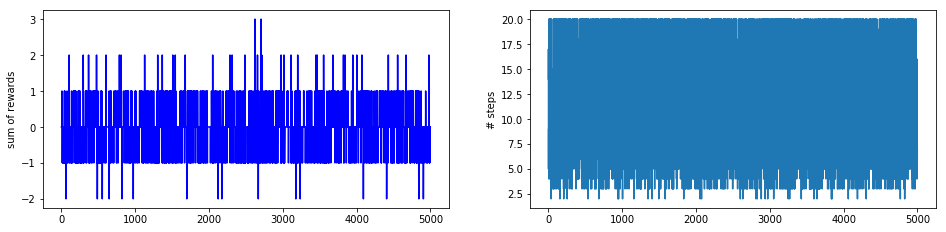

In [103]:
plot_train(rtrace, steps)

### Maze

In [ ]:
class GridWorld:
    """ Grid World environment
            there are four actions (left, right, up, and down) to move an agent
            In a grid, if it reaches a goal, it get 30 points of reward.
            If it falls in a hole or moves out of the grid world, it gets -5.
            Each step costs -1 point. 

        to test GridWorld, run the following sample codes:

            env = GridWorld('grid.txt')

            env.print_map()
            print [2,3], env.check_state([2,3])
            print [0,0], env.check_state([0,0])
            print [3,4], env.check_state([3,4])
            print [10,3], env.check_state([10,3])

            env.init([0,0])
            print env.next(1)  # right
            print env.next(3)  # down
            print env.next(0)  # left
            print env.next(2)  # up
            print env.next(2)  # up

        Parameters
        ==========
        _map        ndarray
                    string array read from a file input
        _size       1d array
                    the size of _map in ndarray
        goal_pos    tuple
                    the index for the goal location
        _actions    list
                    list of actions for 4 actions
        _s          1d array
                    current state
    """
    def __init__(self, fn):
        # read a map from a file
        self._map = self.read_map(fn)
        self._size = np.asarray(self._map.shape)
        self.goal_pos = np.where(self._map == 'G')

        # definition of actions (left, right, up, and down repectively)
        self._actions = [[0, -1], [0, 1], [-1, 0], [1, 0]]
        self._s = None

    def get_cur_state(self):
        return self._s

    def get_size(self):
        return self._size

    def read_map(self, fn):
        grid = []
        with open(fn) as f:
            for line in f:
               grid.append(list(line.strip()))
        return np.asarray(grid)

    def print_map(self):
        print( self._map )

    def check_state(self, s):
        if isinstance(s, collections.Iterable) and len(s) == 2:
            if s[0] < 0 or s[1] < 0 or\
               s[0] >= self._size[0] or s[1] >= self._size[1]:
               return 'N'
            return self._map[tuple(s)].upper()
        else:
            return 'F'  # wrong input

    def init(self, state=None):
        if state is None:
            s = [0, 0]
        else:
            s = state

        if self.check_state(s) == 'O':
            self._s = np.asarray(state)
        else:
            raise ValueError("Invalid state for init")

    def next(self, a):
        s1 = self._s + self._actions[a]
        # state transition
        curr = self.check_state(s1)
        
        if curr == 'H' or curr == 'N':
            return -5
        elif curr == 'F':
            warnings.warn("invalid state " + str(s1))
            return -5
        elif curr == 'G':
            self._s = s1
            return 30
        else:
            self._s = s1
            return -1
        
    def is_goal(self):
        return self.check_state(self._s) == 'G'
            
    def get_actions(self):
        return self._actions

In [ ]:
env = GridWorld("grid.txt")
env.print_map()
env.get_size()


In [ ]:
def coord_convert(s, sz):
    return [s[1], sz[0]-s[0]-1]

In [ ]:
class RLAgent: 
    """
        Reinforcement Learning Agent Model for training/testing
        with Tabular function approximation
        
    """
    
    def __init__(self, env):
        self.env = env
        self.size = env.get_size()
        self.n_a = len(env.get_actions())
        # self.Q table including the surrounding border
        self.Q = np.zeros((self.size[0], self.size[1], self.n_a))
    
    def epsilon_greed(self, epsilon, s):
        if np.random.uniform() < epsilon:
            a = np.random.randint(self.n_a)
        else:
            i_max = np.where(self.Q[s[0], s[1], :] == np.max(self.Q[s[0], s[1], :]))[0]
            a = int(np.random.choice(i_max))
        return a
    
    def train(self, start, **params):
        
        # parameters
        gamma = params.pop('gamma', 0.99)
        alpha = params.pop('alpha', 0.1)
        epsilon= params.pop('epsilon', 0.1)
        maxiter= params.pop('maxiter', 1000) 
        maxstep= params.pop('maxstep', 1000)
        
        # init self.Q matrix
        self.Q[...] = 0
        self.Q[self.env._map == 'H'] = -np.inf
        
        # online train
        # rewards and step trace
        rtrace = []
        steps = []
        for j in range(maxiter):

            env.init(start)
            s = env.get_cur_state()
            # selection an action
            a = self.epsilon_greed(epsilon, s)

            rewards = []
            trace = np.array(coord_convert(s, self.size))
            # run simulation for max number of steps 
            for step in range(maxstep):
                # move
                r = env.next(a)
                s1 = env.get_cur_state()
                a1 = self.epsilon_greed(epsilon, s1)

                rewards.append(r)
                trace = np.vstack((trace, coord_convert(s1, self.size)))

                # update self.Q table (SARSA)
                self.Q[s[0], s[1], a] += alpha * (r + gamma * self.Q[s1[0], s1[1], a1] -\
                                             self.Q[s[0], s[1], a])

                if env.is_goal(): # reached the goal
                    self.Q[s1[0], s1[1], a1] = 0
                    break

                s = s1
                a = a1

            rtrace.append(np.sum(rewards))
            steps.append(step+1)
        return rtrace, steps, trace # last trace of trajectory

    def test(self, start, maxstep=1000):
        epsilon = 0
        env.init(start)
        s = env.get_cur_state()
        # selection an action
        a = self.epsilon_greed(epsilon, s)

        trace = np.array(coord_convert(s, self.size))
        # run simulation for max number of steps 
        for step in range(maxstep):
            # move
            r = env.next(a)
            s1 = env.get_cur_state()
            a1 = self.epsilon_greed(epsilon, s1)

            trace = np.vstack((trace, coord_convert(s1, self.size)))

            if env.is_goal(): # reached the goal
                break

            s = s1
            a = a1 

        return trace           

In [ ]:
### Plotting tools 

def plot_trace(agent, start, trace, title="test trajectory"):
    plt.plot(trace[:, 0], trace[:, 1], "ko-")
    plt.text(env.goal_pos[1], agent.size[0]-env.goal_pos[0]-1, 'G')
    plt.text(start[1], agent.size[0]-start[0]-1, 'S')
    plt.xlim([0, agent.size[1]])
    plt.ylim([0, agent.size[0]])
    

def plot_train(agent, rtrace, steps, trace, start):

    fig = plt.figure(figsize=(10,8))
    ax = fig.add_subplot(221)
    plt.plot(rtrace, "b-")
    plt.ylabel("sum of rewards")

    ax1 = fig.add_subplot(222)
    plt.plot(steps)
    plt.ylabel("# steps")

    # contour plot for agent.Q
    ax2 = fig.add_subplot(223)
    xs = range(agent.size[1])
    ys = range(agent.size[0])
    maxQ = np.max(agent.Q, axis=2)
    h_b = (maxQ==-np.inf)
    maxQ[h_b] = 0
    maxQ[h_b] = np.min(maxQ) - 100
    cs = plt.contourf(xs, ys[::-1], maxQ)
    plt.colorbar(cs)
    plt.text(env.goal_pos[1], agent.size[0]-env.goal_pos[0]-1, 'G')
    plt.text(start[1], agent.size[0]-start[0]-1, 'S')
    plt.ylabel("max agent.Q")

    # plot traces
    ax3 = fig.add_subplot(224)
    plot_trace(agent, start, trace, "trace of the last episode")

    plt.plot()

In [ ]:
agent = RLAgent(env)
start = [0,0]
rtrace, steps, trace = agent.train(start, 
                                   gamma=0.99, 
                                   alpha=0.1, 
                                   epsilon=0.1, 
                                   maxiter=100, 
                                   maxstep=1000)
plot_train(agent, rtrace, steps, trace, start)

In [ ]:
agent = RLAgent(env)
start = [0,0]
rtrace, steps, trace = agent.train(start, 
                                   gamma=0.66, 
                                   alpha=0.99, 
                                   epsilon=0.1, 
                                   maxiter=100, 
                                   maxstep=1000)
plot_train(agent, rtrace, steps, trace, start)

In [ ]:
agent = RLAgent(env)
start = [0,0]
rtrace, steps, trace = agent.train(start, 
                                   gamma=0.99, 
                                   alpha=0.5, 
                                   epsilon=0.1, 
                                   maxiter=100, 
                                   maxstep=1000)
plot_train(agent, rtrace, steps, trace, start)

In [ ]:
agent = RLAgent(env)
start = [0,0]
rtrace, steps, trace = agent.train(start, 
                                   gamma=0.66, 
                                   alpha=0.5, 
                                   epsilon=0.1, 
                                   maxiter=100, 
                                   maxstep=1000)
plot_train(agent, rtrace, steps, trace, start)

In [ ]:
test_start = [0,2]
test_trace = agent.test(test_start)
plot_trace(agent, test_start, test_trace)

In [ ]:
test_start = [1,8]
test_trace = agent.test(test_start)
plot_trace(agent, test_start, test_trace)

# IV - Results

- Describe the choice of your parameters for $\gamma$, $\alpha$, and $\epsilon$. 
  - Run experiments to find good parameters
  - Show the experimental outputs to show the process of your selection
- Visualize the results and explain outputs (even from mine.)
  - Run the codes and tell me what you observe
  - Add more visualizations to enrich your explanation.

# V. Conclusions

Discuss the challenges or somethat that you learned. 
If you have any suggestion about the assignment, you can write about it. 

# Extra Credit for Tournament Top16!

- In two classes, we will have qualification and tournament.
- In qualification game, individual will play against a dealer for one game for 50 round. 
  - Highly ranked (by the profit) and non-broke players will proceed to the tournament.
  - max. 32 players will be cut for main tournament.
- In tournament, 4 players will be play in each round.
  - In a table game, the game lasts until two players broke
  - In final, the game will ends in 50 rounds and winner will be the one with highest balance. 

## Grading

We will test your notebook with an additional grid.txt file. Please make sure to test in different maze input files. 

points | | description
--|--|:--
5 | Overview| states the objective and the appraoch 
35 | Methods | 
 |10| Review of the SARSA and Q-Learning
 | 5| Choice of TD learning and Reason
 | 5| Choice of Function Approximation and Reason
 |10| Implementation of the selected approach (RLAgent)
 | 5| explanation of the codes
45 | Results 
 |10| Reports the selected parameters 
 |15| Experimental outputs that show the choice of parameters. How do you choose them?
 |10| Output plots (5 for each)
 |10| reading and analysis of learning results and plots
10 | Participation to the tournament.
5 | Conclusions 
